In [130]:
#from pathlib import Path
#import pandas as pd
#greenhouse_path = Path("C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\greenhouse_fill_missing_values.csv")
#weather_path = Path("C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\weather_fill_missing_values.csv")
#greenhouse_climate_path = Path("C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\greenhouse_climate_fill_missing_values.csv")
#root_zone_path = Path("C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\root_zone_fill_missing_values.csv")
#Crop_parameters_path = Path("C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\root_zone_fill_missing_values.csv")
#
#greenhouse = pd.read_csv(greenhouse_path,parse_dates=["%time"]).set_index('%time')
#weather=pd.read_csv(weather_path,parse_dates=["%time"]).set_index('%time')
#greenhouse_climate=pd.read_csv(greenhouse_climate_path,parse_dates=["%time"]).set_index('%time')
#root_zone=pd.read_csv(root_zone_path,parse_dates=["%time"]).set_index('%time')
#Crop_parameters=pd.read_csv(Crop_parameters_path,parse_dates=["%time"]).set_index('%time')

In [131]:
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np

In [132]:
from pathlib import Path

IMAGES_PATH = Path() / "images" / "Weekly Crop Parameters"
IMAGES_PATH.mkdir(parents=True, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = IMAGES_PATH / f"{fig_id}.{fig_extension}"
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

In [133]:
from pathlib import Path

orgin_path = "D:\\Iman\\AGHC\\CherryTomato\Data\\"
filenames = ['AICU', 'Automatoes',
             'Digilog', 'IUACAAS', 
             'Reference', 'TheAutomators'
             ]

daily_Avg=dict()
Weekly_Crop_Parameters=dict()
greenhouse_climate=dict()
for filename in filenames:
    path=Path(orgin_path+filename+'\\CropParameters.csv')
    Weekly_Crop_Parameters[filename] = pd.read_csv(path,parse_dates=["%Time"],low_memory=False).set_index('%Time').astype(float)
    #print(Weekly_Crop_Parameters[filename].index.shape)
    Weekly_Crop_Parameters[filename]['%Time_t']=Weekly_Crop_Parameters[filename].index.astype(str)+"_"+filename
    Weekly_Crop_Parameters[filename]=Weekly_Crop_Parameters[filename].set_index('%Time_t')
    path=Path(orgin_path+filename+'\\GreenhouseClimate.csv')
    greenhouse_climate[filename]=pd.read_csv(path,parse_dates=["%time"],low_memory=False).set_index('%time').astype(float)
    
    #greenhouse_climate[filename].drop(columns=[  'AssimLight', 'BlackScr', 'CO2air', 'EC_drain_PC', 'EnScr', 'HumDef',
    #   'PipeGrow', 'PipeLow', 'Rhair', 'Tair', 'Tot_PAR', 'Tot_PAR_Lamps',
    #   'VentLee', 'Ventwind', 'co2_dos', 'Cum_irr','water_sup'],inplace=True)
    sp_vip_paired_attributtes=[ [('assim_sp','assim_vip'),('assim_vip','assim_sp')],
                            [('co2_sp','co2_vip'),('co2_vip','co2_sp')],
                            [('dx_sp','dx_vip'),('dx_vip','dx_sp')],
                            [('int_blue_sp','int_blue_vip'),('int_blue_vip','int_blue_sp')],
                            [('int_farred_sp','int_farred_vip'),('int_farred_vip','int_farred_sp')],
                            [('int_red_sp','int_red_vip'),('int_red_vip','int_red_sp')], 
                            [('int_white_sp','int_white_vip'),('int_white_vip','int_white_sp')],
                            [('scr_blck_sp','scr_blck_vip'),('scr_blck_vip','scr_blck_sp')],
                            [('scr_enrg_sp','scr_enrg_vip'),('scr_enrg_vip','scr_enrg_sp')],
                            [('t_grow_min_sp','t_grow_min_vip'),('t_grow_min_vip','t_grow_min_sp')],
                            [('t_heat_sp','t_heat_vip'),('t_heat_vip','t_heat_sp')],
                            [('t_rail_min_sp','t_rail_min_vip'),('t_rail_min_vip','t_rail_min_sp')],
                            [('t_vent_sp','t_ventlee_vip'),('t_ventlee_vip','t_vent_sp')],
                            [('water_sup_intervals_sp_min','water_sup_intervals_vip_min'),('water_sup_intervals_vip_min','water_sup_intervals_sp_min')],
                            [('window_pos_lee_sp','window_pos_lee_vip'),('window_pos_lee_vip','window_pos_lee_sp')],
                            ]
    norm_mean_difference=[]
    for sp_vip_paired_attributte in sp_vip_paired_attributtes: 
        for (sp, vip) in sp_vip_paired_attributte:
            x=greenhouse_climate[filename].iloc[(np.where(greenhouse_climate[filename][sp].isnull()))][vip]
            #print(teams_ghc[sp])
            difference=(greenhouse_climate[filename][sp]-greenhouse_climate[filename][vip]).mean()
            mean_difference=difference/(greenhouse_climate[filename][sp].mean())
            norm_mean_difference.append([sp,vip,mean_difference])

            #print(f'{sp},{vip} difference={norm_mean_difference}')
            #print(x.index)
            for i in x.index:
                #print(i)
                greenhouse_climate[filename].loc[i,sp]= greenhouse_climate[filename].loc[i,vip]#.iloc[i][vip]
                #print(i,teams_ghc.loc[i,sp]) 
            #plt.figure()
            #correlation = greenhouse_climate[filename].corr()[vip][sp]
            #corr1=greenhouse_climate[filename].corr()[vip].sort_values(ascending=False)
            #corr1.plot(kind='bar',title=f'{vip} SP-VIP Correlation',figsize=(18, 6),fontsize=12)
            ##plt.show
            #save_fig(f'{vip}SP-VIP Correlation')
            #print(f"correlation between {vip} and {sp}=",correlation)
            #plt.show
    norm_mean_difference     



    #fill missing values
    for gh_attribute in greenhouse_climate[filename].columns:
        x=greenhouse_climate[filename].iloc[(np.where(greenhouse_climate[filename][gh_attribute].isnull()))][gh_attribute]
        for i in reversed(x.index):
            if i.day+(1)< greenhouse_climate[filename].index[-1].day:
                #print(i+(12*24))
                d=i
                #print(d.day+1)

                d = d.replace(day=d.day+1)

                #print(d.day+1)
                greenhouse_climate[filename].loc[i,gh_attribute]= greenhouse_climate[filename].loc[d,gh_attribute]
                #print(i+(12*24),teams_ghc.loc[i,gh_attribute])
    for gh_attribute in greenhouse_climate[filename].columns:
        x=greenhouse_climate[filename].iloc[(np.where(greenhouse_climate[filename][gh_attribute].isnull()))][gh_attribute]
        for i in x.index:
            if i.day-(1)>= 0:
                #print(i+(12*24))
                d=i
                #print(d)
                d = d.replace(day=d.day-1)
                #print(d)
                greenhouse_climate[filename].loc[i,gh_attribute]= greenhouse_climate[filename].loc[d,gh_attribute]
                #print(i+(12*24),teams_ghc.loc[i,gh_attribute])

    #print(greenhouse_climate[filename].groupby(greenhouse_climate[filename].index.date).mean())
    
    daily_Avg[filename]=greenhouse_climate[filename].groupby(greenhouse_climate[filename].index.date).mean()
    daily_Avg[filename]['%time_t']=daily_Avg[filename].index.astype(str)+"_"+filename
    daily_Avg[filename]=daily_Avg[filename].set_index('%time_t')
    #print(daily_Avg[filename].index[-1])
    daily_Avg[filename].drop(daily_Avg[filename].index[-1],axis=0,inplace=True)
    



C:\Users\user\AppData\Local\Temp\ipykernel_27748\21388373.py:14: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\user\AppData\Local\Temp\ipykernel_27748\21388373.py:19: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\user\AppData\Local\Temp\ipykernel_27748\21388373.py:46: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\user\AppData\Local\Temp\ipykernel_27748\21388373.py:46: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\user\AppData\Local\Temp\ipykernel_27748\21388373.py:19: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a form

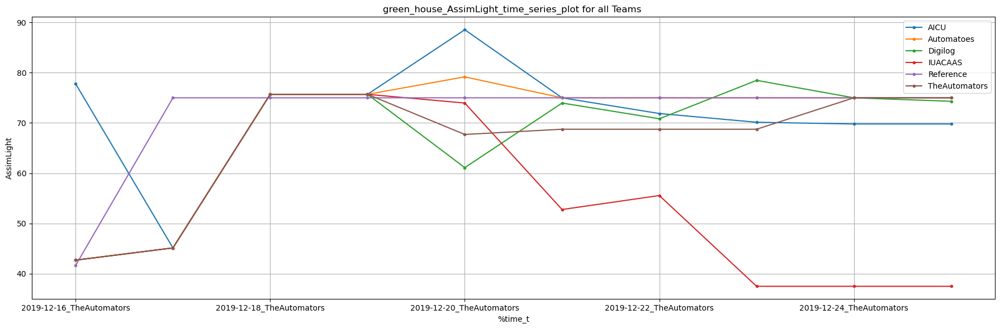

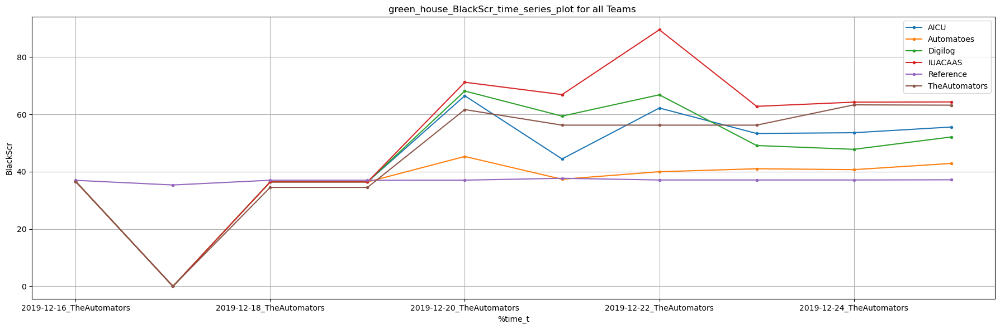

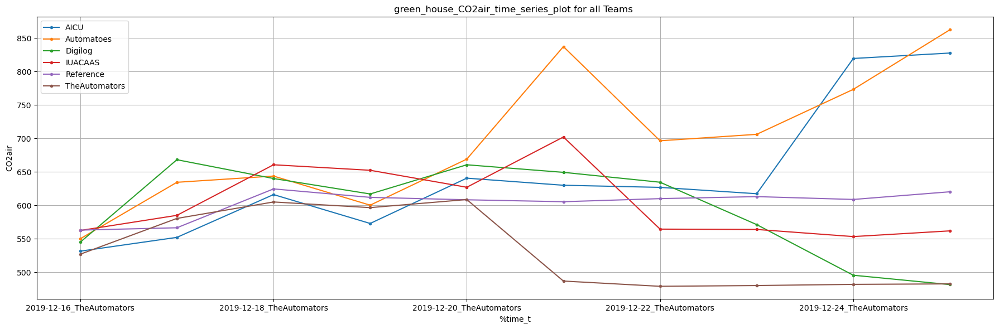

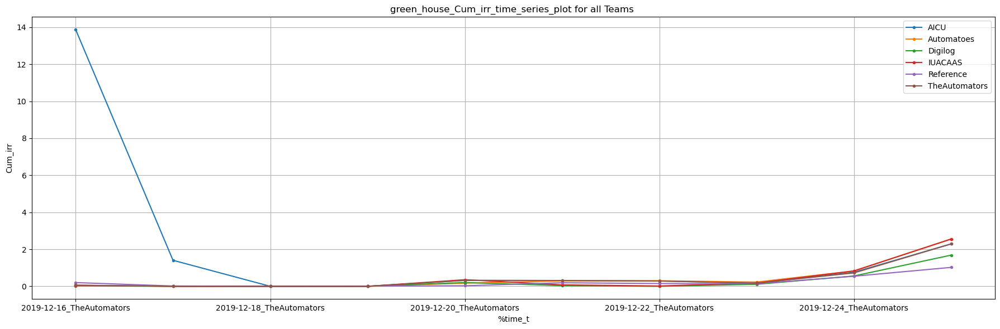

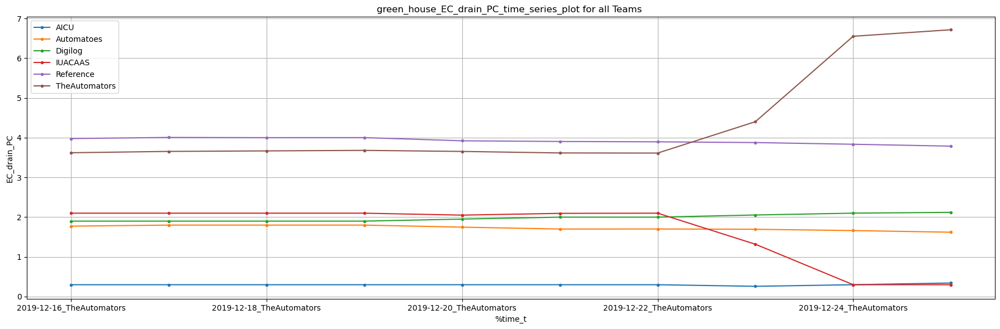

...

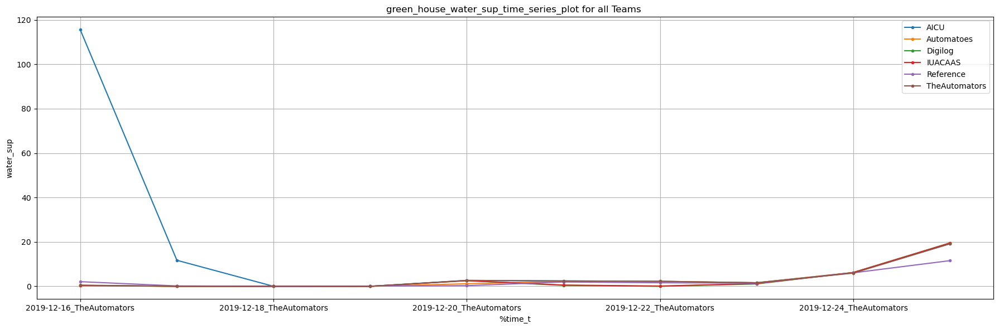

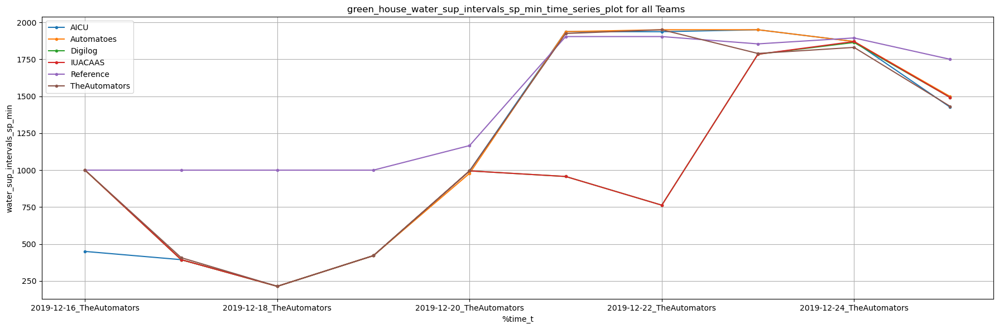

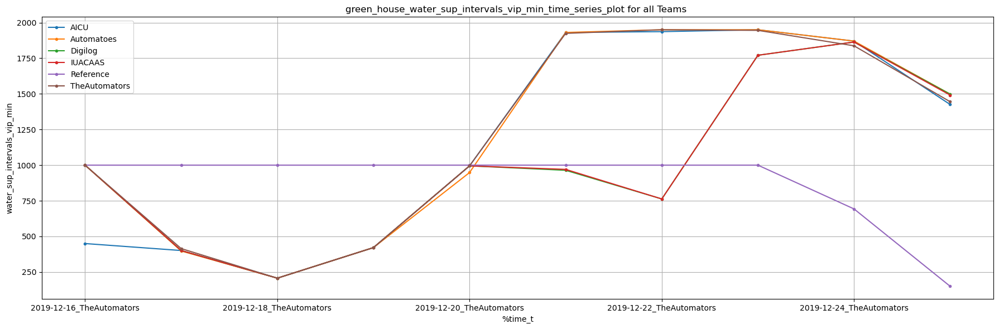

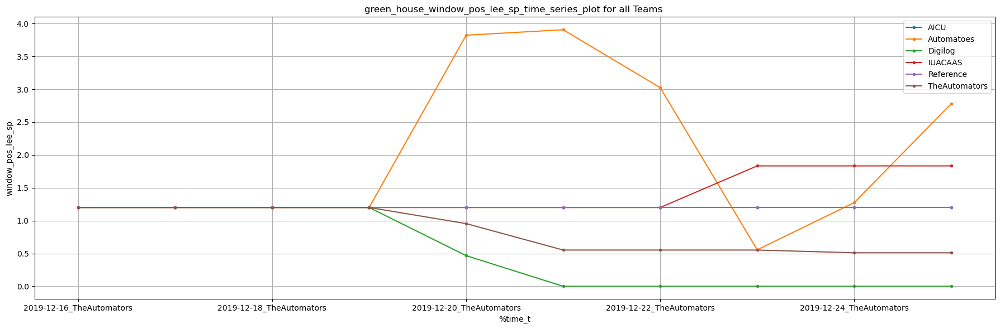

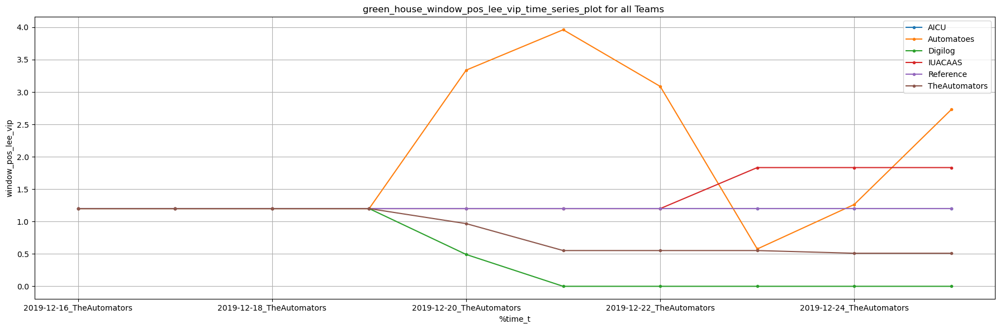

In [134]:
import matplotlib.pyplot as plt
for feature in daily_Avg[filename].columns:
    for i in range(len(filenames)):
        daily_Avg[filenames[i]]["2019-12-16 00:00:00" : "2019-12-26 00:00:00"][feature].plot(ylabel=feature,grid=True, marker=".", figsize=(18, 6),legend=True,label=f'{filenames[i]}')
    plt.title(f'green_house_{feature}_time_series_plot for all Teams ')
    plt.legend()
    save_fig(f'green_house_{feature}_time_series_plot ')

    plt.show()

In [135]:
for filename in filenames:
    #greenhouse_climate[filename]['hours']=greenhouse_climate[filename].index.time
    #greenhouse_climate[filename]['hours']=greenhouse_climate[filename]['hours'].astype('string').str.split(':',expand=True)[0]
    #greenhouse_climate[filename]['days']=greenhouse_climate[filename].index.date
    #greenhouse_climate[filename]['days']=greenhouse_climate[filename]['days'].astype('string').str.split('-',expand=True)[2]
    #print('days',greenhouse_climate[filename]['days'])
    #print('hours',greenhouse_climate[filename]['hours'])
    #print(greenhouse_climate[filename]['%time'])
    #print(greenhouse_climate[filename].head())
    
    greenhouse_climate[filename]['%time']=greenhouse_climate[filename].index
    out=greenhouse_climate[filename]['%time'].astype('string').str.split(' ',expand=True).reset_index()
    #print(out.head())
    out['days']=np.zeros(shape=out[0].shape[0])
    out['hours']=np.zeros(shape=out[0].shape[0])
    out['minutes']=np.zeros(shape=out[0].shape[0])
#
    out.shape
    
    
    day_count=1
    min_counts=1
    for i in (out.groupby(by=[0])[0].sum().index):
        #print(i)
        min_counts=1
        hours_count=1
        for idx in out[0].index:     
            if out[0].iloc[idx]==i:
                out['days'].iloc[idx]=day_count
                #print('done',idx)
                out['hours'].iloc[idx]=hours_count
                min_counts+=1
                if min_counts>12:
                    hours_count+=1
                    min_counts=1
        day_count+=1
    out
    #
    greenhouse_climate[filename]['days']=out['days'].values
    greenhouse_climate[filename]['hours']=out['hours'].values
    greenhouse_climate[filename]['minutes']=out['minutes'].values
#
    #greenhouse_climate[filename].drop('%time',inplace=True)
    #print(greenhouse_climate[filename]['days'].value_counts())
    
    
    #print(out['hours'].value_counts())
    #print(out['days'].value_counts())
    
    greenhouse_climate[filename]['%time_t']=greenhouse_climate[filename].index.astype(str)+"_"+filename
    greenhouse_climate[filename]=greenhouse_climate[filename].set_index('%time_t')
    

C:\Users\user\AppData\Local\Temp\ipykernel_27748\2291244781.py:29: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\user\AppData\Local\Temp\ipykernel_27748\2291244781.py:29: SettingWithCopyWarning:


A value is trying to be set on a co

In [136]:
filenames = ['AICU', 'Automatoes',
             'Digilog', 'IUACAAS', 
             'Reference', 'TheAutomators'
             ]
for i in range(len(filenames)):
    #print(greenhouse_climate[filenames[i]].index)
    greenhouse_climate[filenames[i]]['%time'] = pd.to_datetime(greenhouse_climate[filenames[i]].index.str.split('_').str[0])
    greenhouse_climate[filenames[i]].set_index('%time', inplace=True)  # Set datetime as the index

    #print(greenhouse_climate[filenames[i]].columns)
    daily_Avg[filenames[i]]['%time'] = pd.to_datetime(daily_Avg[filenames[i]].index.str.split('_').str[0])
    daily_Avg[filenames[i]].set_index('%time', inplace=True)  # Set datetime as the index

    Weekly_Crop_Parameters[filenames[i]]['%Time'] = pd.to_datetime(Weekly_Crop_Parameters[filenames[i]].index.str.split('_').str[0])
    Weekly_Crop_Parameters[filenames[i]].set_index('%Time', inplace=True)  # Set datetime as the index

    


In [137]:
for i in range(len(filenames)):

    greenhouse_climate[filenames[i]].drop(['assim_sp', 'co2_sp',  'dx_sp',
           'int_blue_sp', 'int_farred_sp','scr_blck_sp',
           'int_red_sp', 'int_white_sp','t_grow_min_sp',
           't_heat_sp', 't_rail_min_sp', 'hours',
           't_vent_sp','water_sup_intervals_sp_min',
           'window_pos_lee_sp','scr_enrg_sp','minutes'],axis=1,inplace=True)
    daily_Avg[filenames[i]].drop(['assim_sp', 'co2_sp',  'dx_sp',
           'int_blue_sp', 'int_farred_sp','scr_blck_sp',
           'int_red_sp', 'int_white_sp','t_grow_min_sp',
           't_heat_sp', 't_rail_min_sp',
           't_vent_sp','water_sup_intervals_sp_min',
           'window_pos_lee_sp','scr_enrg_sp'],axis=1,inplace=True)

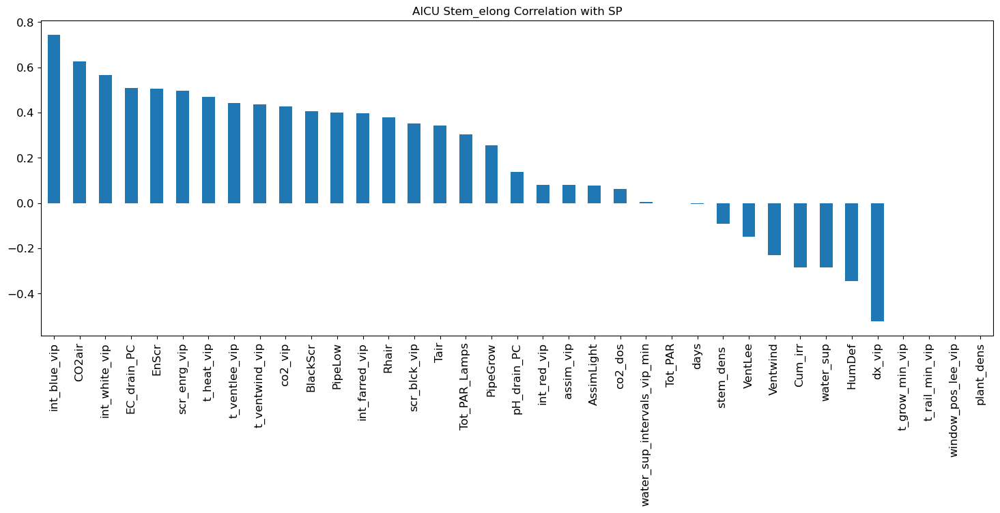

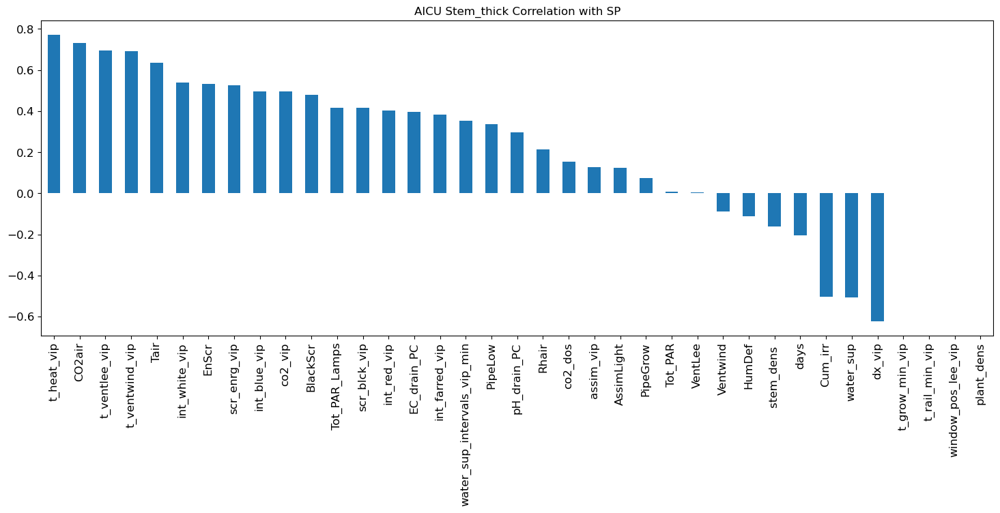

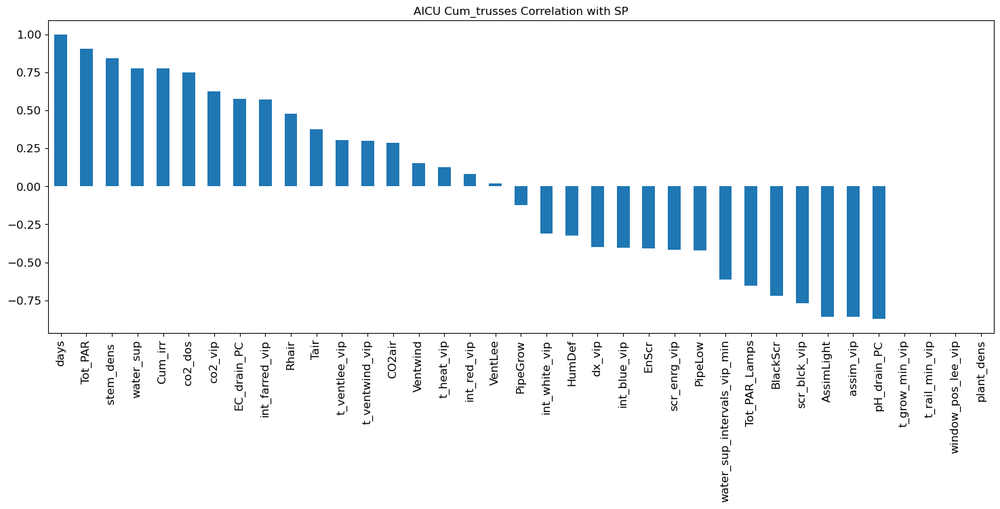

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



<Figure size 640x480 with 0 Axes>

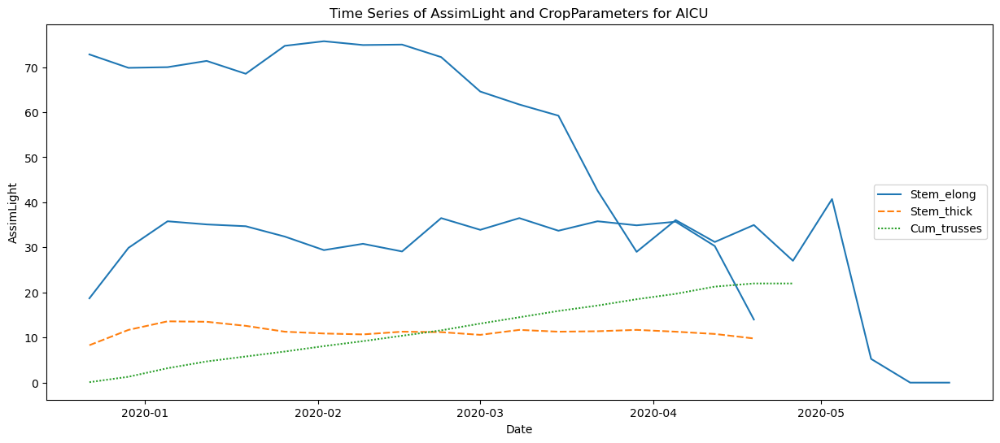

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



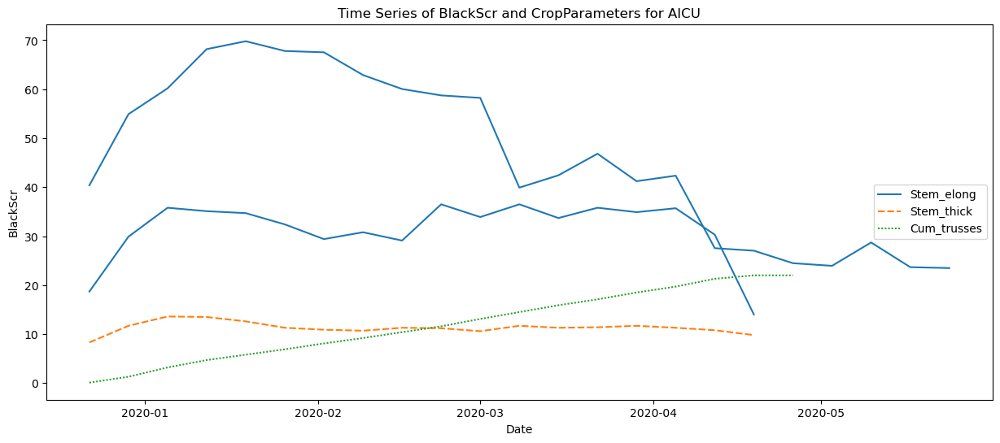

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



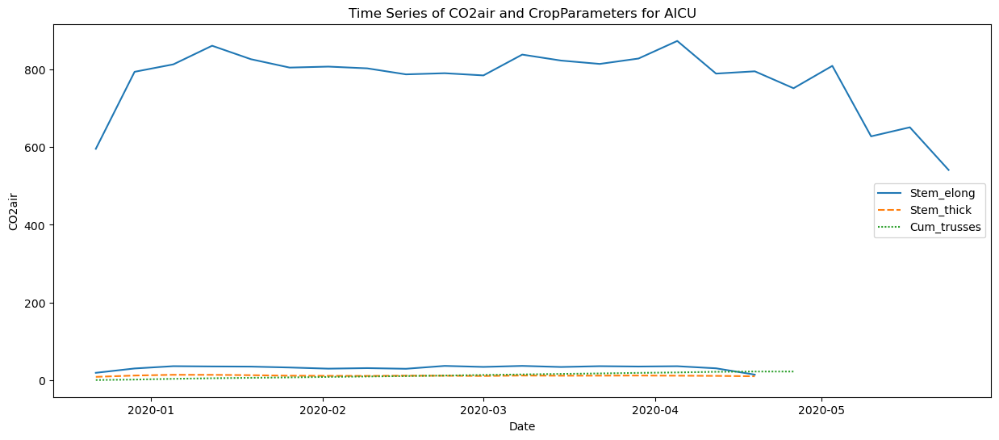

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



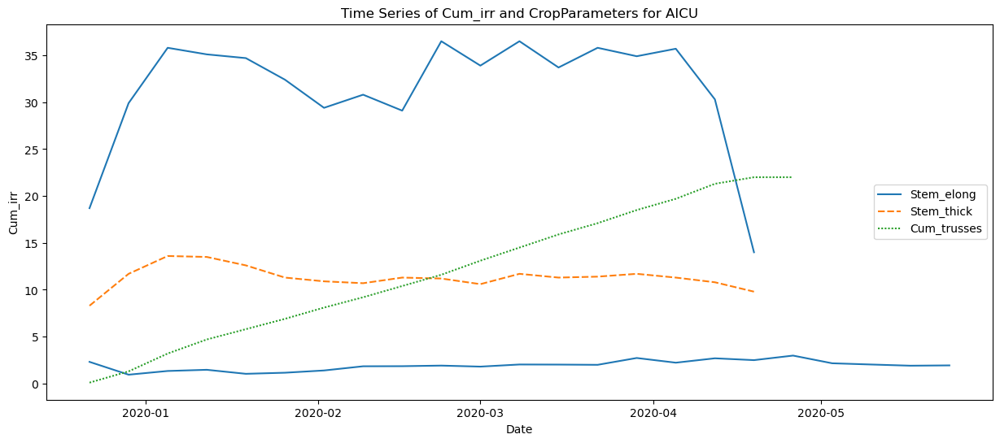

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



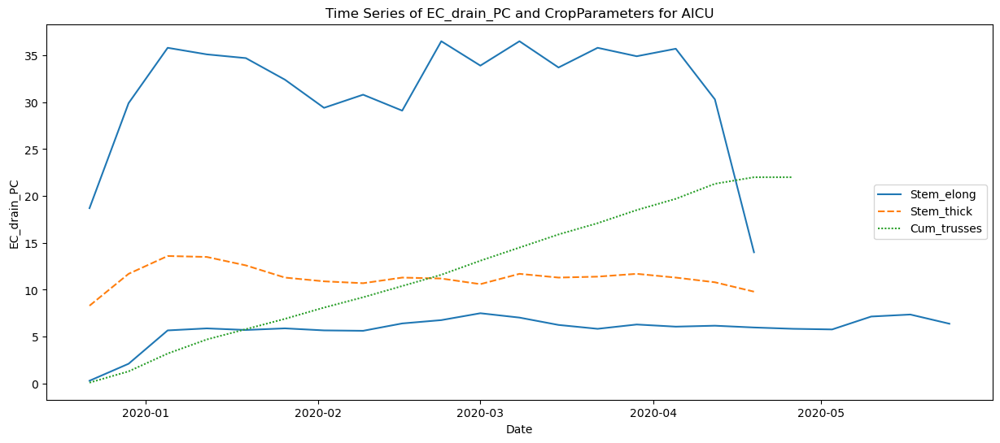

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



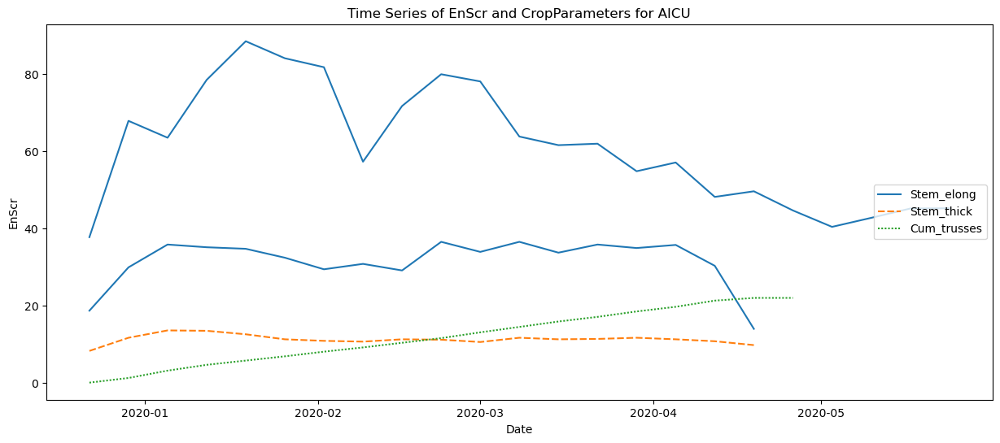

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



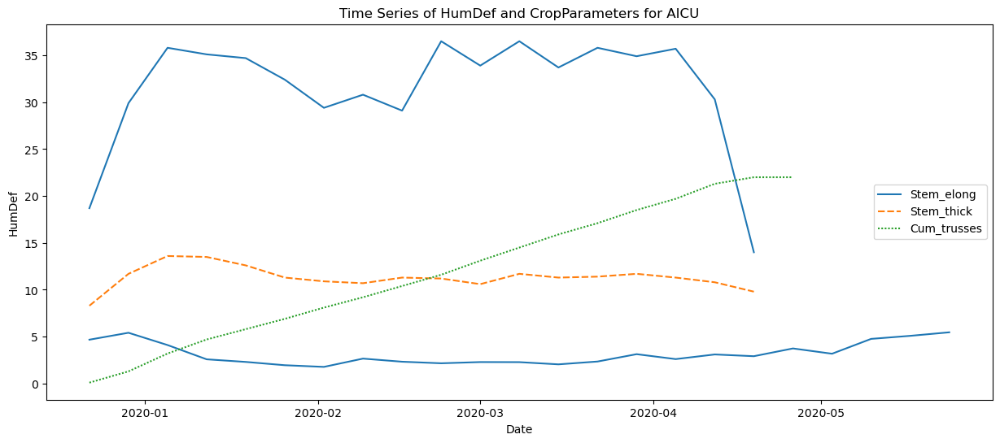

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



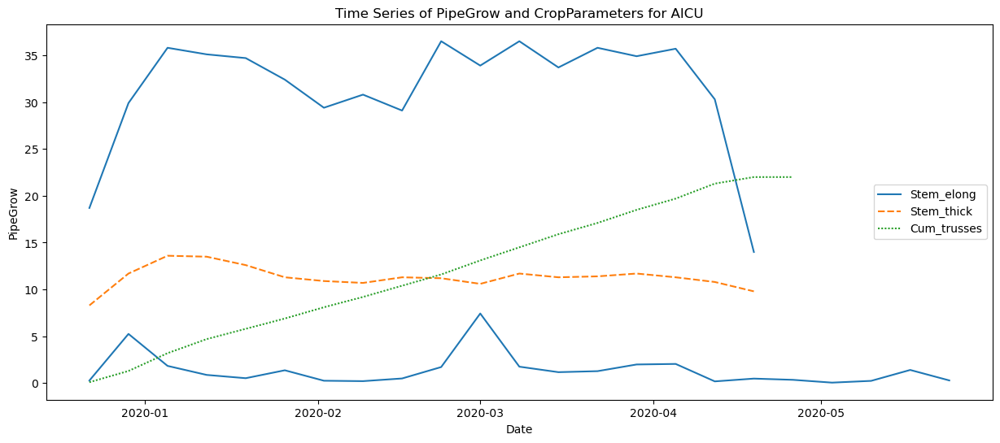

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



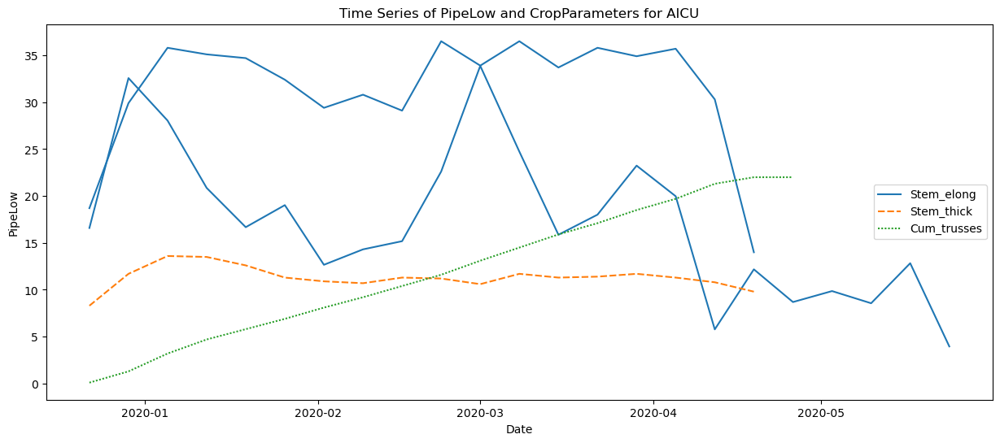

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



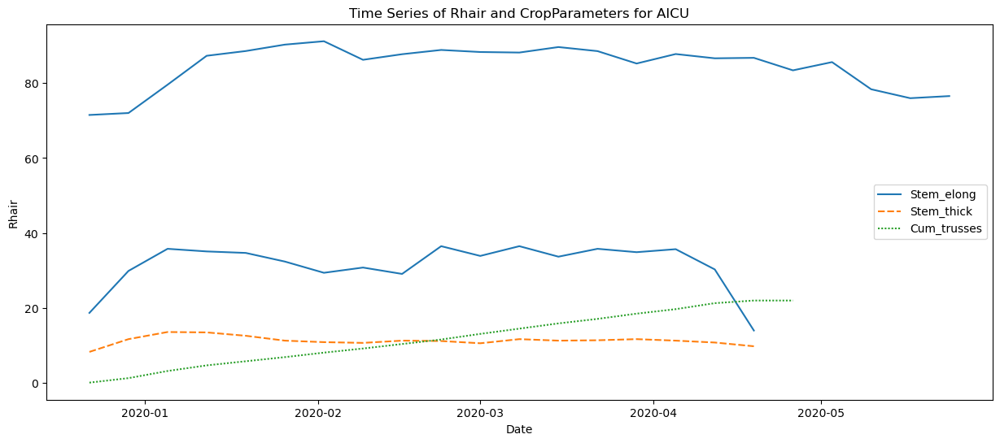

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



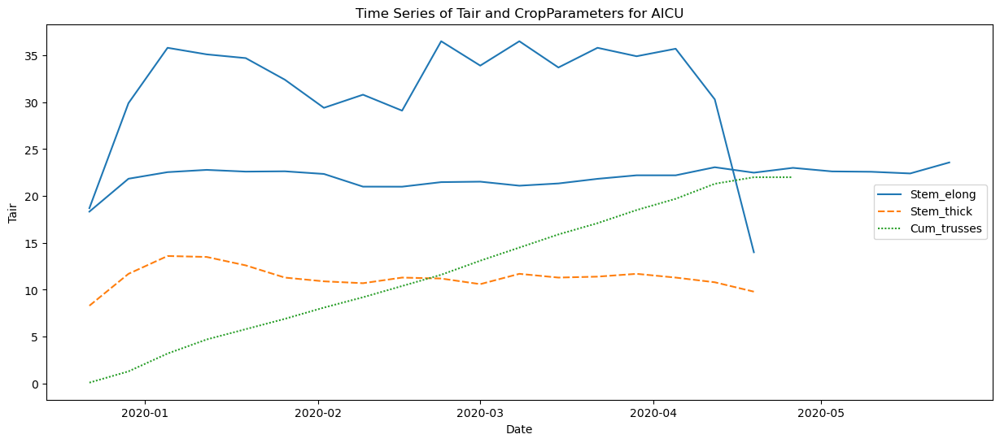

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



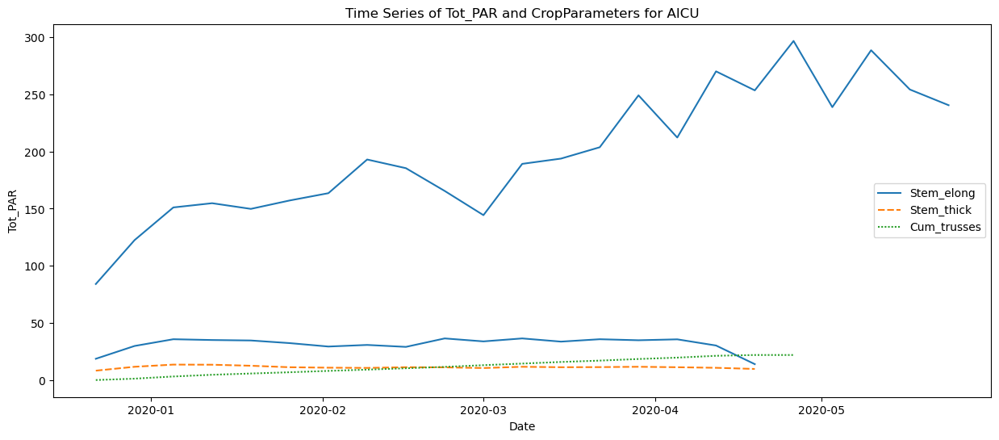

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



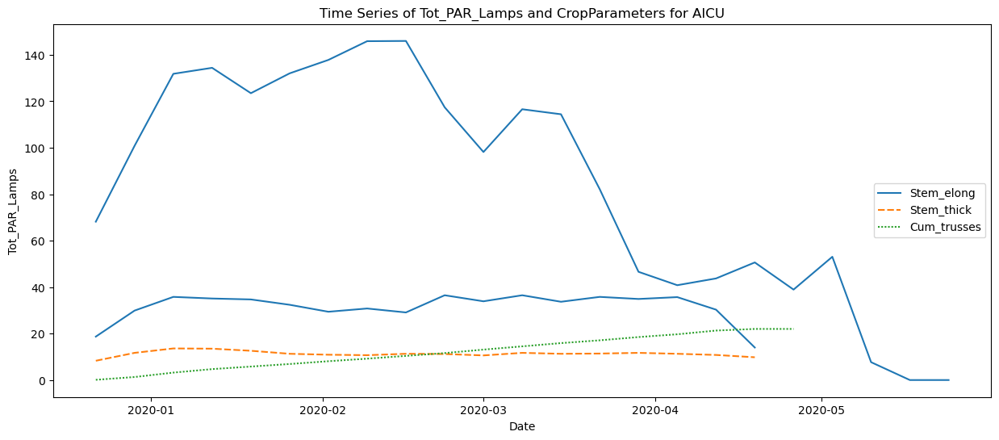

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



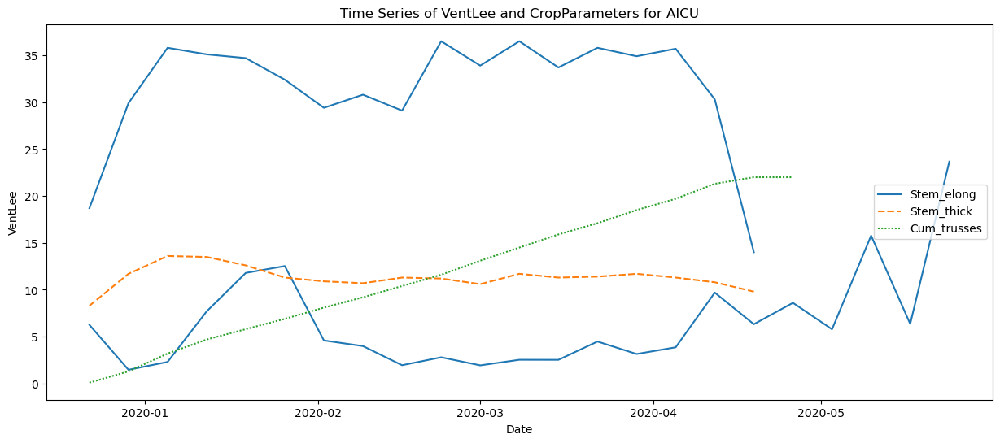

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



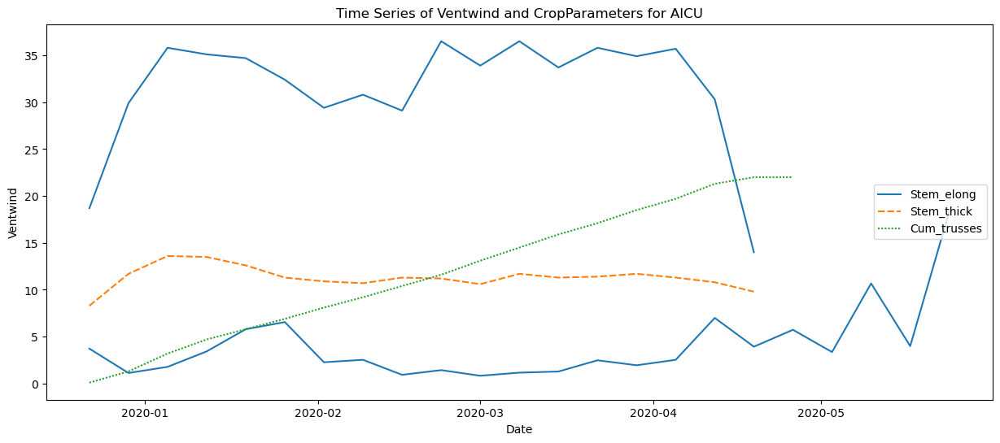

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



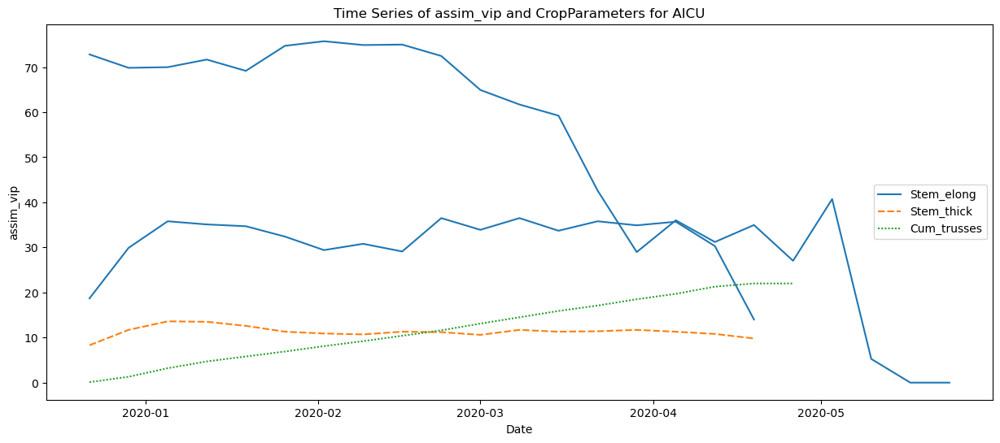

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



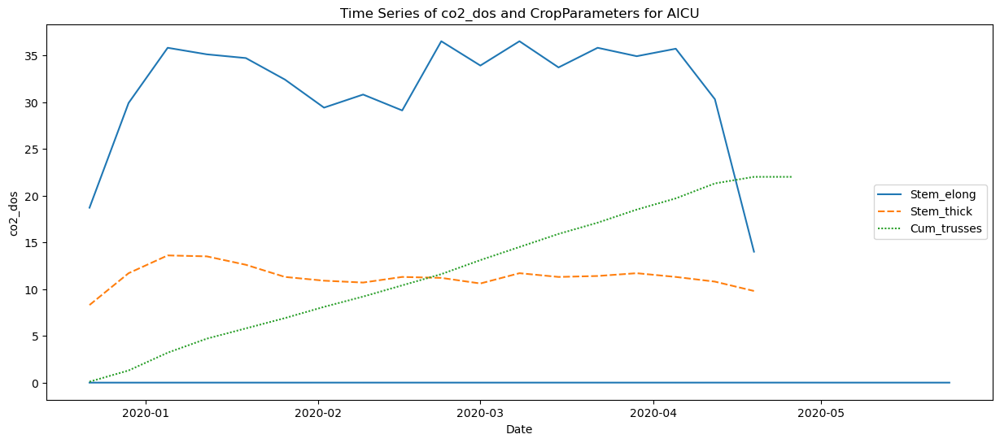

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



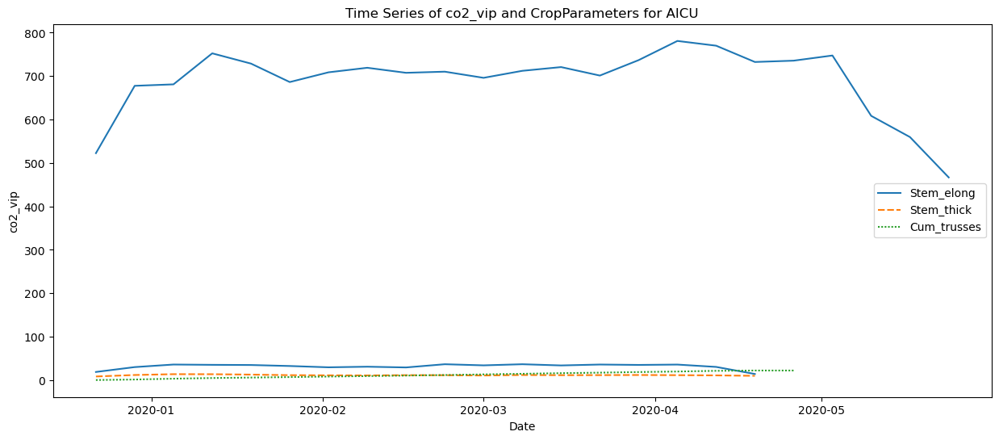

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



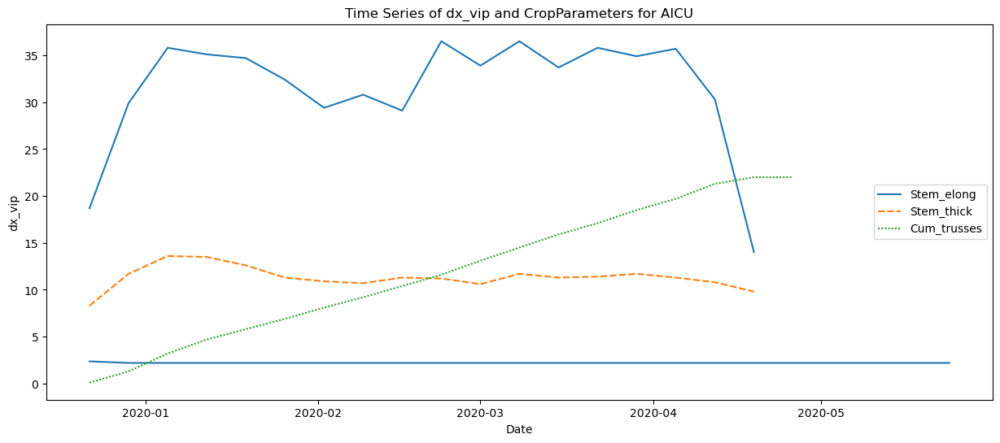

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



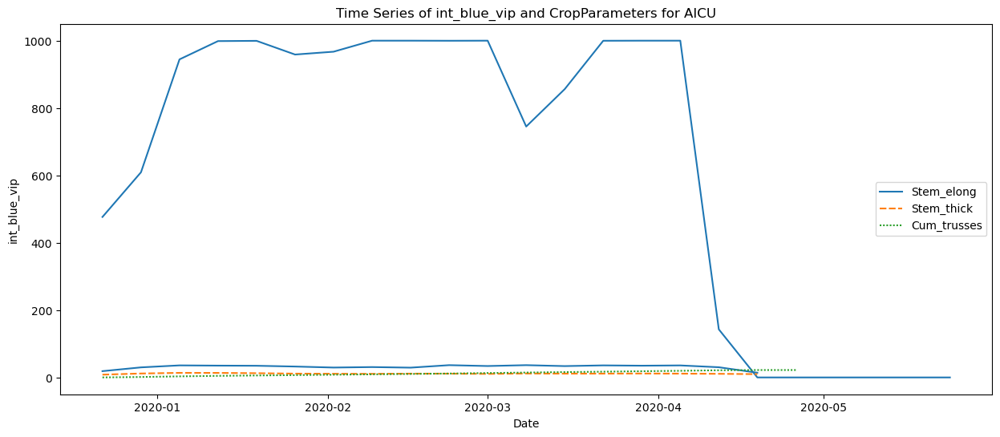

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



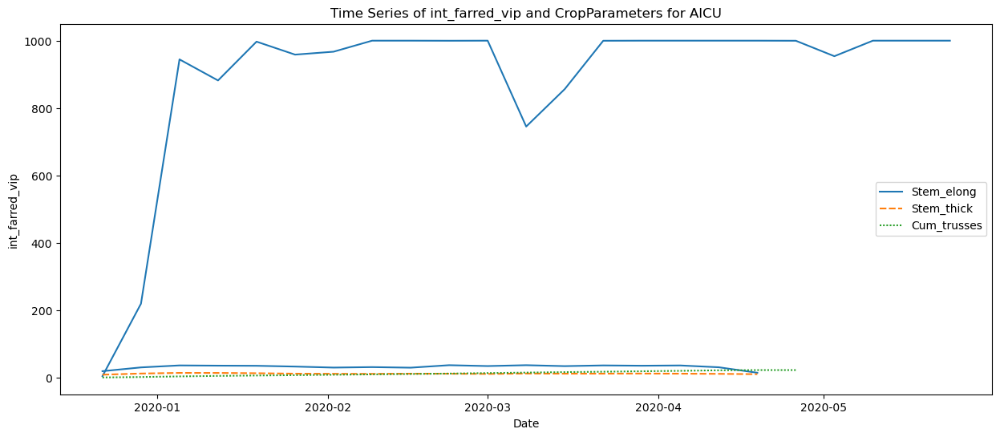

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



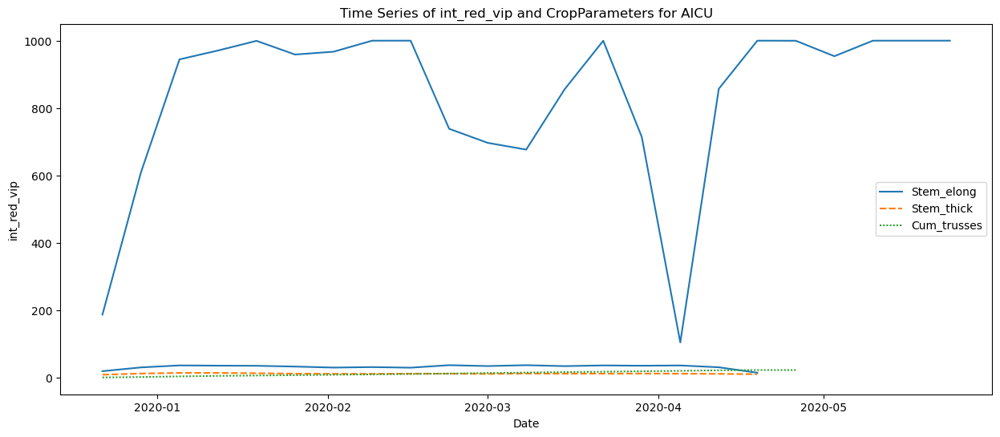

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



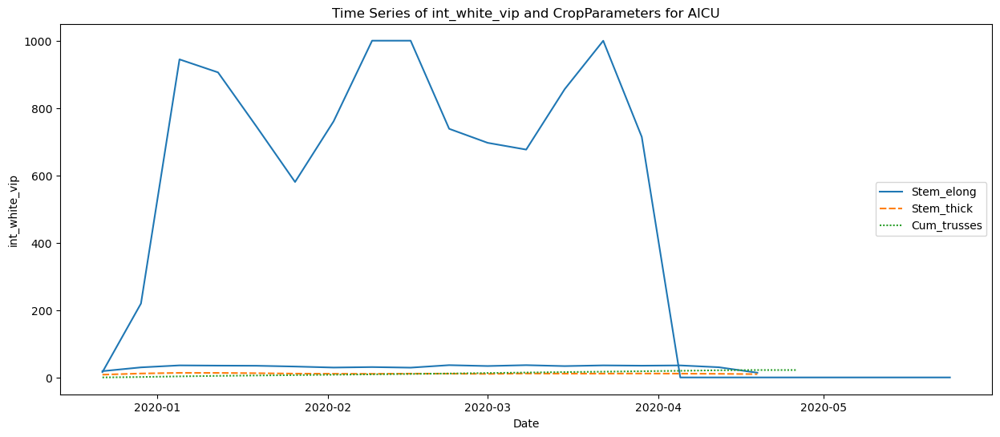

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



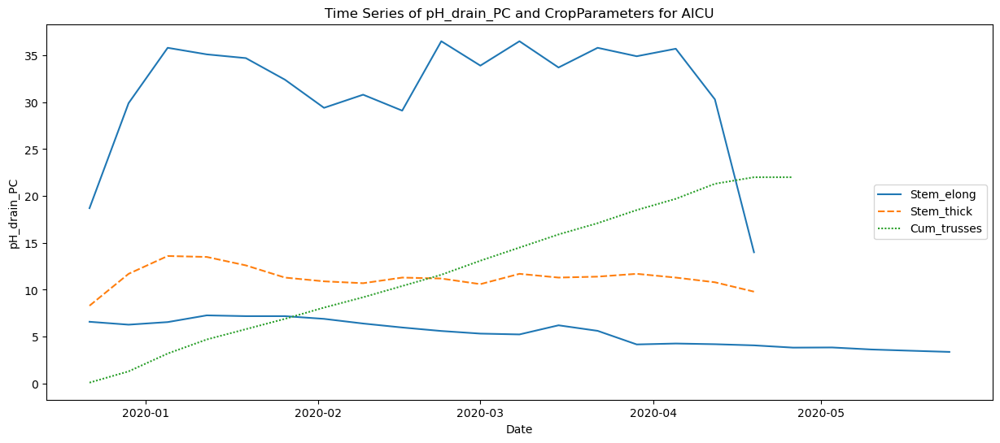

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



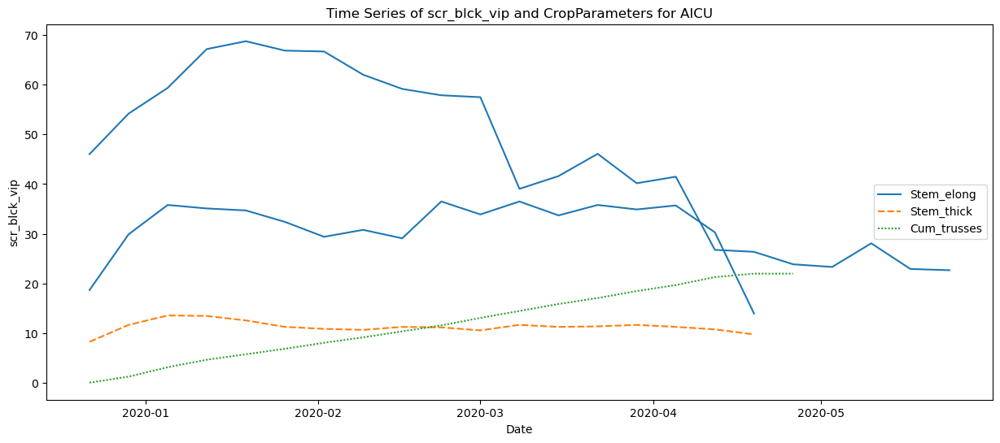

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



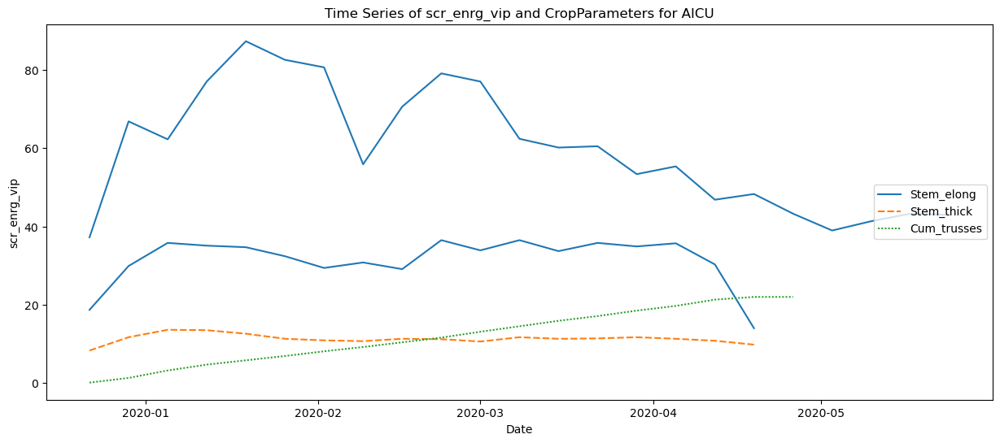

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



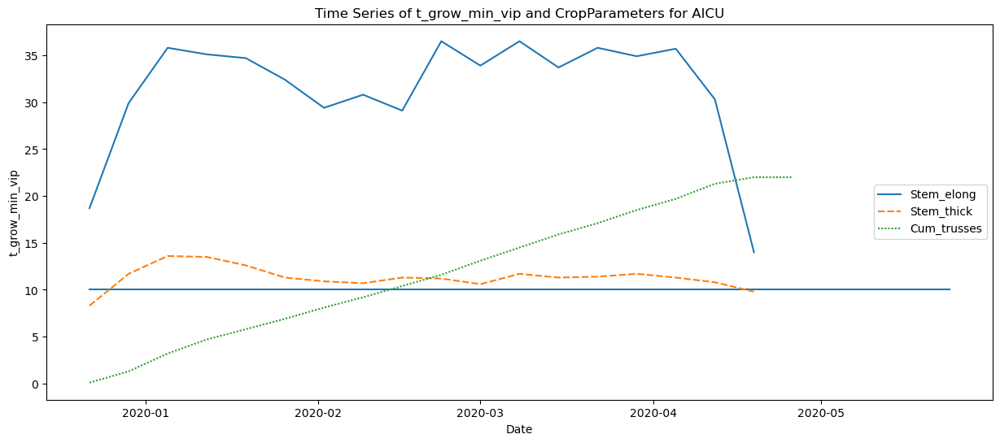

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



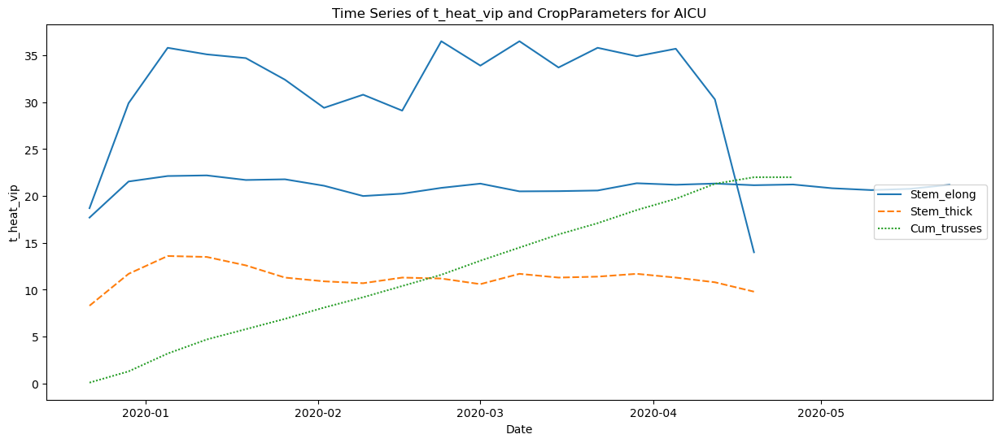

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



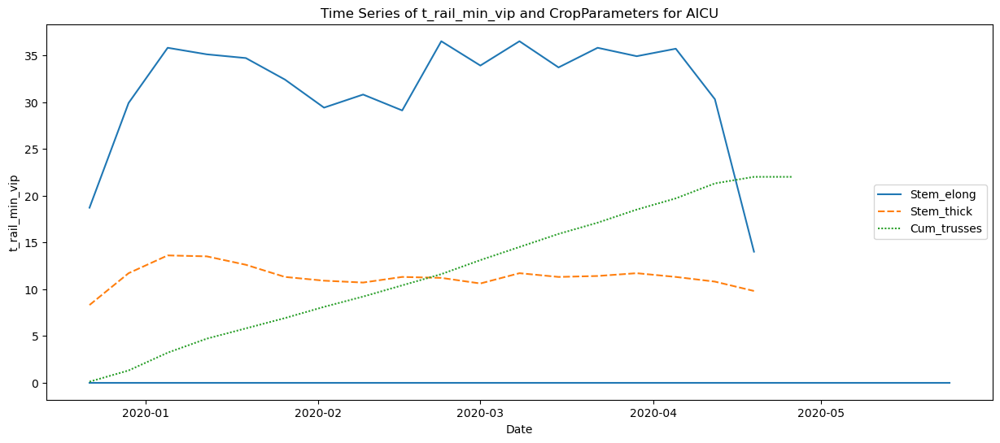

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



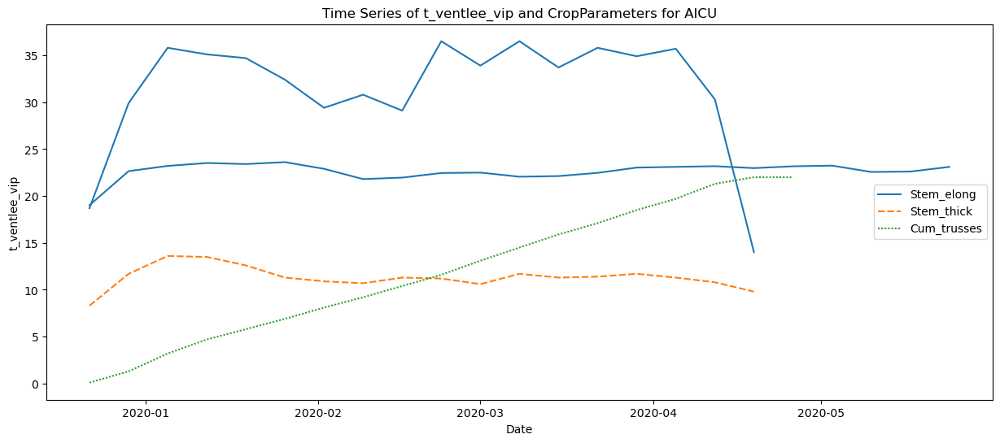

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



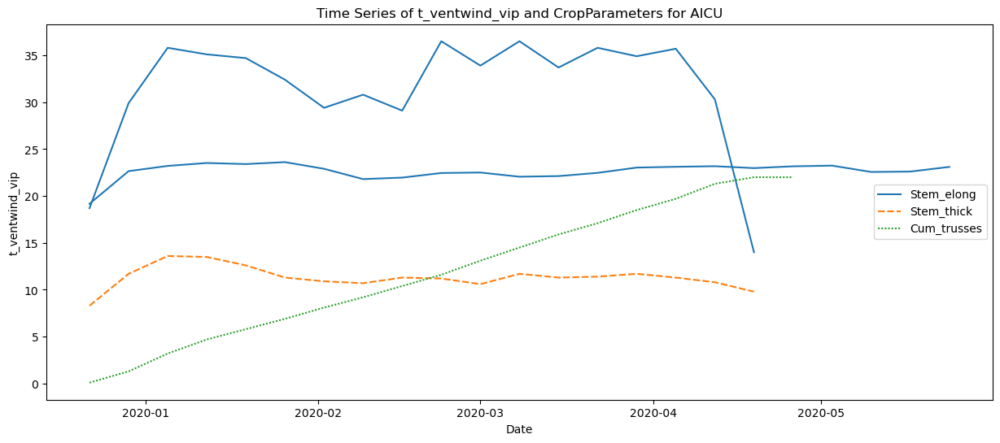

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



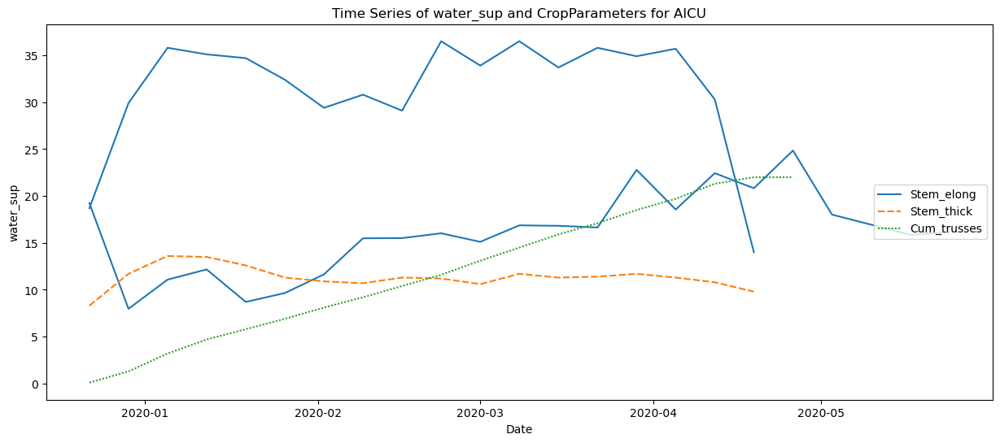

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



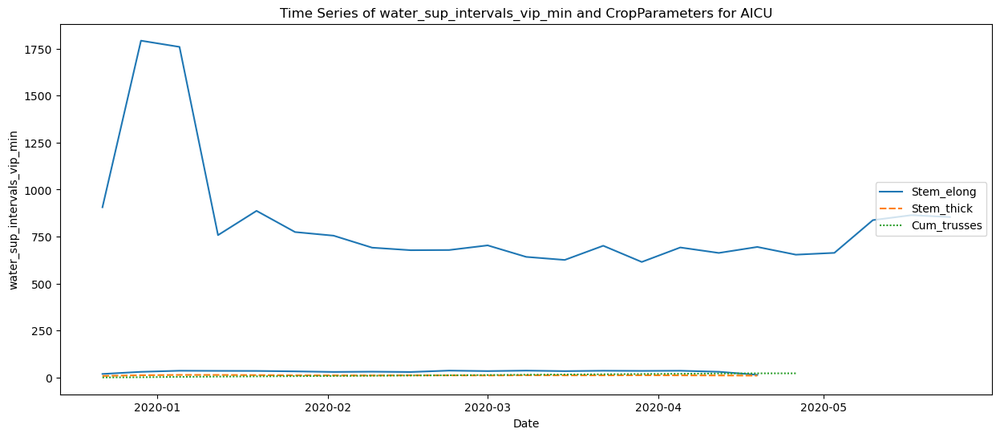

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



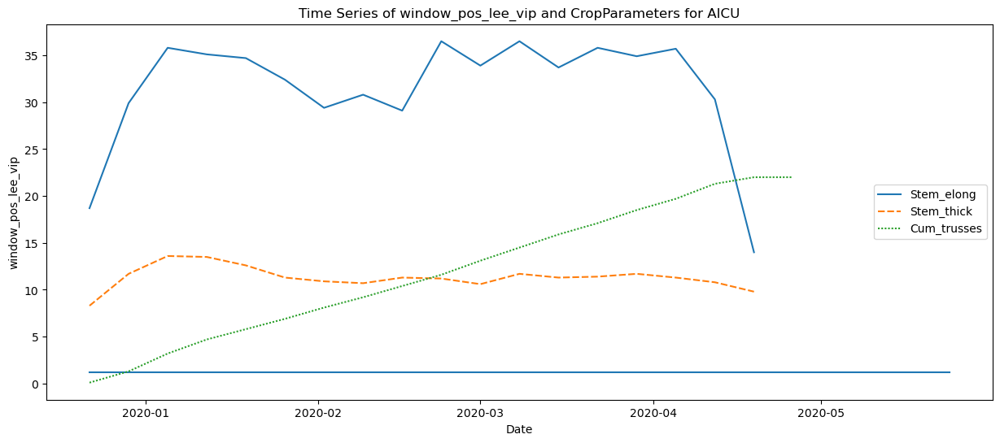

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



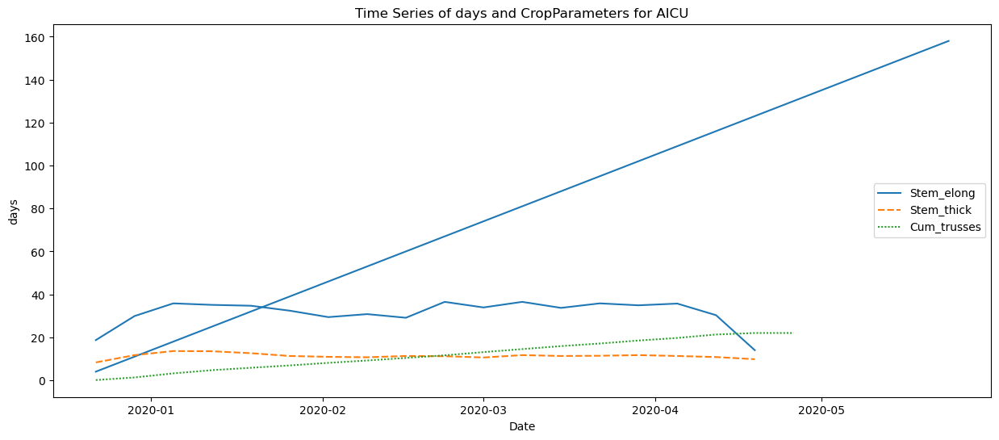

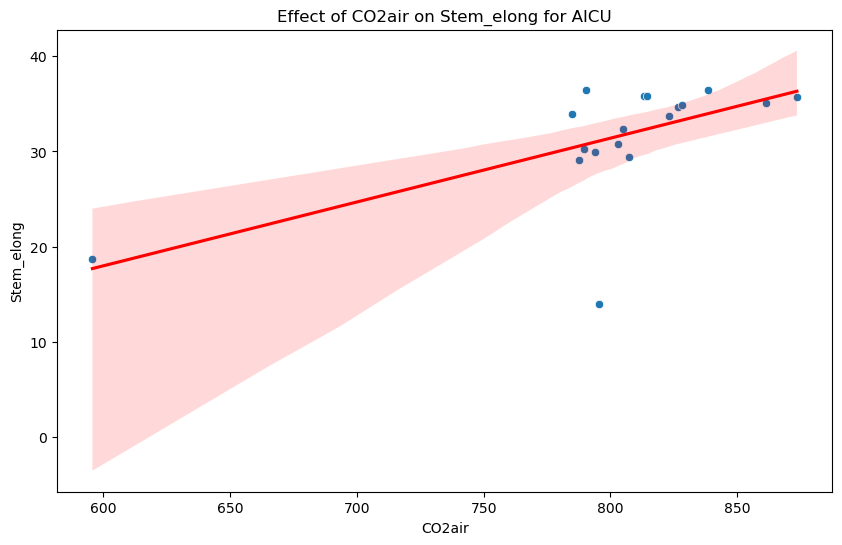

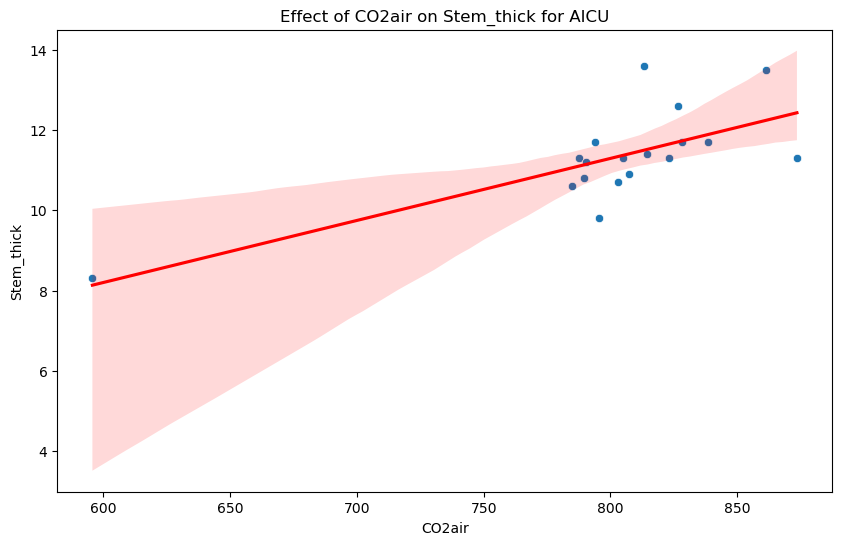

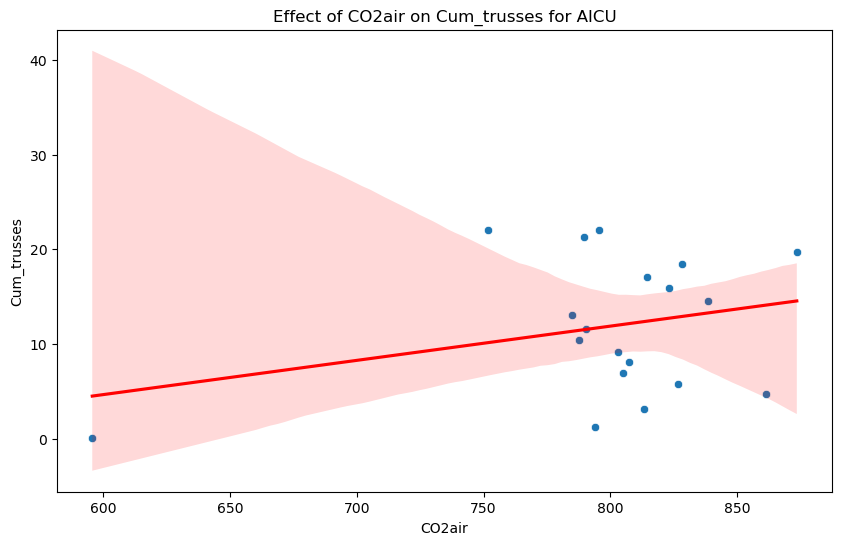

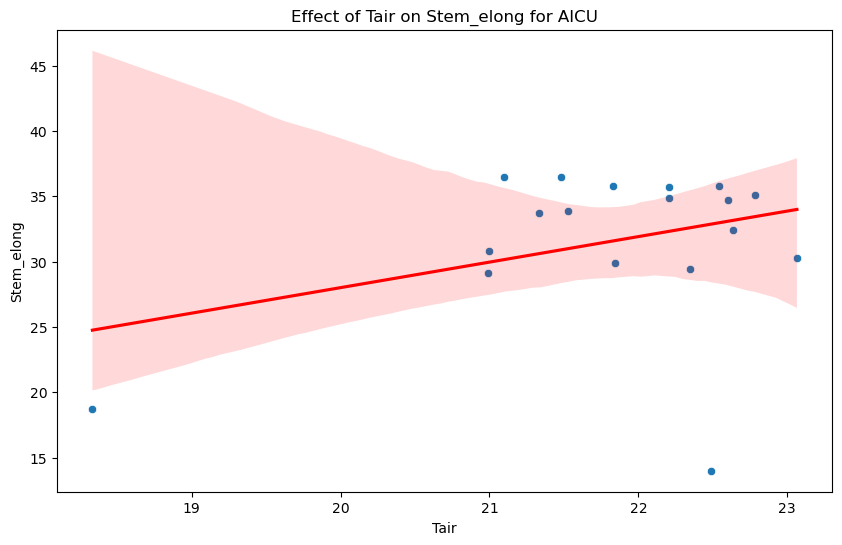

...

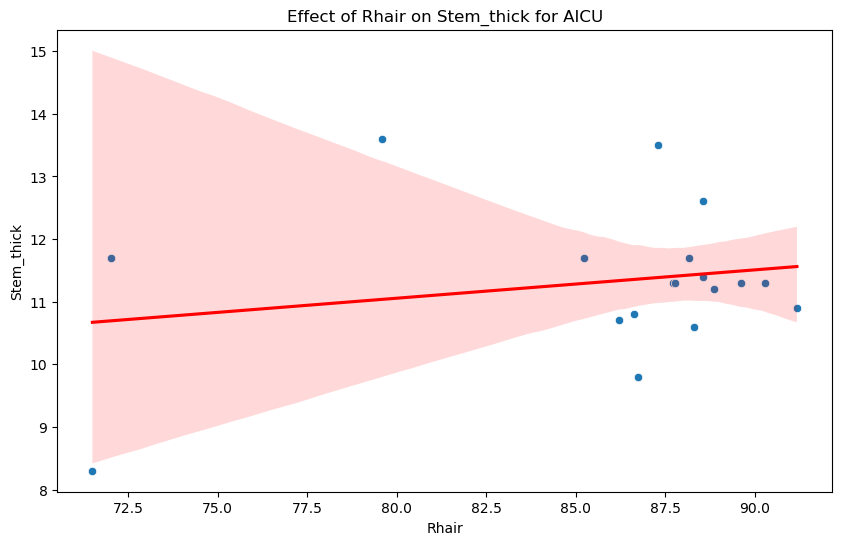

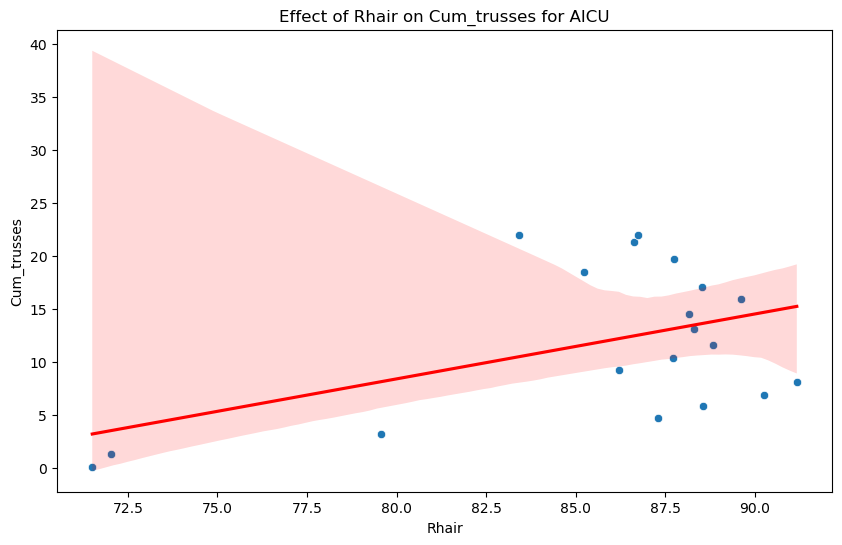

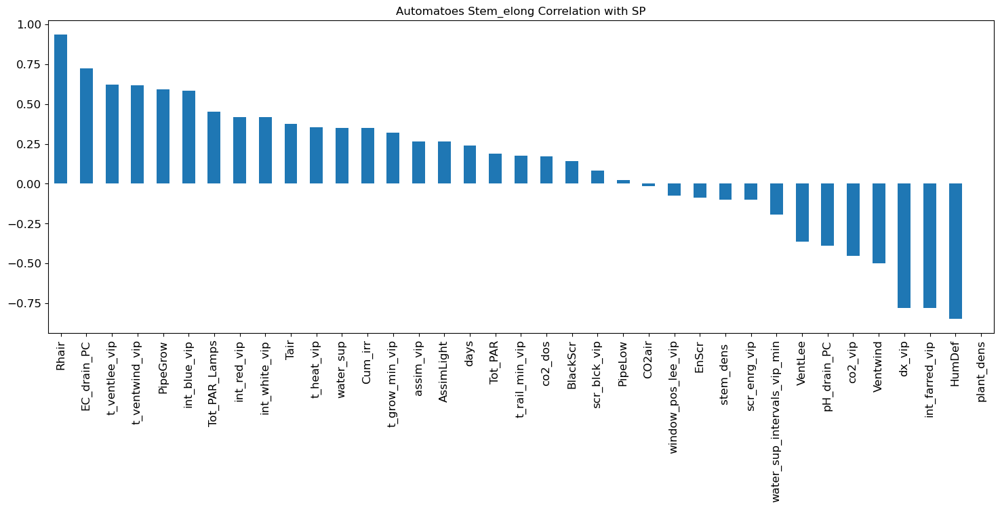

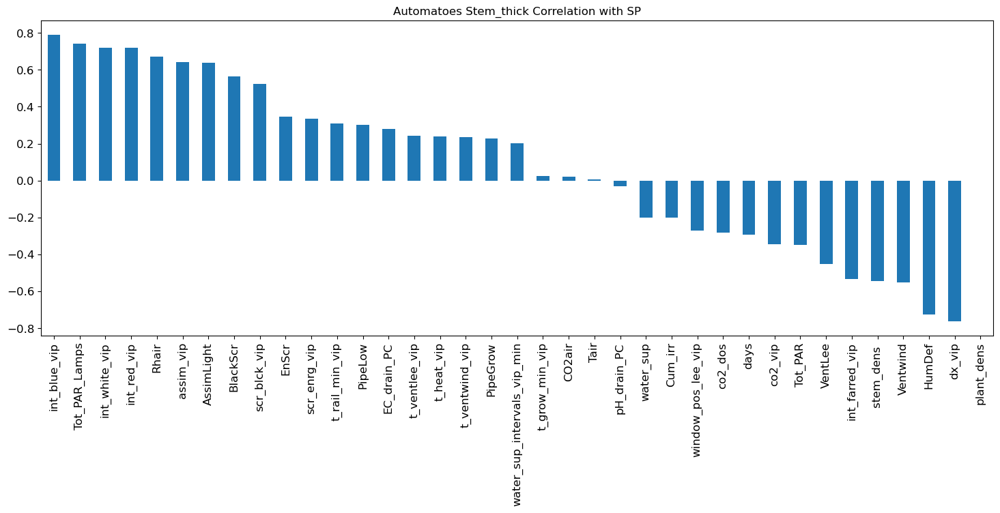

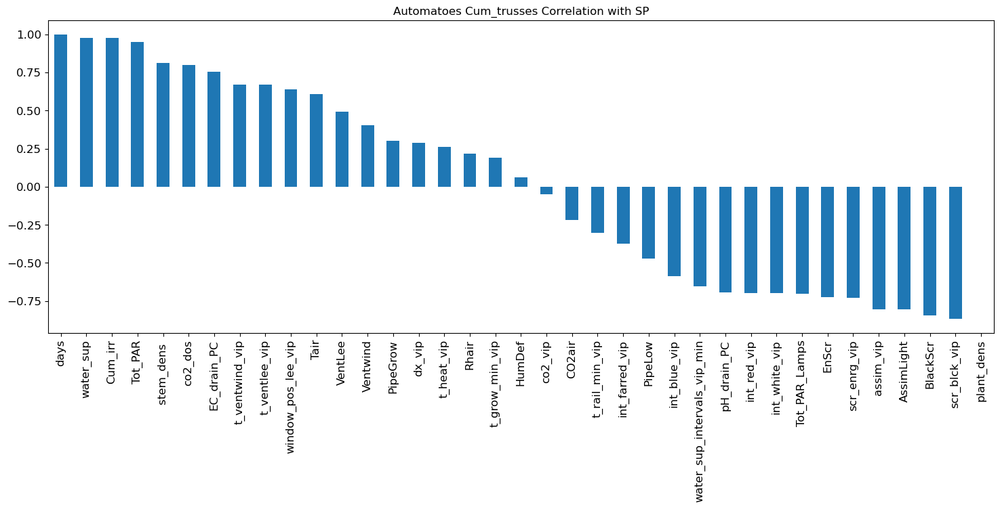

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



<Figure size 640x480 with 0 Axes>

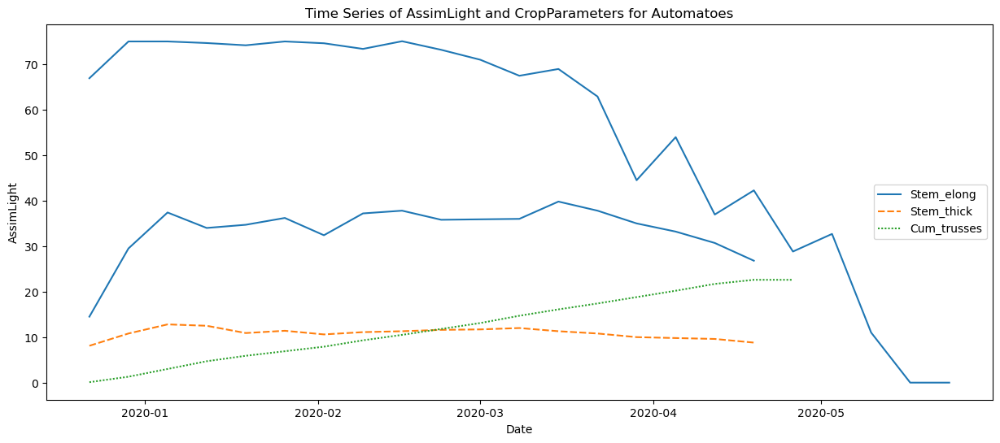

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



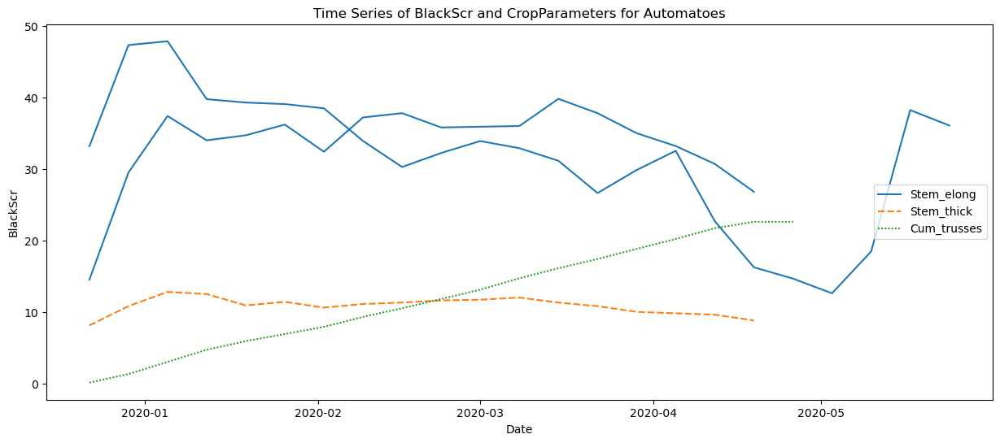

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



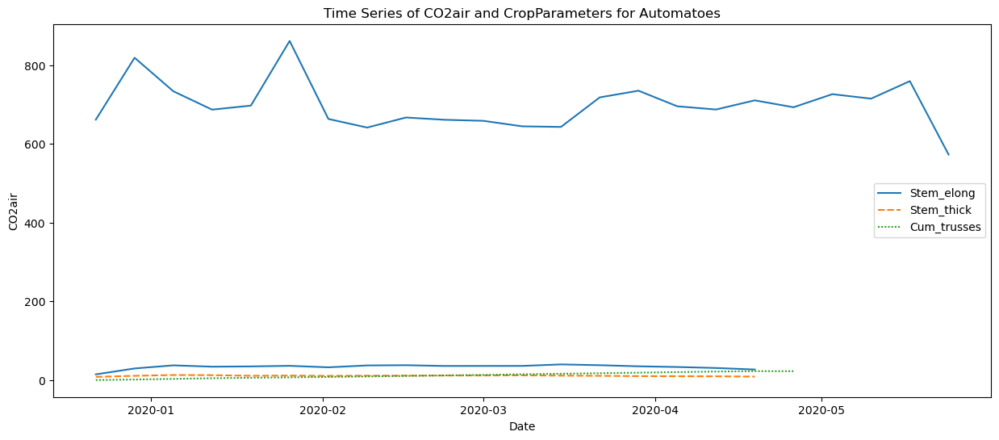

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



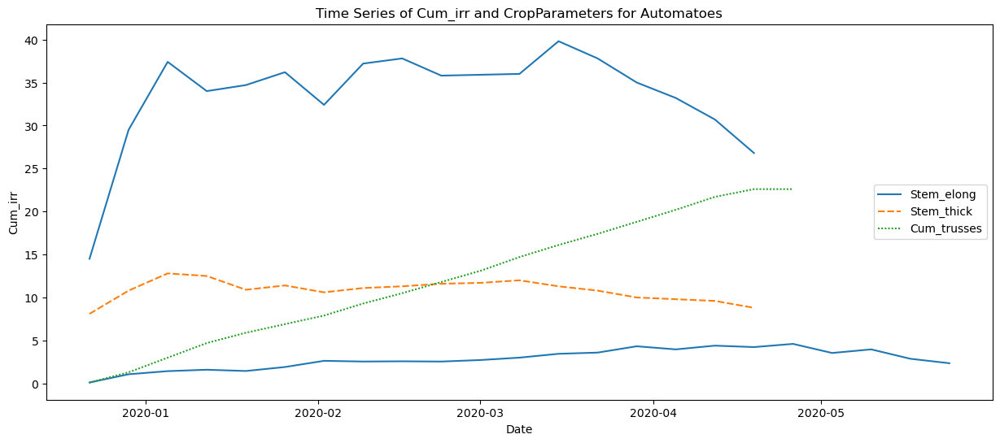

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



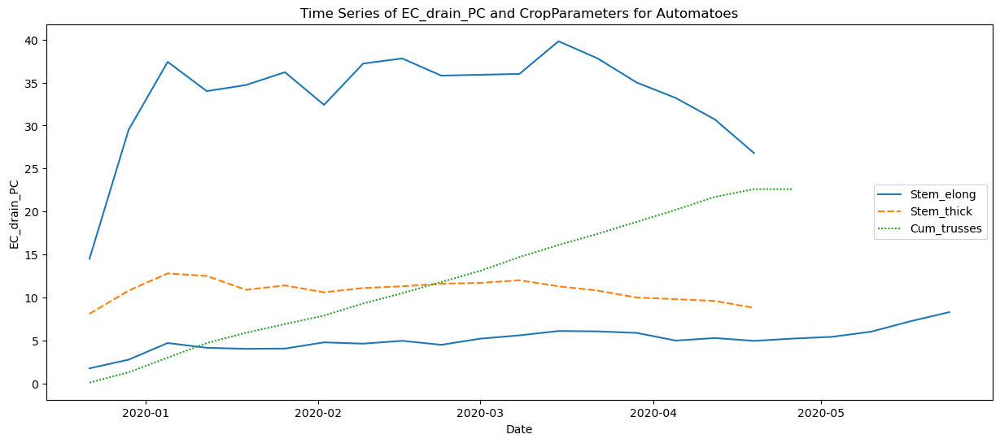

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



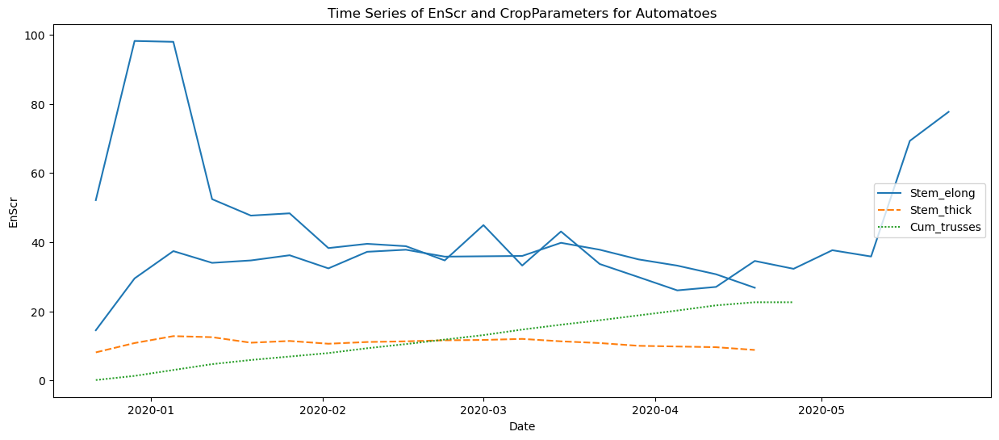

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



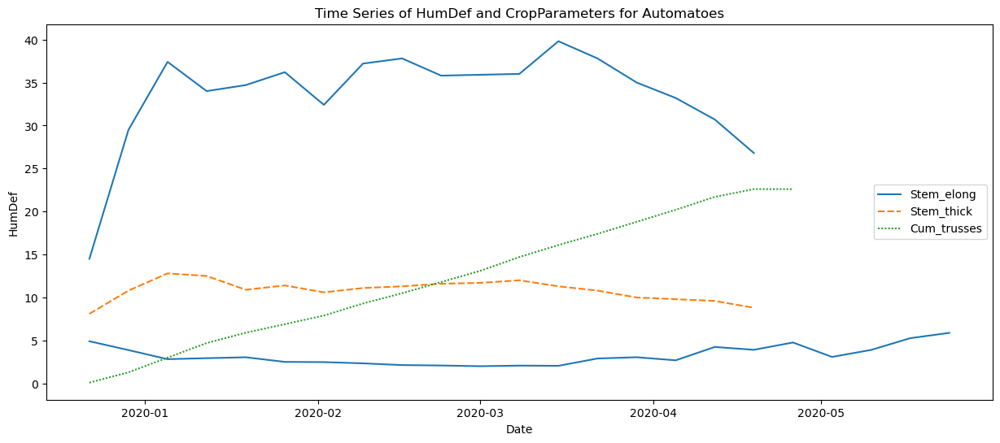

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



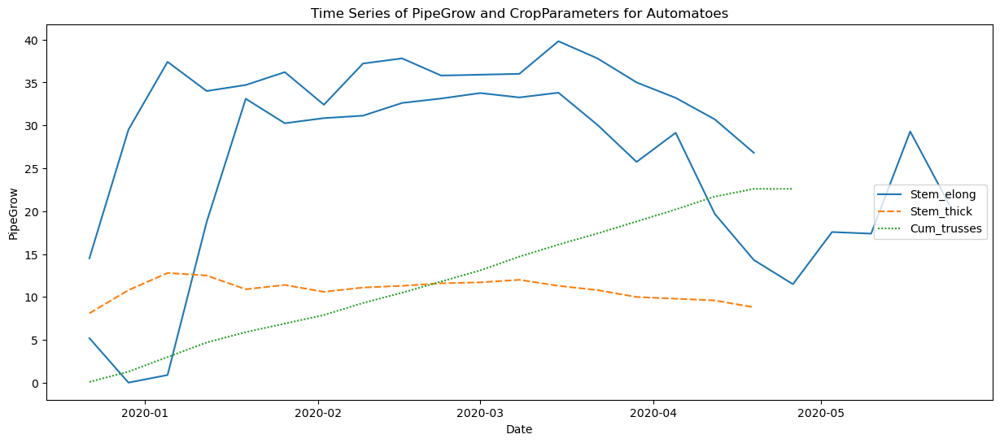

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



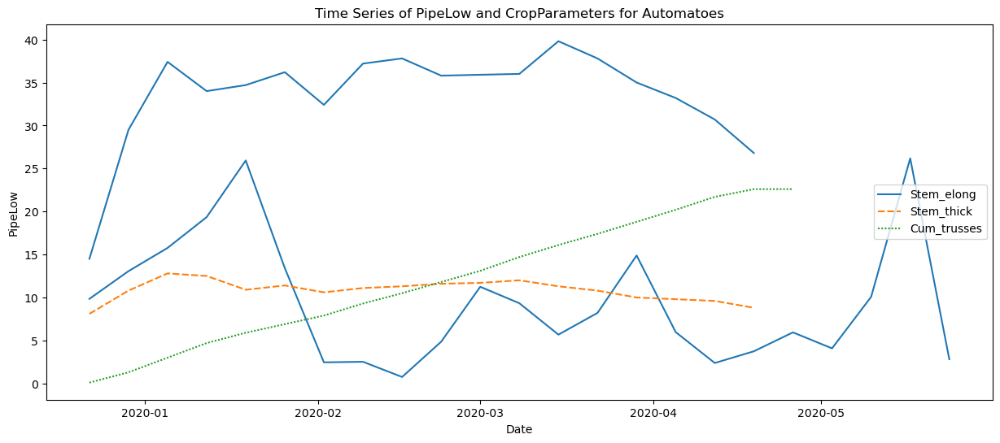

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



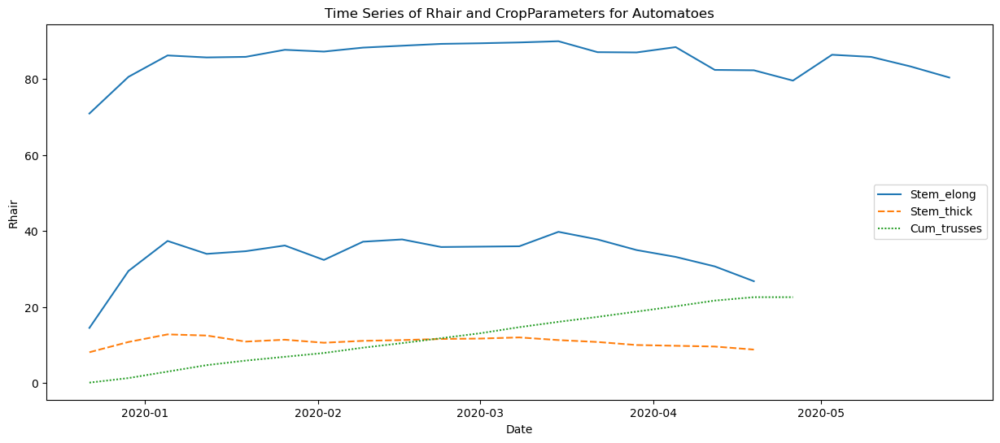

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



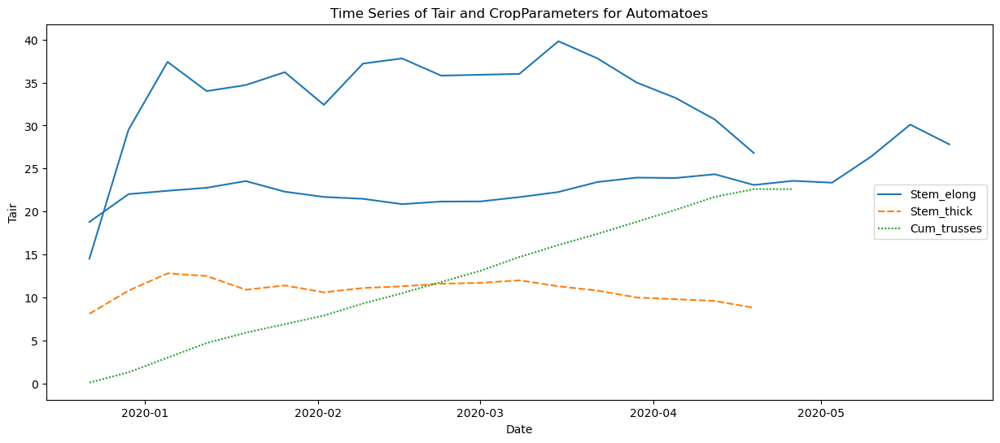

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



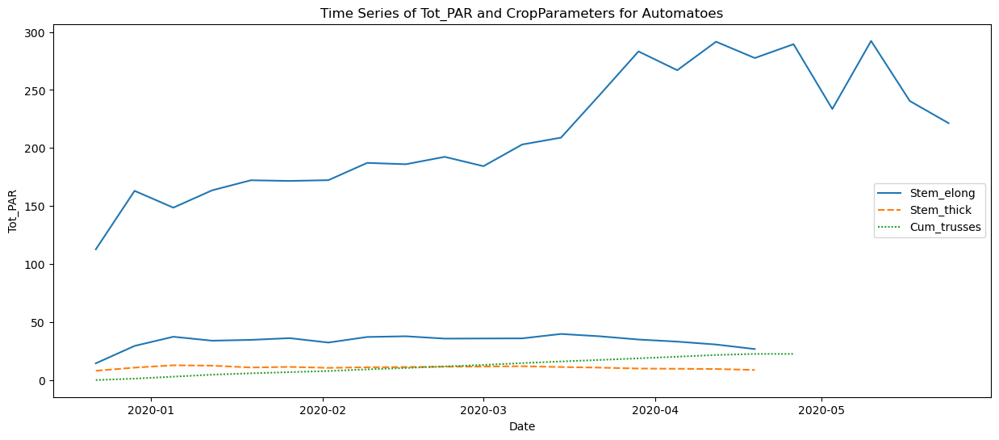

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



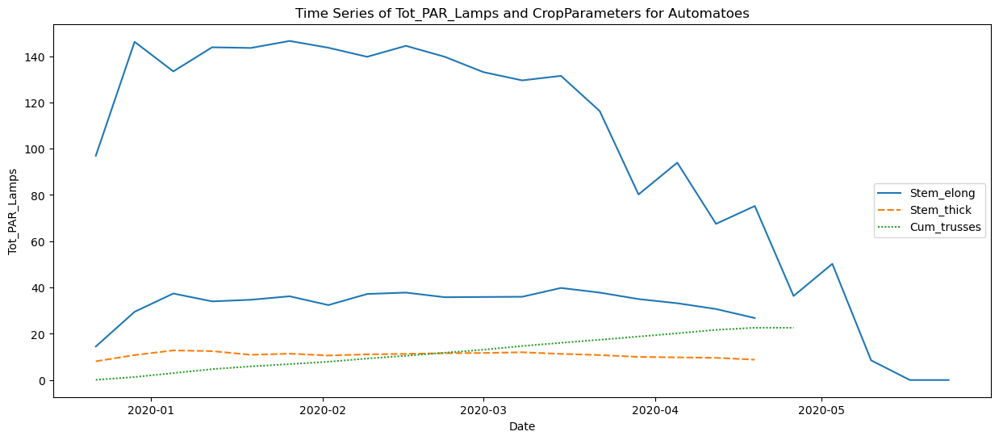

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



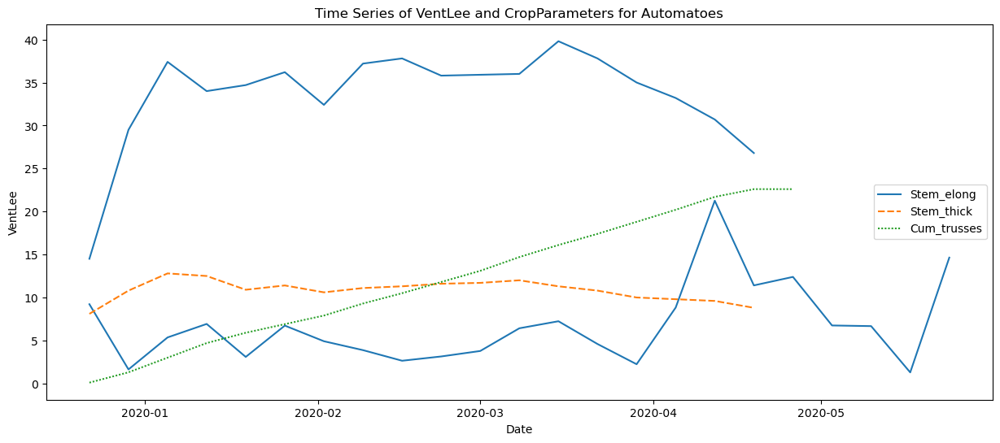

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



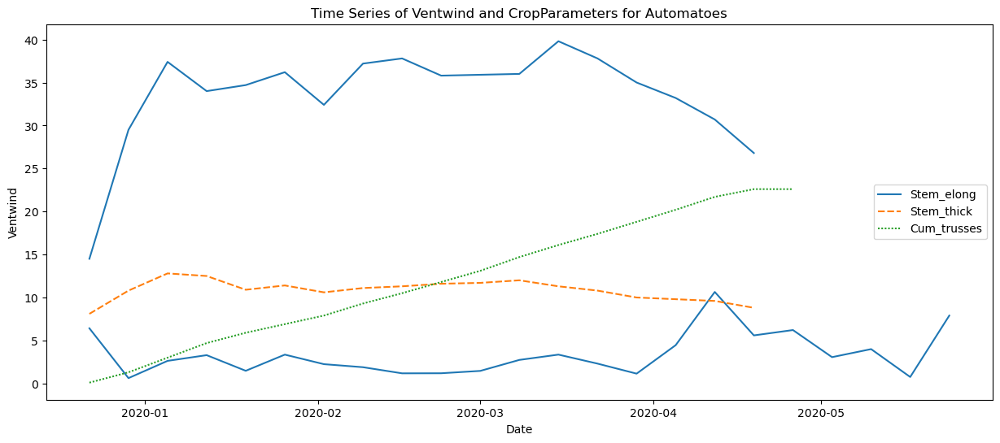

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



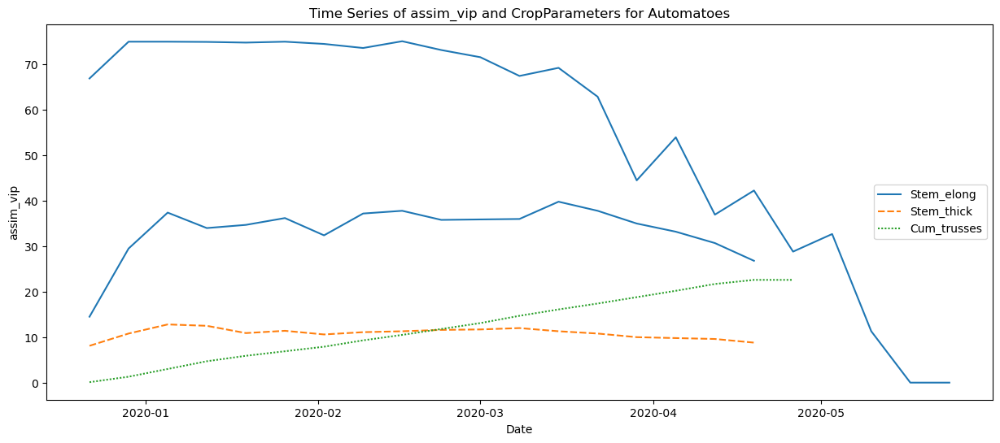

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



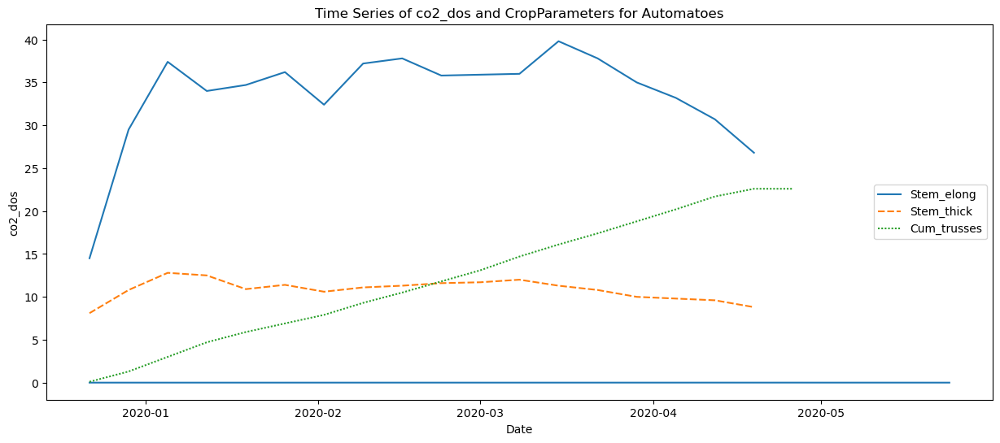

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



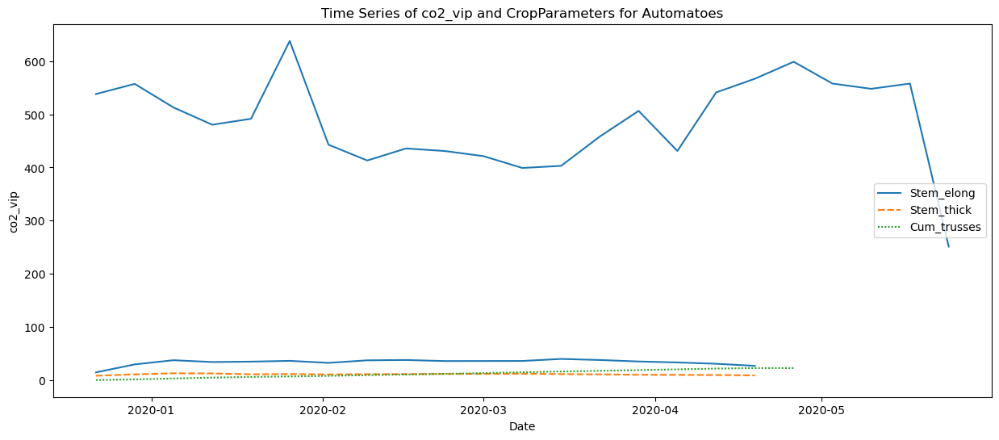

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



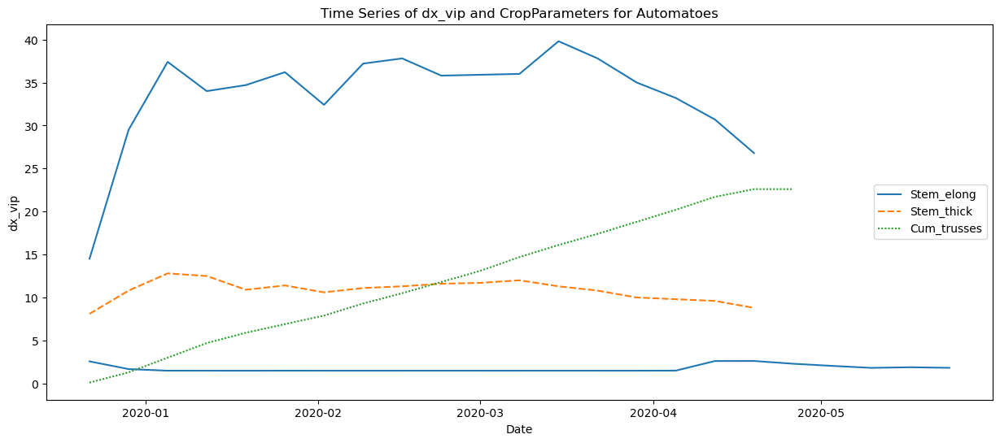

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



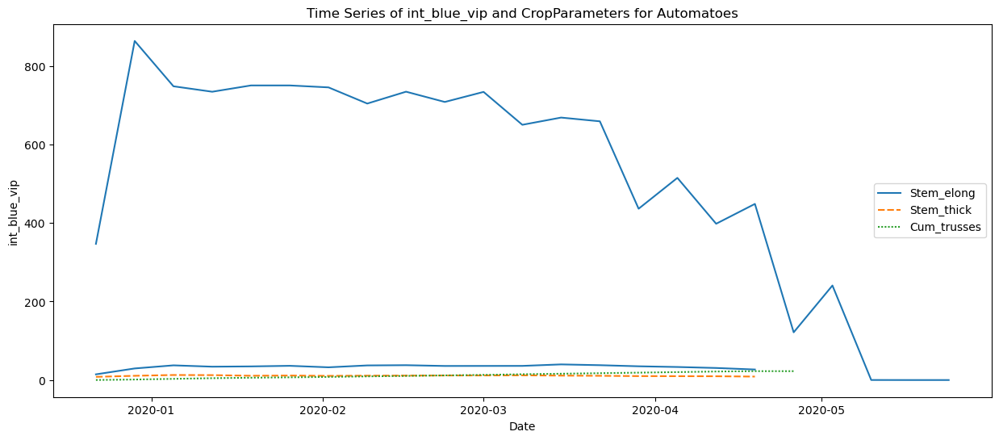

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



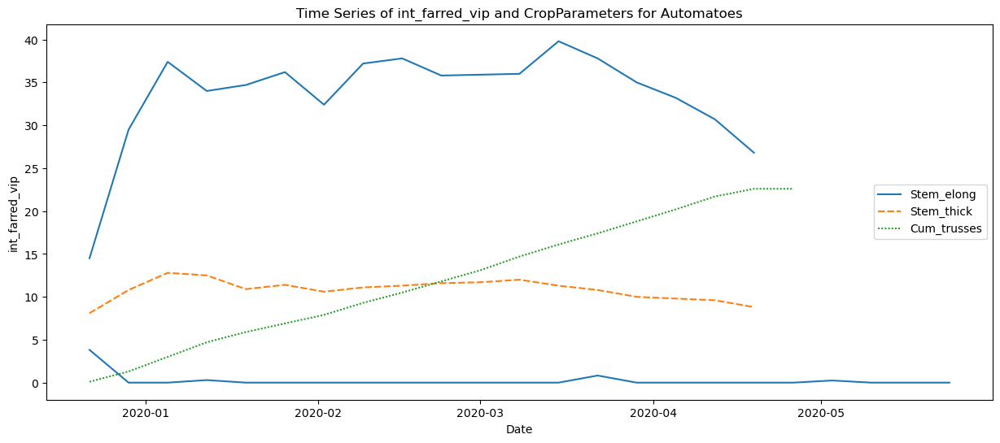

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



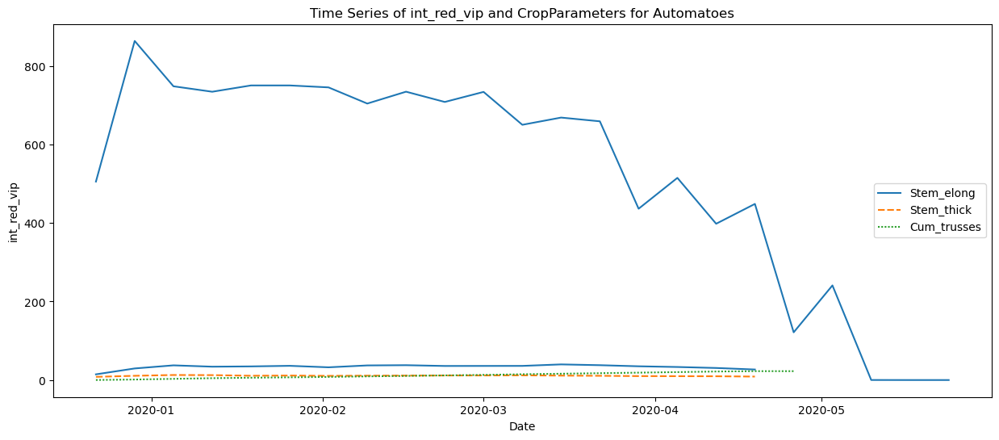

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



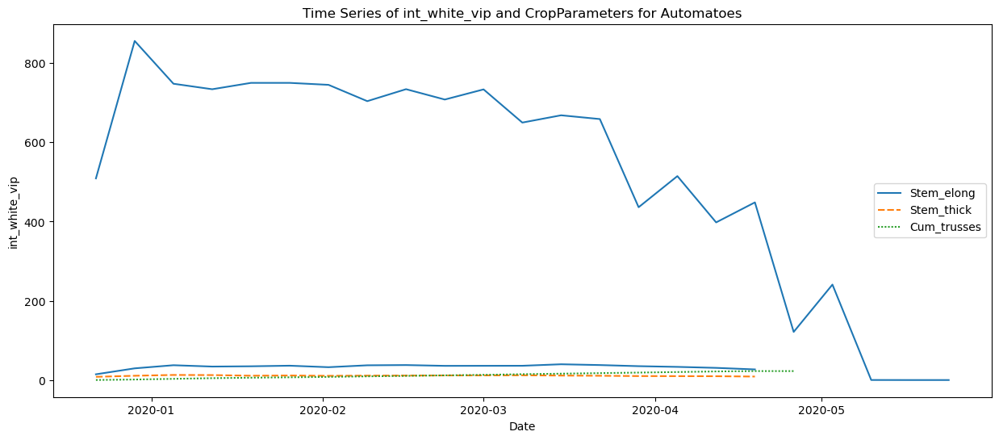

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



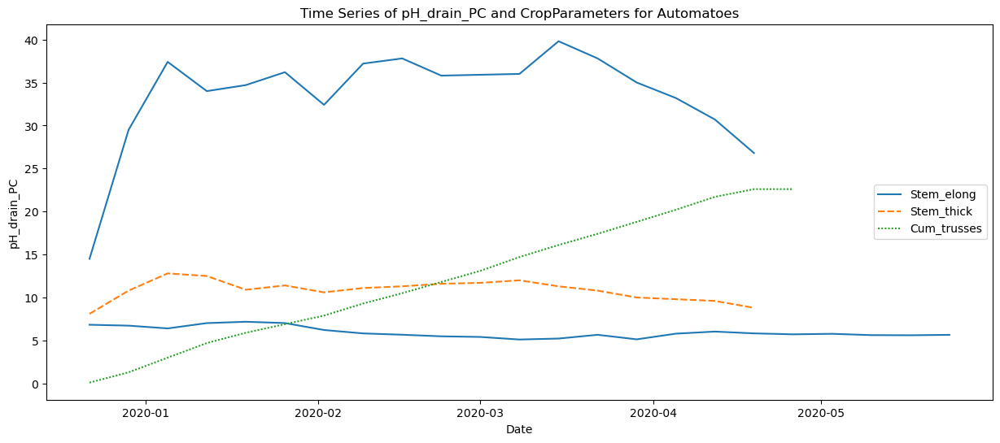

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



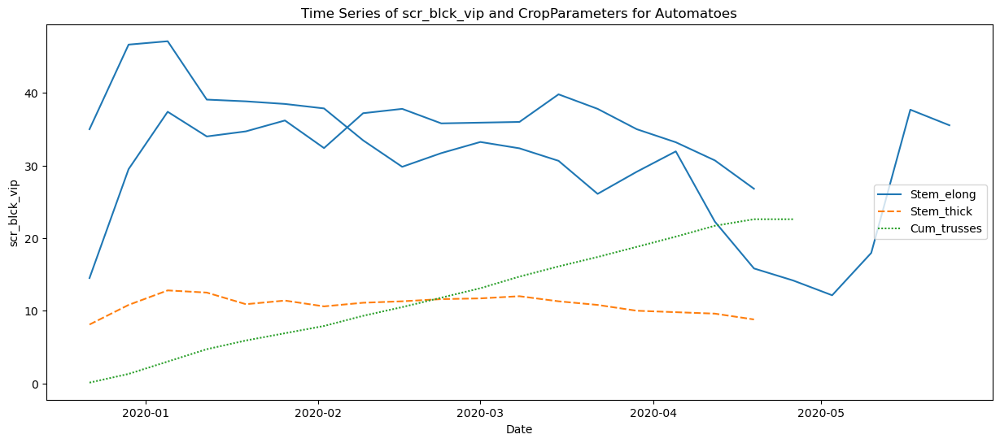

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



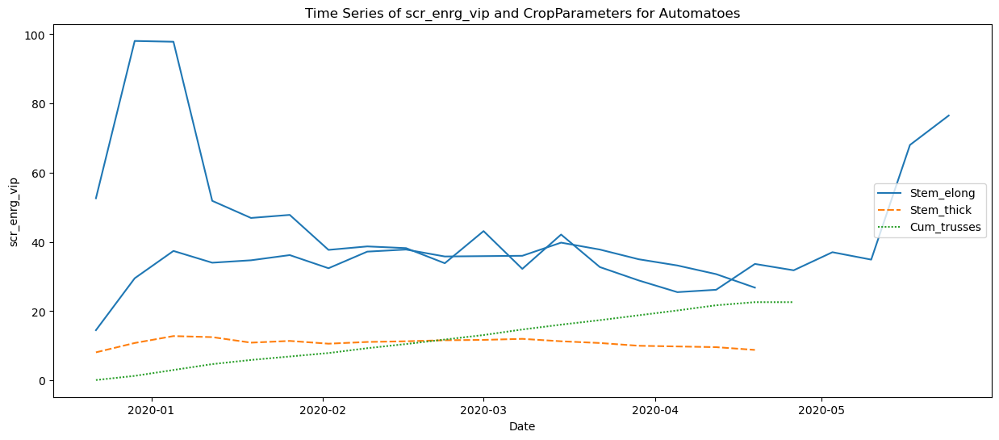

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



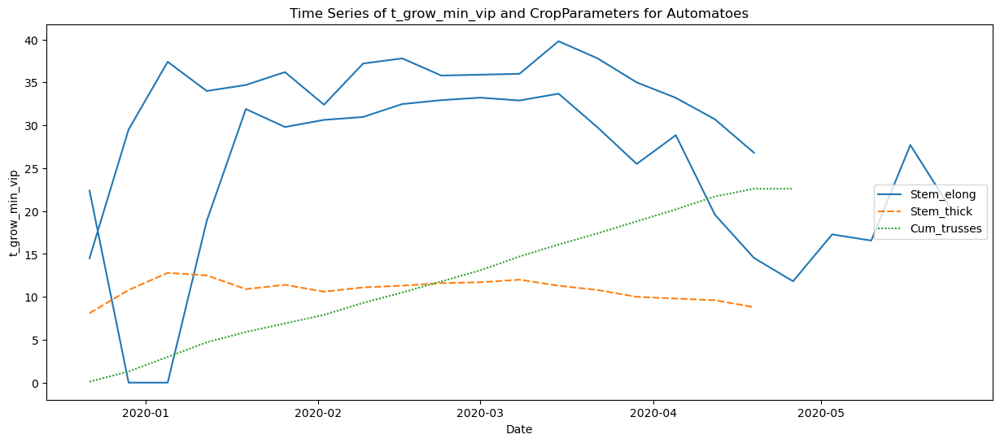

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



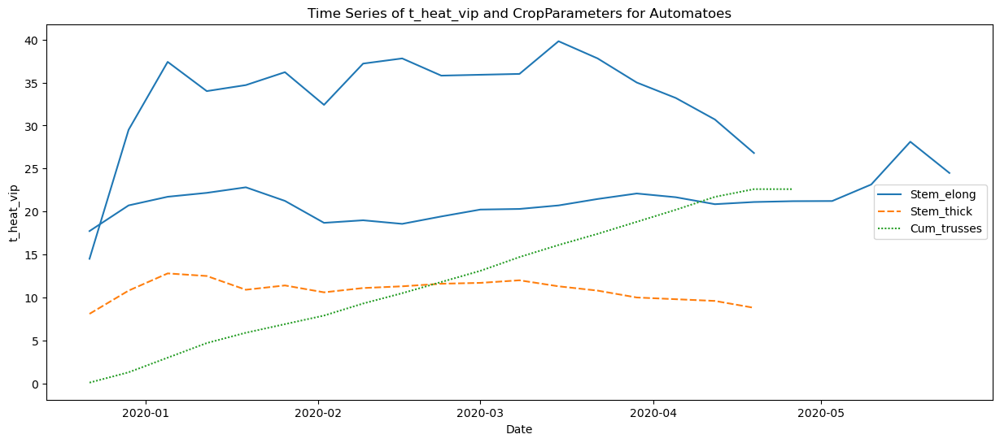

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



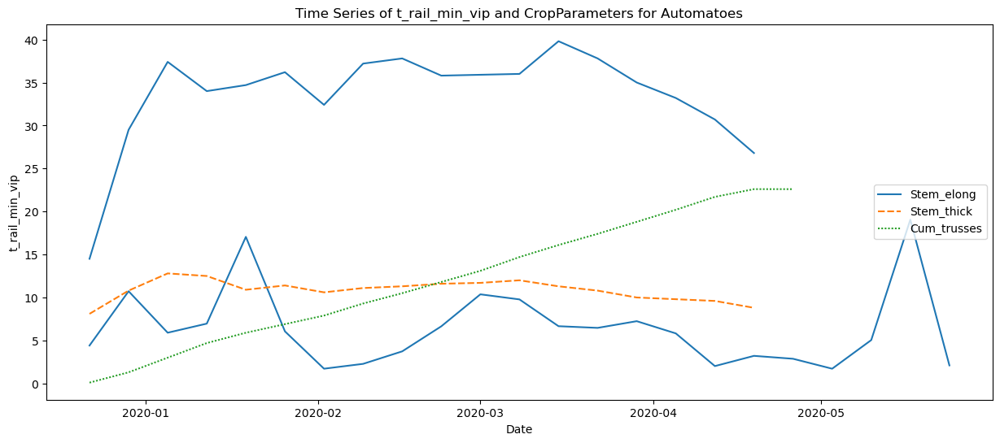

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



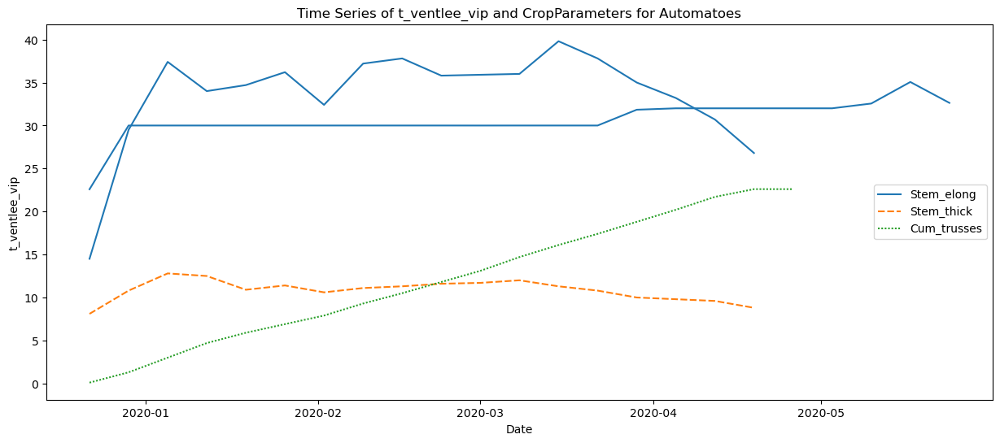

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



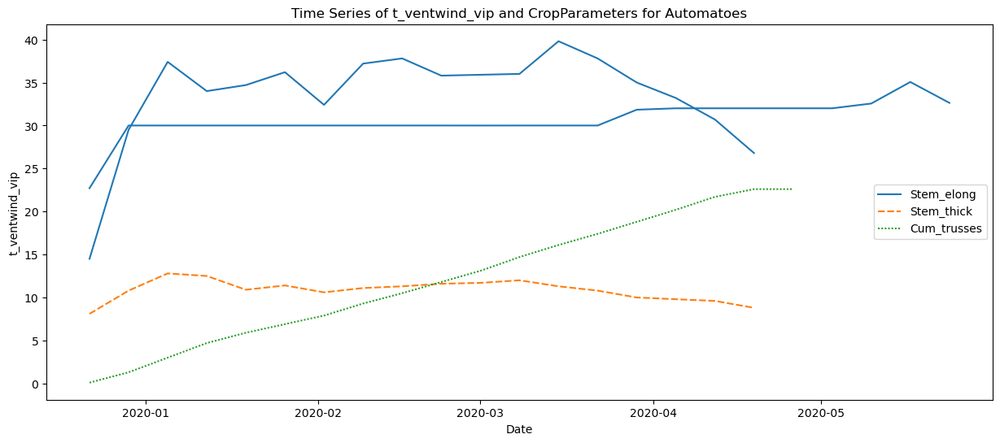

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



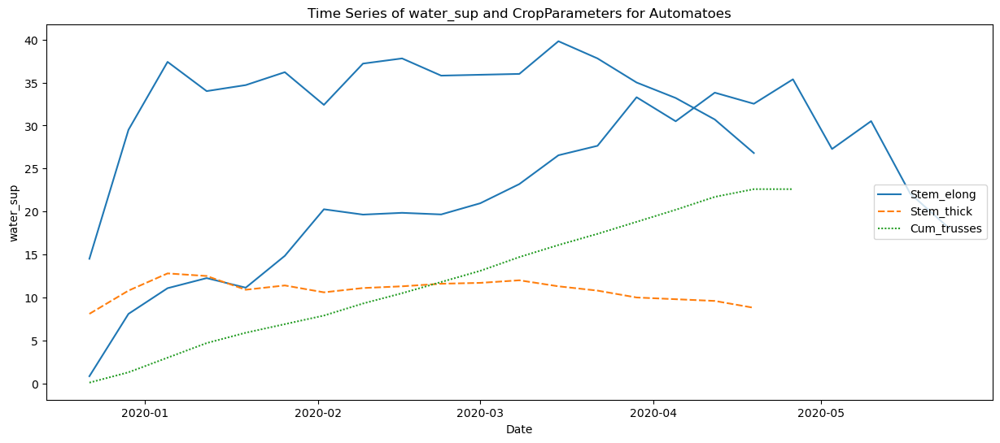

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



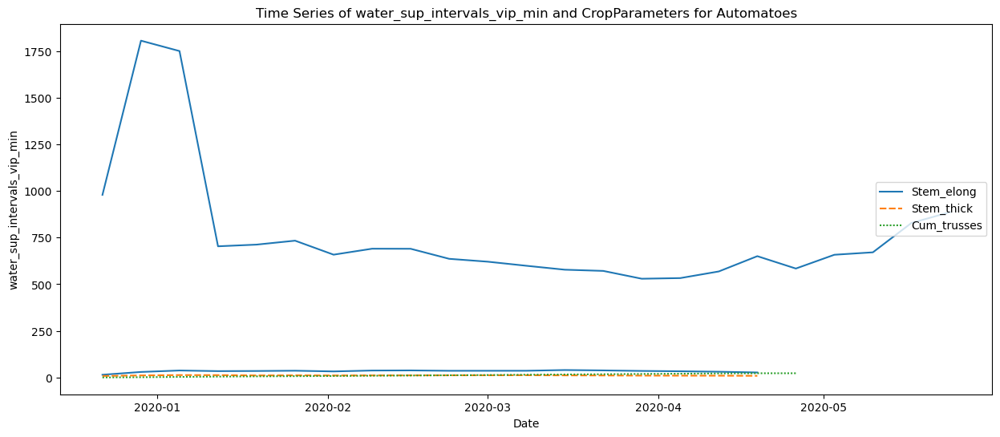

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



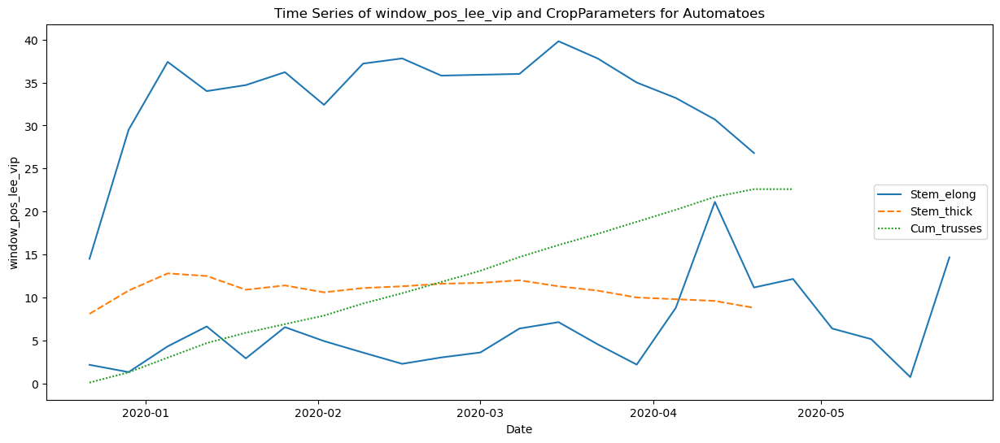

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



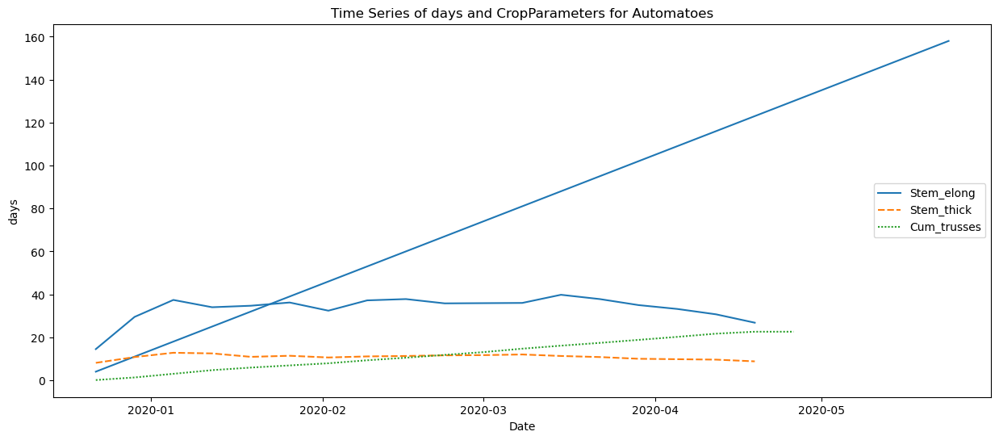

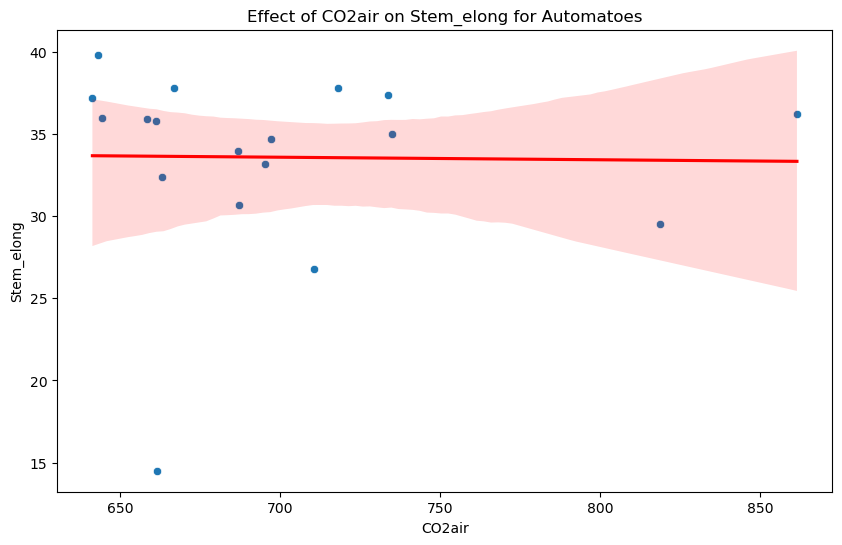

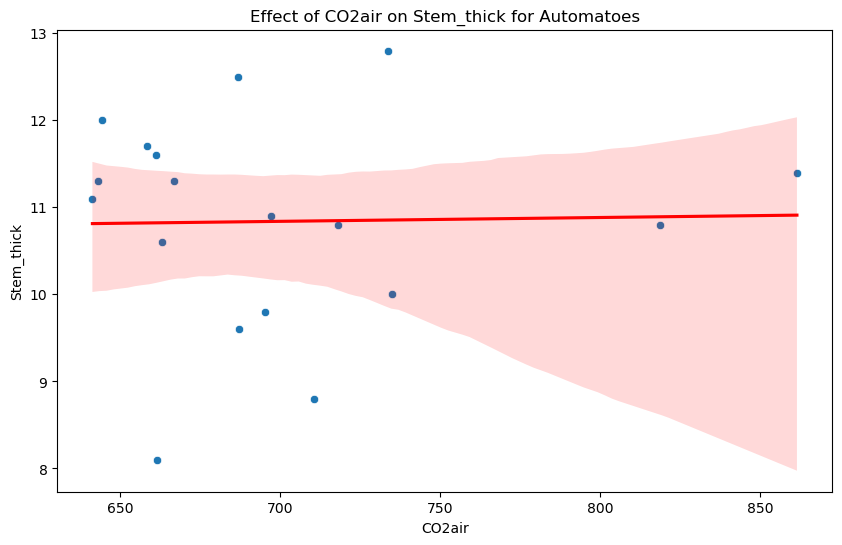

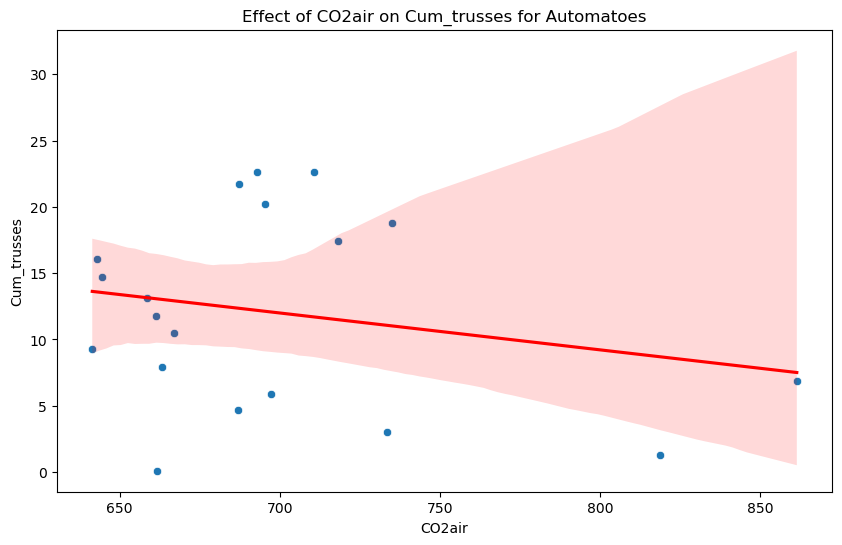

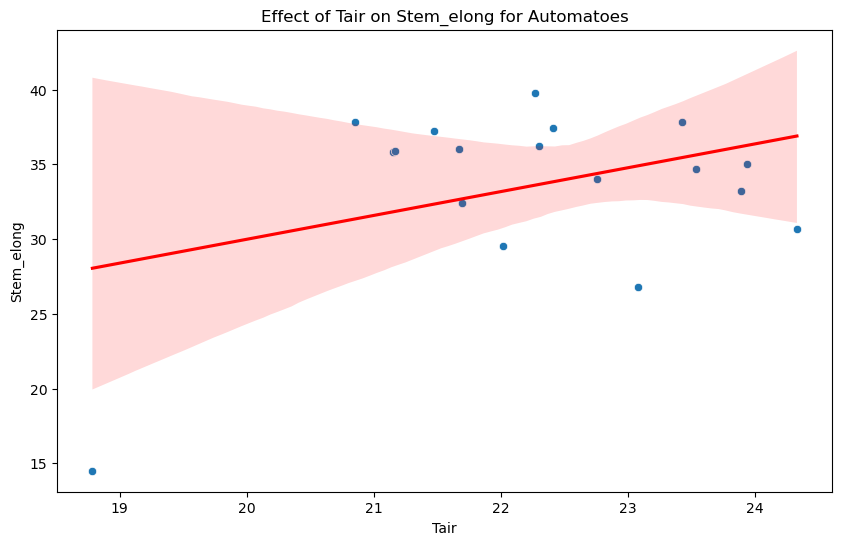

...

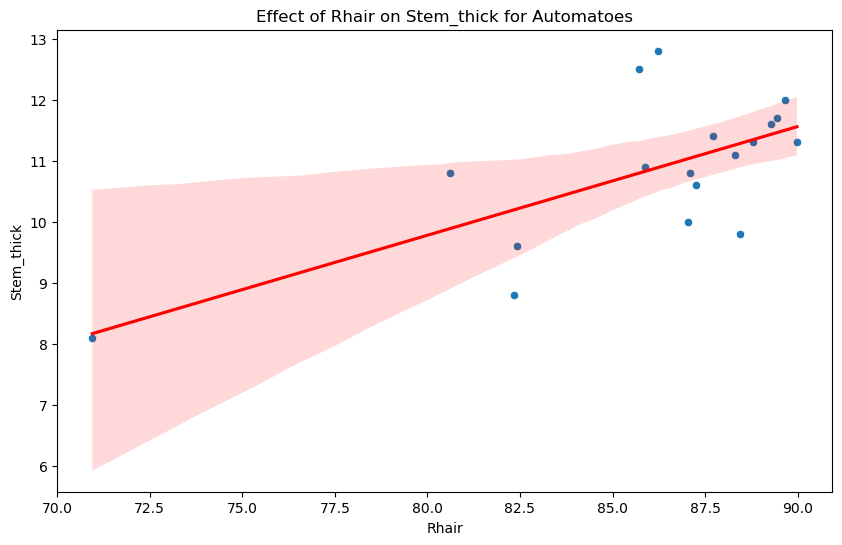

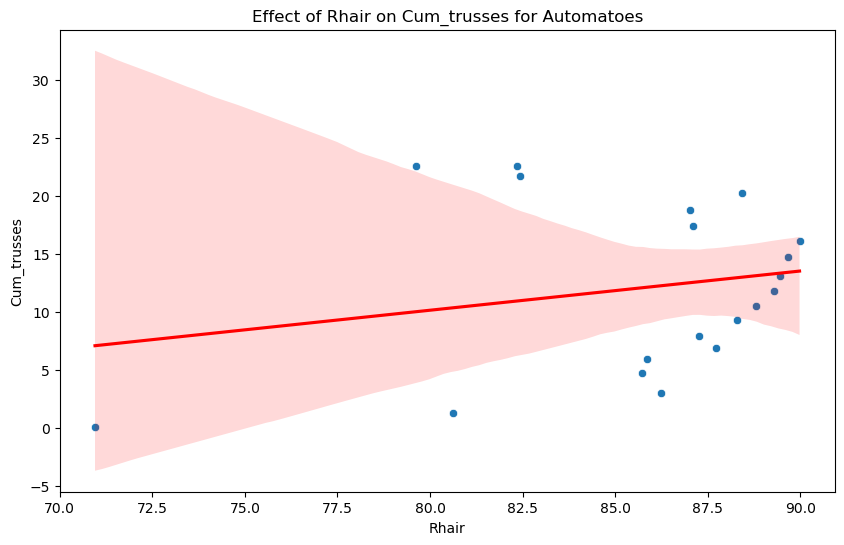

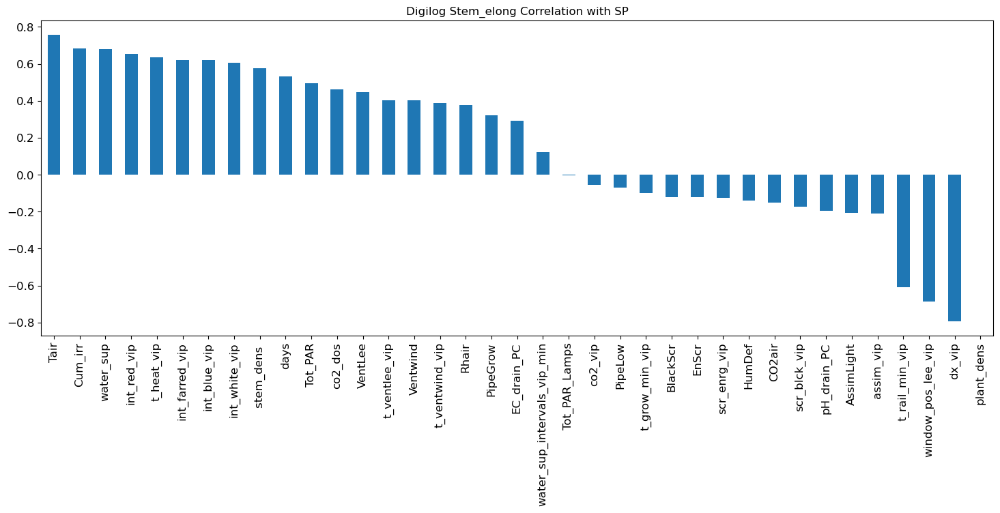

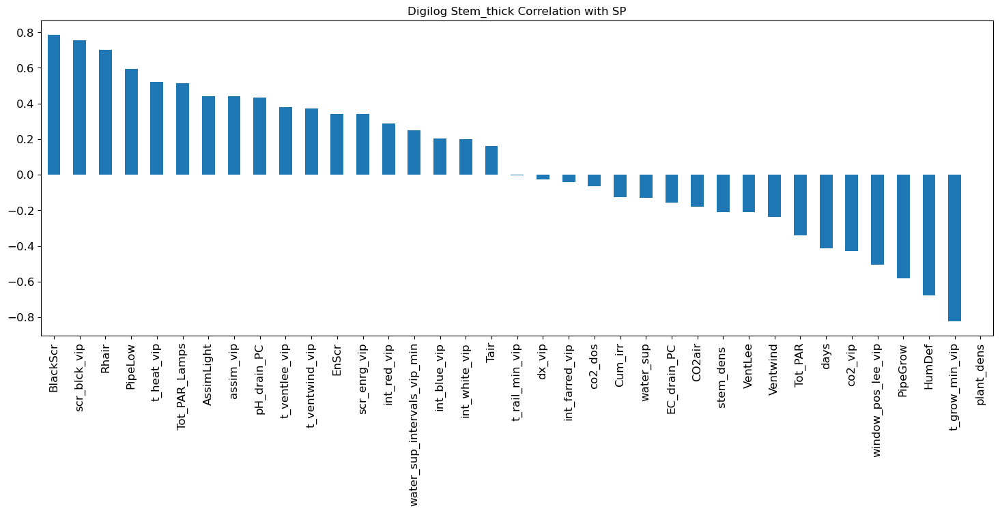

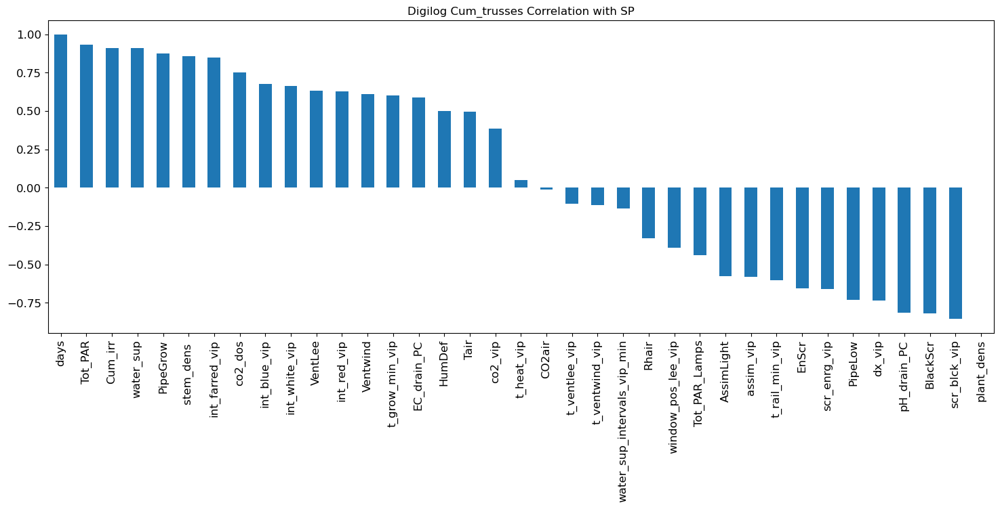

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



<Figure size 640x480 with 0 Axes>

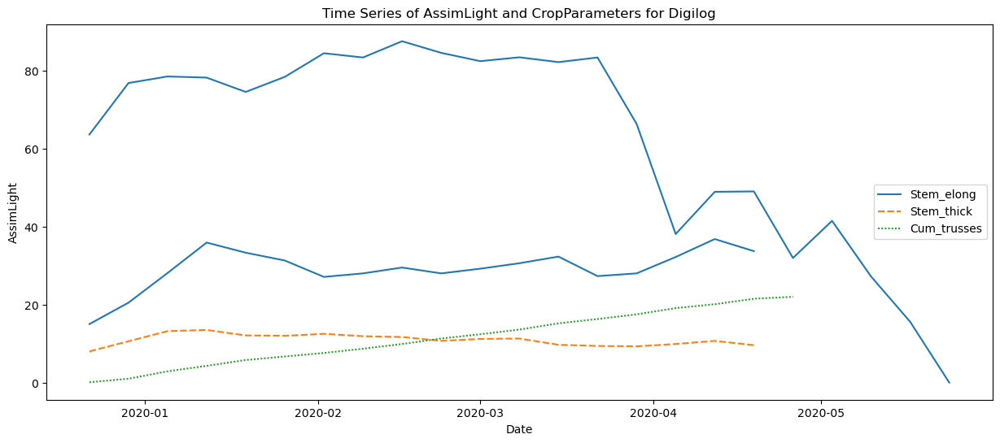

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



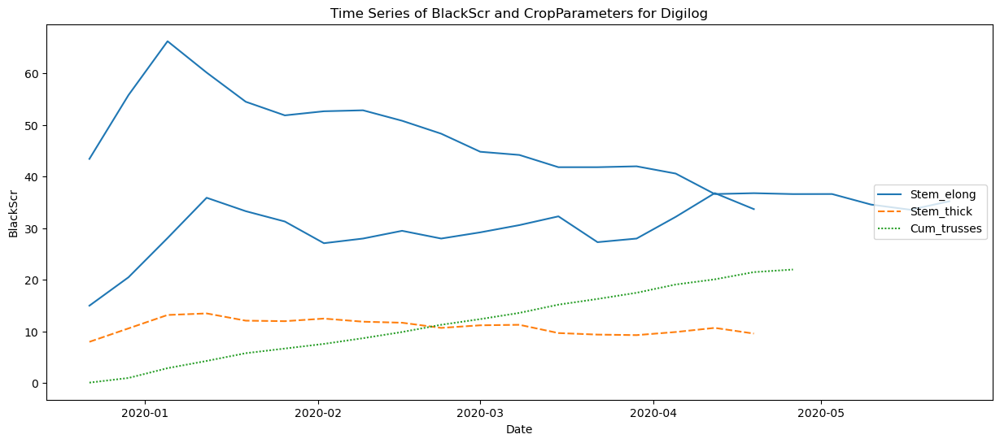

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



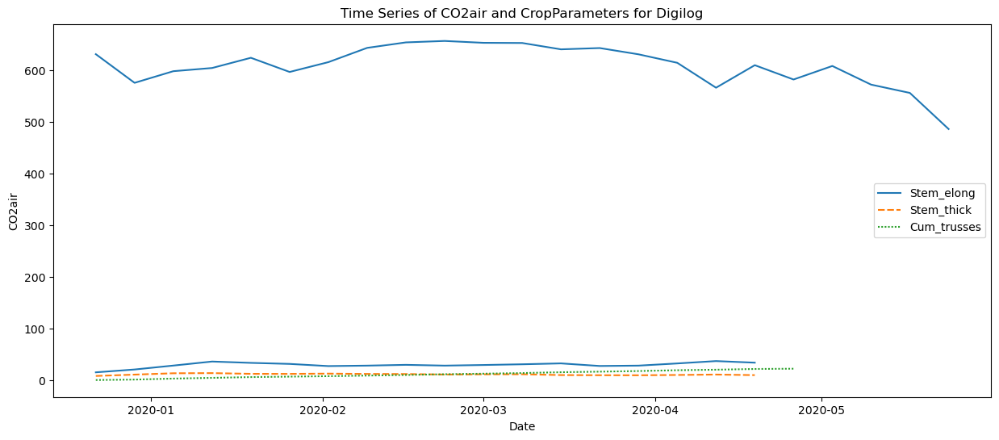

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



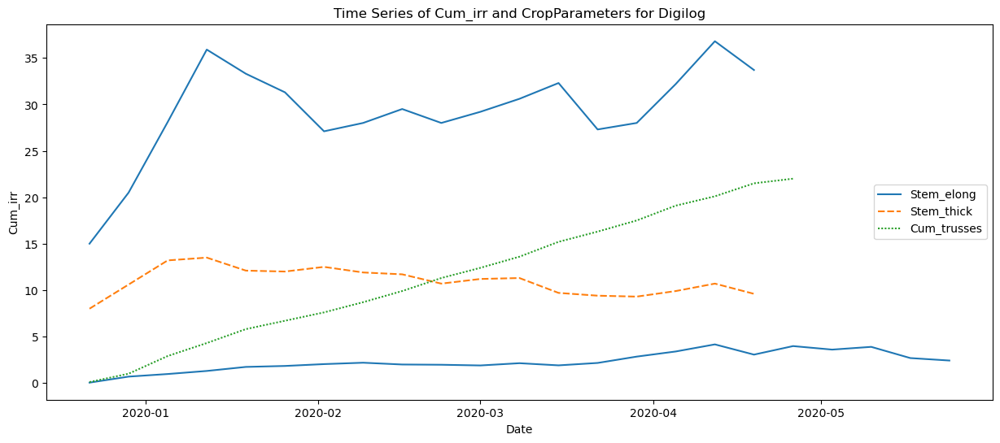

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



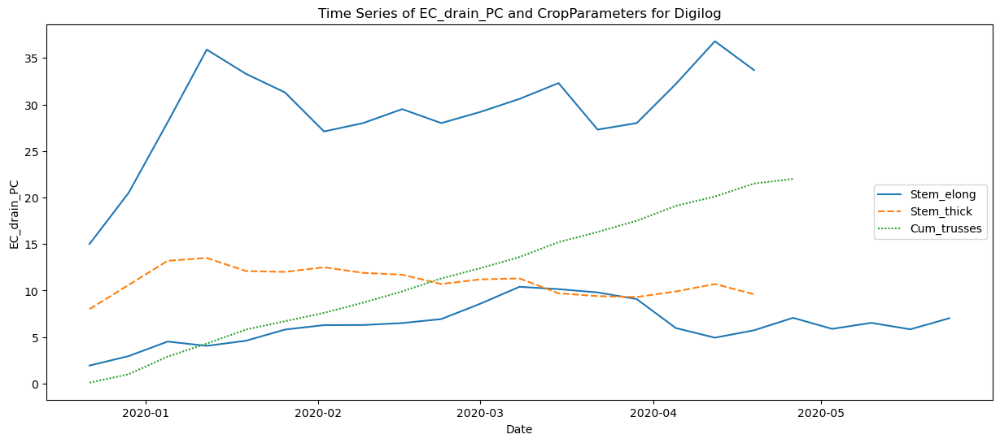

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



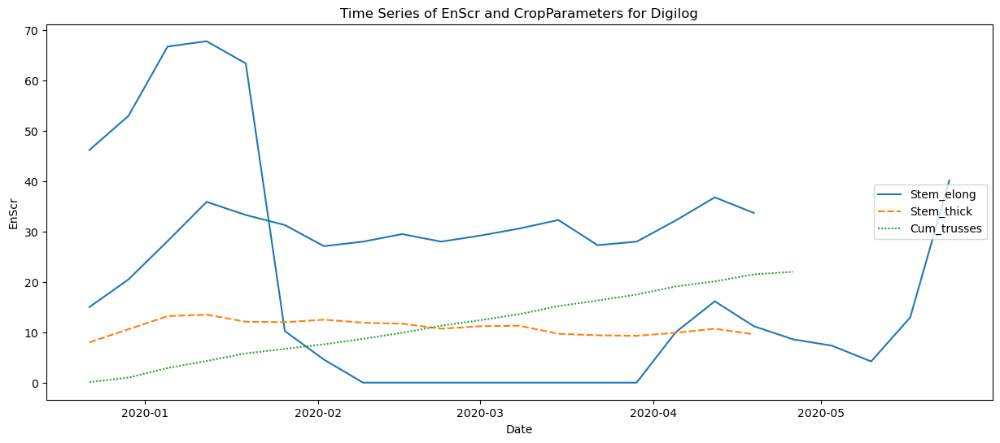

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



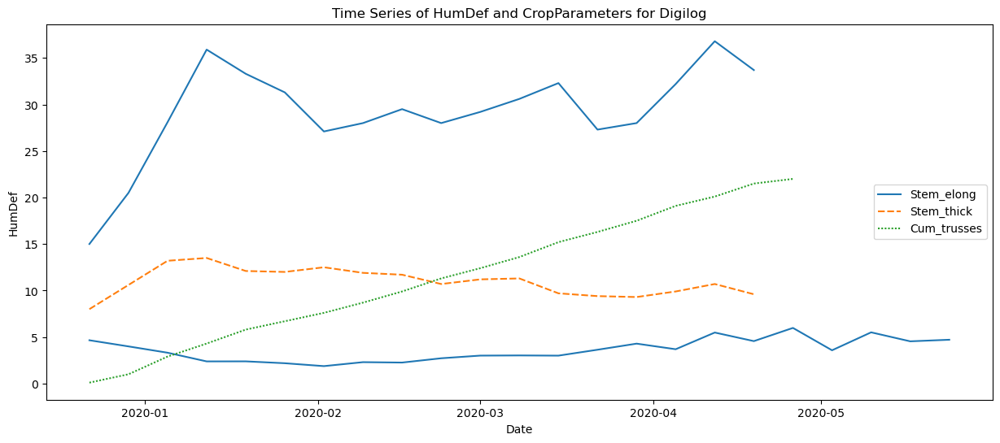

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



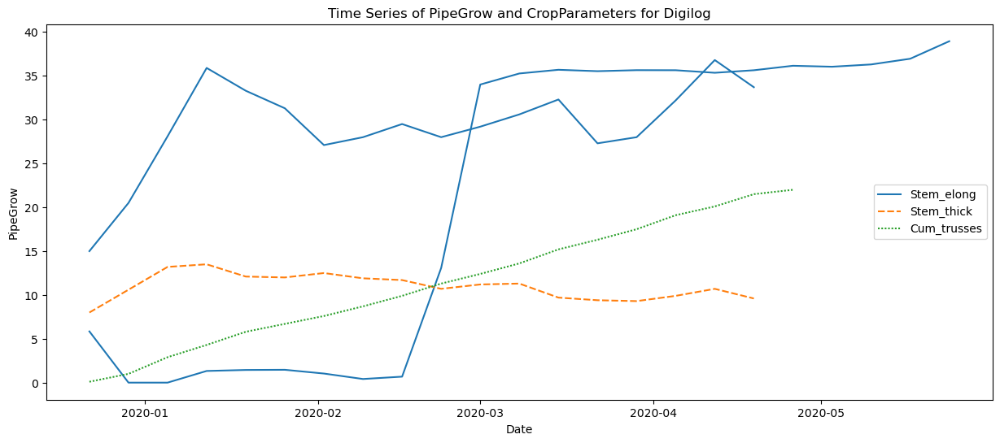

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



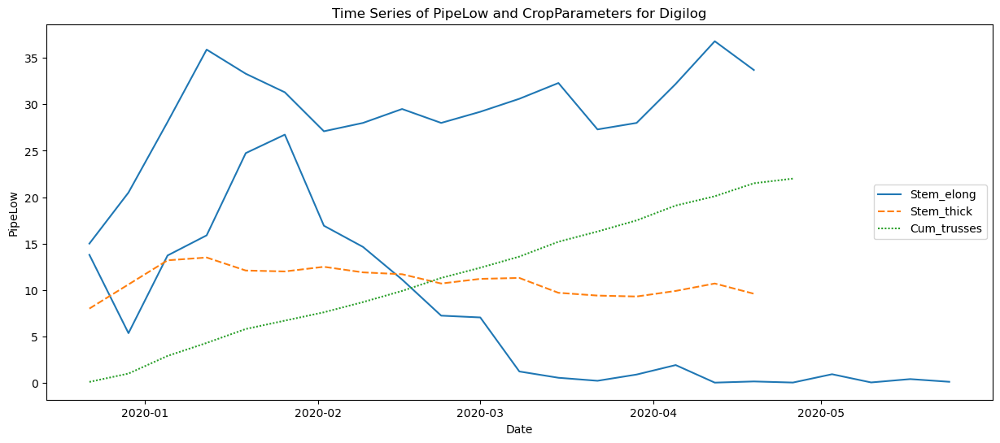

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



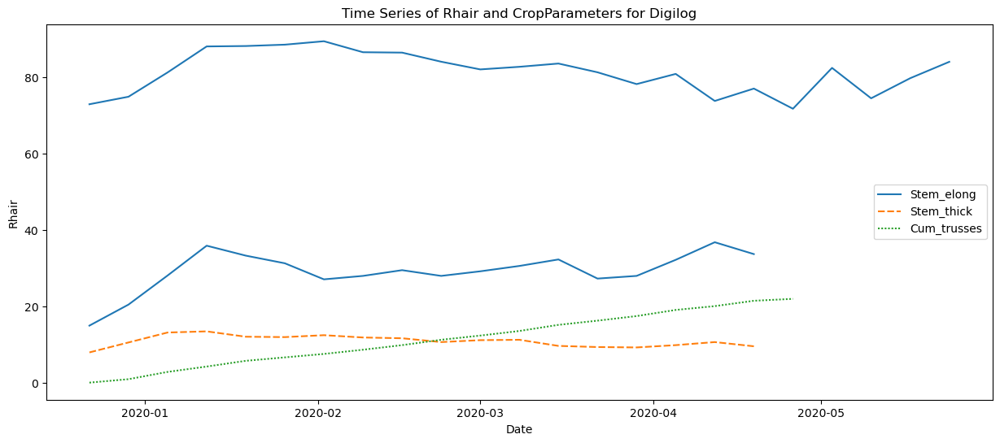

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



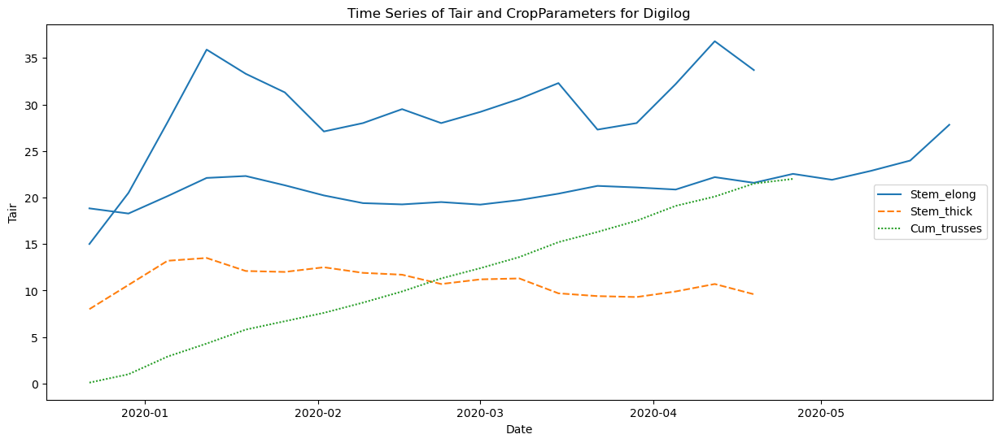

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



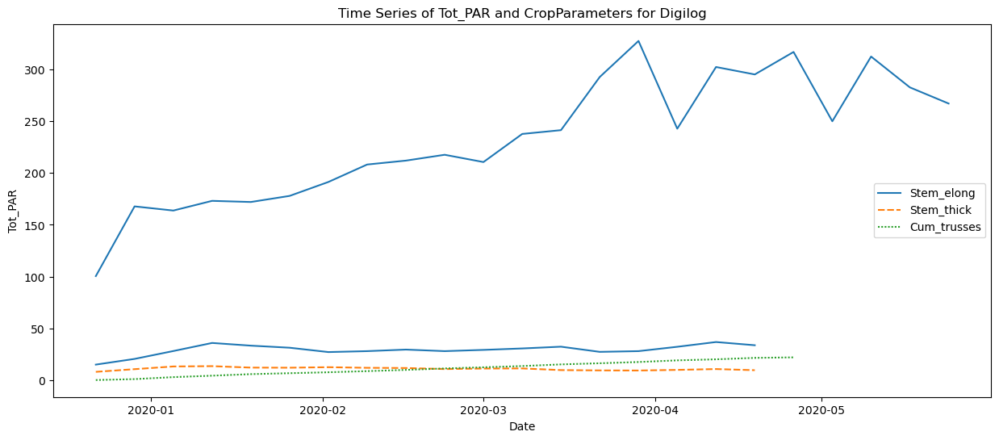

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



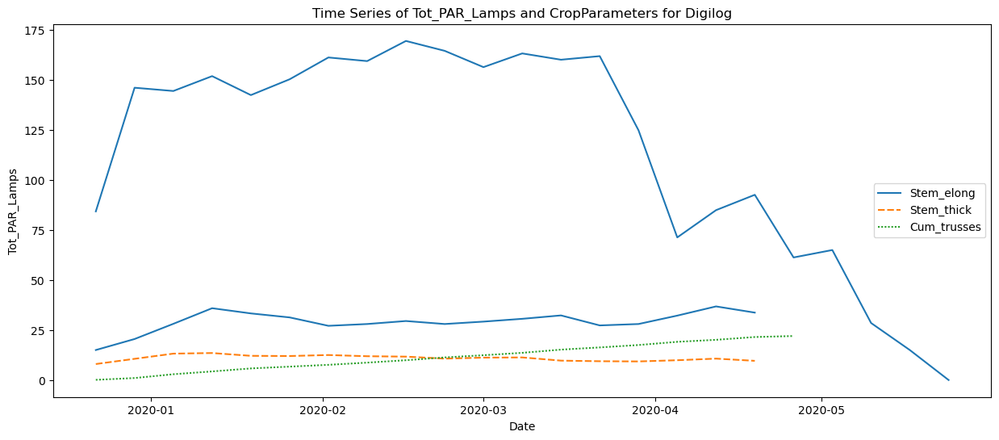

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



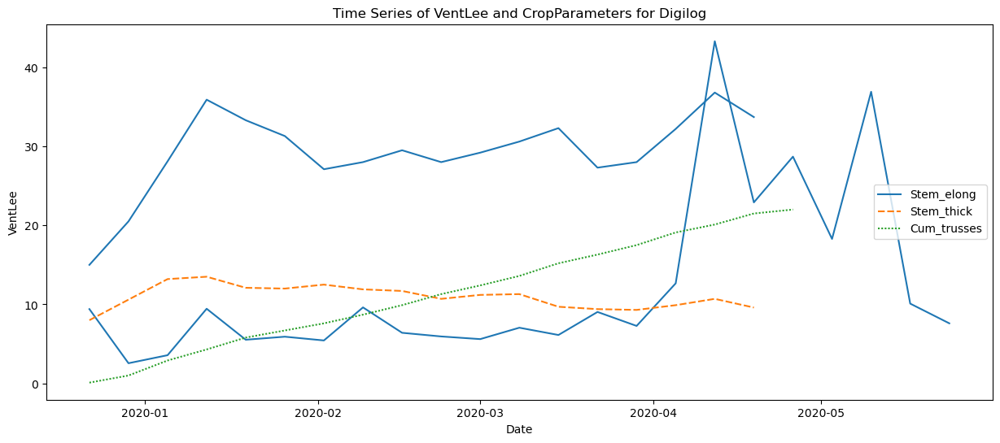

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



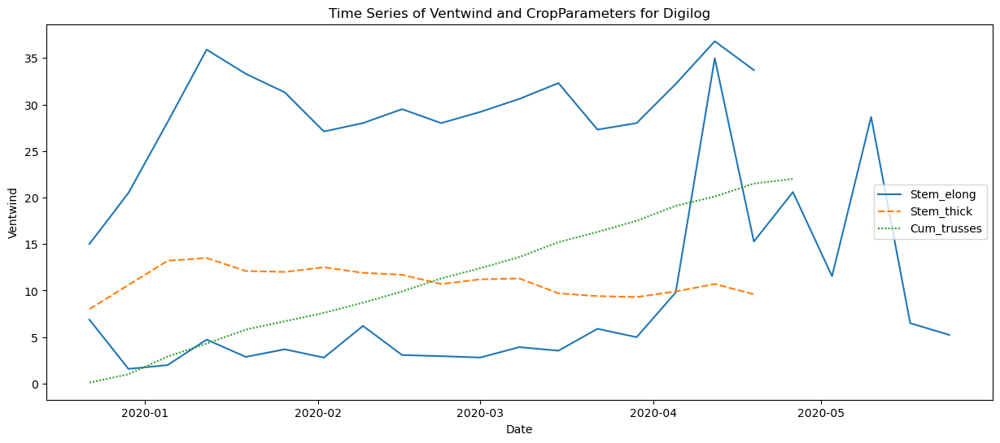

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



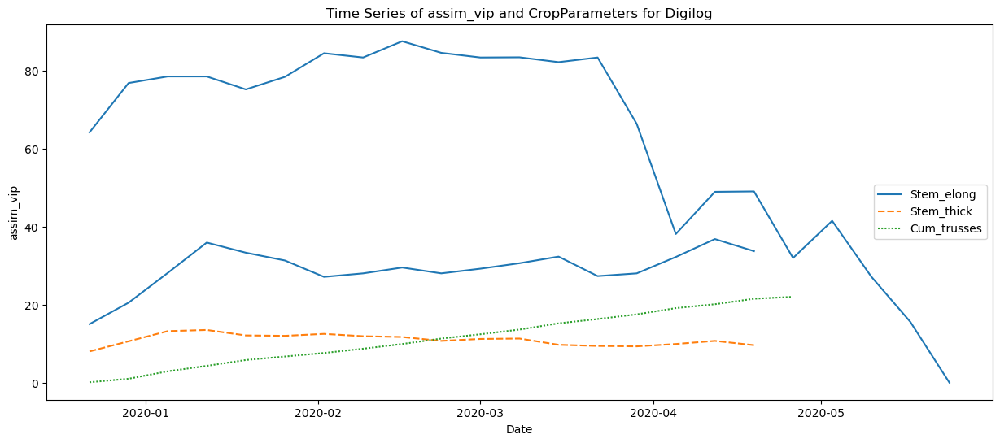

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



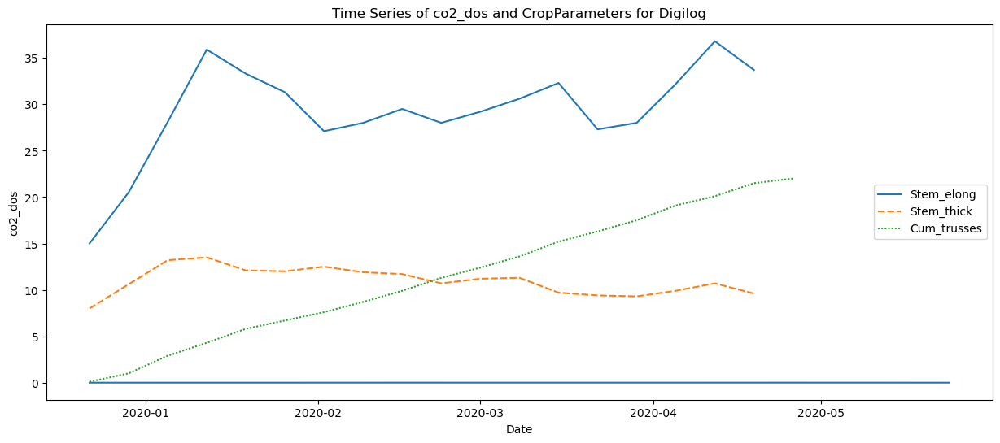

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



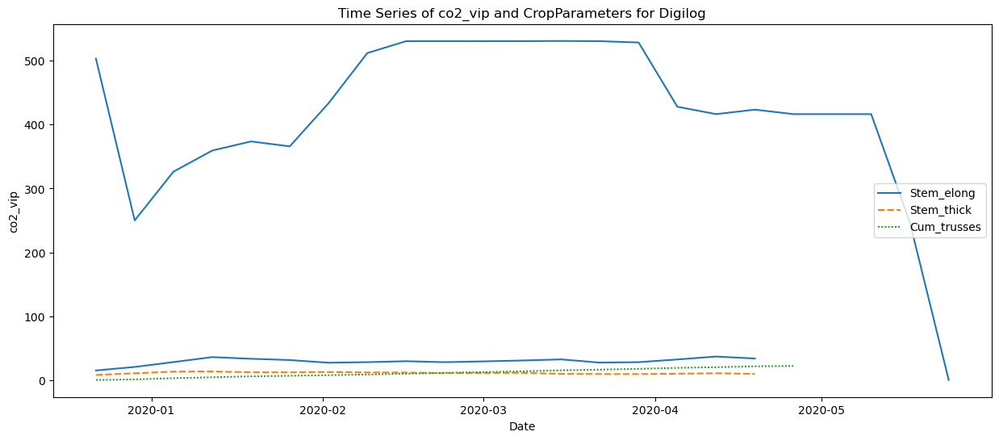

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



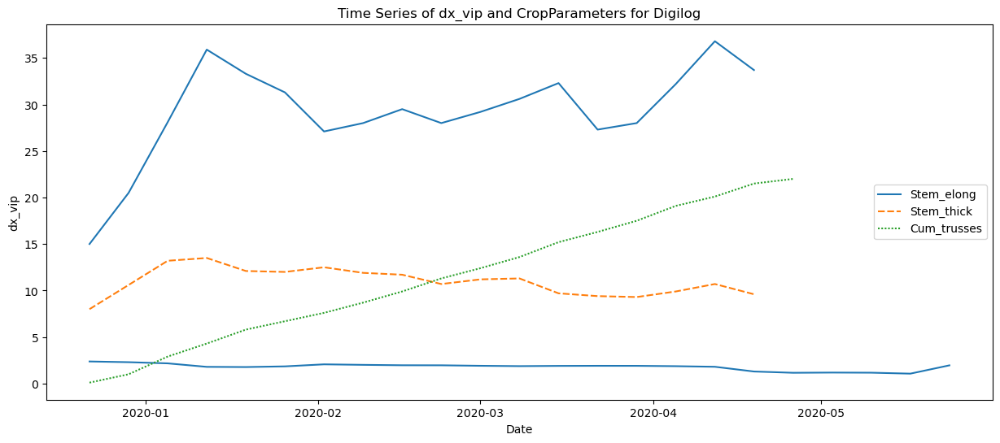

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



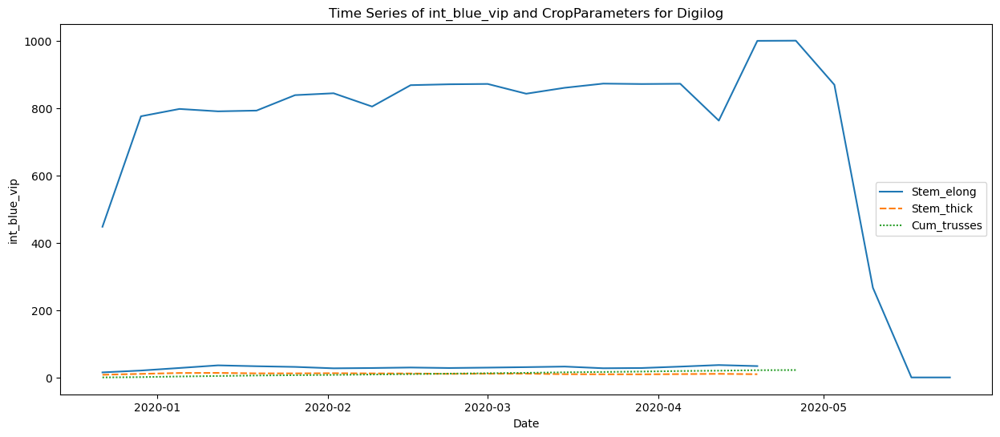

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



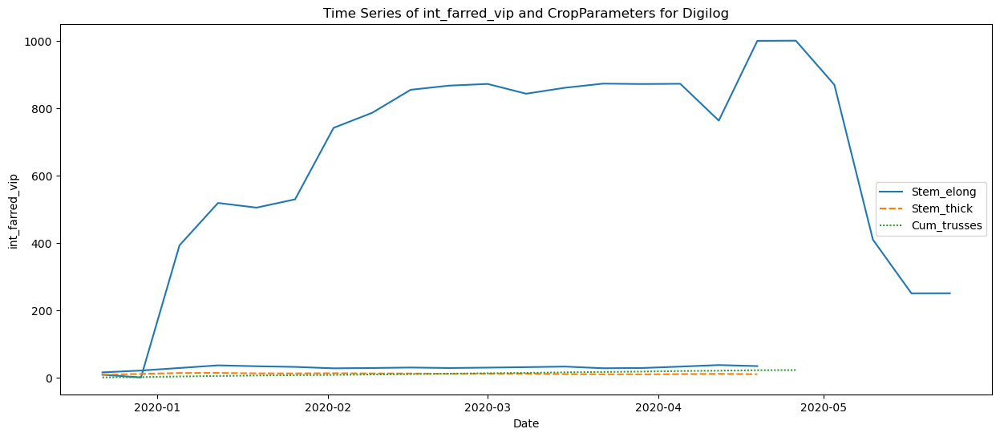

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



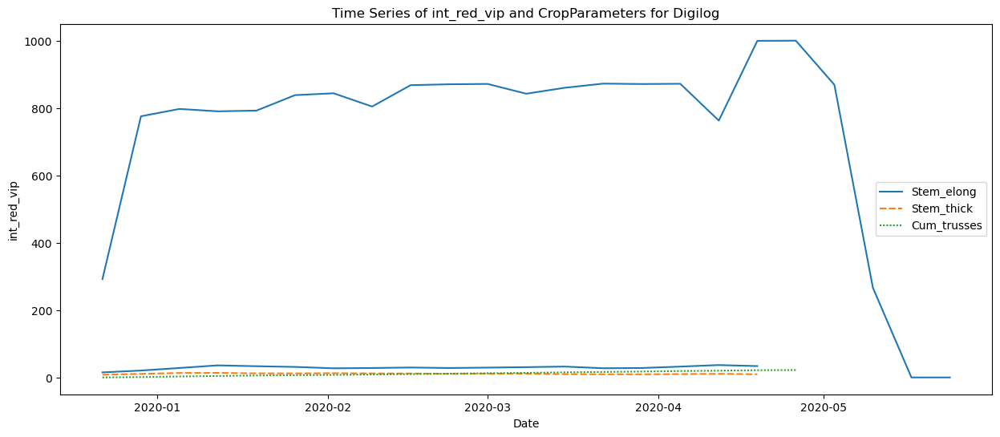

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



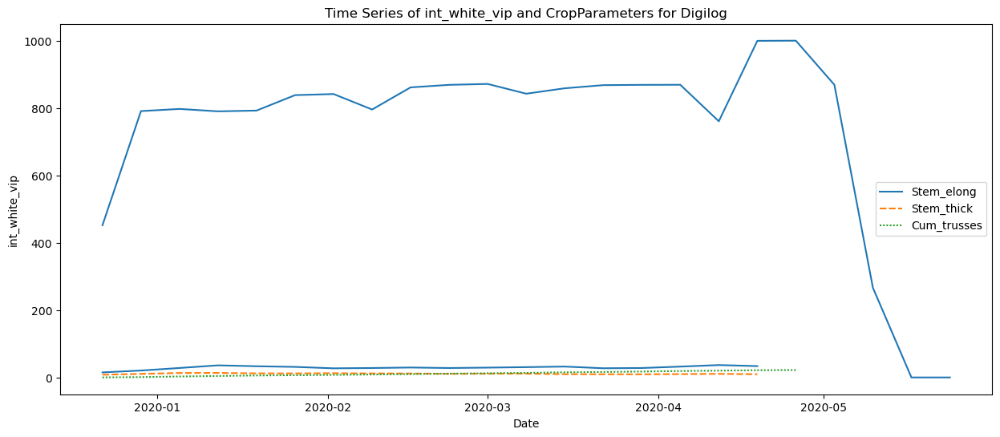

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



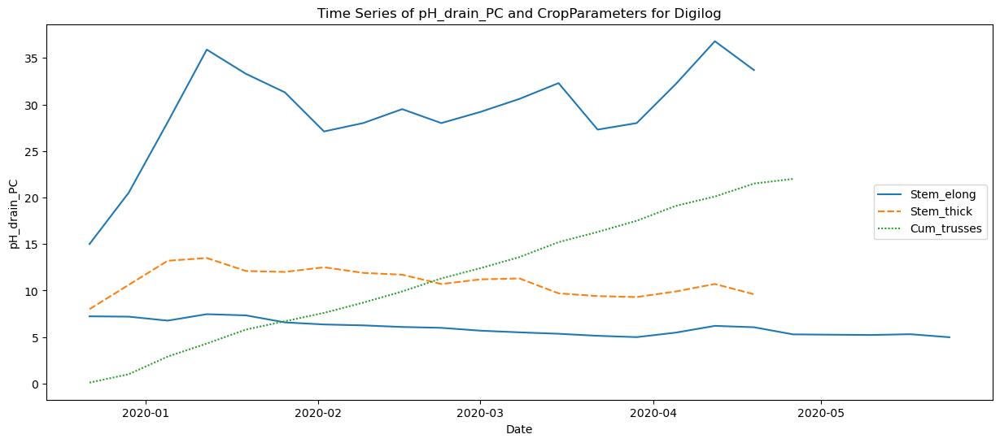

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



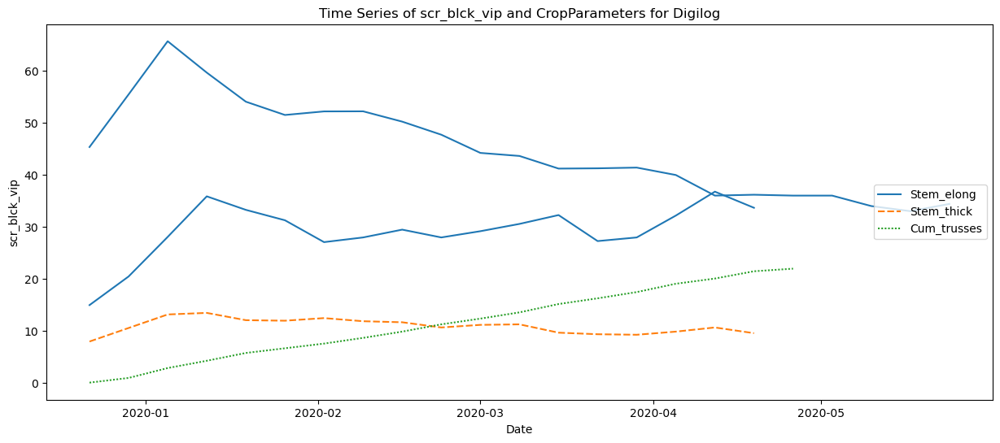

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



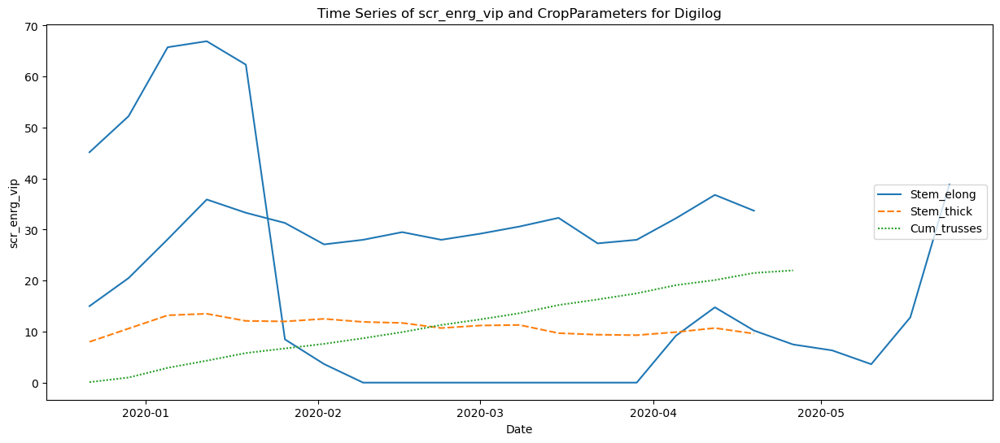

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



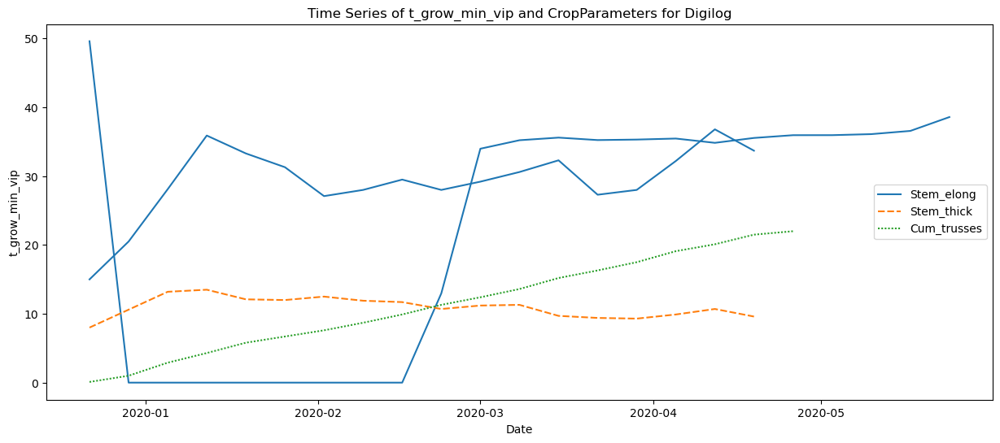

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



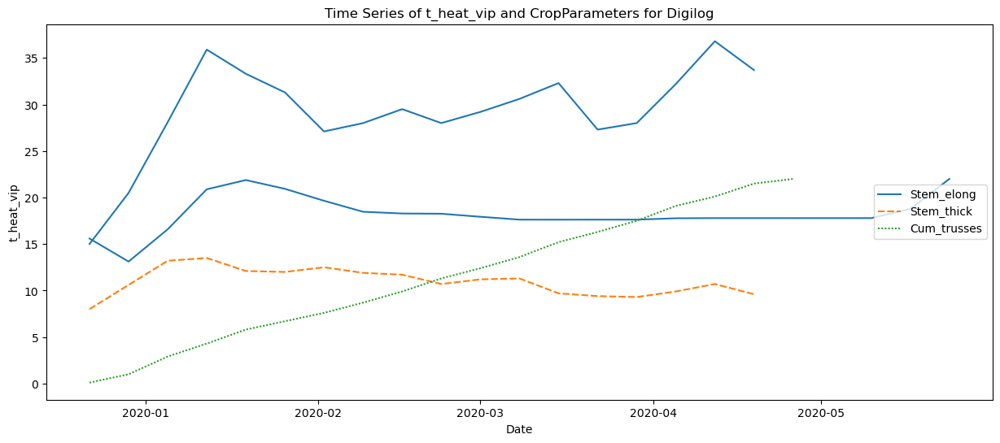

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



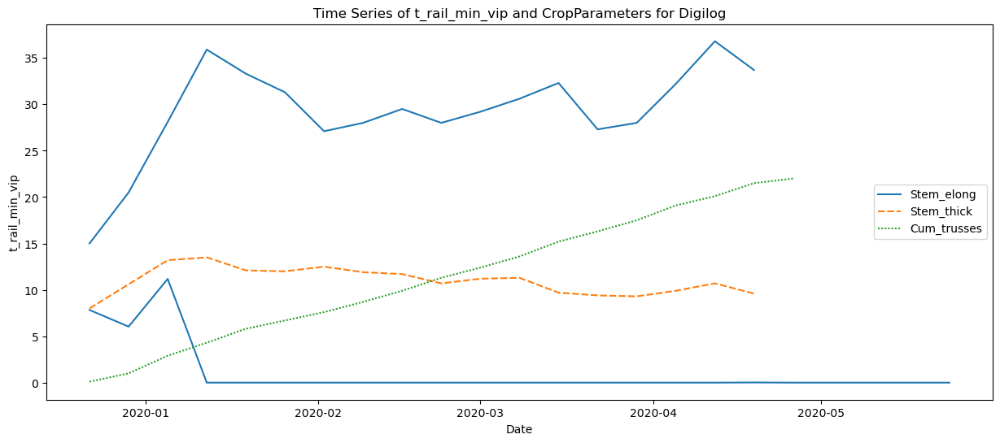

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



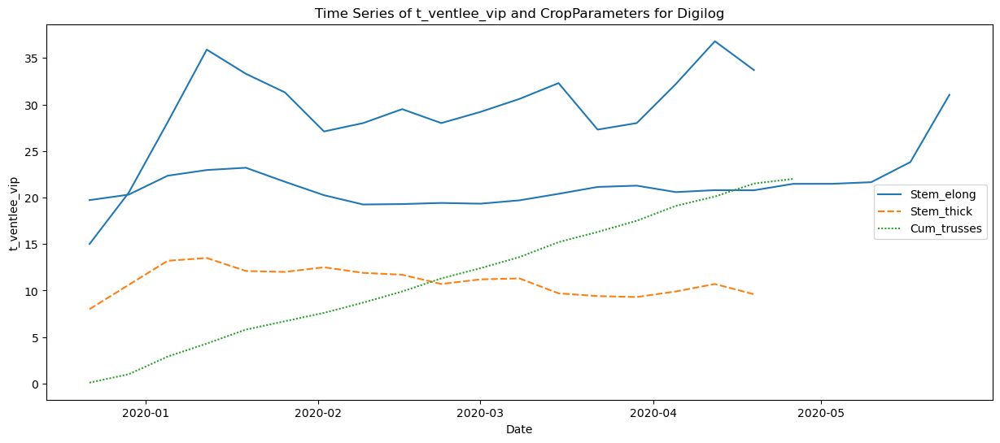

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



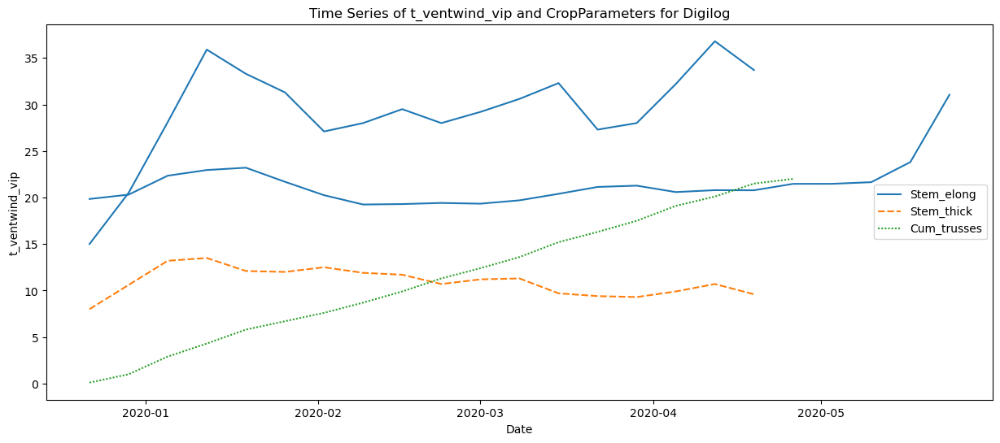

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



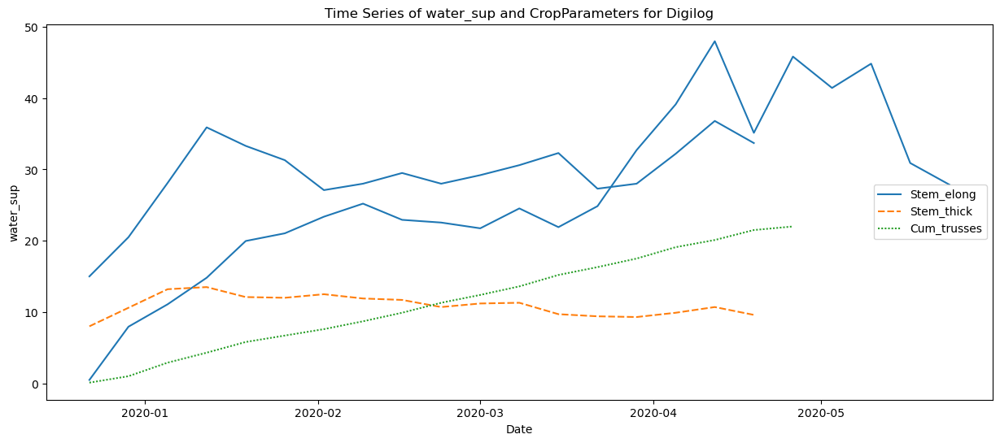

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



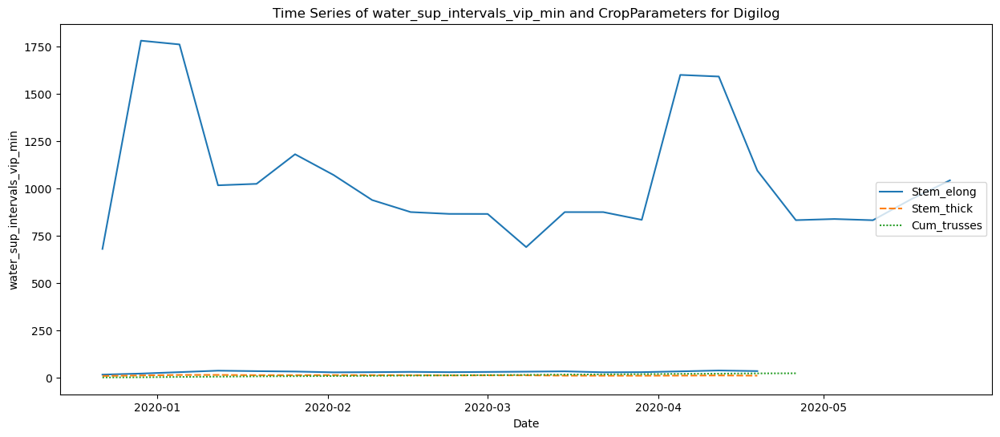

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



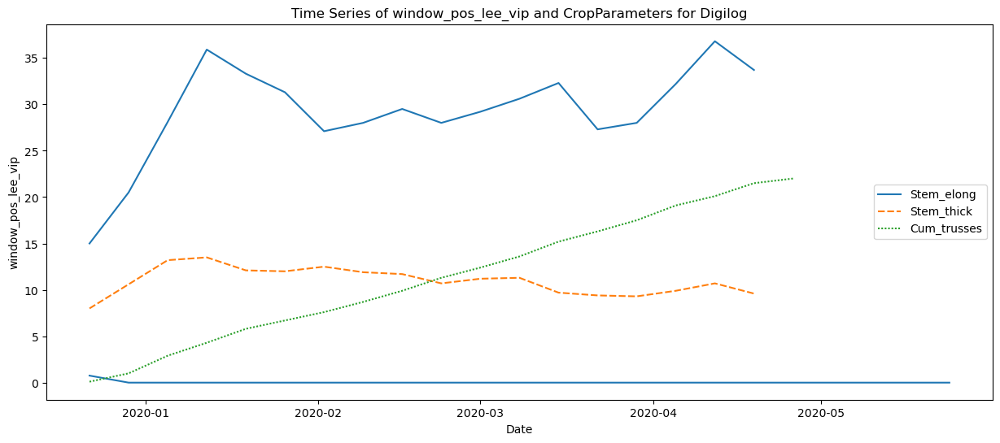

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



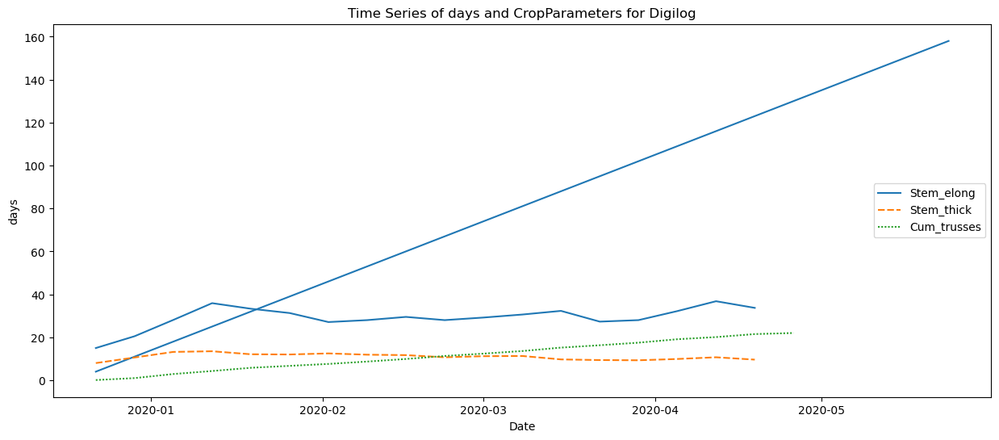

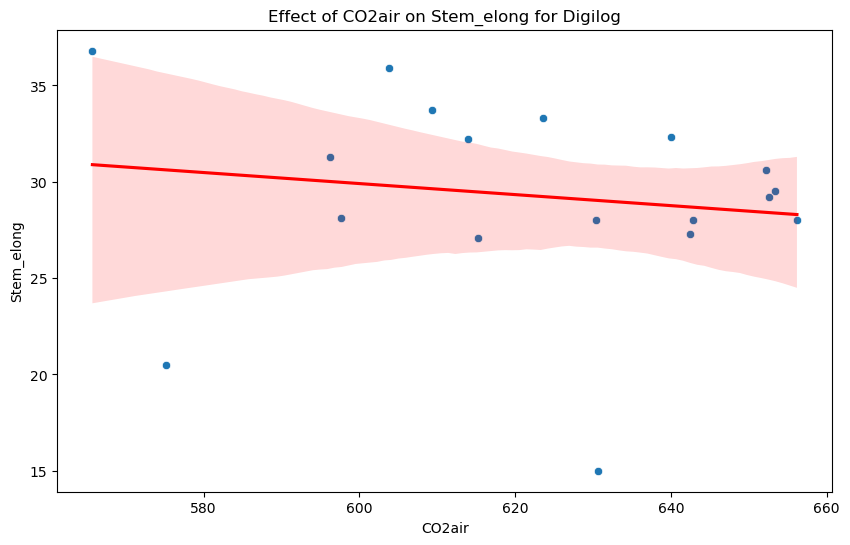

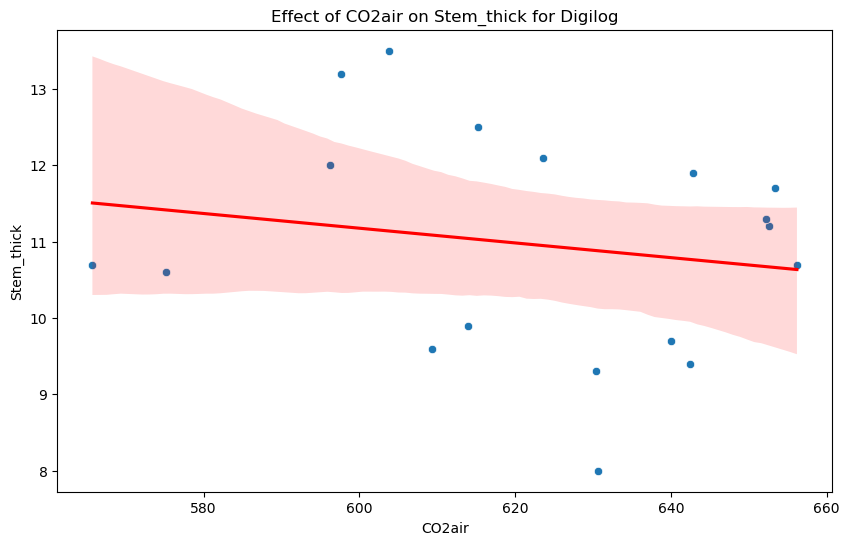

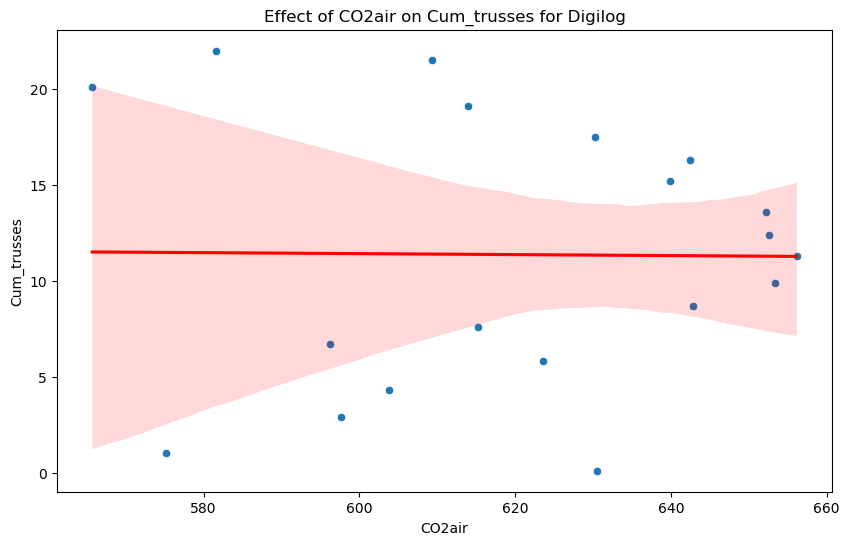

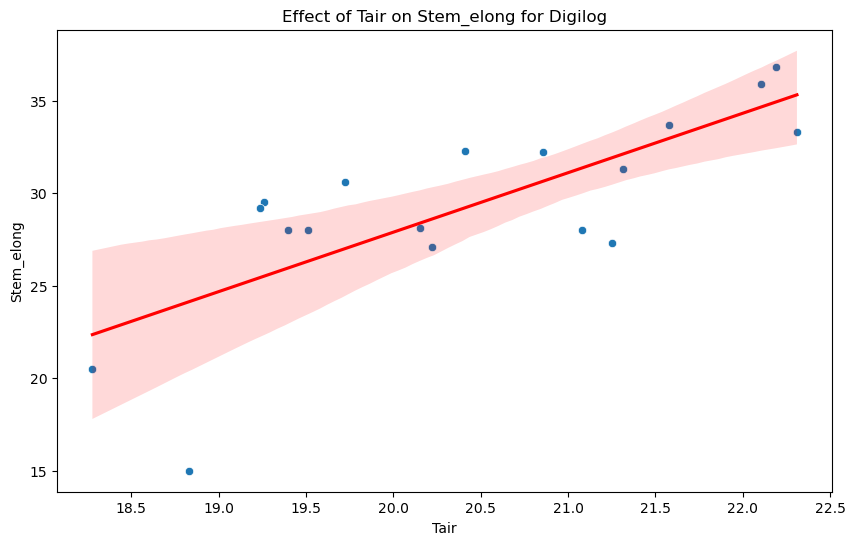

...

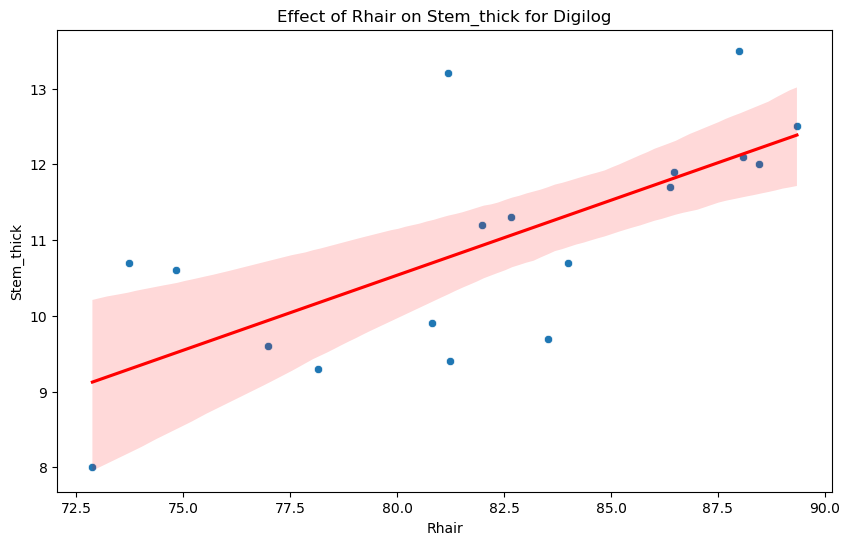

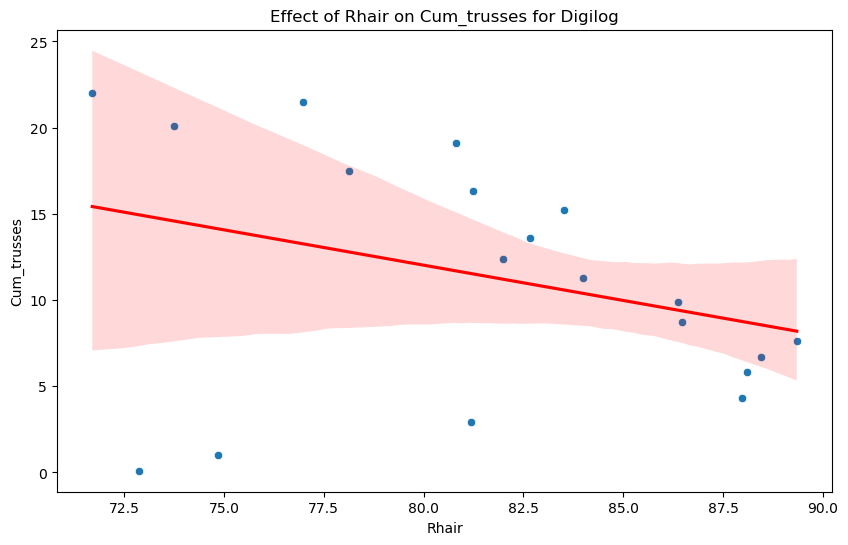

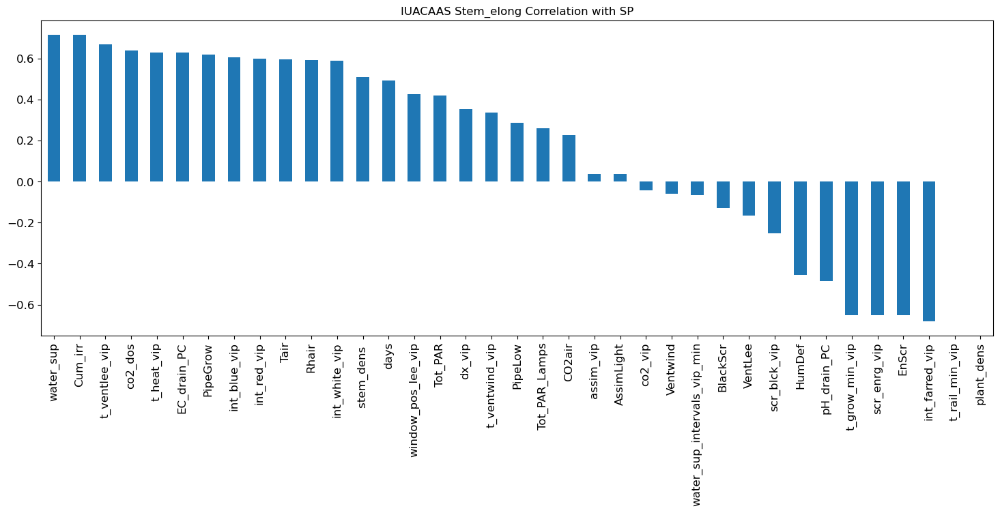

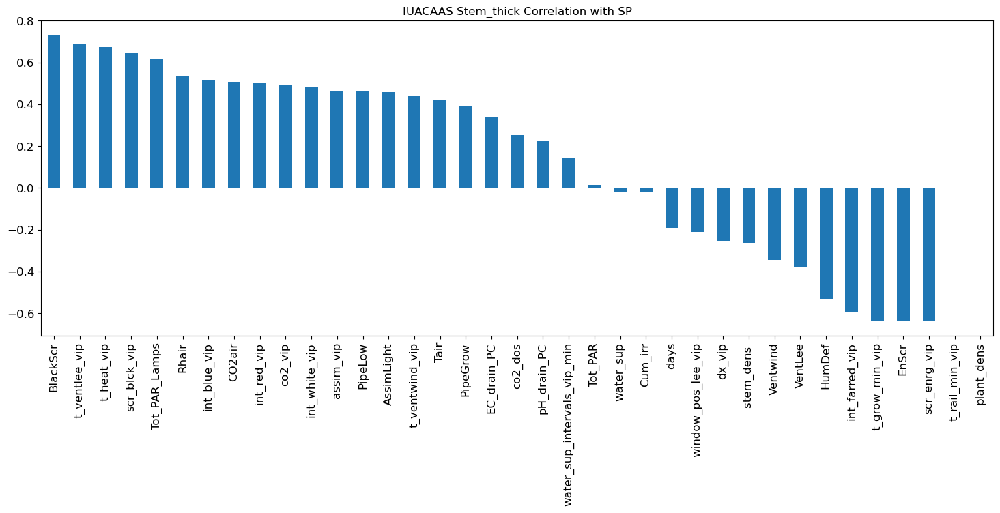

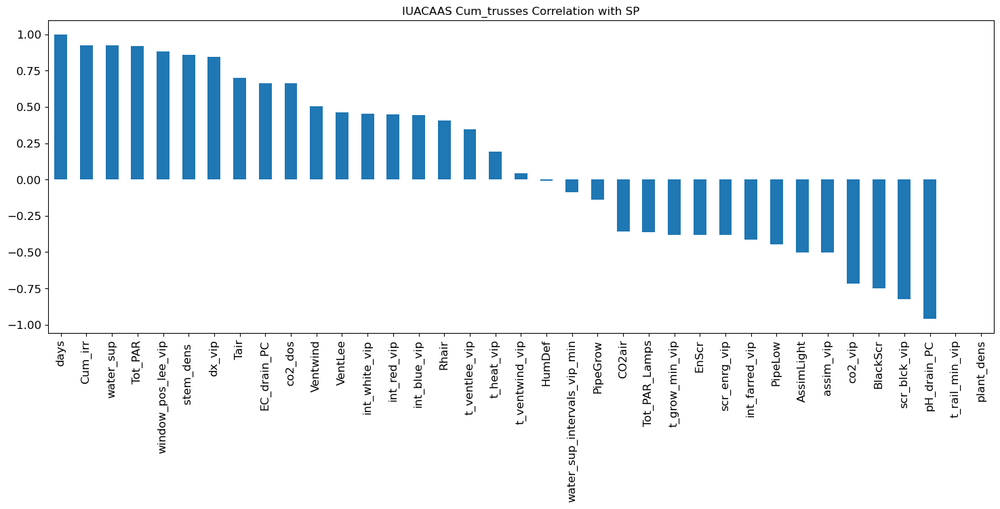

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



<Figure size 640x480 with 0 Axes>

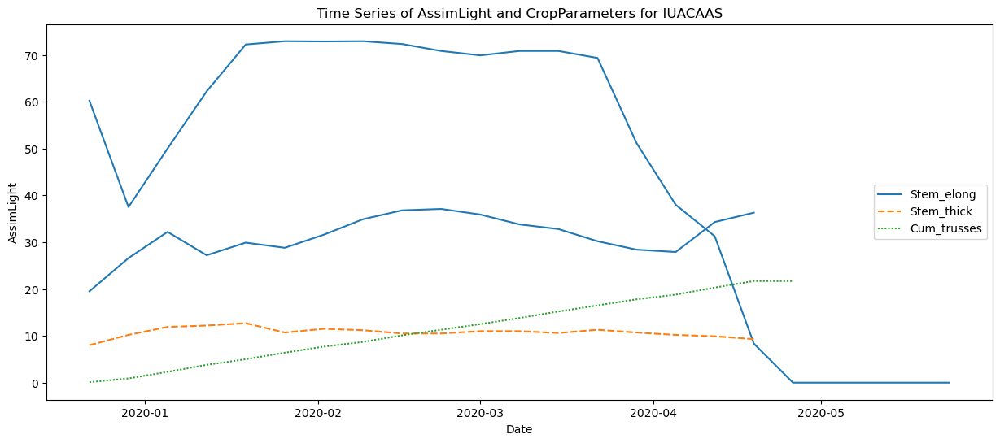

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



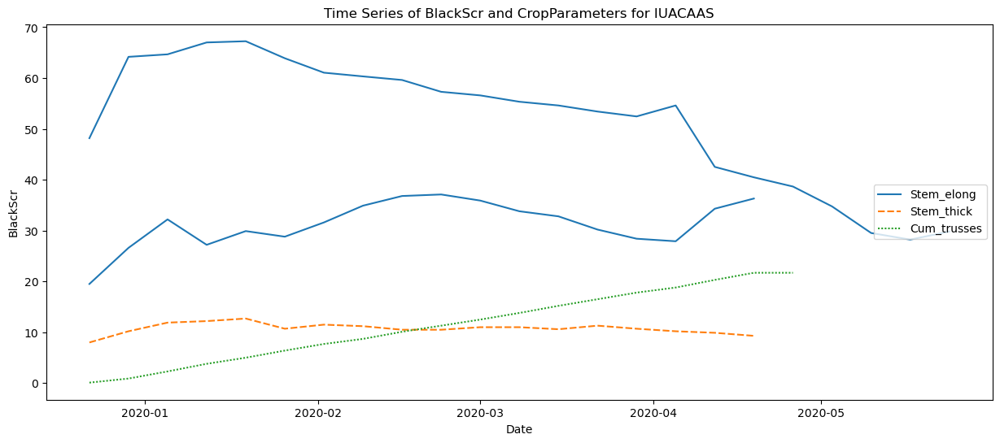

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



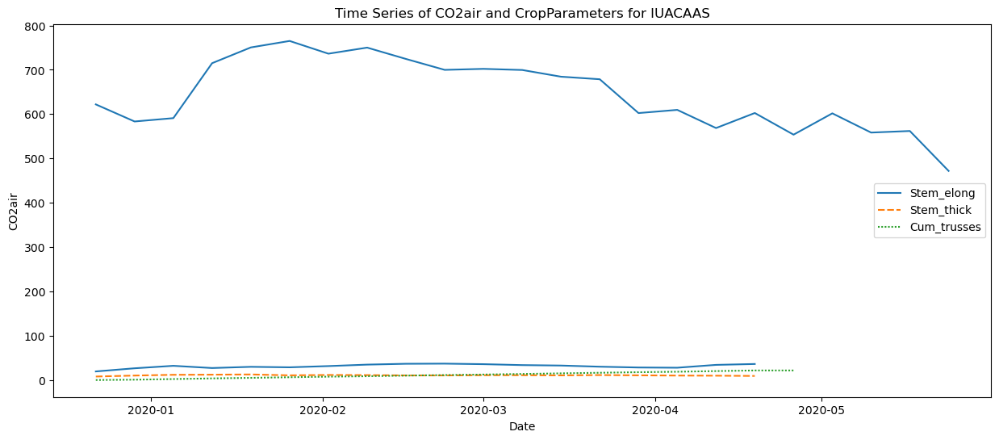

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



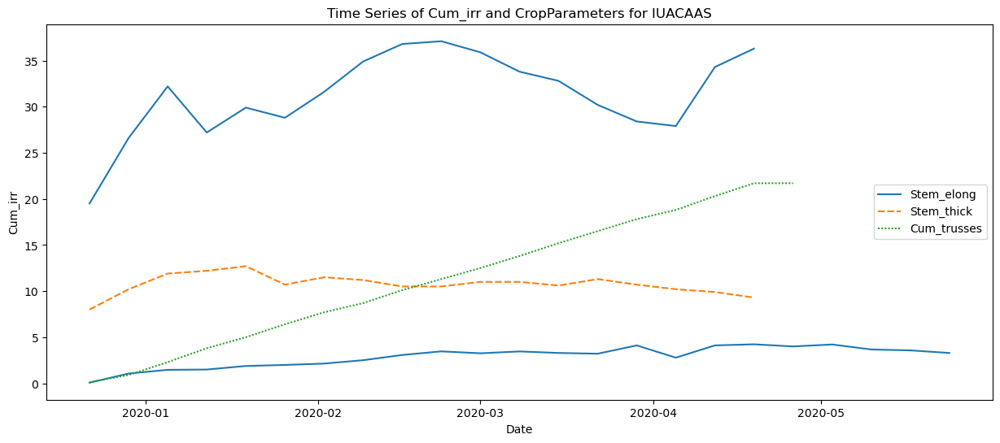

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



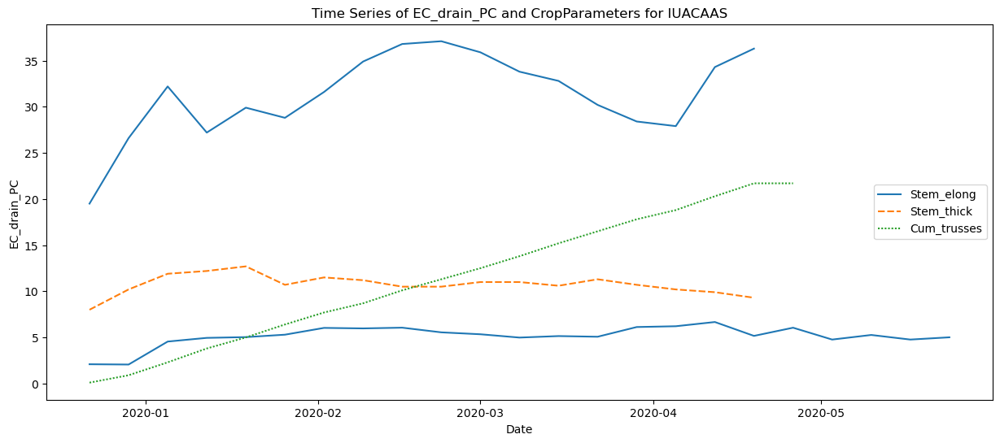

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



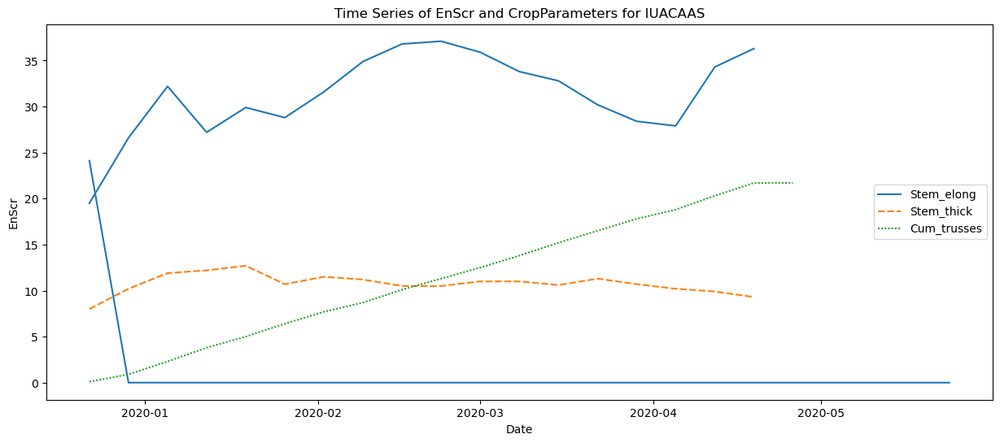

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



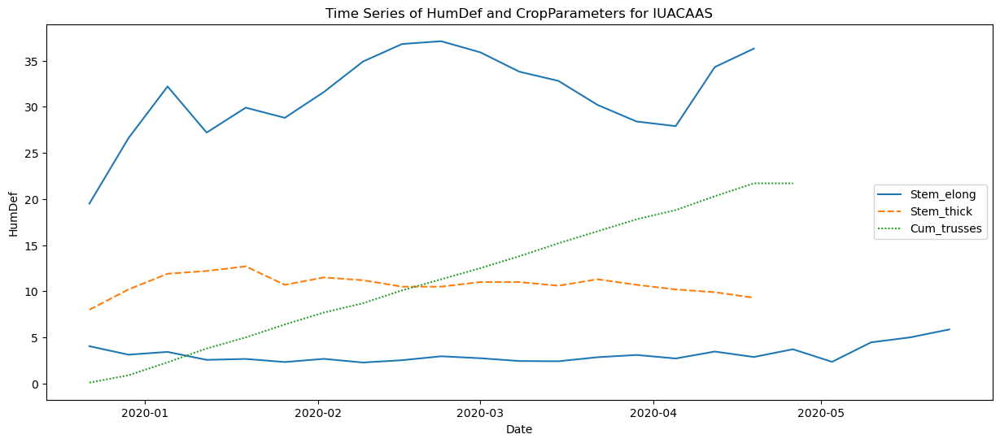

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



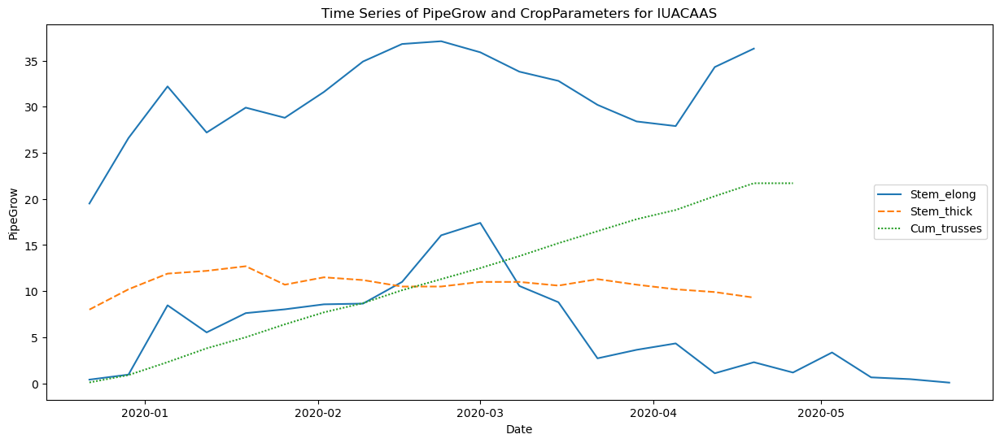

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



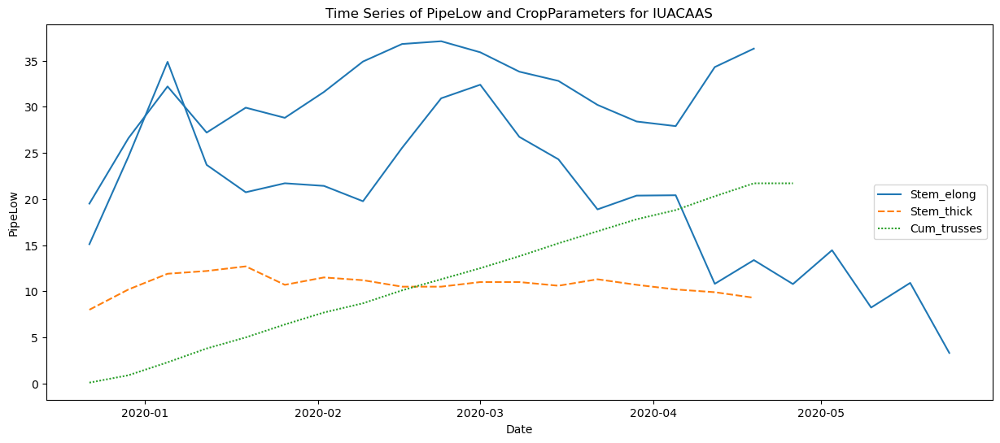

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



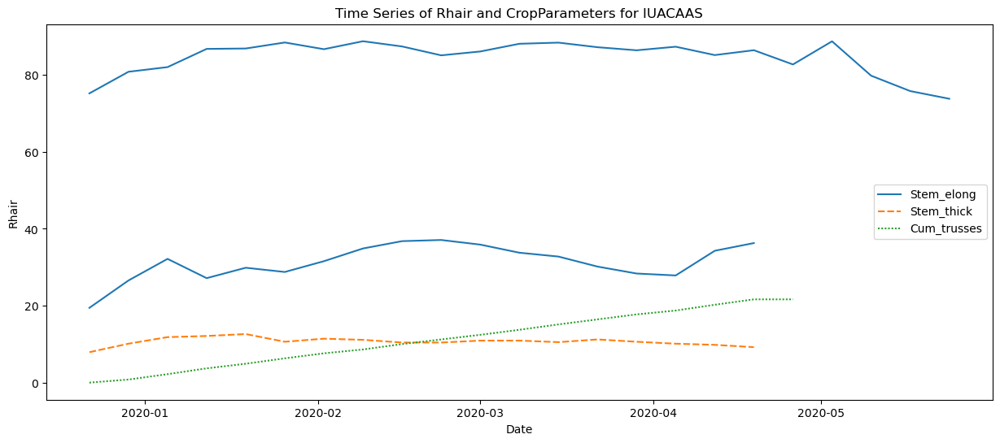

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



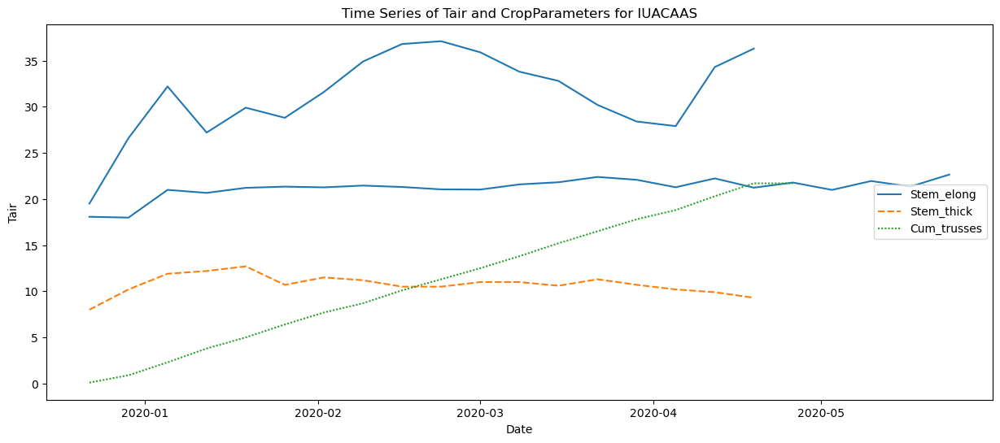

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



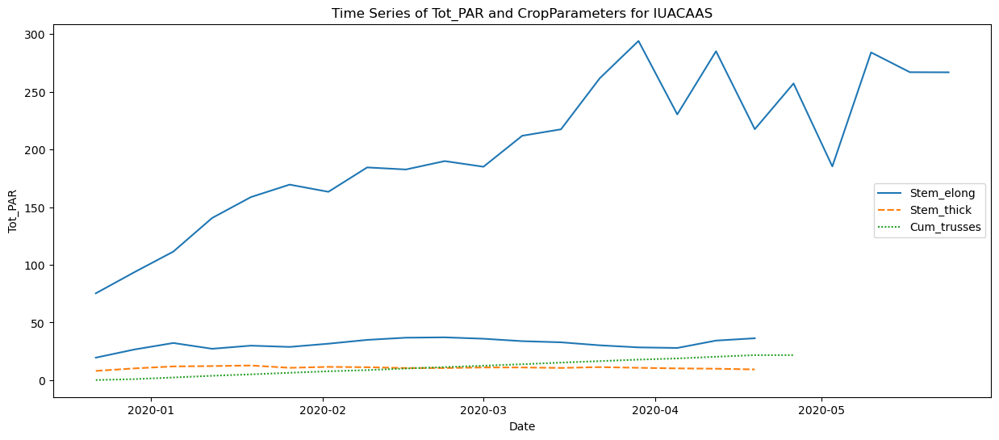

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



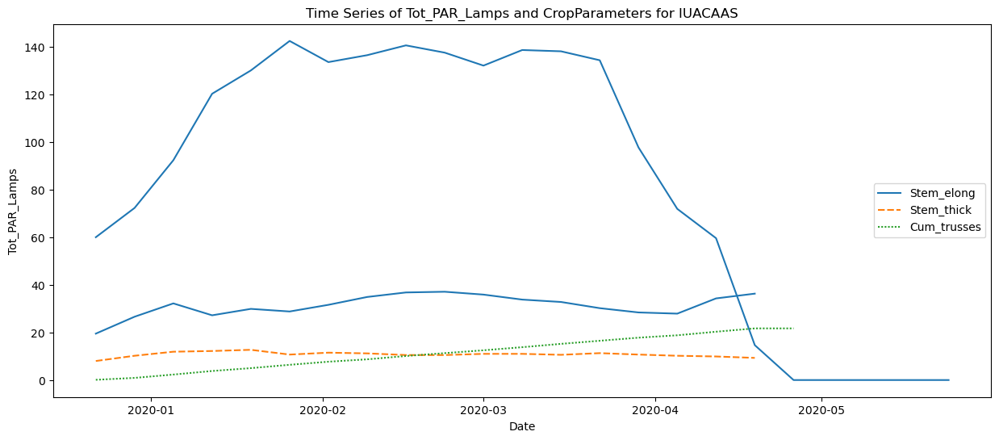

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



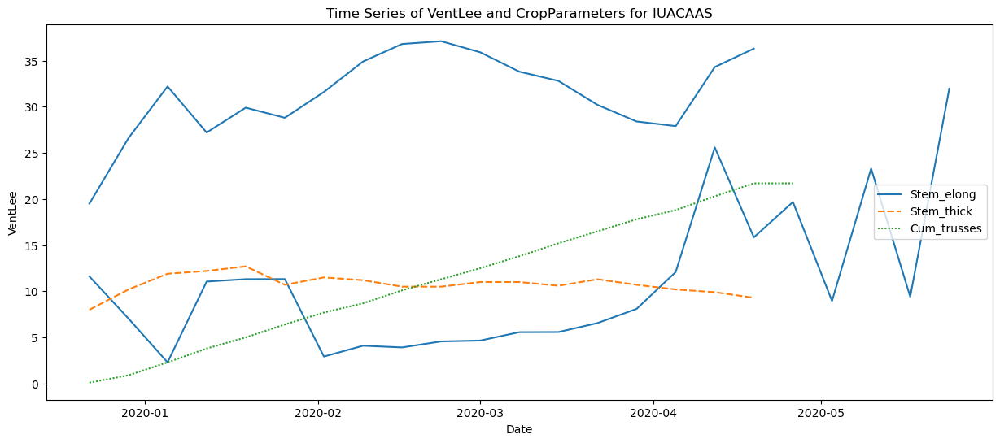

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



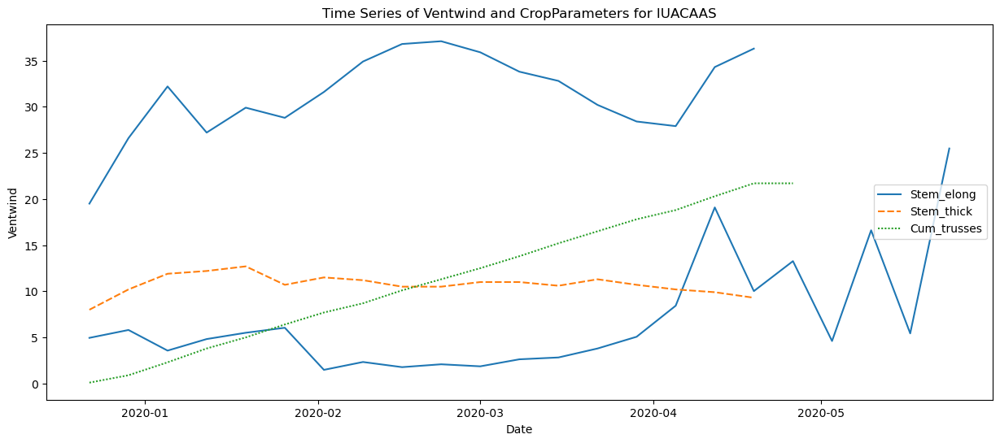

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



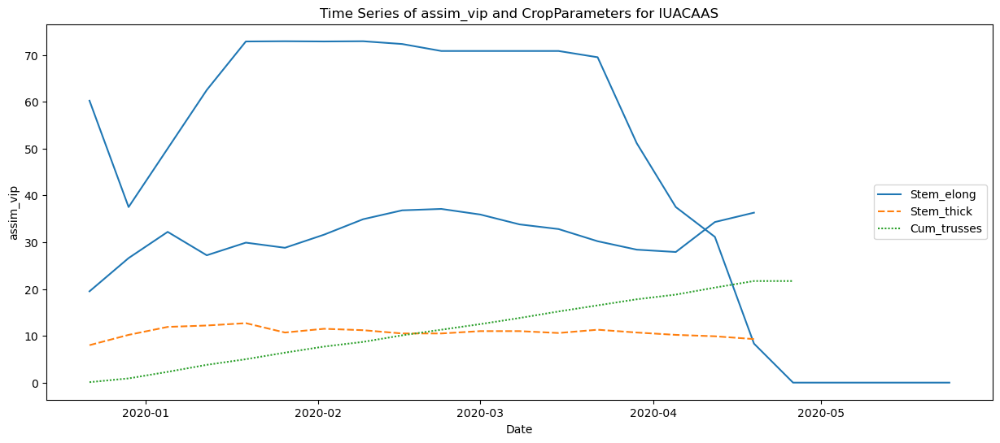

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



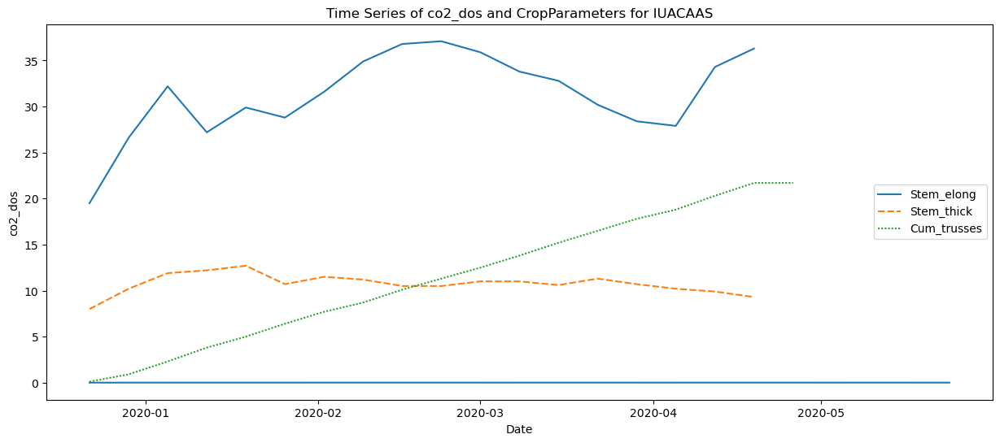

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



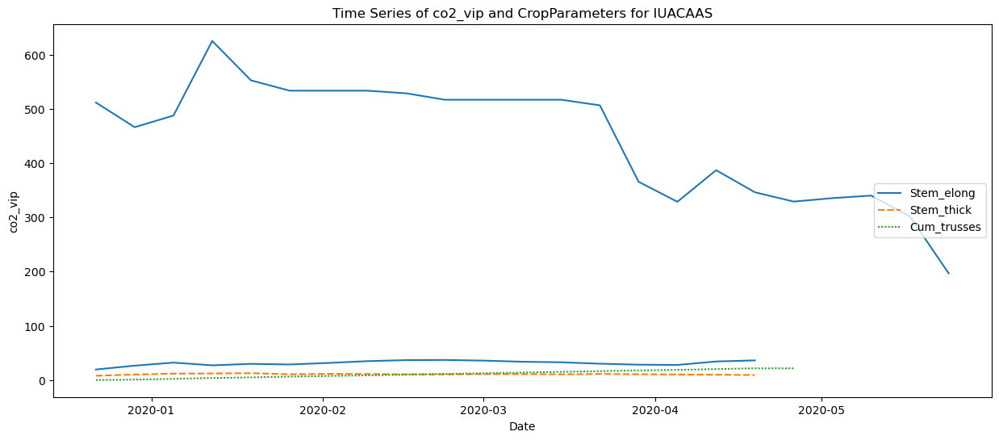

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



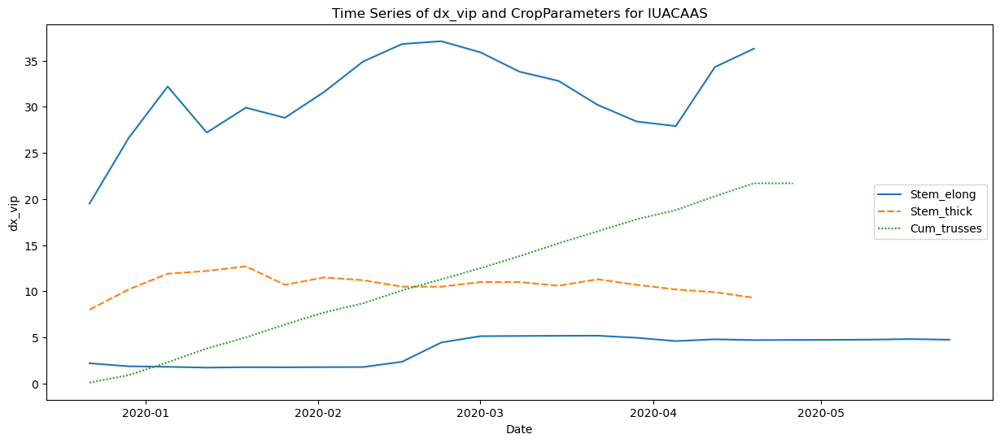

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



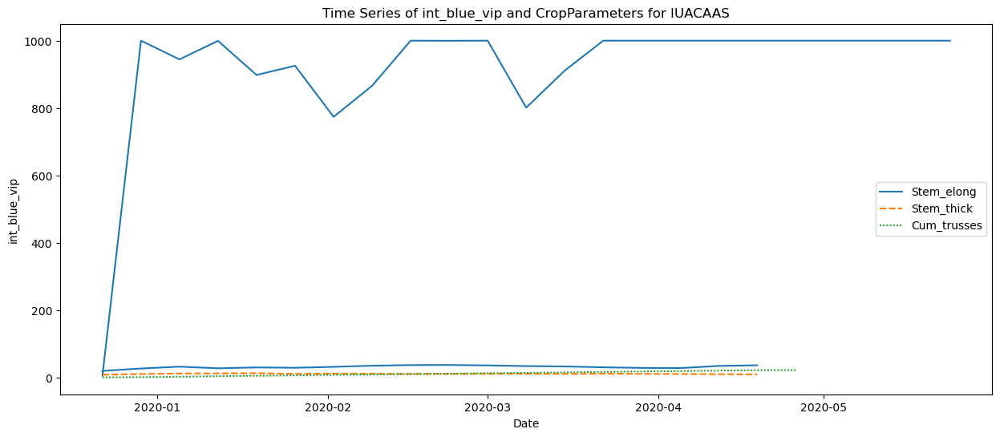

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



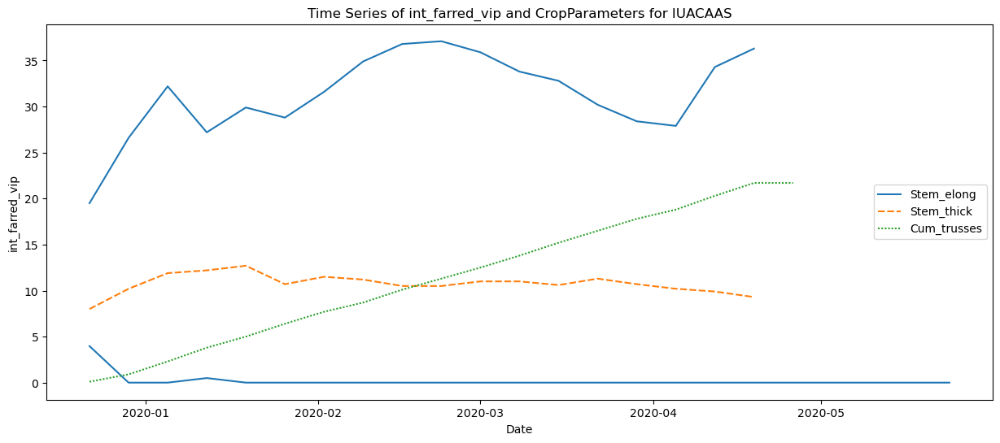

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



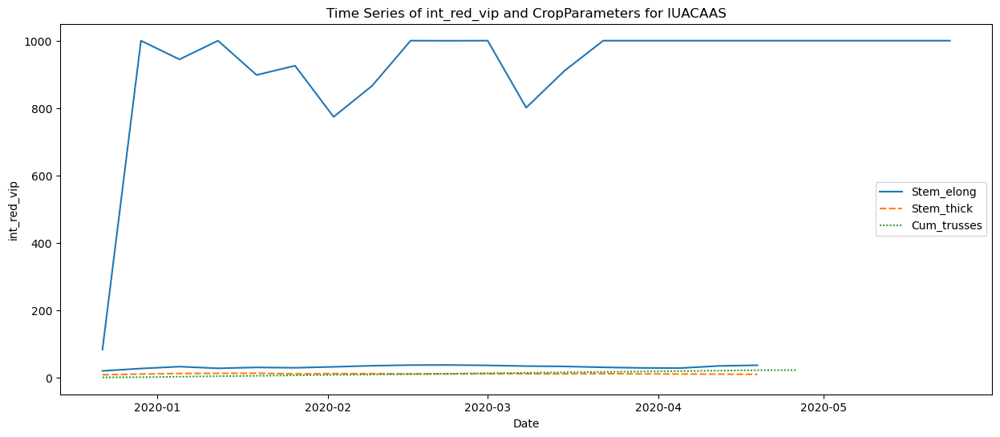

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



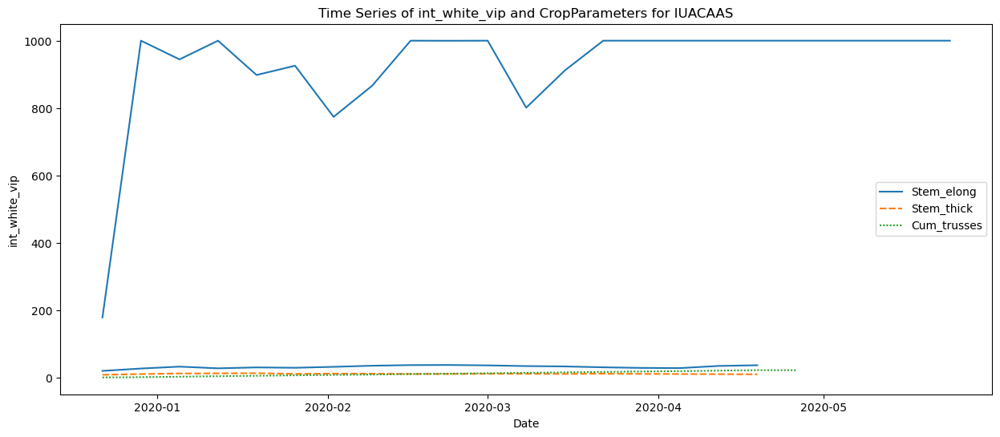

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



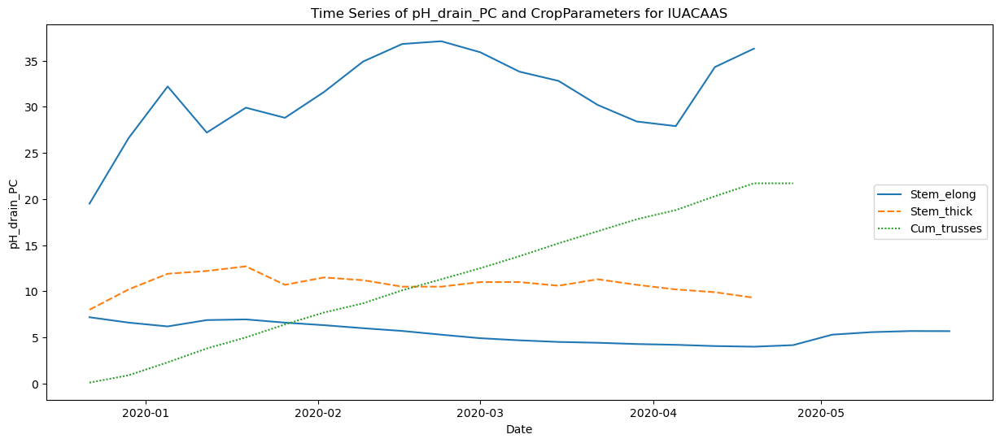

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



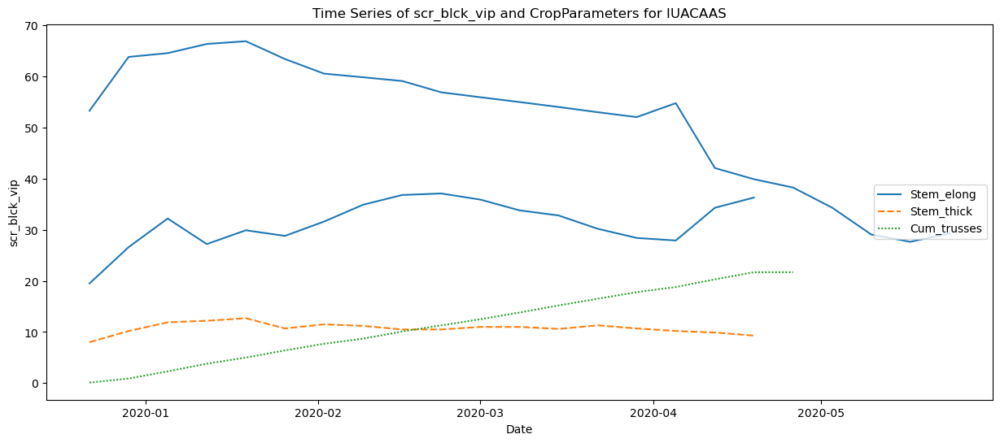

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



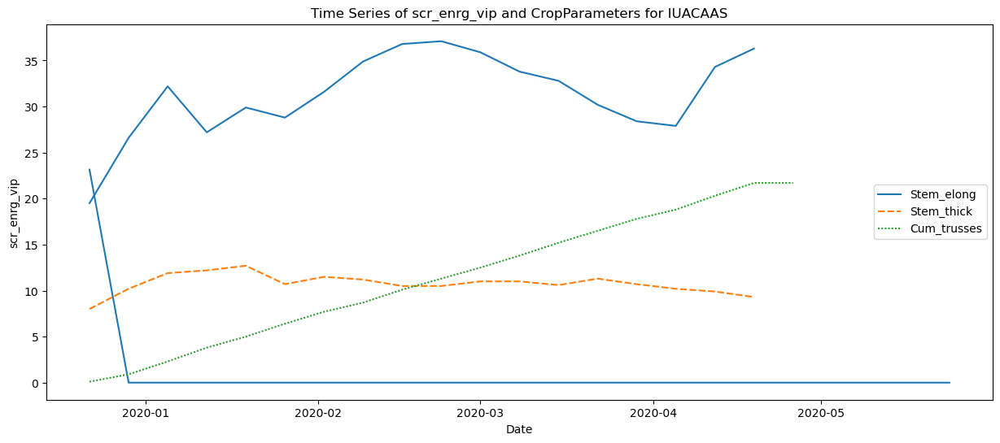

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



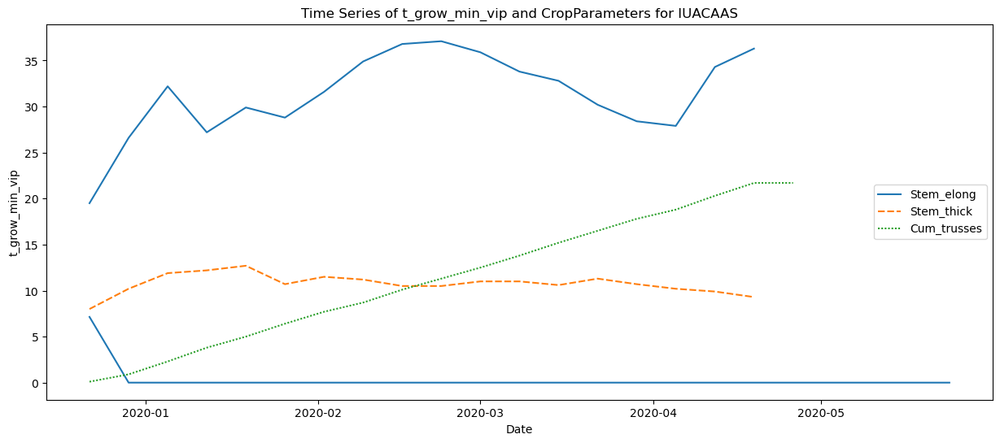

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



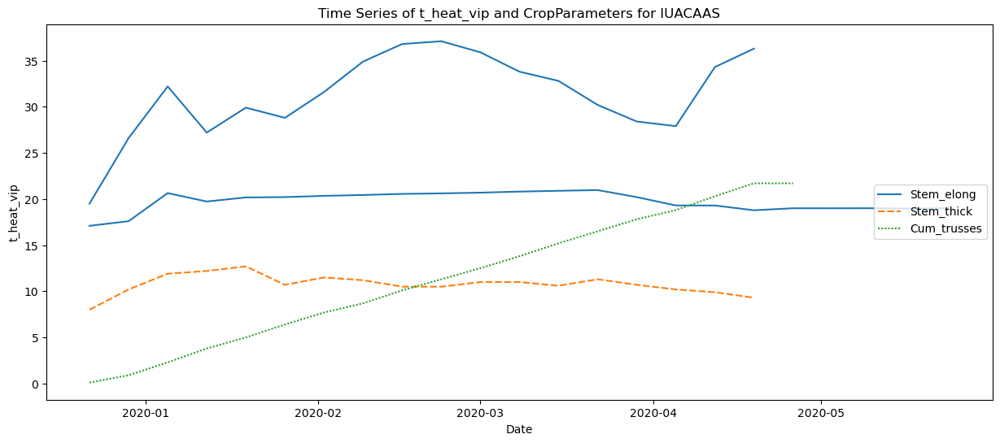

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



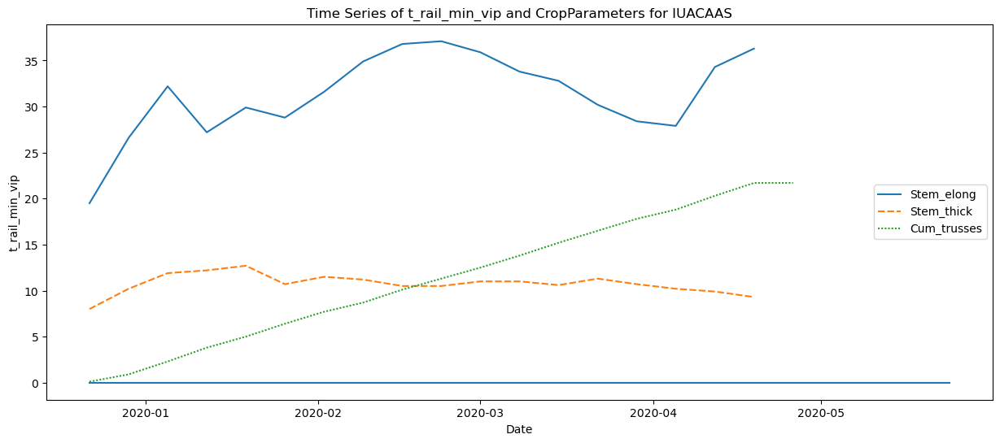

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



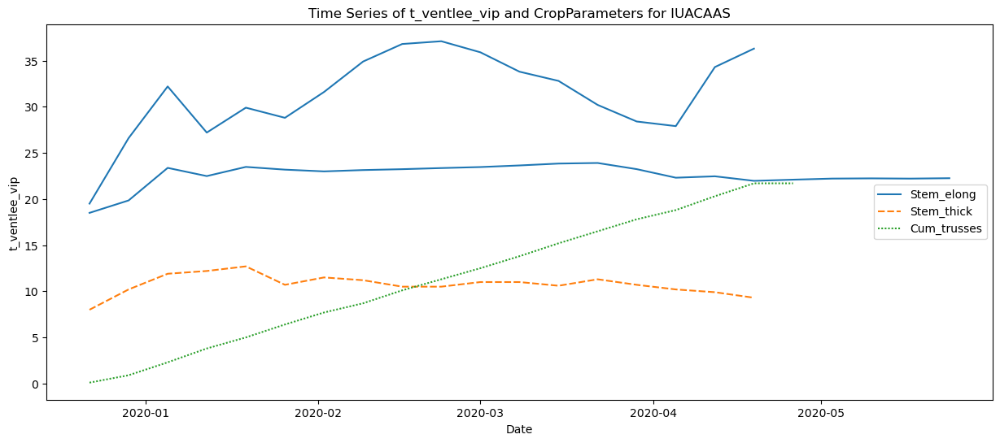

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



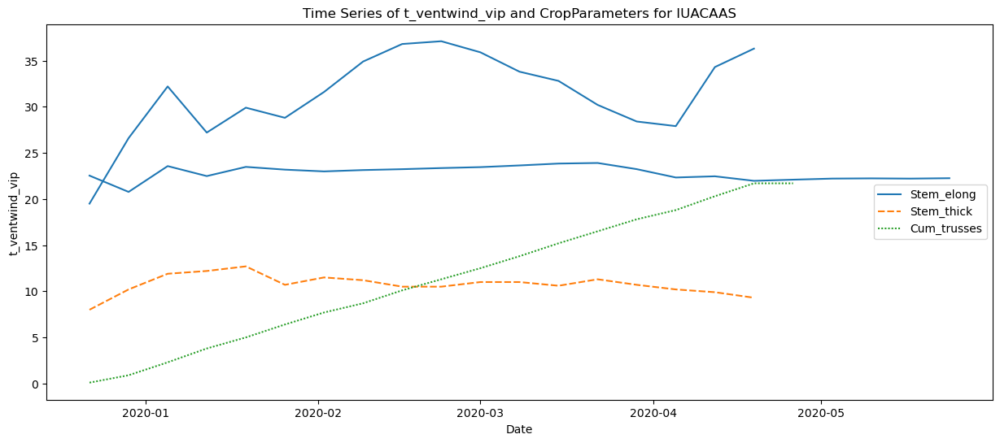

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



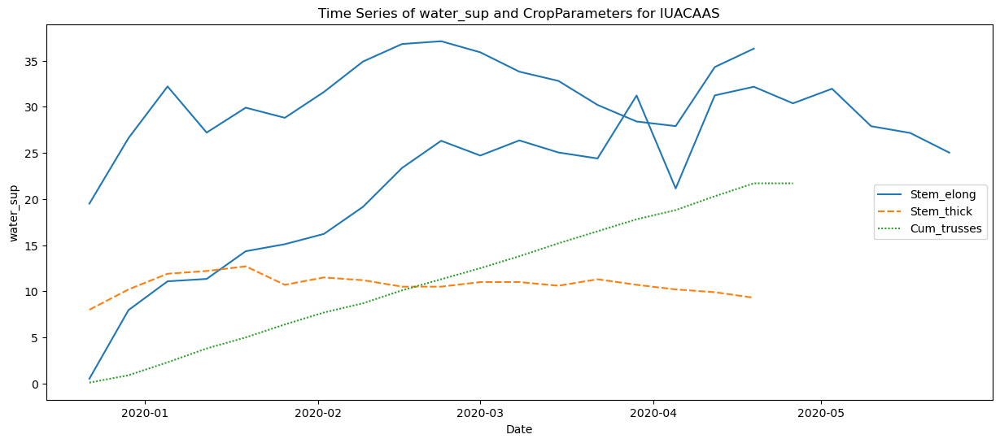

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



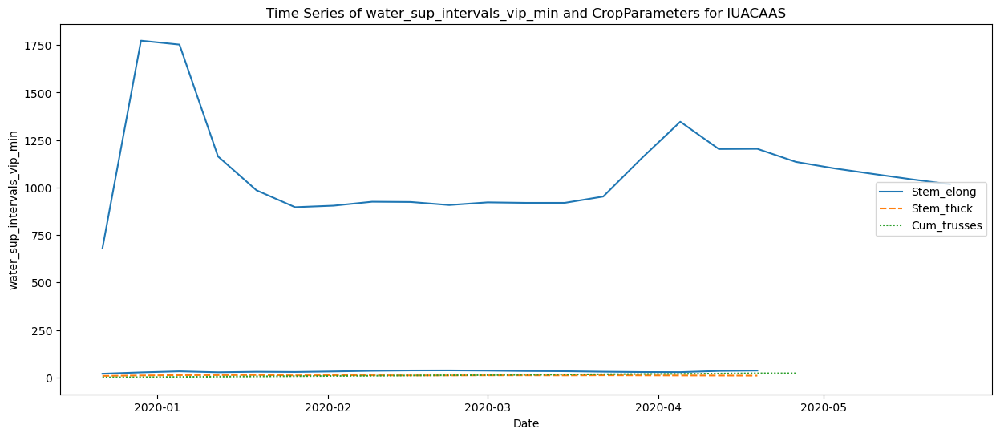

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



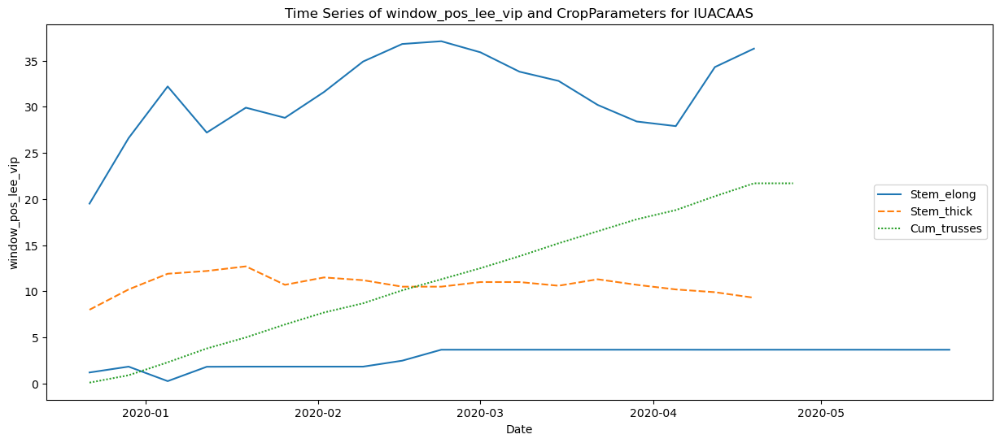

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



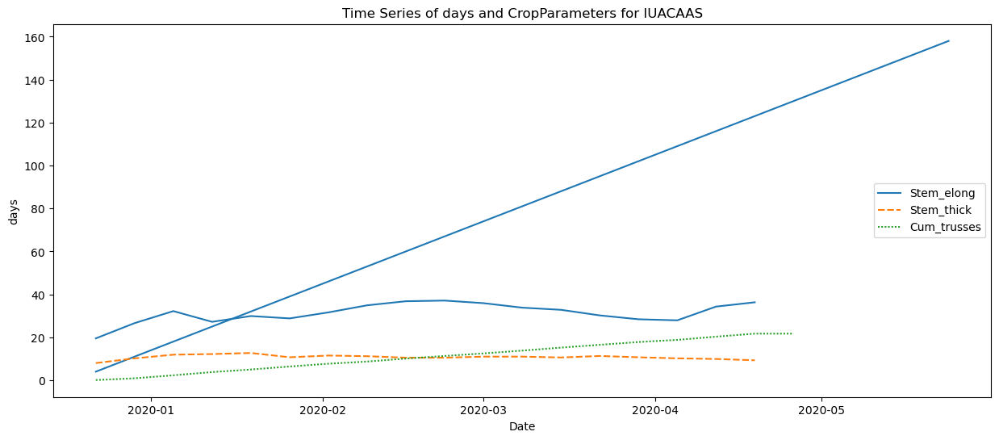

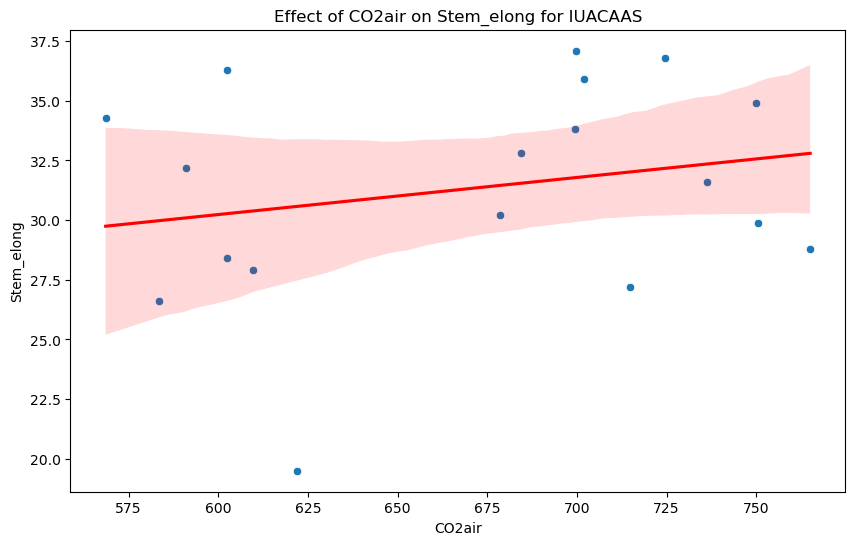

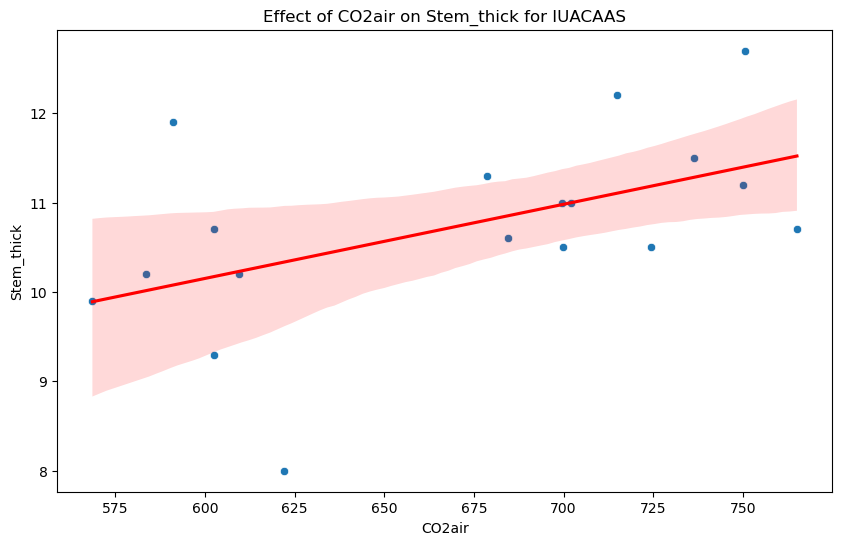

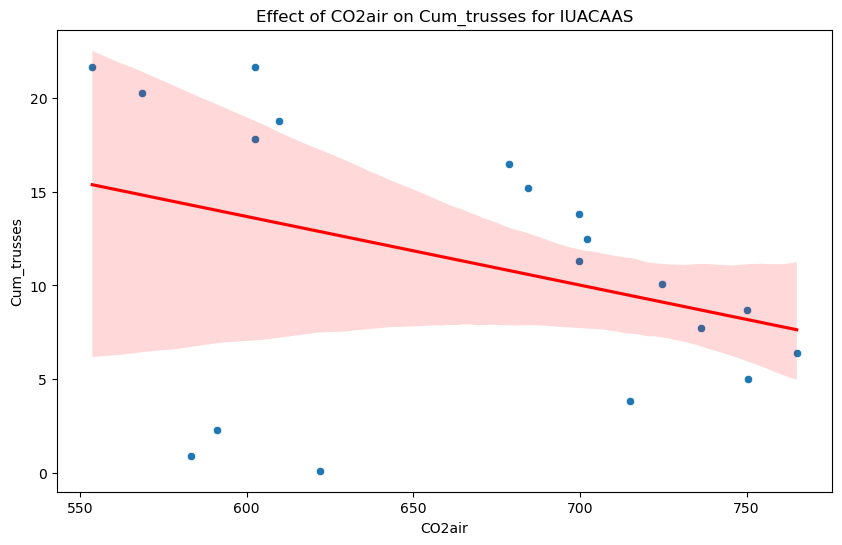

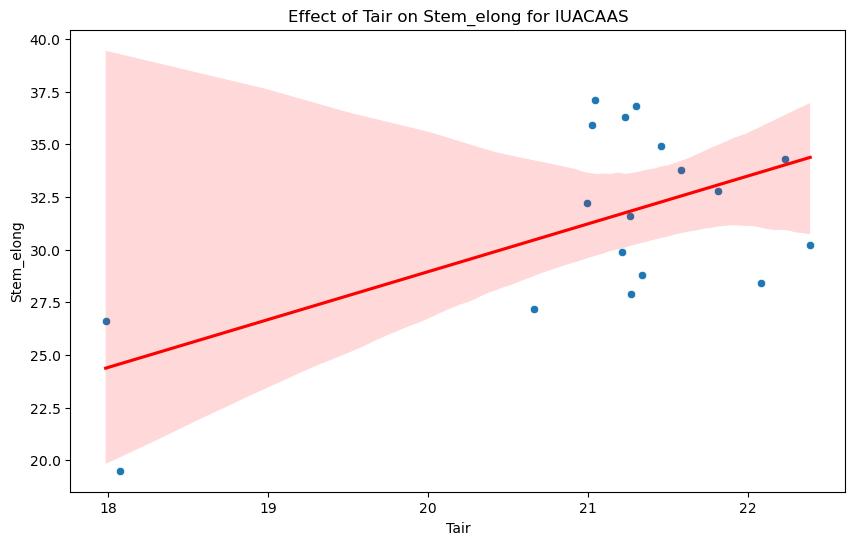

...

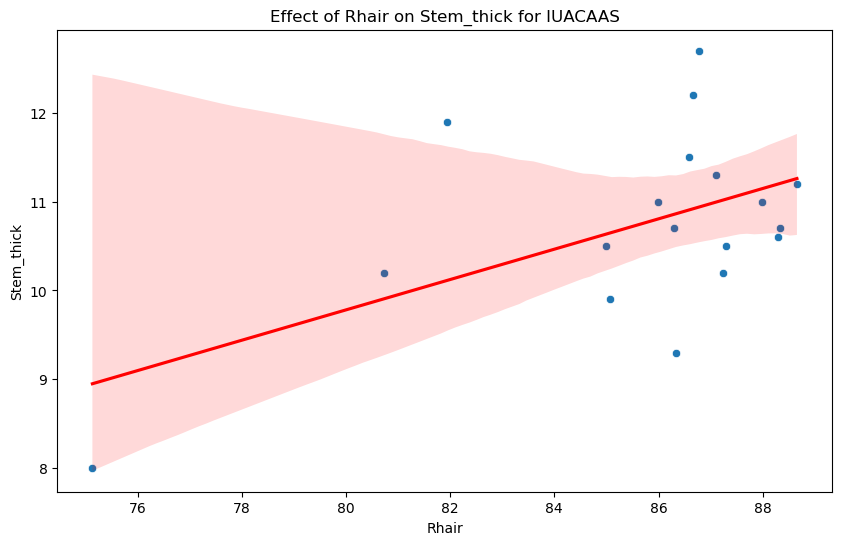

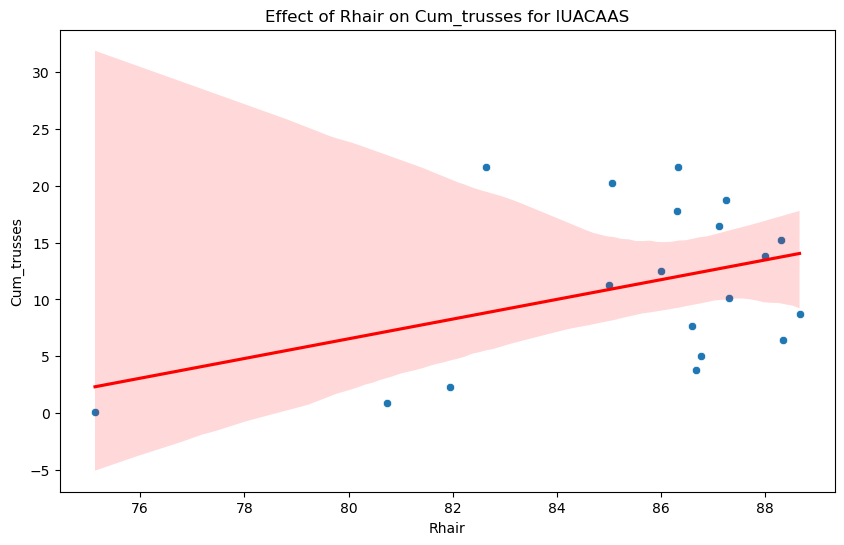

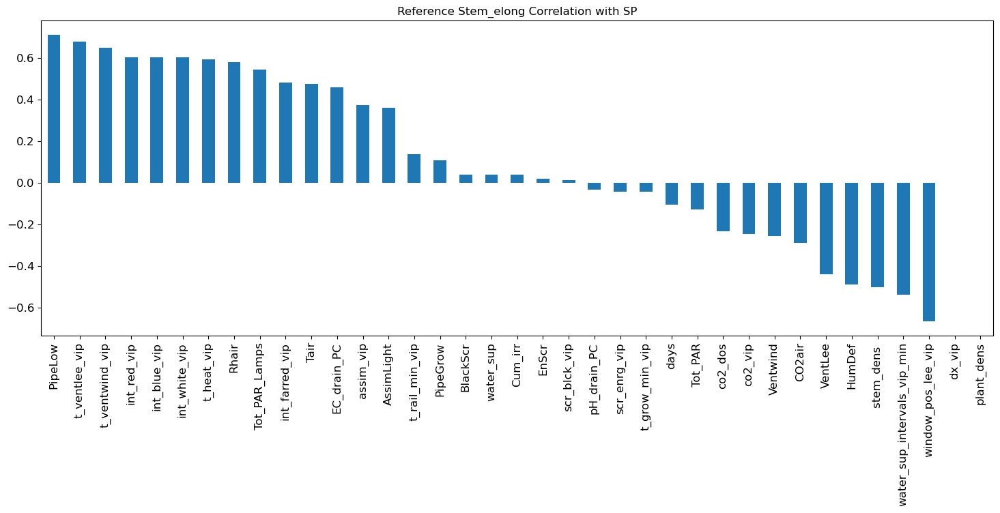

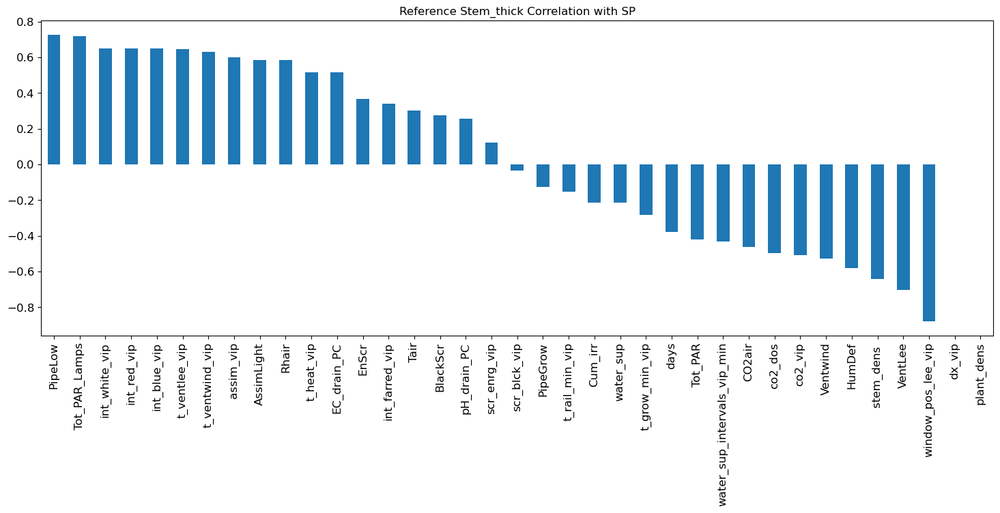

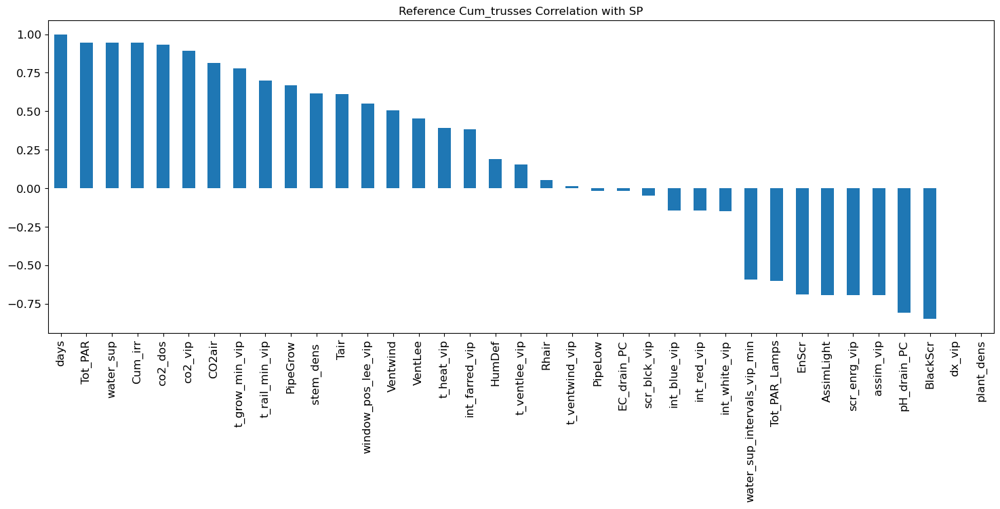

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



<Figure size 640x480 with 0 Axes>

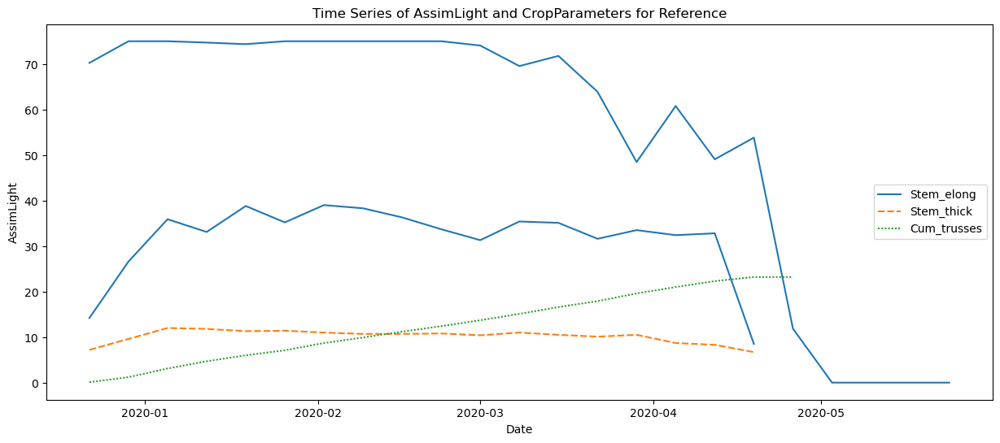

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



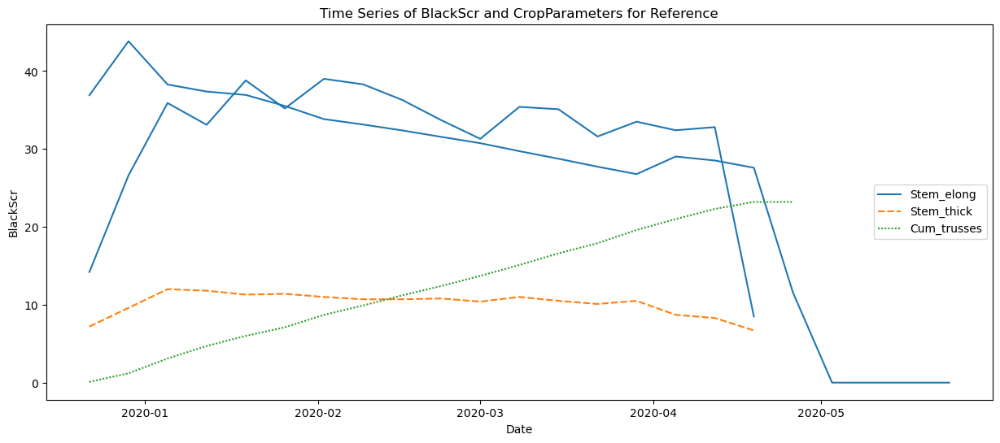

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



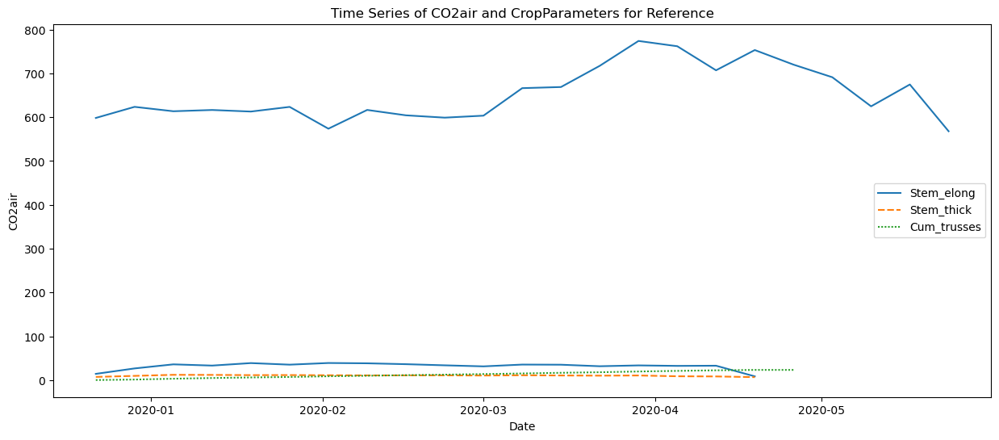

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



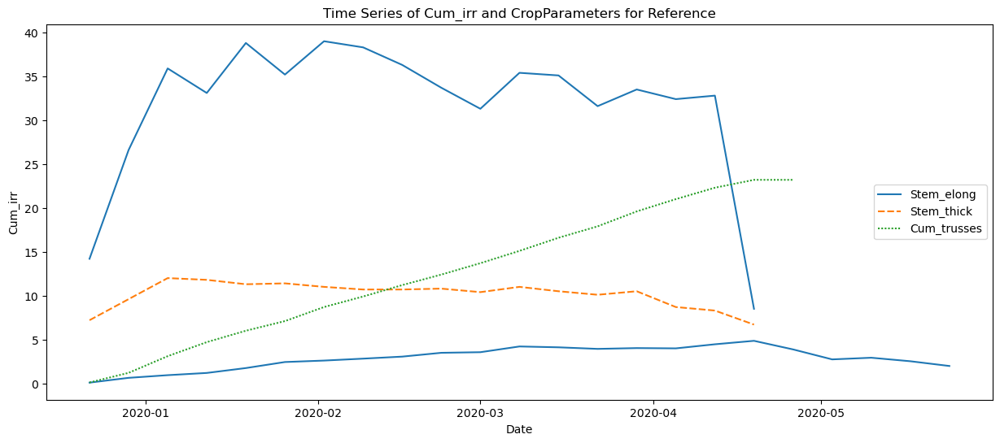

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



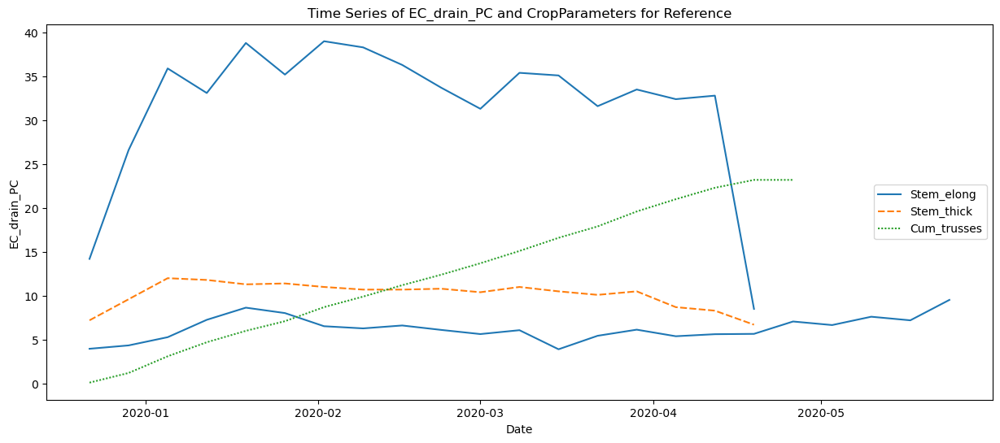

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



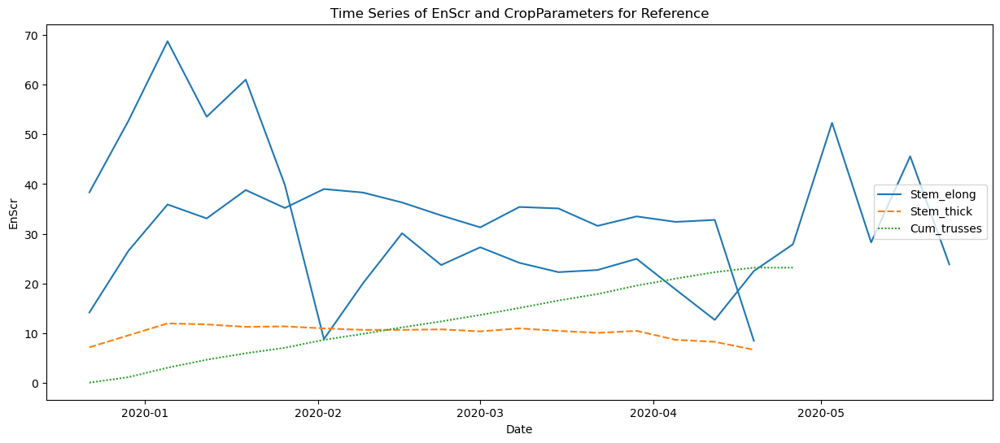

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



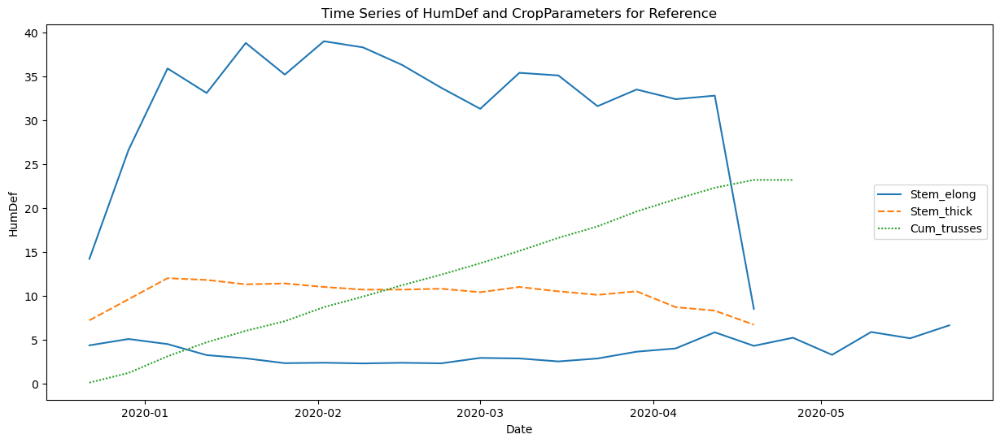

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



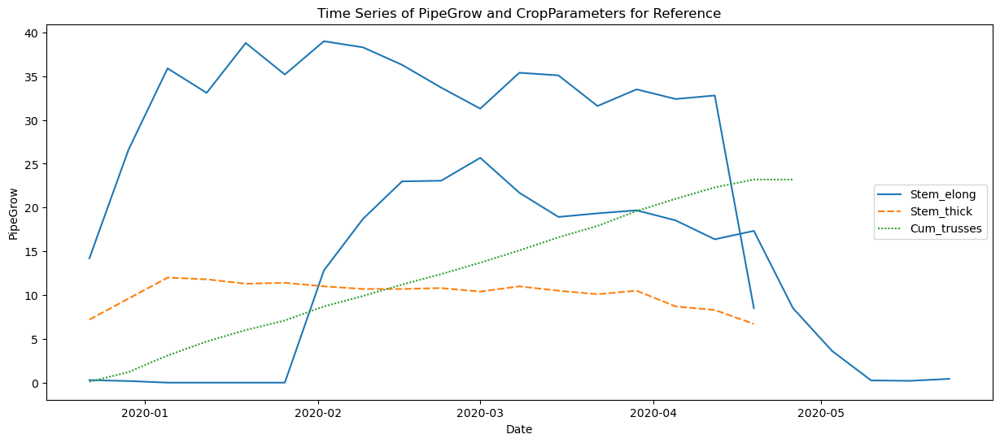

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



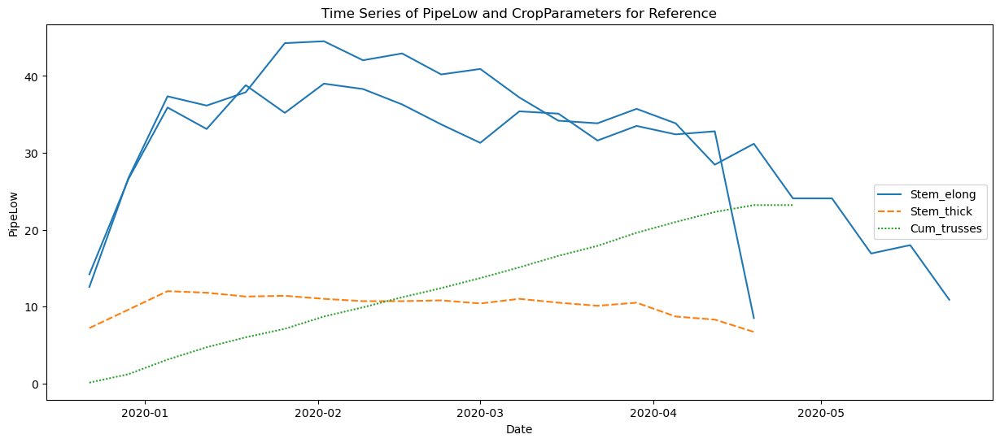

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



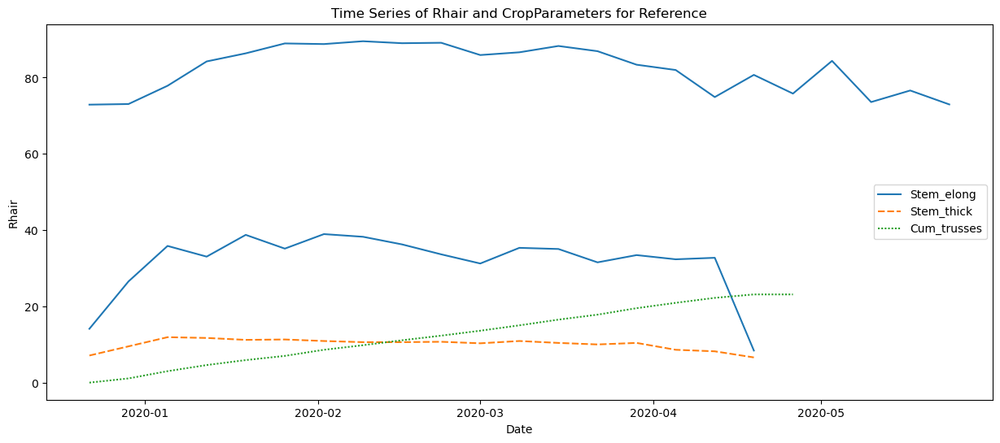

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



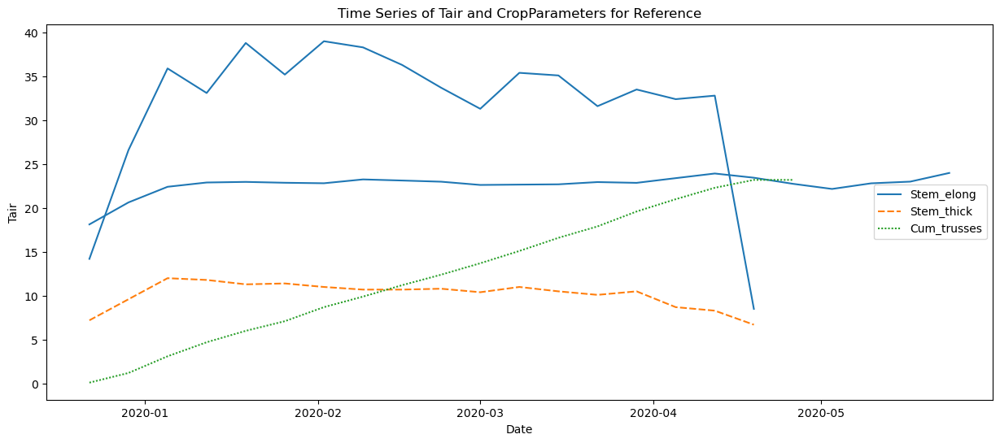

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



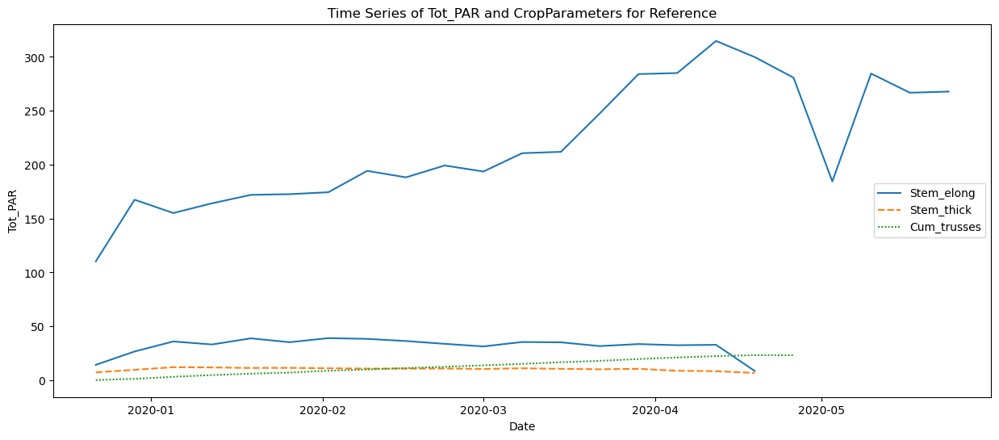

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



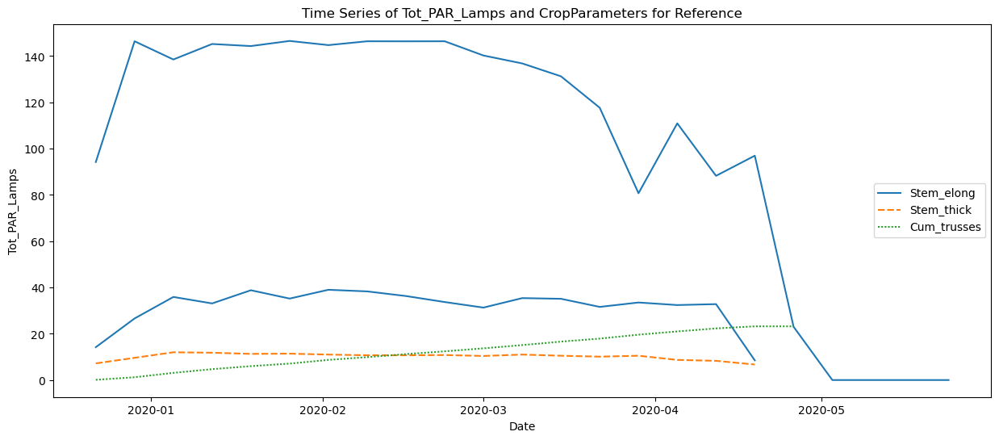

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



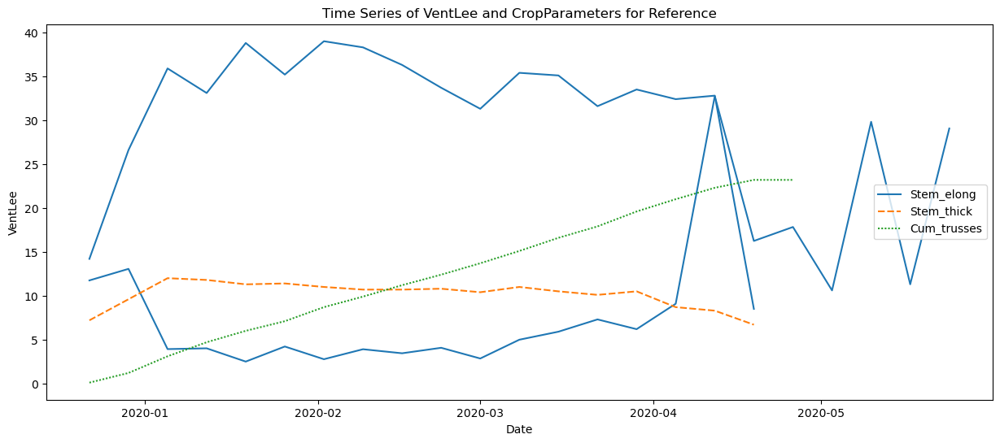

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



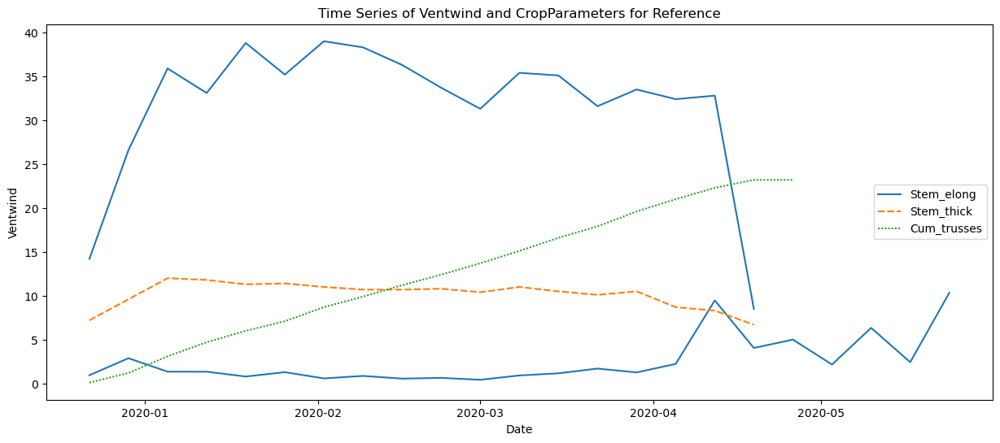

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



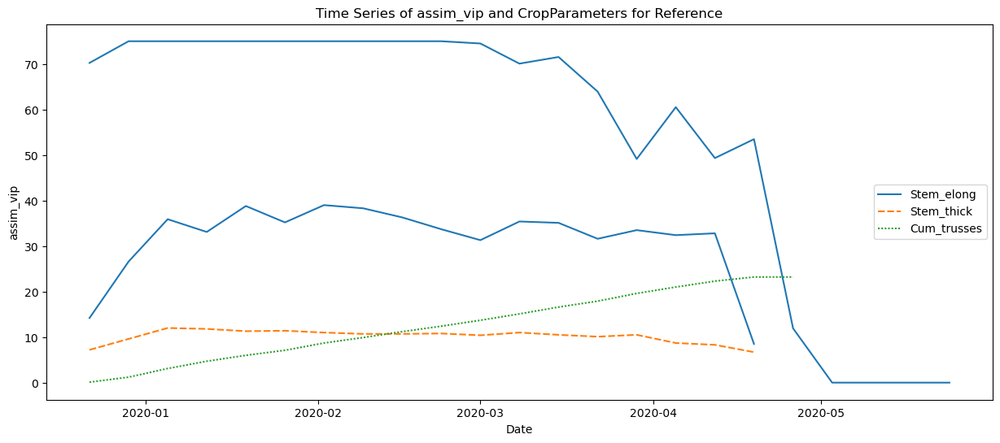

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



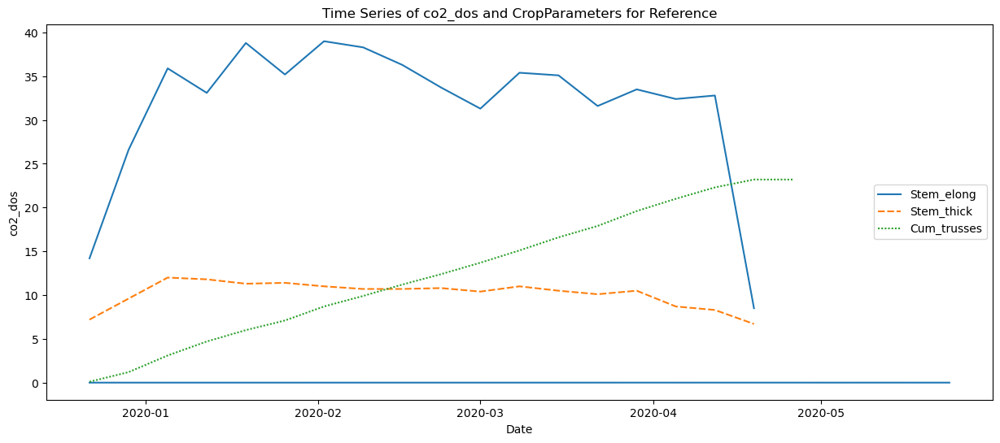

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



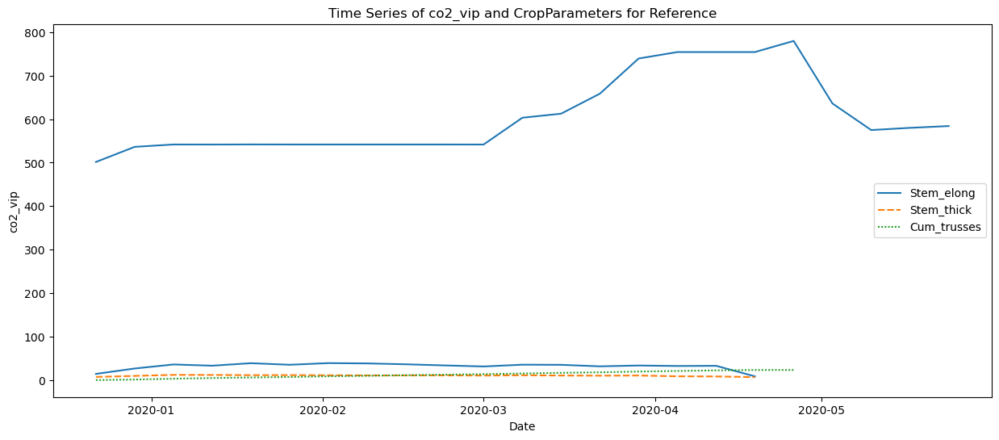

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



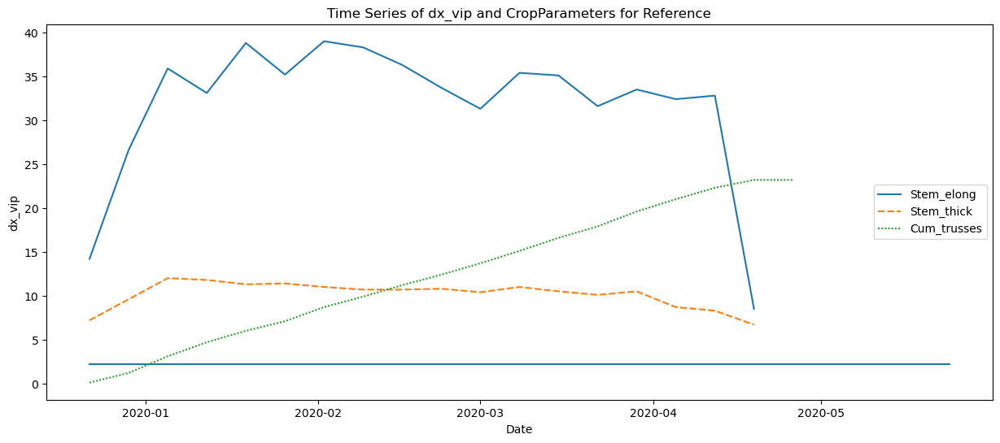

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



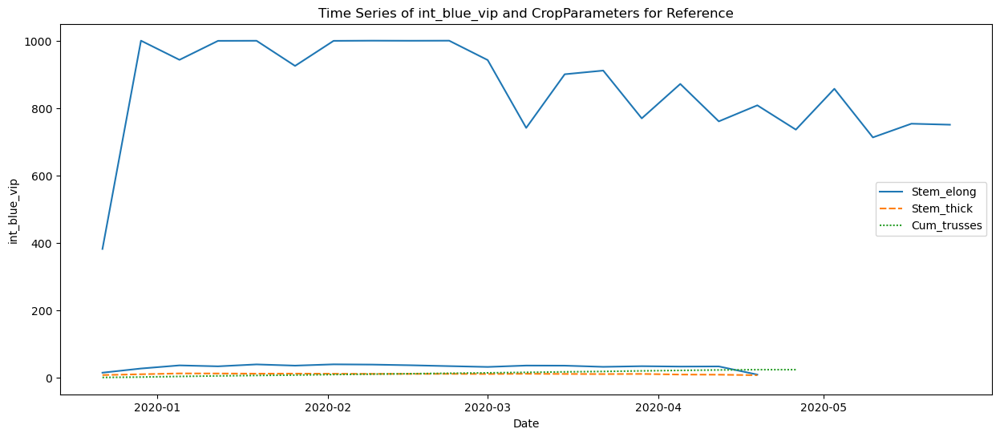

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



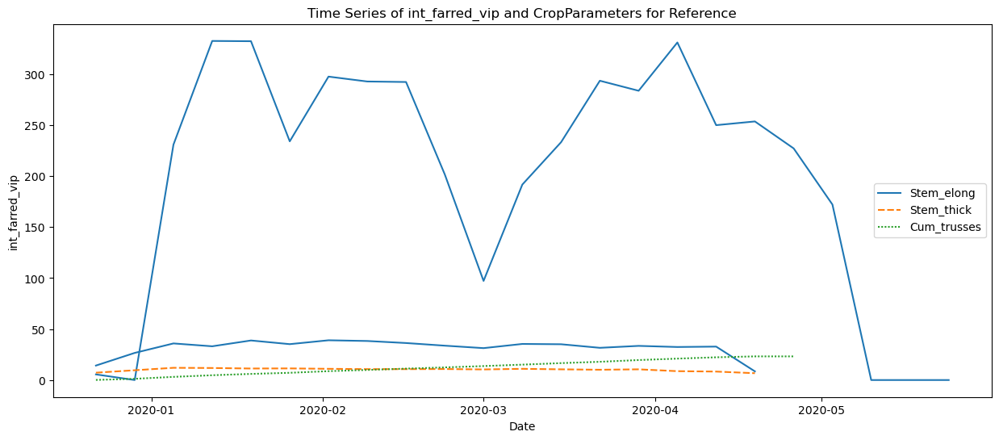

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



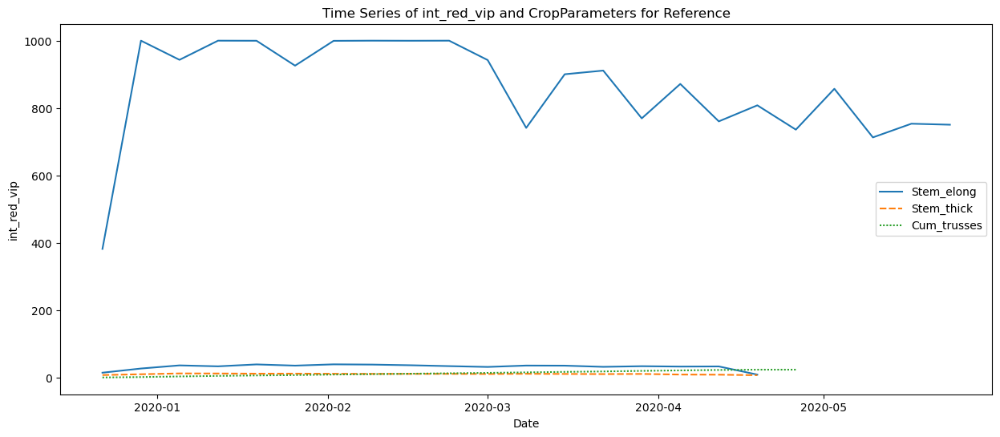

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



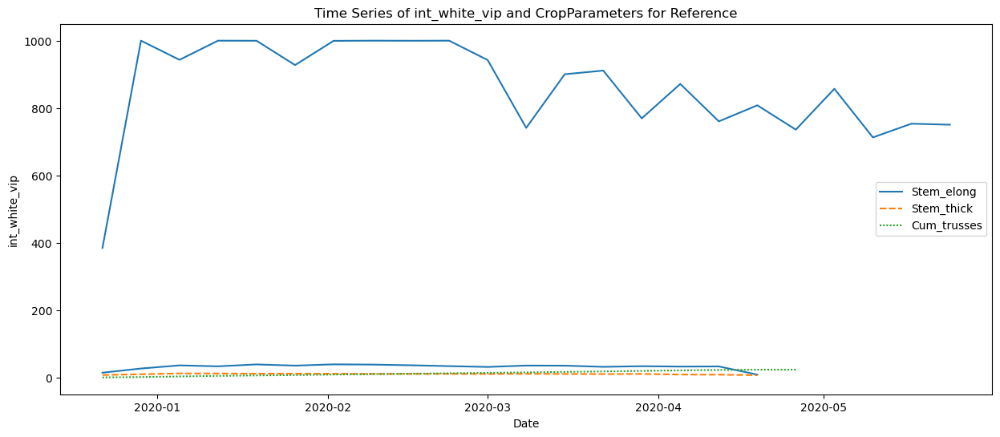

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



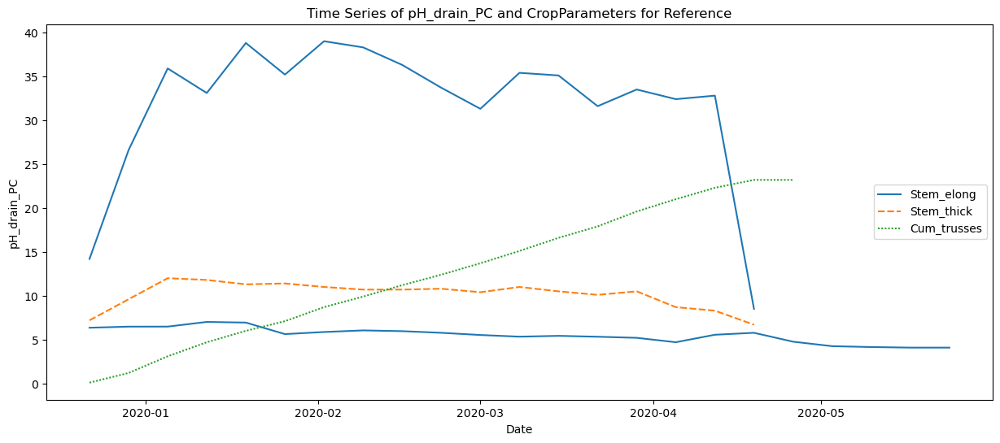

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



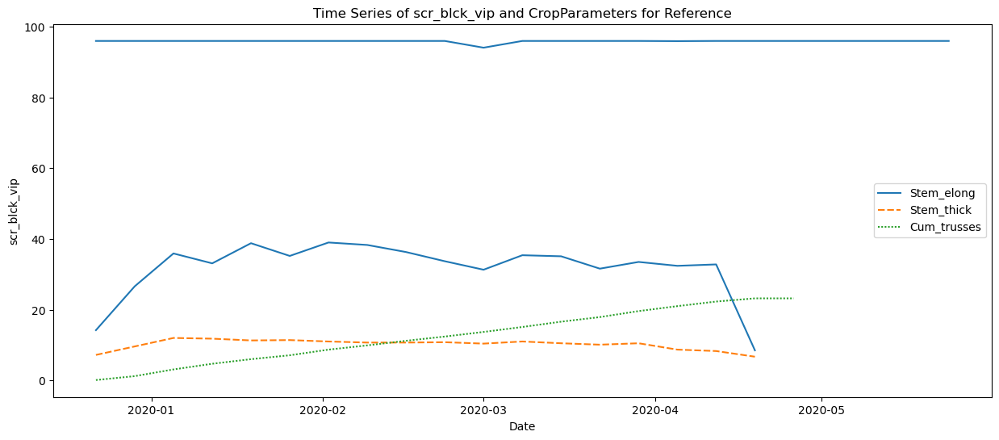

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



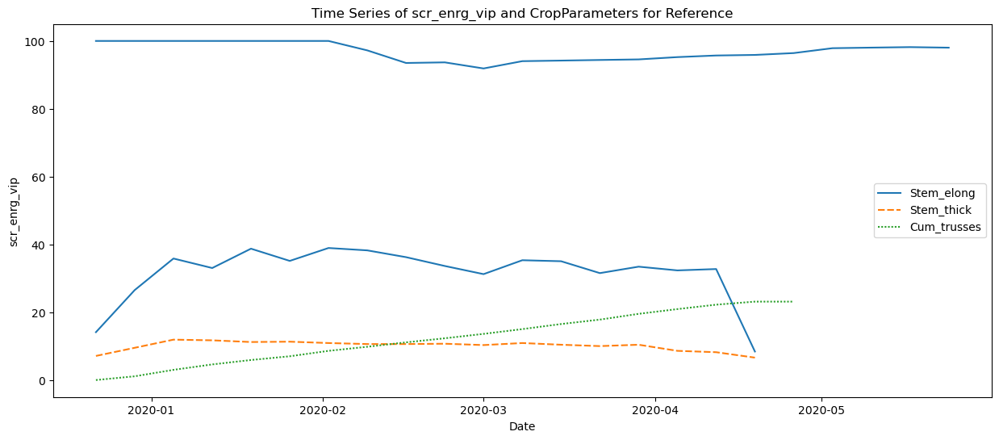

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



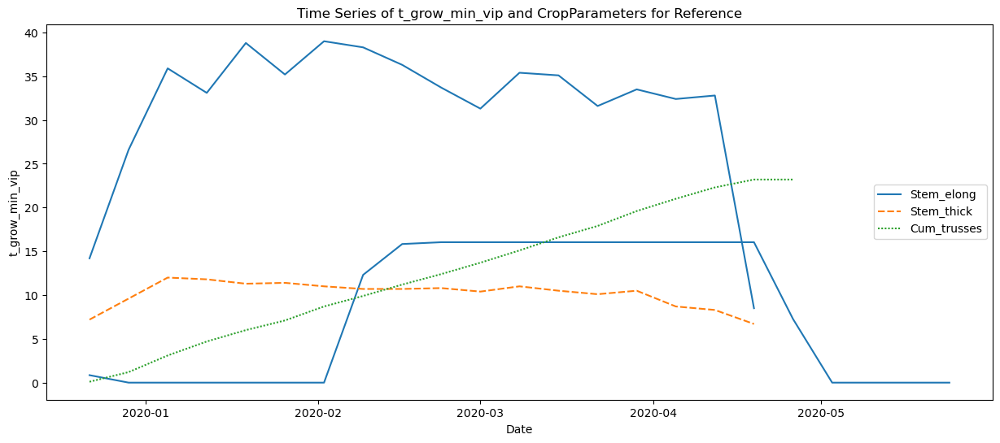

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



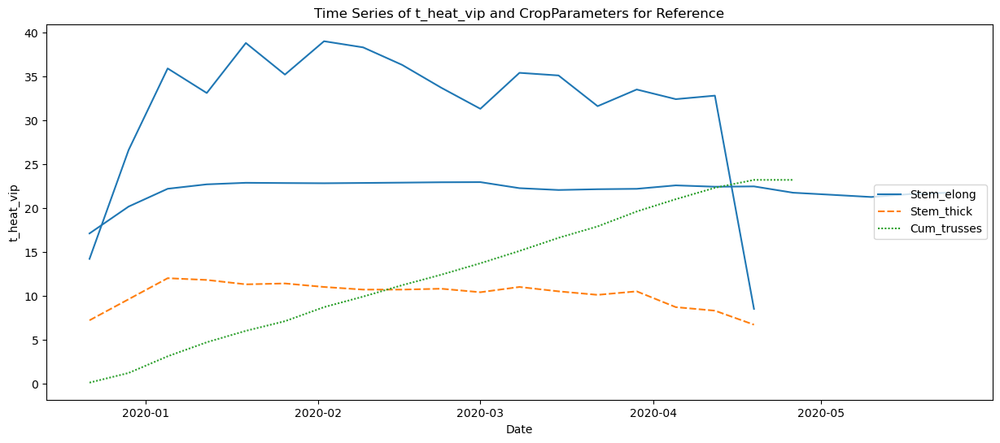

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



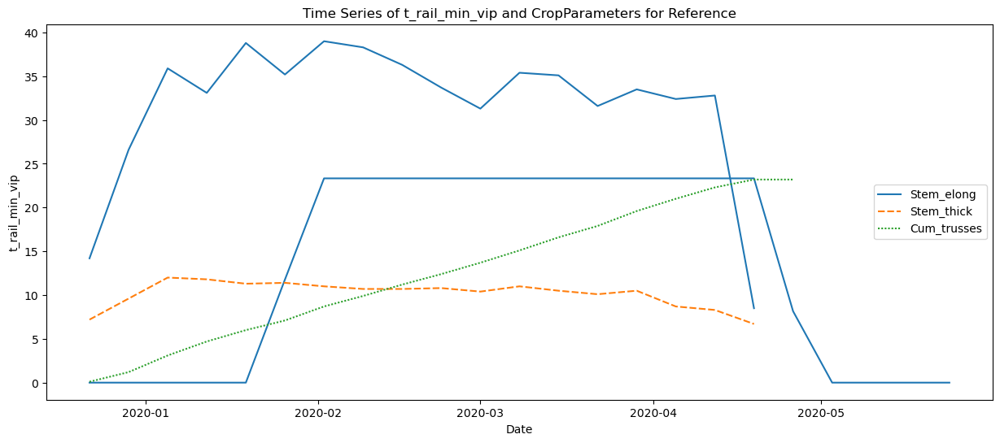

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



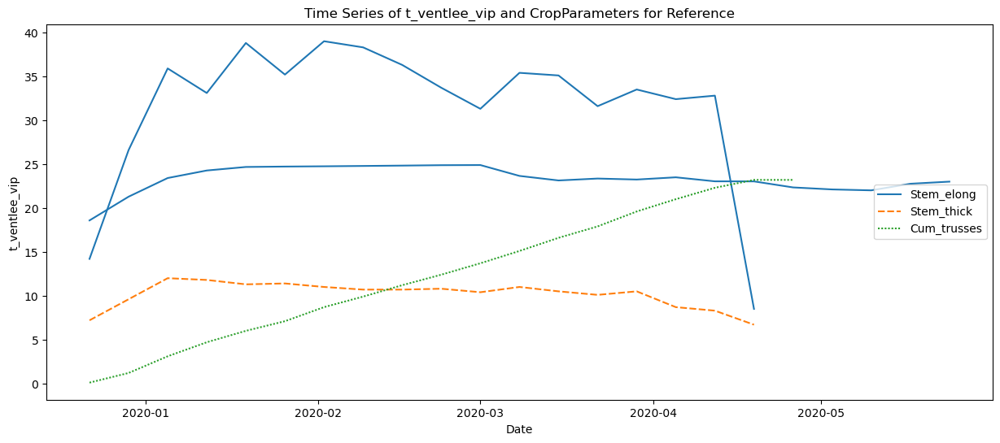

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



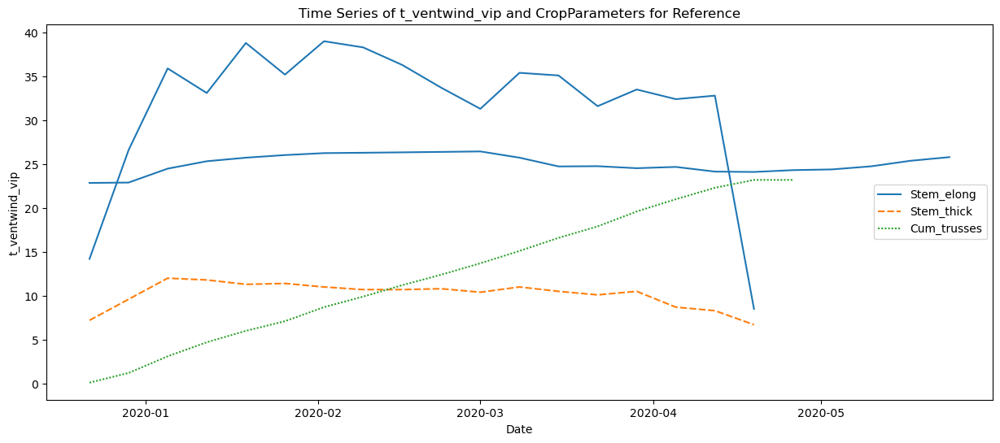

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



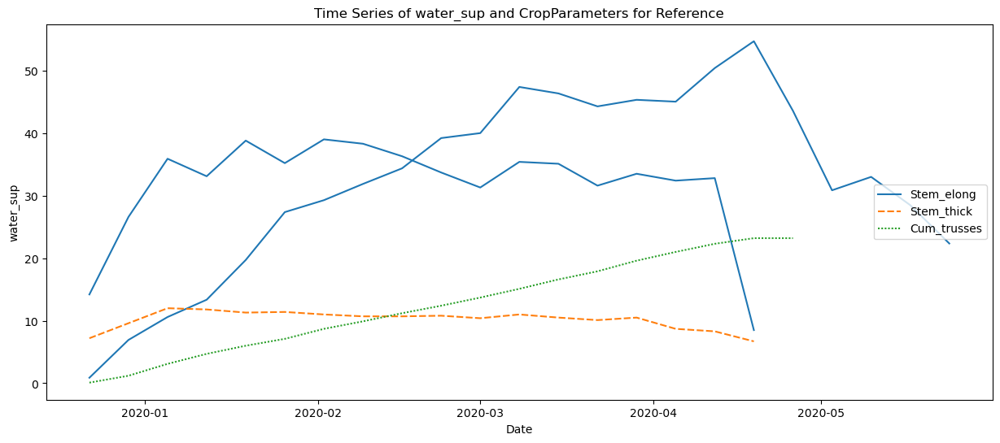

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



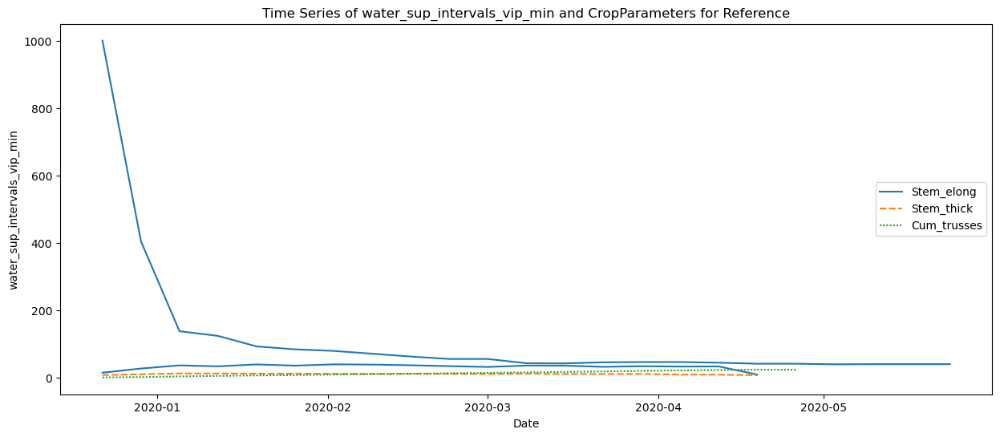

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



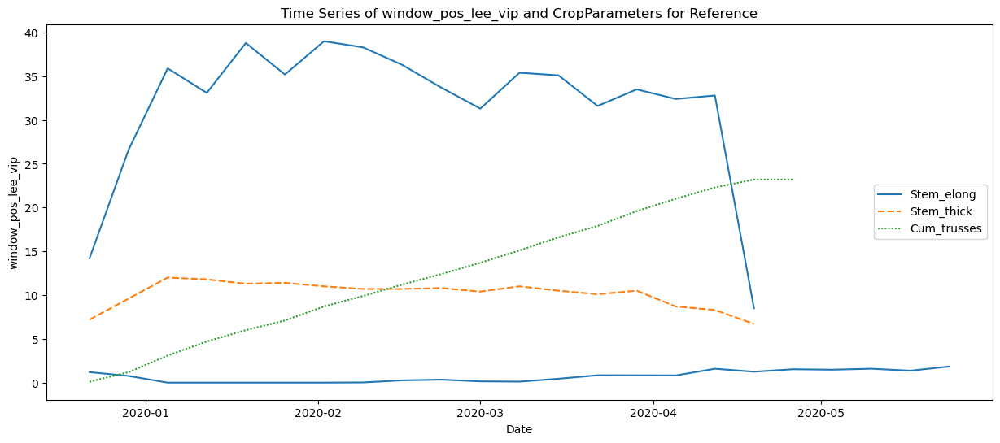

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



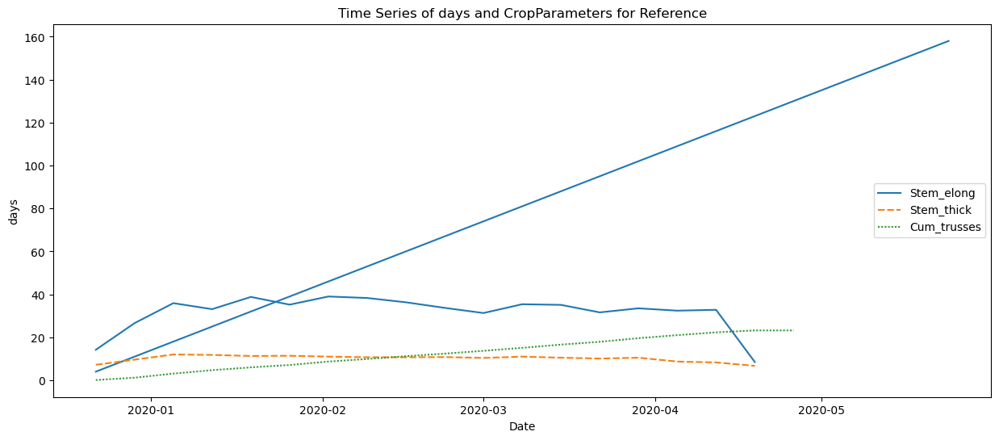

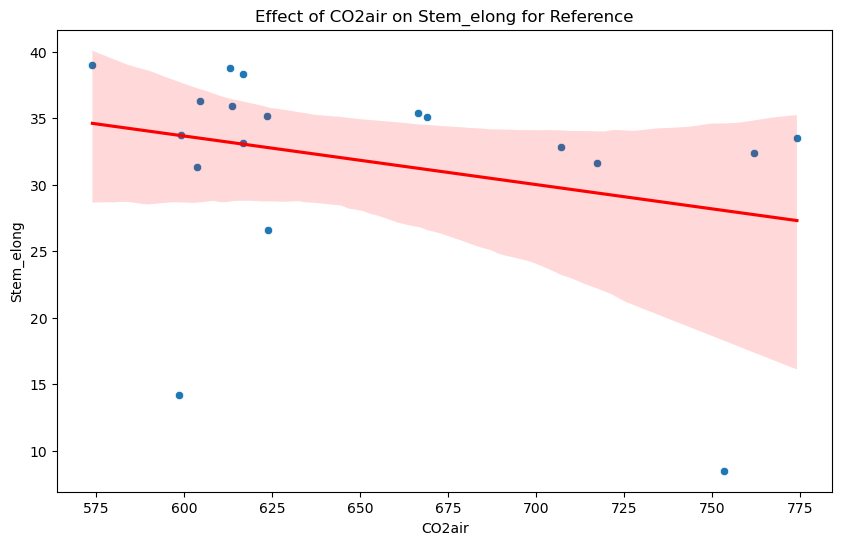

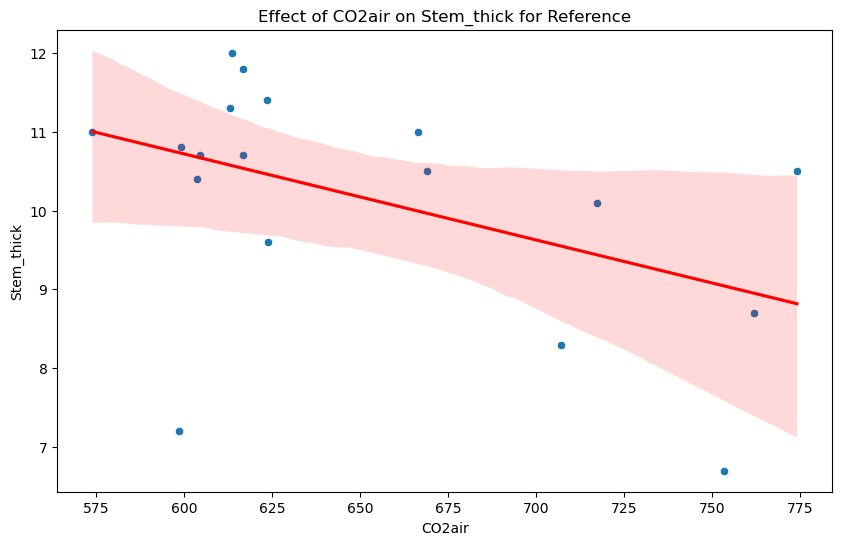

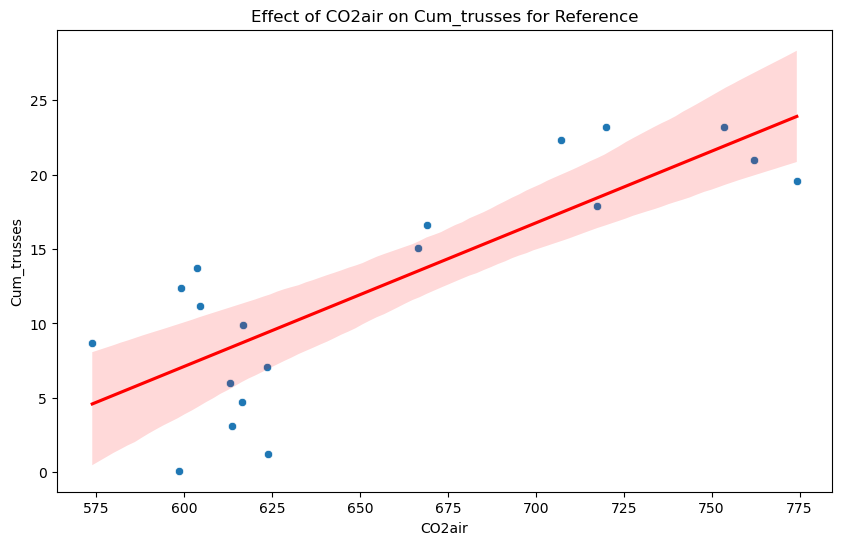

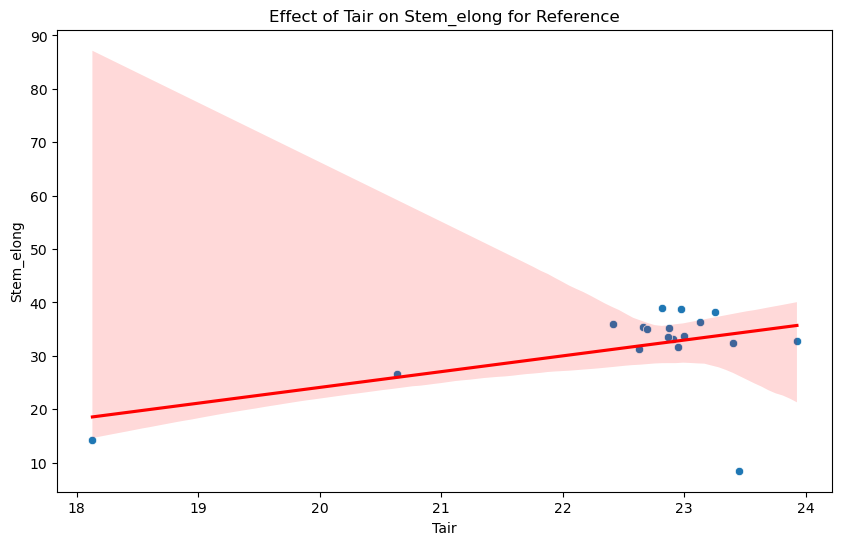

...

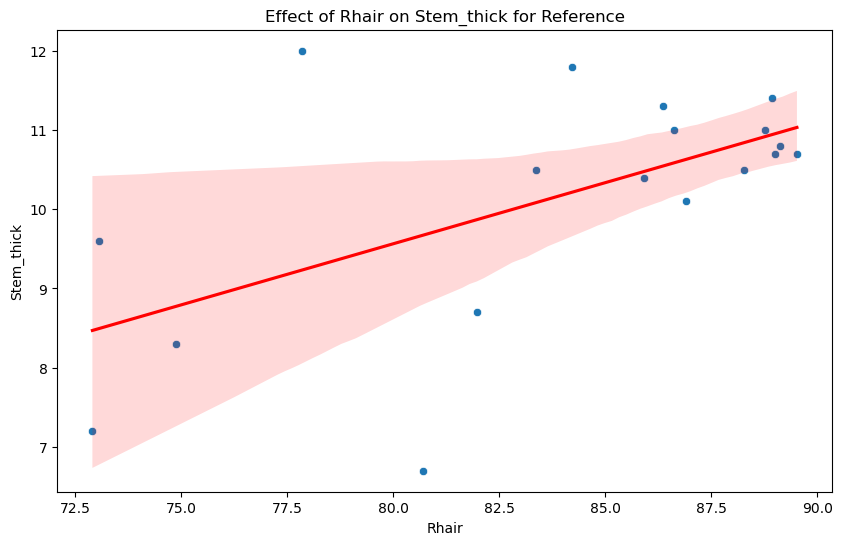

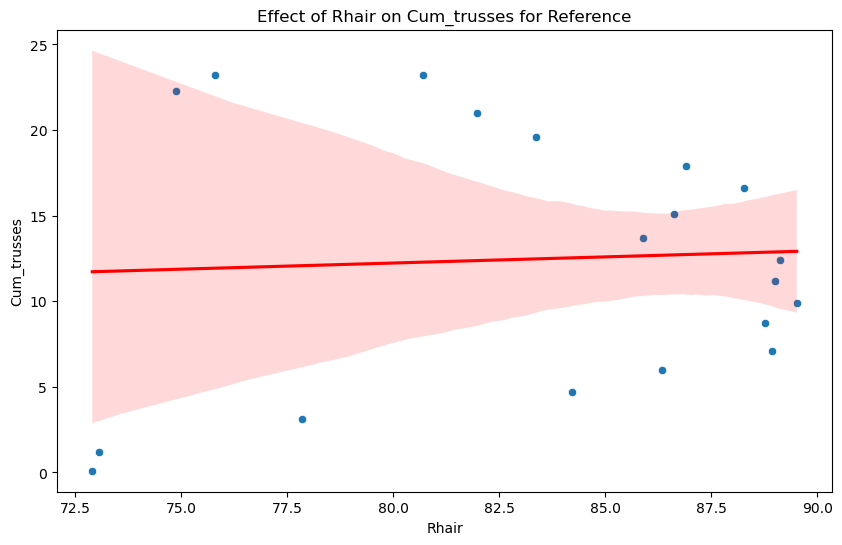

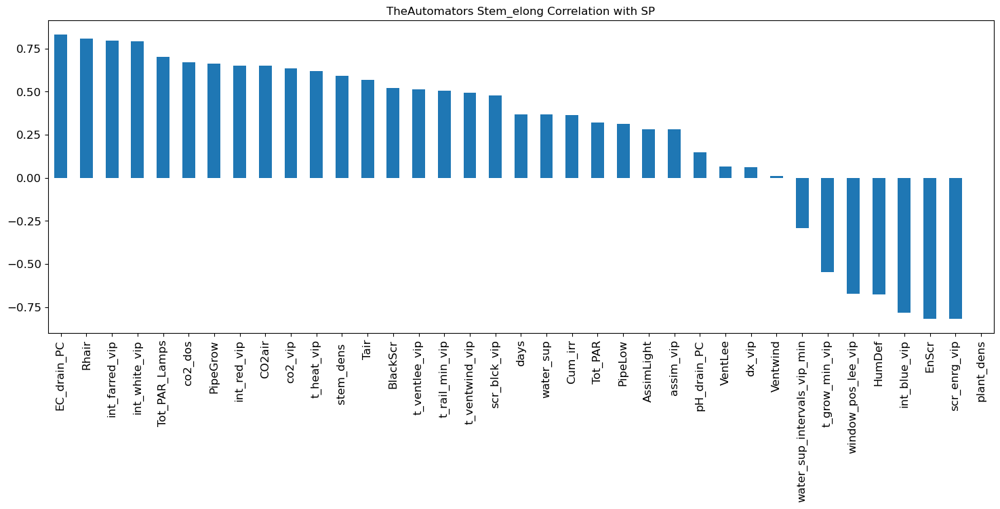

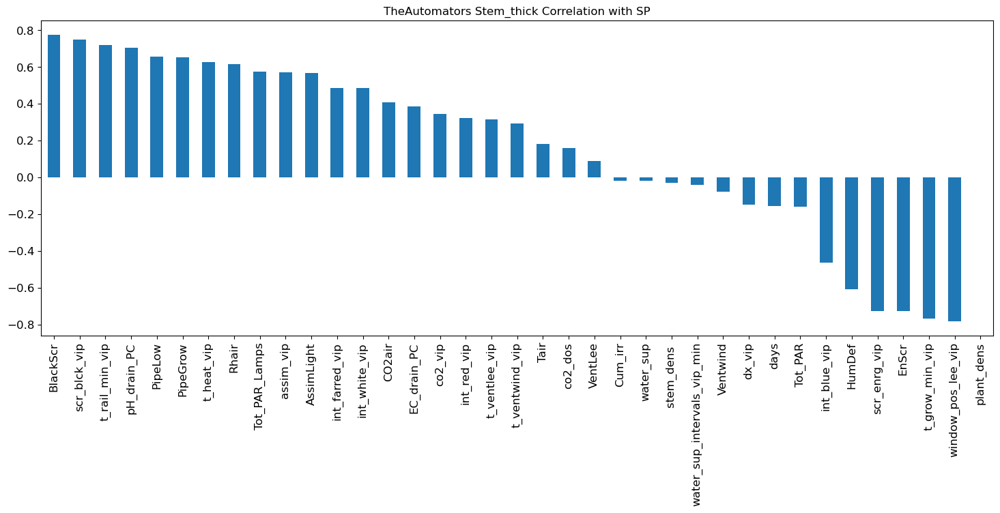

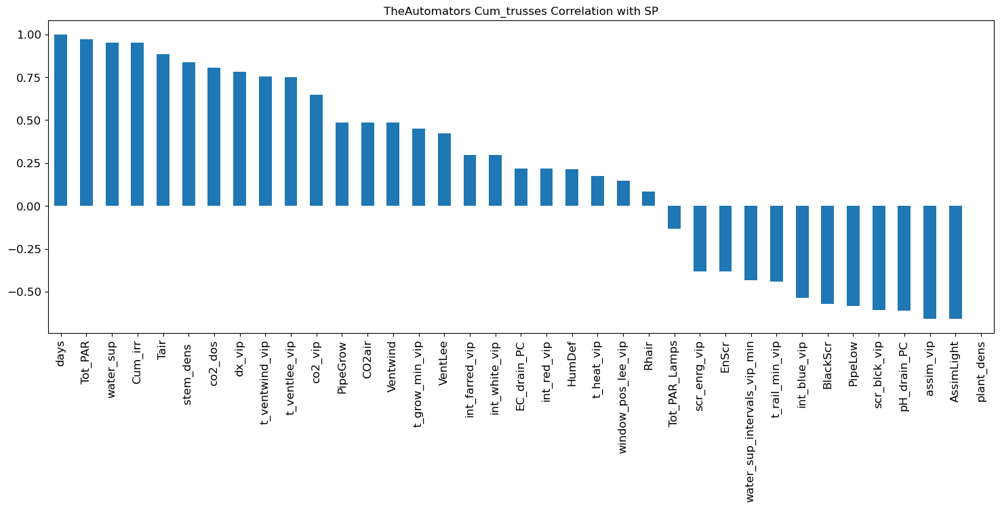

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



<Figure size 640x480 with 0 Axes>

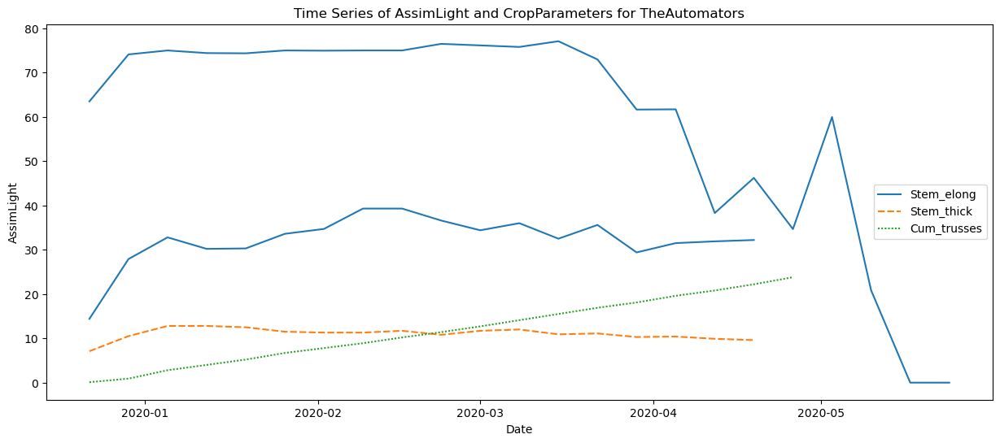

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



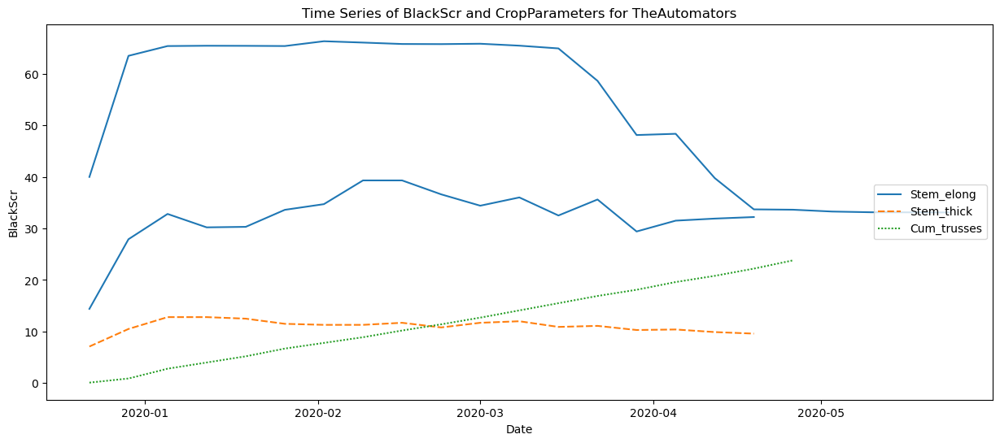

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



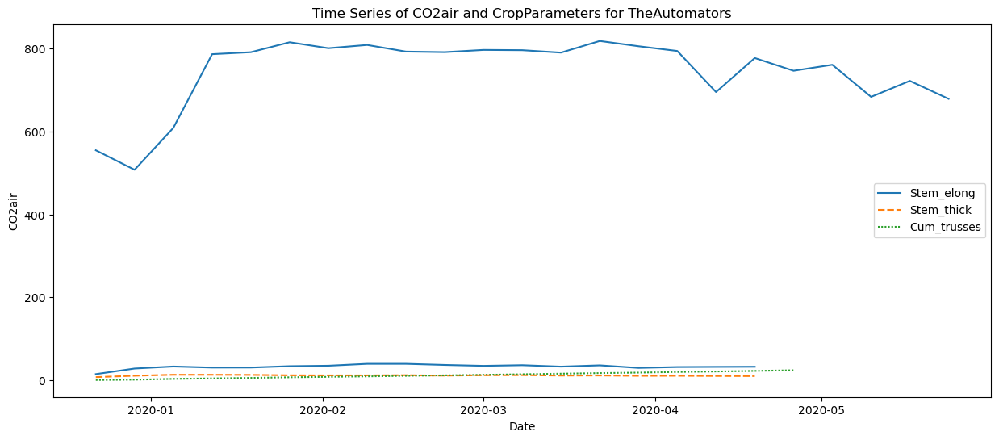

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



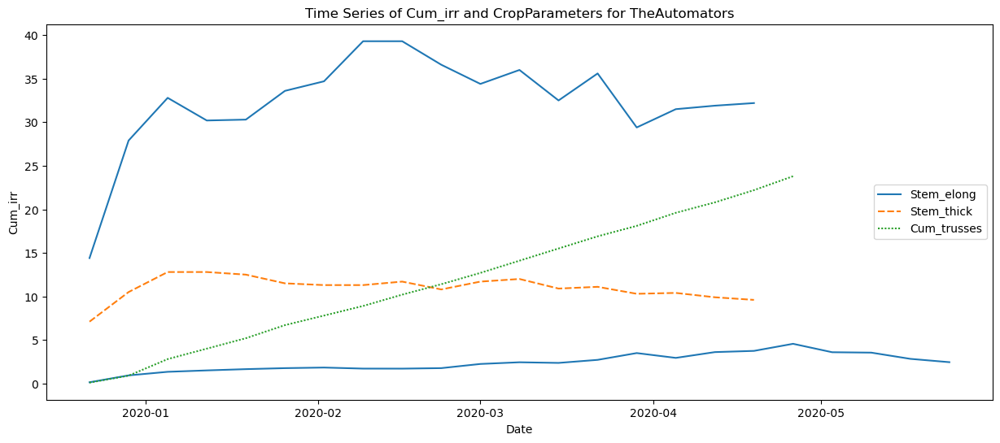

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



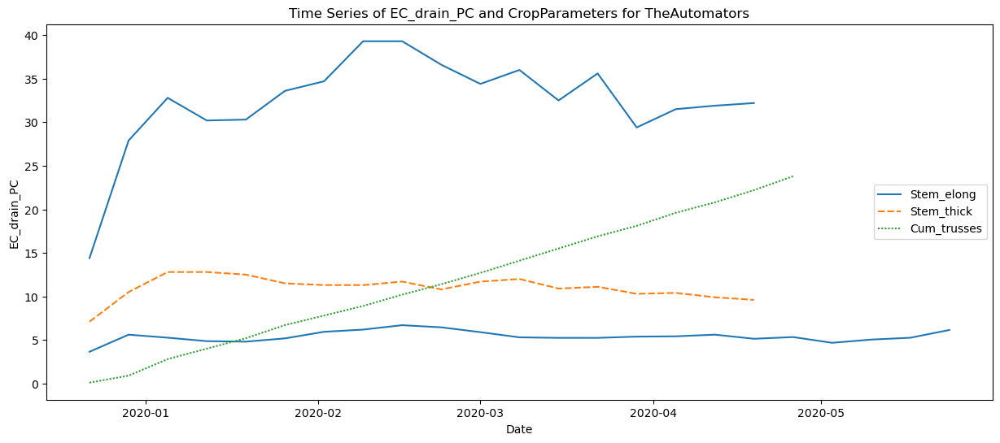

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



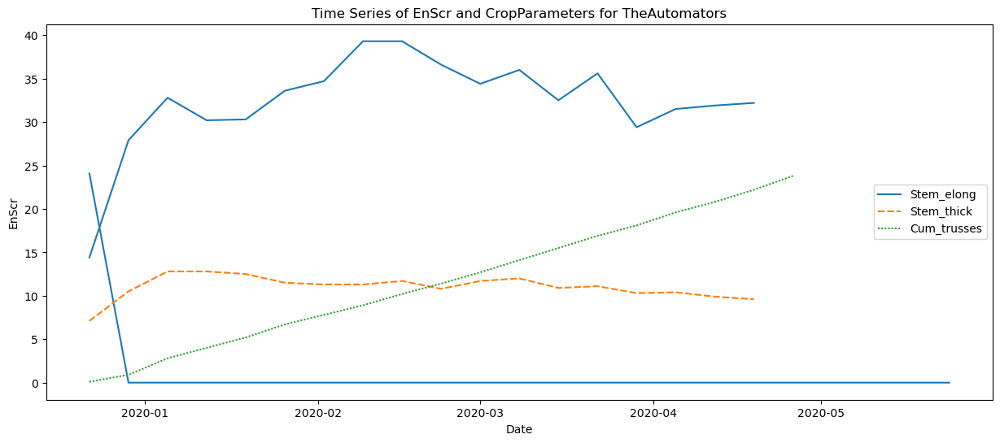

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



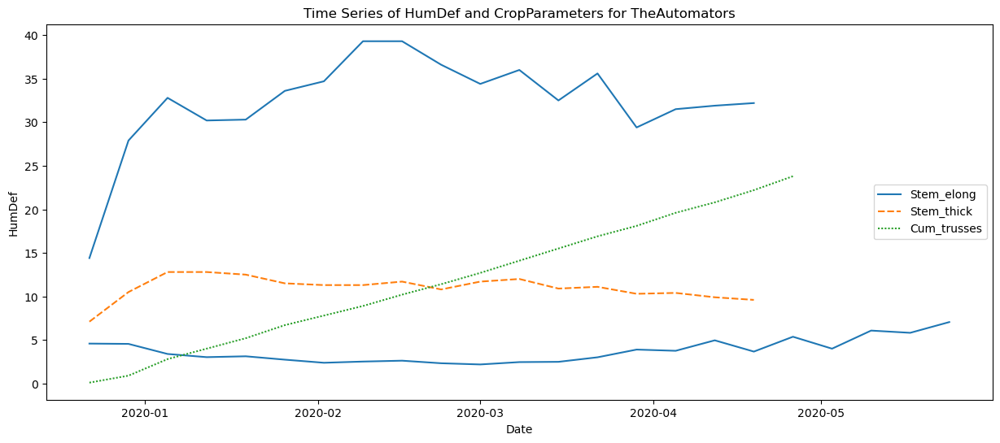

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



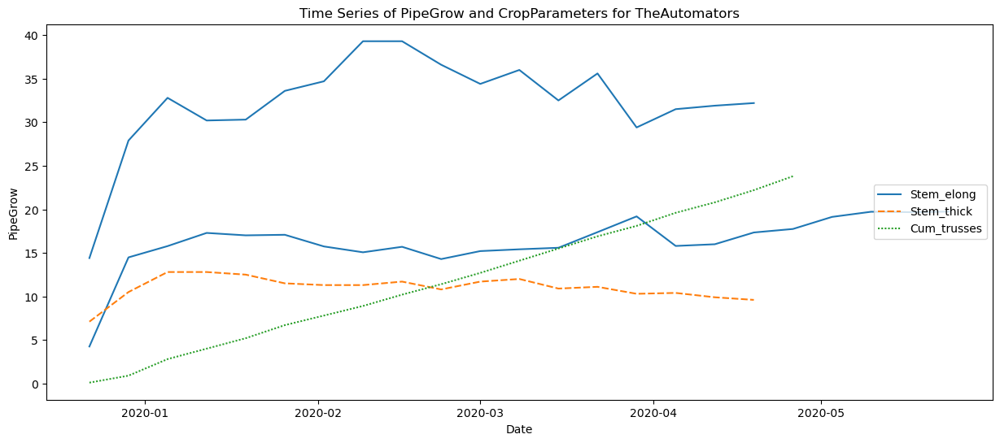

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



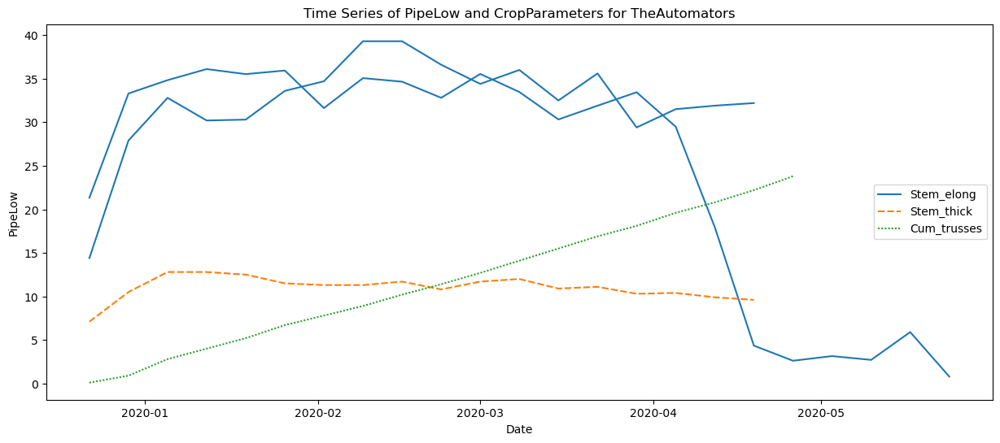

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



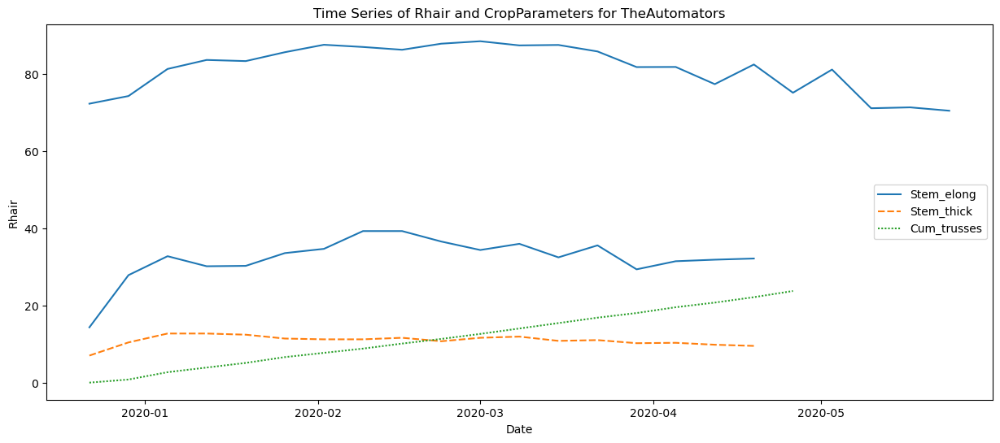

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



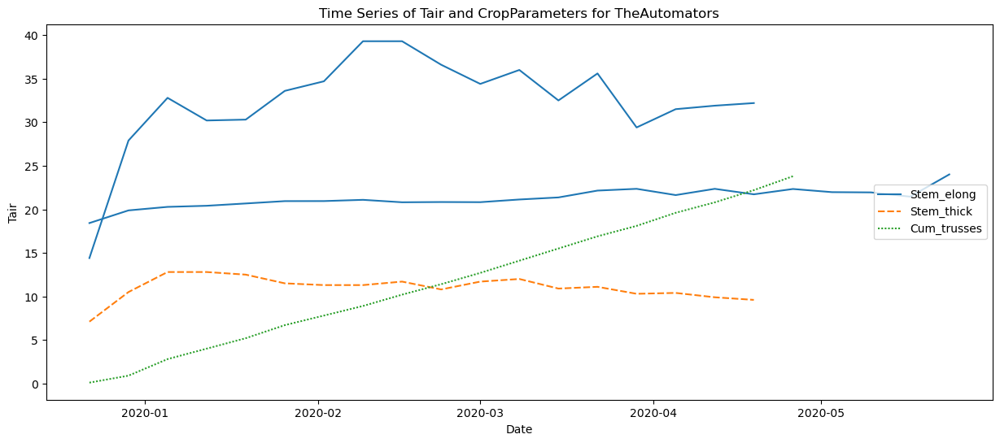

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



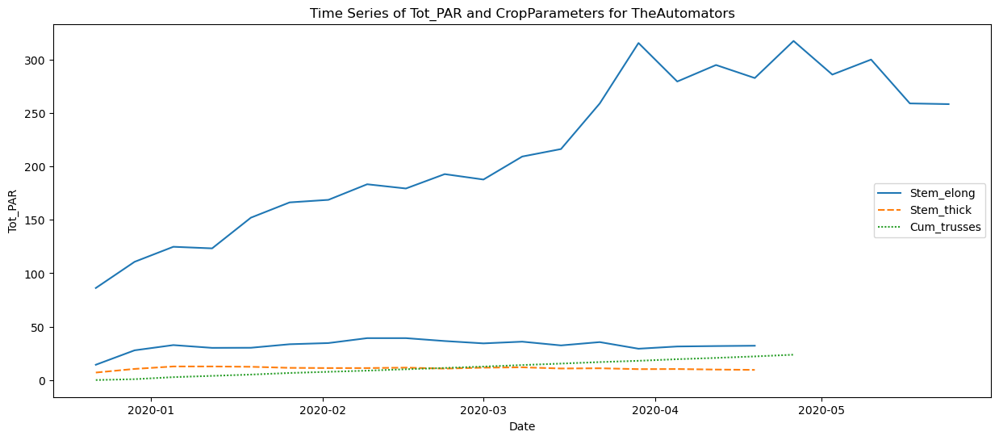

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



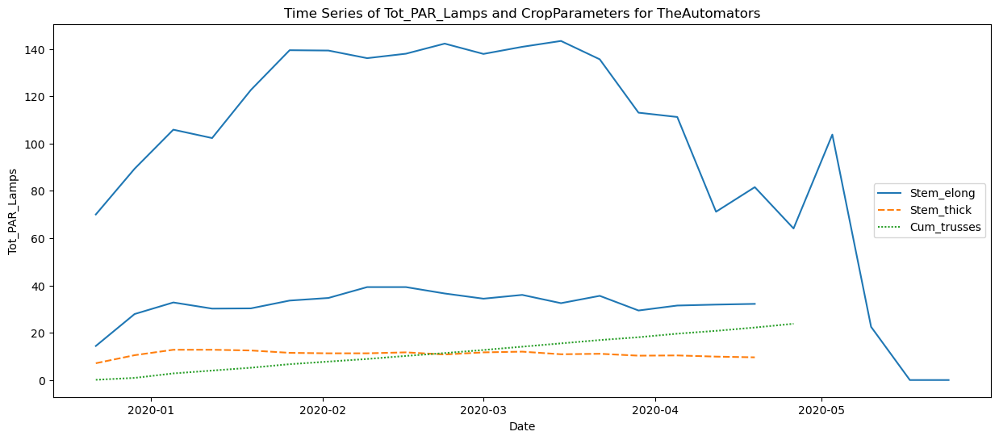

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



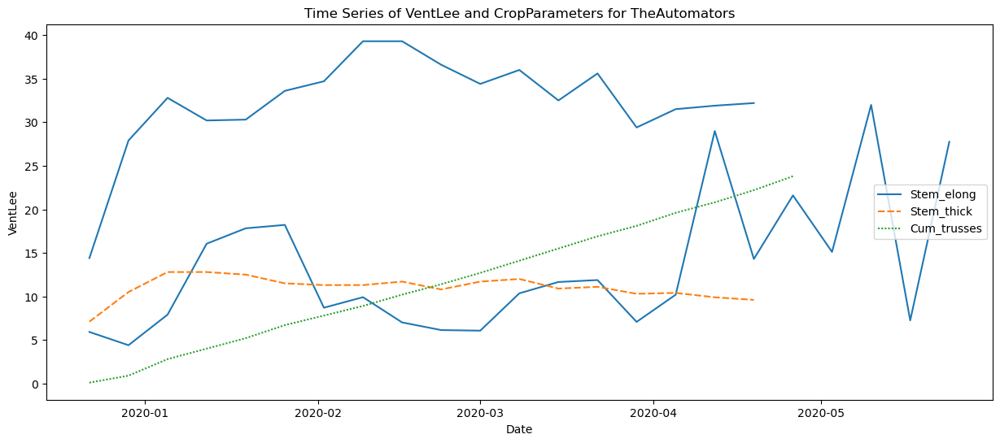

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



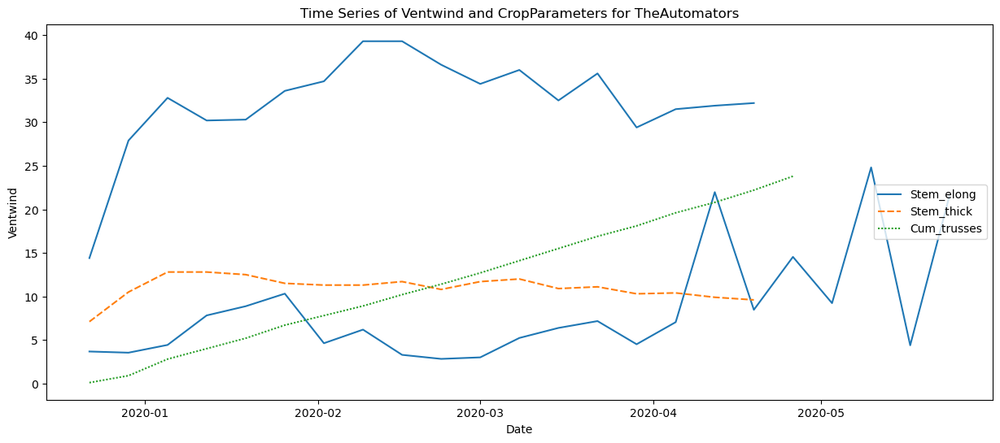

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



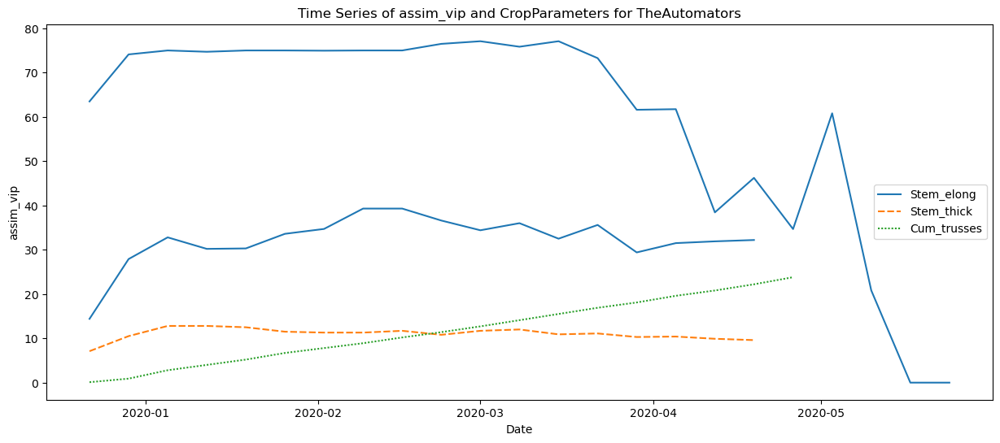

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



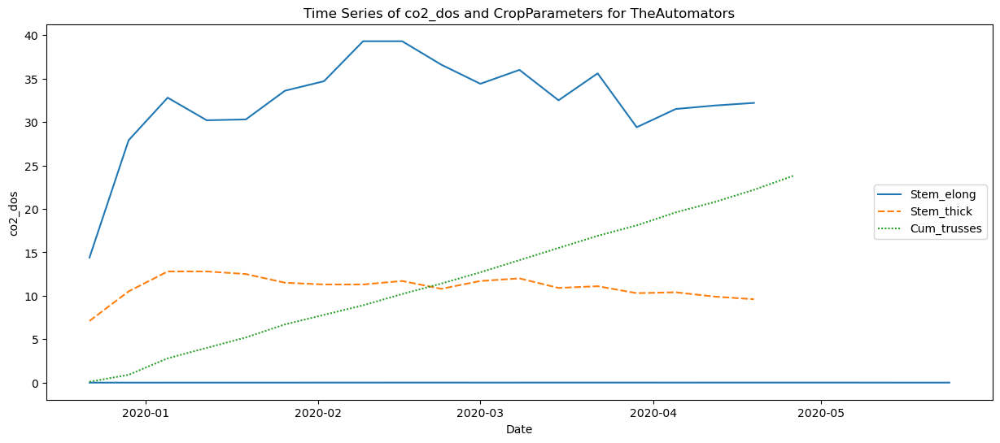

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



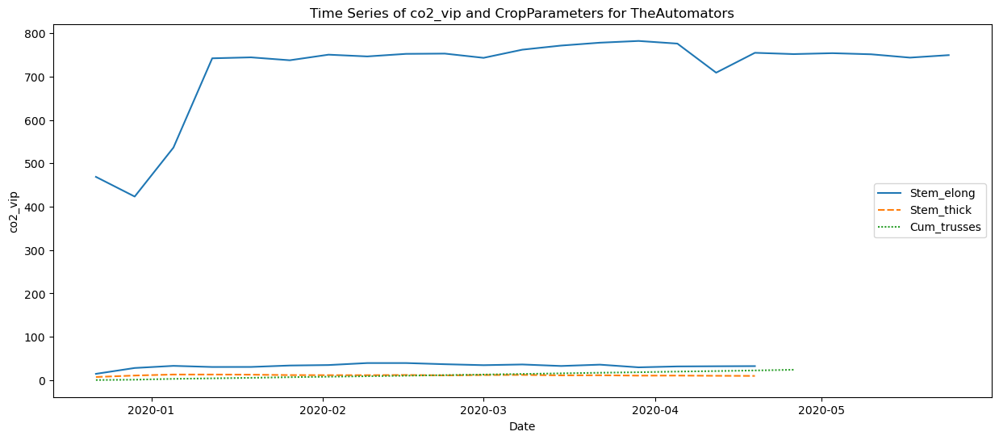

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



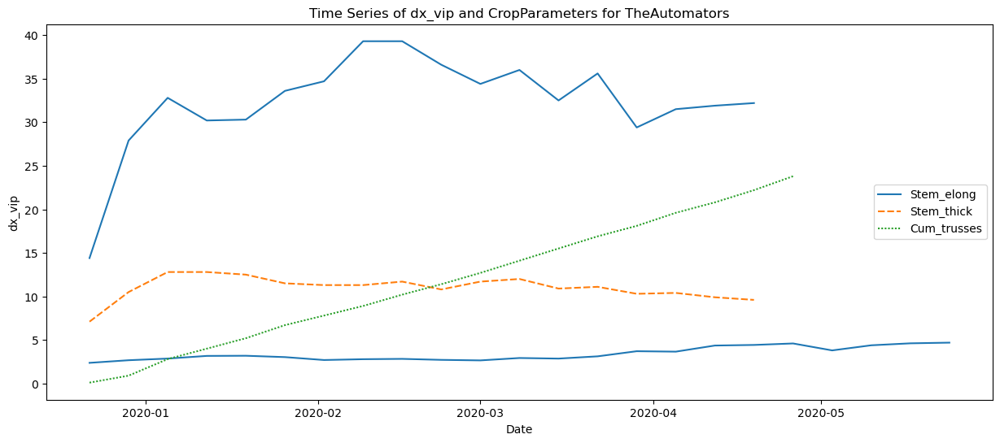

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



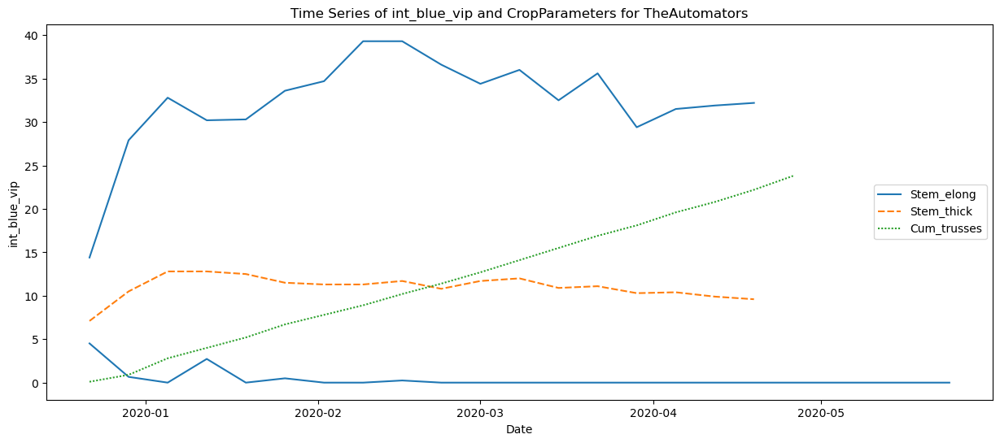

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



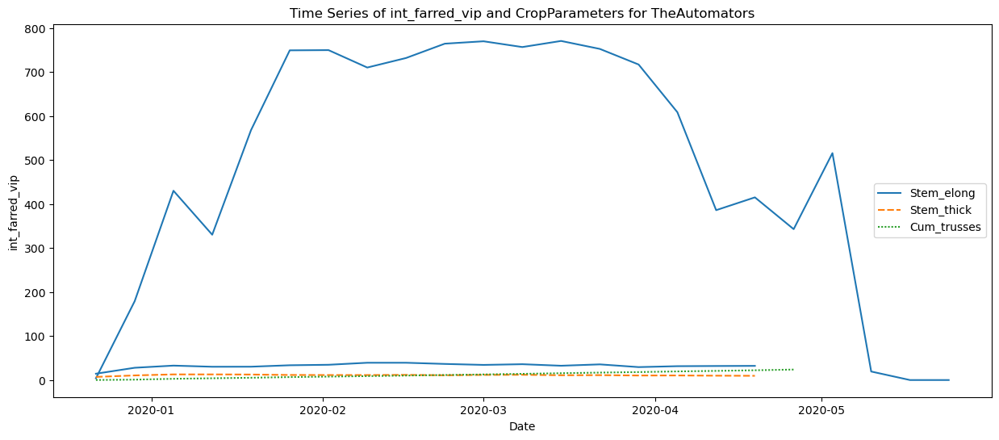

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



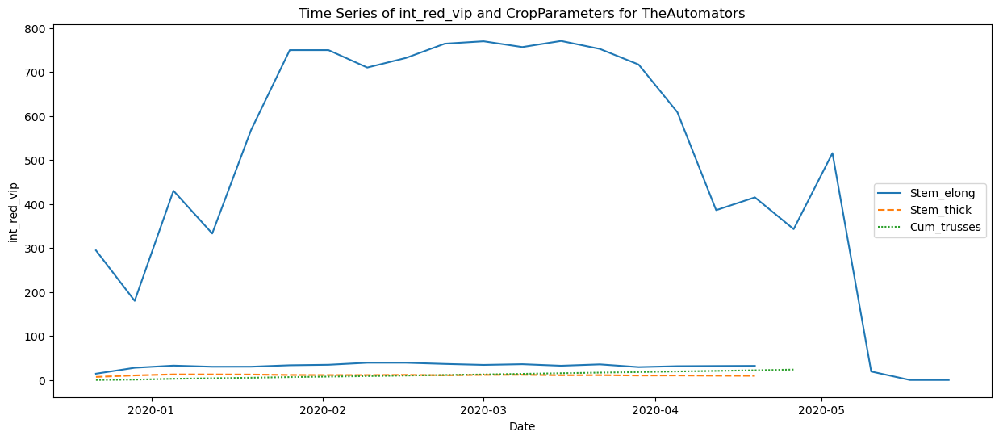

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



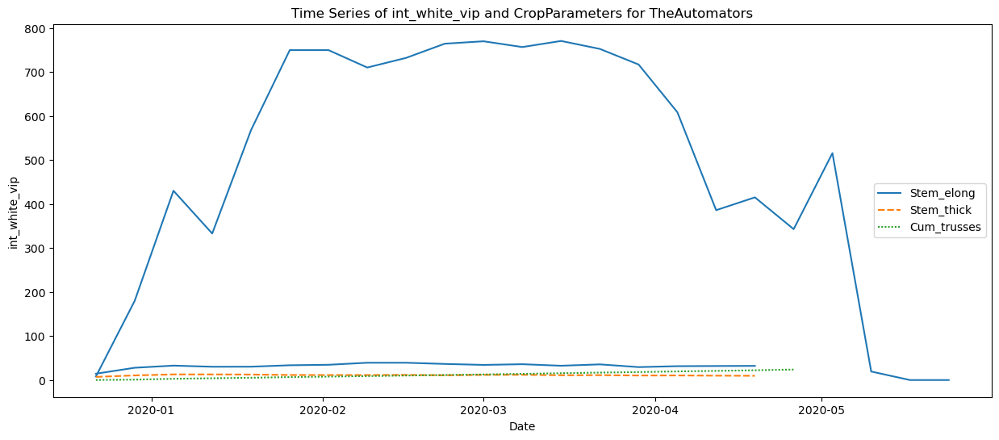

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



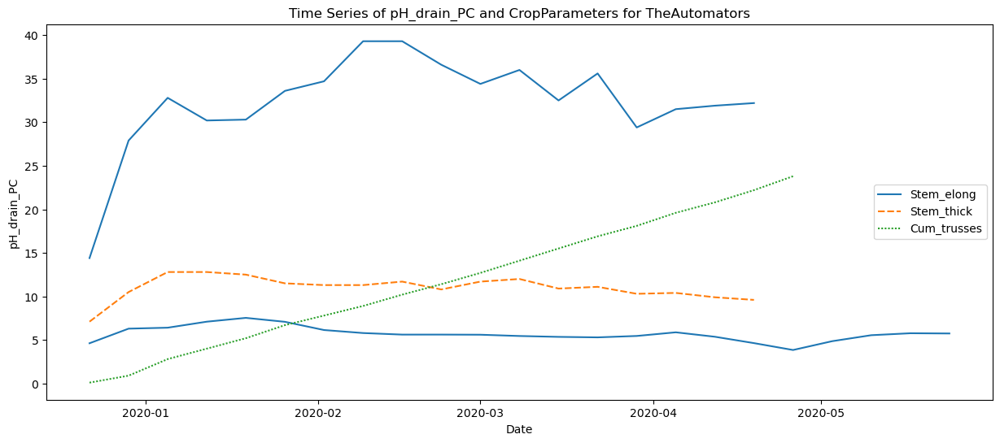

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



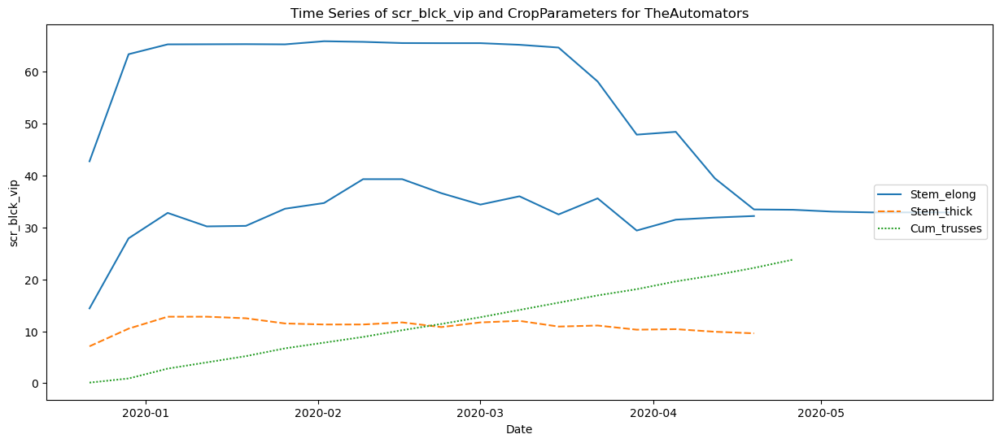

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



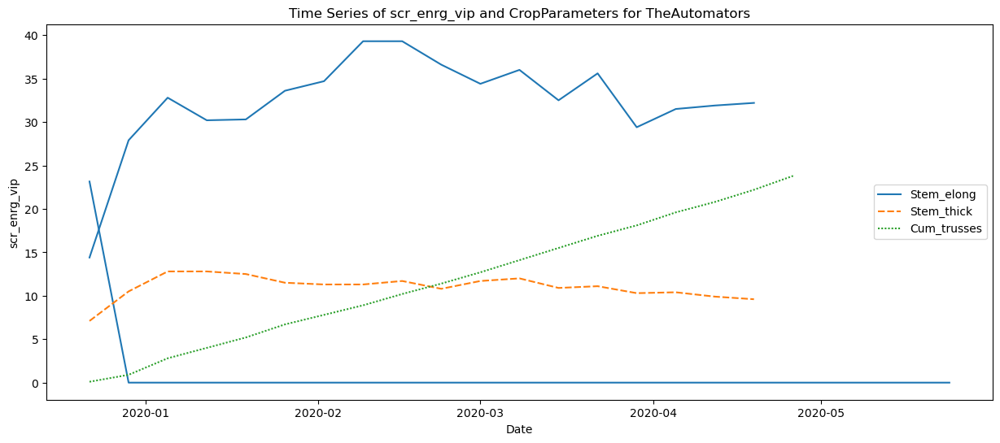

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



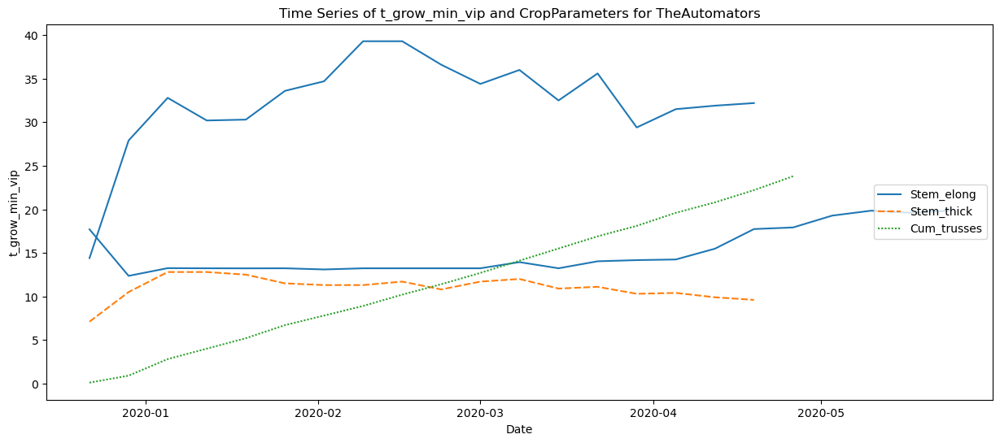

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



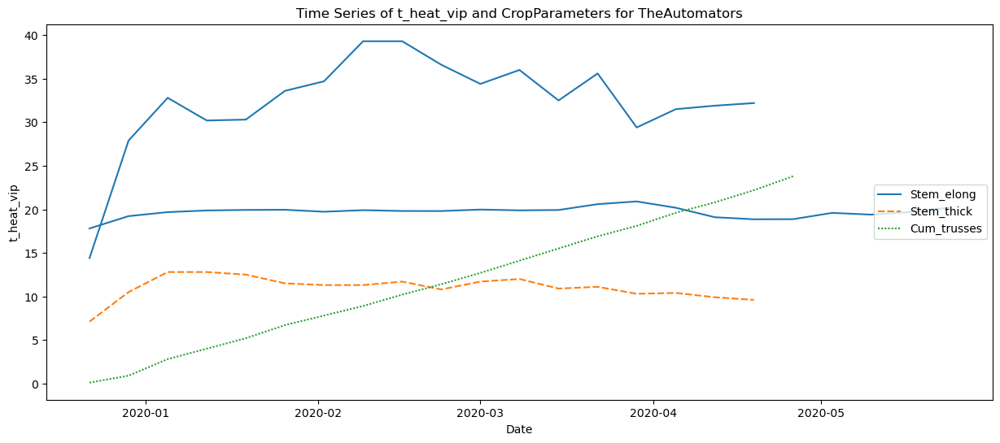

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



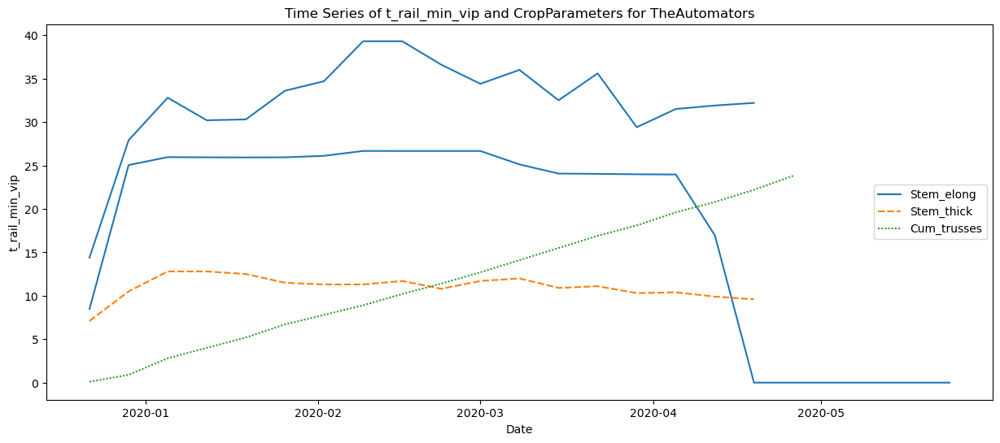

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



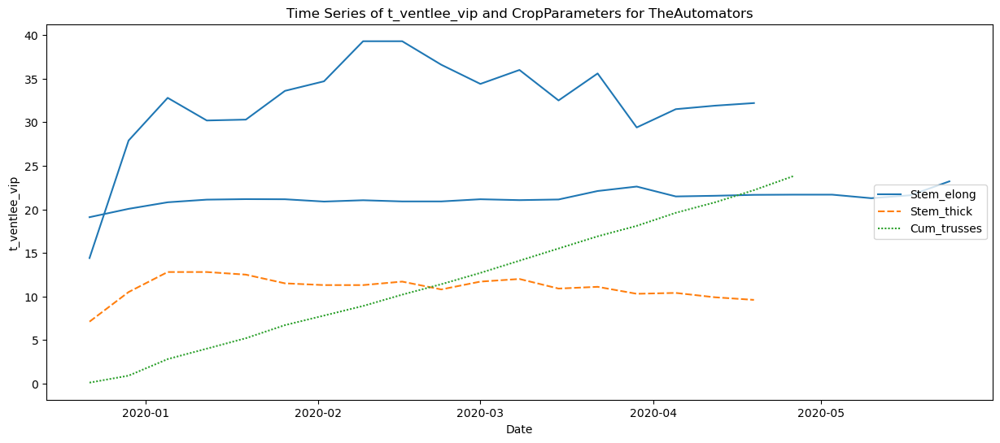

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



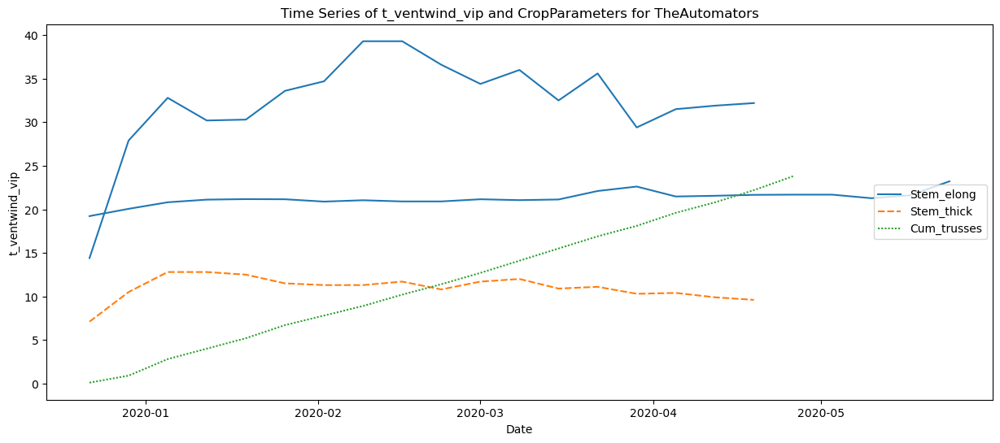

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



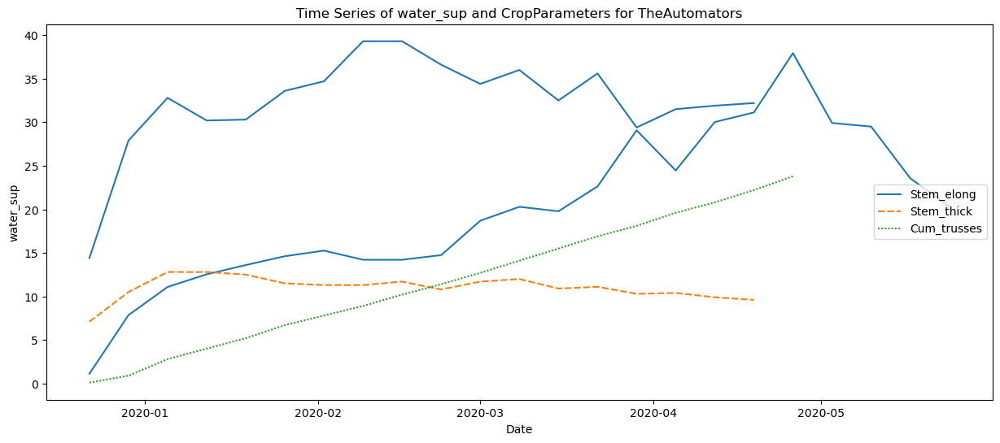

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



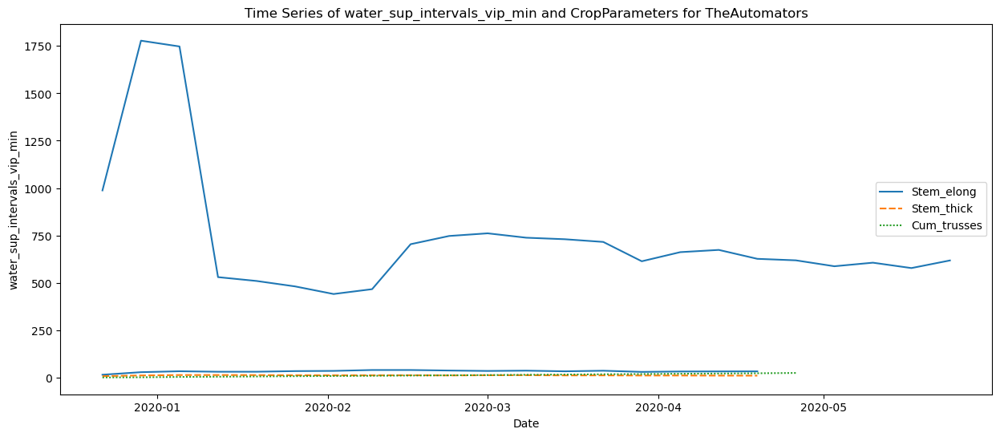

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



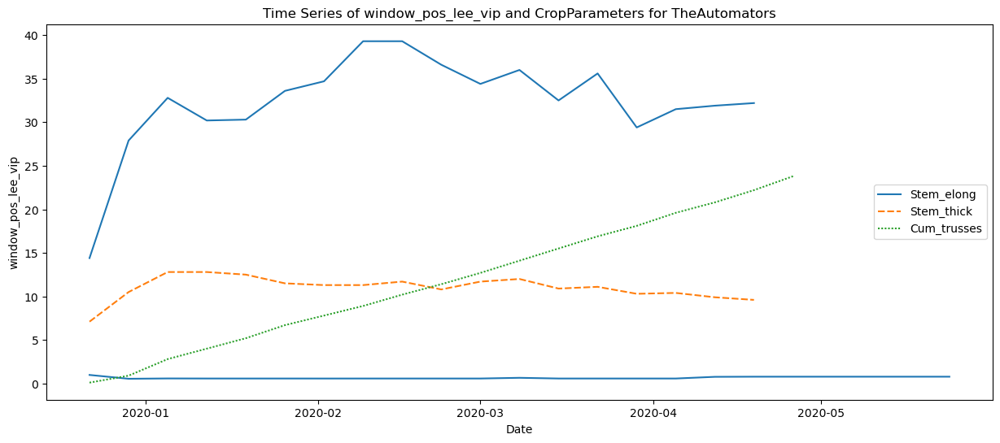

C:\Users\user\AppData\Local\Temp\ipykernel_27748\1535359500.py:45: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



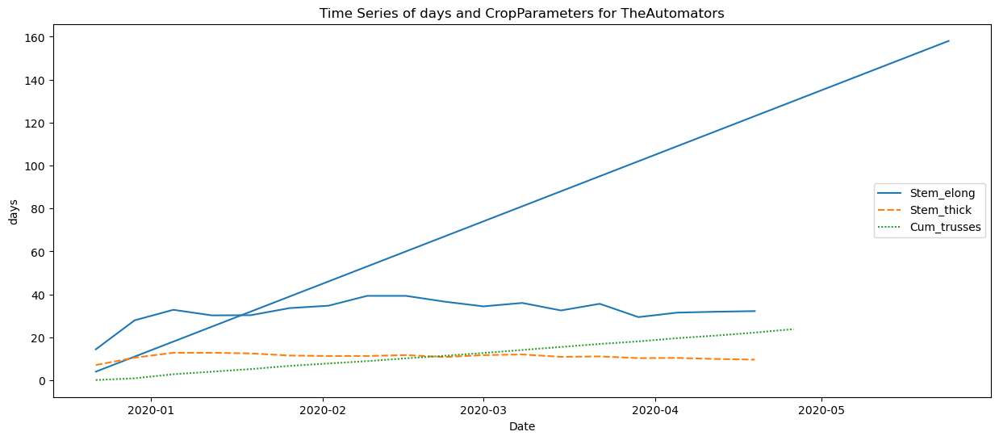

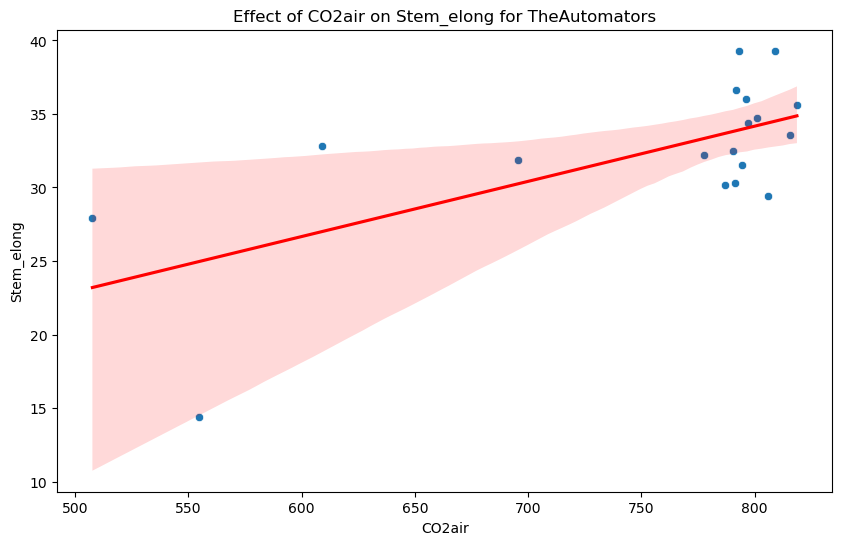

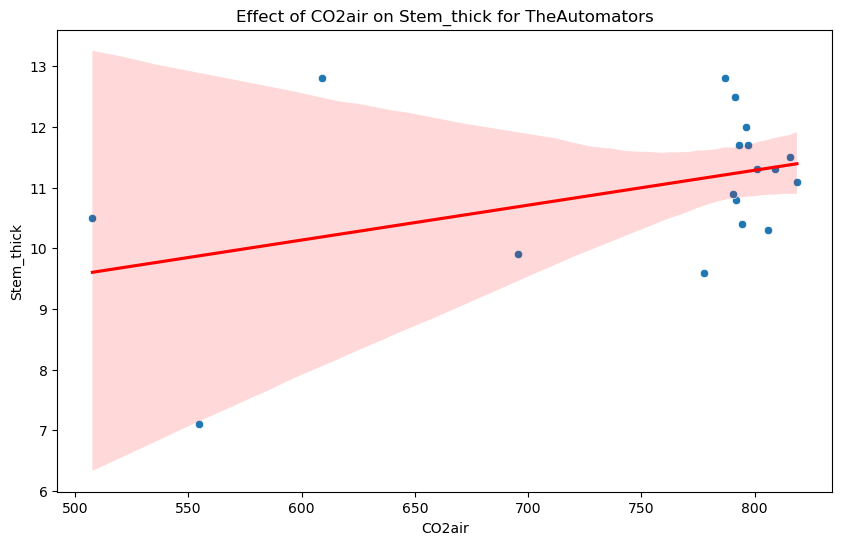

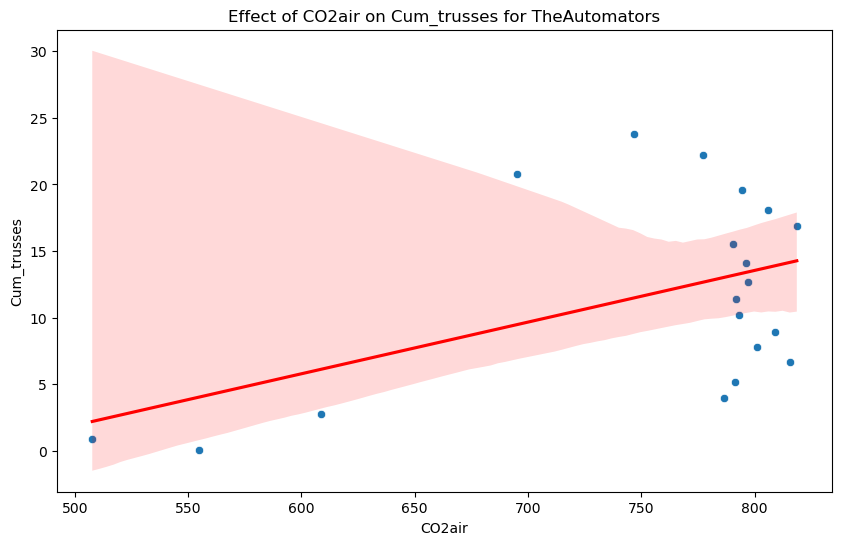

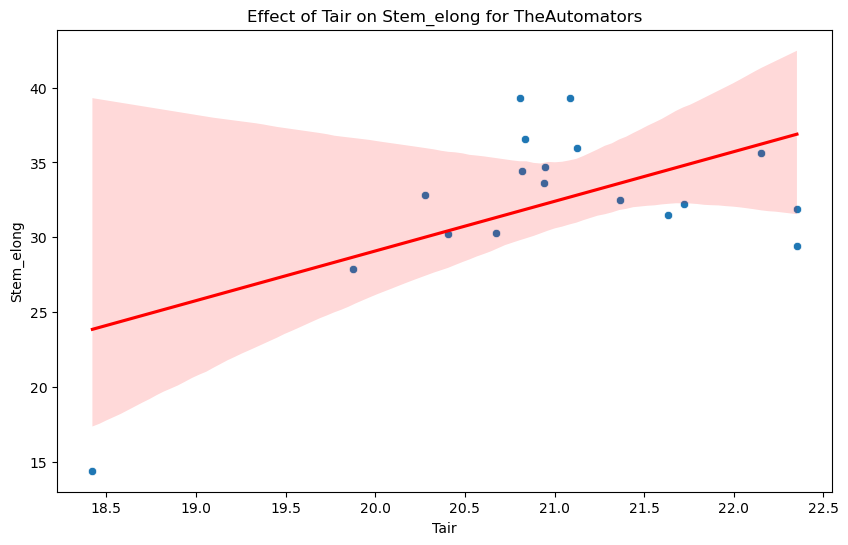

...

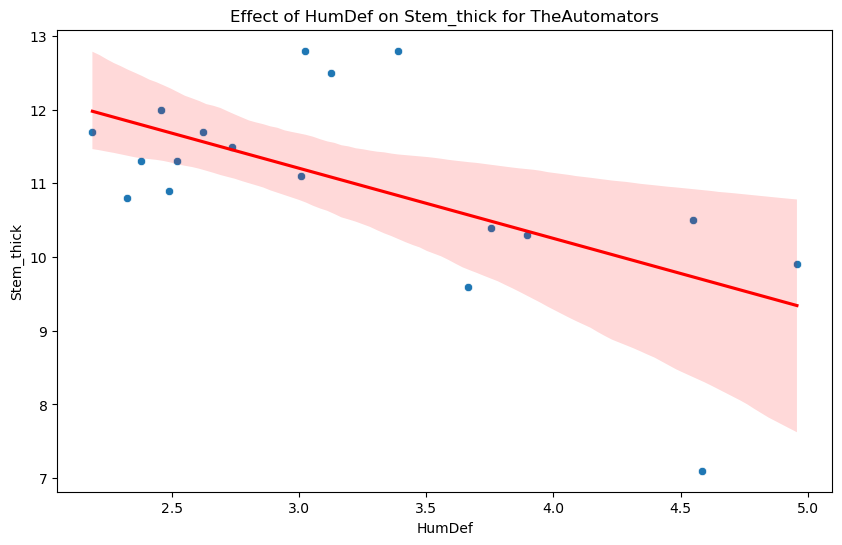

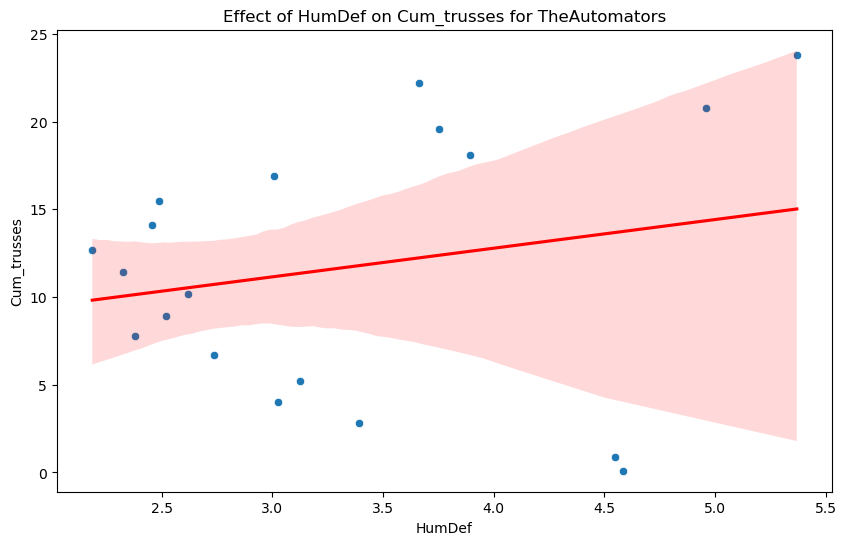

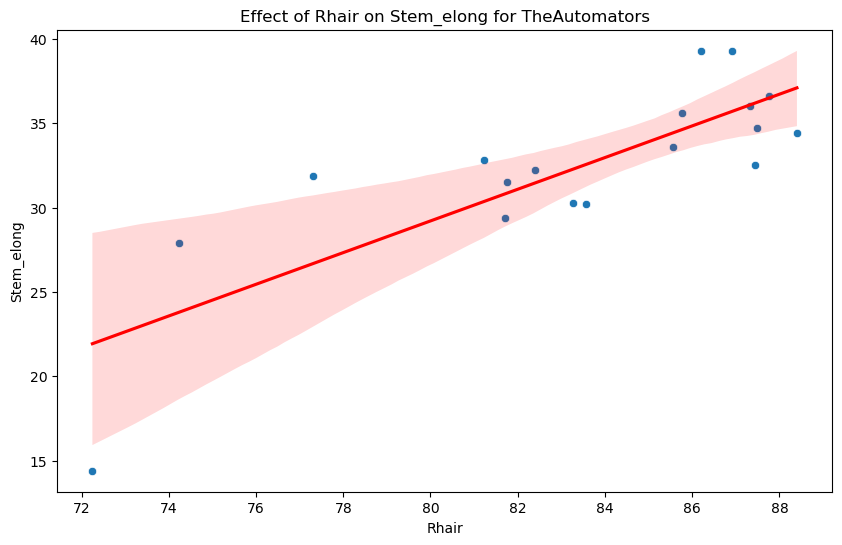

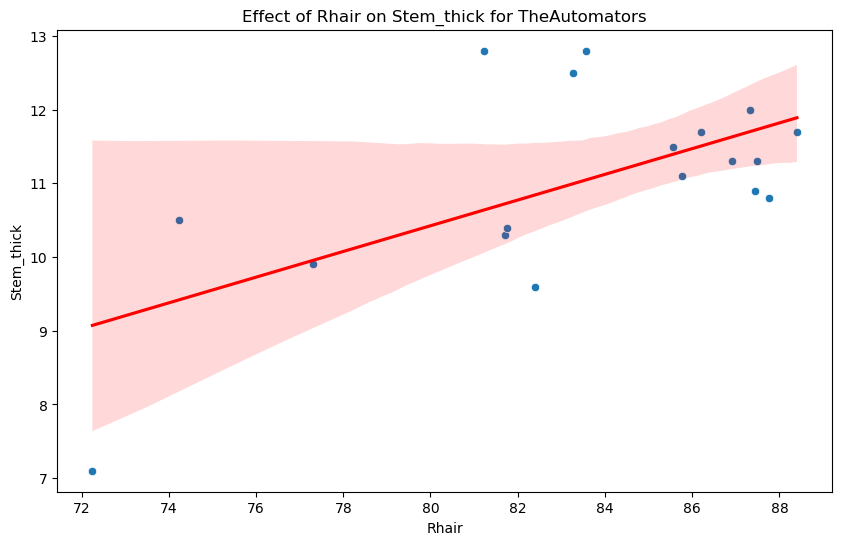

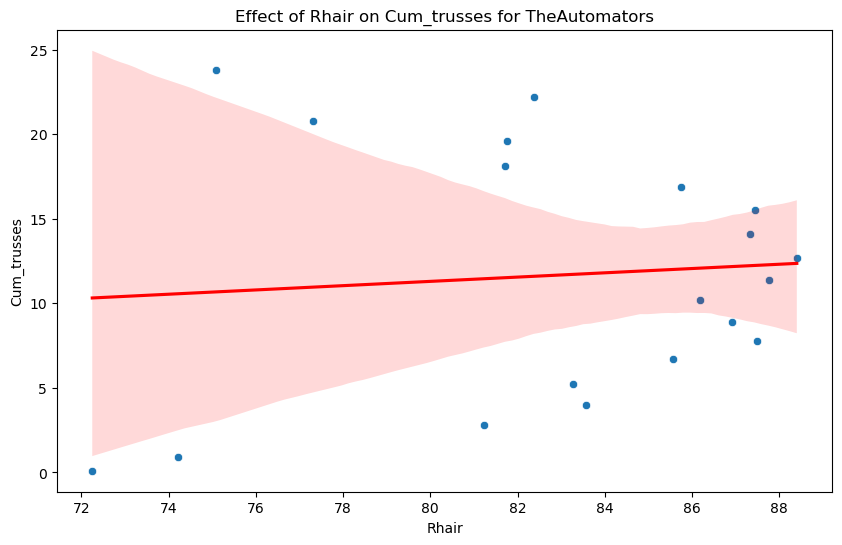

In [138]:
# Required Libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
teams_data=dict()
corr=dict()
team_corr=dict()
filenames = ['AICU', 'Automatoes',
             'Digilog', 'IUACAAS', 
             'Reference', 'TheAutomators'
             ]
for i in range(len(filenames)):

    teams_ghc_weekly = greenhouse_climate[filenames[i]].resample('W').mean()
    
    Weekly_Crop_Parameters[filenames[i]].set_index(teams_ghc_weekly.index[0:-1], inplace=True)

    merged_data = teams_ghc_weekly.merge(Weekly_Crop_Parameters[filenames[i]], left_index=True, right_index=True, how='inner', suffixes=('_ghc', '_wcp'))
    #print(merged_data.head())
    correlation_matrix = merged_data.corr()
    
    outputs=merged_data.columns[-5:-2]
    
    for output in outputs:
        corr[output]=merged_data[merged_data.columns].corr()[output].sort_values(ascending=False)
        corr[output].drop(outputs,axis=0,inplace=True)
        corr[output].plot(kind='bar',title=f'{filenames[i]} {output} Correlation with SP',figsize=(18, 6),fontsize=12)
        plt.show()
        save_fig(f'{filenames[i]} {output} Correlation with SP')
        
    team_corr[filenames[i]]=corr
    # Plotting the correlation matrix
    #plt.figure(figsize=(15, 10))
    #sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
    #plt.title('Correlation Matrix Between SP Features and Crop Parameters')
    #plt.show()
    
    #print('control_features',merged_data.columns[:-3])
    control_features = merged_data.columns[:-5]
    
    #print('output',merged_data.columns[-5:-2])
    
    for control_feature in control_features:
        plt.figure(figsize=(15, 6))
        sns.lineplot(data=merged_data[control_feature], palette='tab11',legend=True)           
        sns.lineplot(data=merged_data[outputs], palette='tab10')

        plt.title(f'Time Series of {control_feature} and CropParameters for {filenames[i]}')
        plt.xlabel('Date')
        plt.legend(loc='right')
        plt.show()
    #for control_feature in control_features:
    #    plt.figure(figsize=(15, 6))
    #    for output in outputs:
    #        sns.lineplot(x=merged_data[control_feature],y=merged_data[output], palette='tab10')
    #        #sns.lineplot(data=teams_ghc_weekly[output], palette='tab10')
    #plt.title(f'{control_feature} with CropParameters {filenames[i]}')
    #plt.xlabel(control_feature)
    #plt.ylabel('CropParameters')
    #plt.legend(loc='best')
    #plt.show()
    
    # Step 8: Effect of Specific Control Setpoints on Crop Parameters
    for control_feature in ['CO2air', 'Tair', 'HumDef', 'Rhair']:
        for output in outputs:
            plt.figure(figsize=(10, 6))
            sns.scatterplot(data=merged_data, x=control_feature, y=output)
            sns.regplot(data=merged_data, x=control_feature, y=output, scatter=False, color='red')
            plt.title(f'Effect of {control_feature} on {output} for {filenames[i]}')
            plt.show()

    teams_data[filenames[i]]=merged_data

In [139]:
for i in range(len(filenames)):
    correlation_values=pd.concat([team_corr[filenames[i]][outputs[0]],
                                  team_corr[filenames[i]][outputs[1]],
                                  team_corr[filenames[i]][outputs[2]]],axis=1)
    correlation_values
    headers = {
        "selector": "th:not(.index_name)",
        "props": "background-color: #800000; color: white; text-align: center"
    }
    properties = {"border": "1px solid black", "width": "65px", "text-align": "center"}
    cell_hover = {
        "selector": "td:hover",
        "props": [("background-color", "#FFFFE0")]
    }
    index_names = {
        "selector": ".index_name",
        "props": "font-style: italic; color: darkgrey; font-weight:normal;"
    }
    correlation_values.style.format(precision=2).set_table_styles([cell_hover, index_names, headers]).set_properties(**properties)
    correlation_values.style.highlight_max(color="red",axis=0)
    correlation_values.style.highlight_min(color="red",axis=0)

    def mean_highlighter(x):
        style_lt = "background-color: whight"
        style_gt = "background-color: red"
        gt_mean = abs(x) > .5
        return [style_gt if i else style_lt for i in gt_mean]


    correlation_values.style.apply(mean_highlighter)

In [140]:
print(daily_Avg[filenames[i]].shape)
greenhouse_climate[filenames[i]].shape

(166, 34)


(47809, 35)

In [141]:
#filenames = ['AICU', 'Automatoes',
#             'Digilog', 'IUACAAS', 
#             'Reference', 'TheAutomators'
#             ]
#for i in range(len(filenames)):
#    print(filenames)
#    print(filenames[i])
#    greenhouse_climate[filenames[i]]['team']=filenames[i]
#    daily_Avg[filenames[i]]['team']=filenames[i]
#    Weekly_Crop_Parameters[filenames[i]]['team']=filenames[i]

In [142]:
#print(greenhouse_climate['AICU']['team'])
#print(daily_Avg['AICU']['team'])
#
#print(Weekly_Crop_Parameters['AICU']['team'])


In [143]:
teams_wcp=pd.concat([Weekly_Crop_Parameters[filenames[0]],Weekly_Crop_Parameters[filenames[1]],
                    Weekly_Crop_Parameters[filenames[2]],Weekly_Crop_Parameters[filenames[3]],
                    Weekly_Crop_Parameters[filenames[4]],Weekly_Crop_Parameters[filenames[5]]], axis=0)

teams_ghc=pd.concat([greenhouse_climate[filenames[0]],greenhouse_climate[filenames[1]],
                     greenhouse_climate[filenames[2]],greenhouse_climate[filenames[3]],
                     greenhouse_climate[filenames[4]],greenhouse_climate[filenames[5]]], axis=0)

teams_da=pd.concat([ daily_Avg[filenames[0]],daily_Avg[filenames[1]],
                     daily_Avg[filenames[2]],daily_Avg[filenames[3]],
                     daily_Avg[filenames[4]],daily_Avg[filenames[5]]], axis=0)


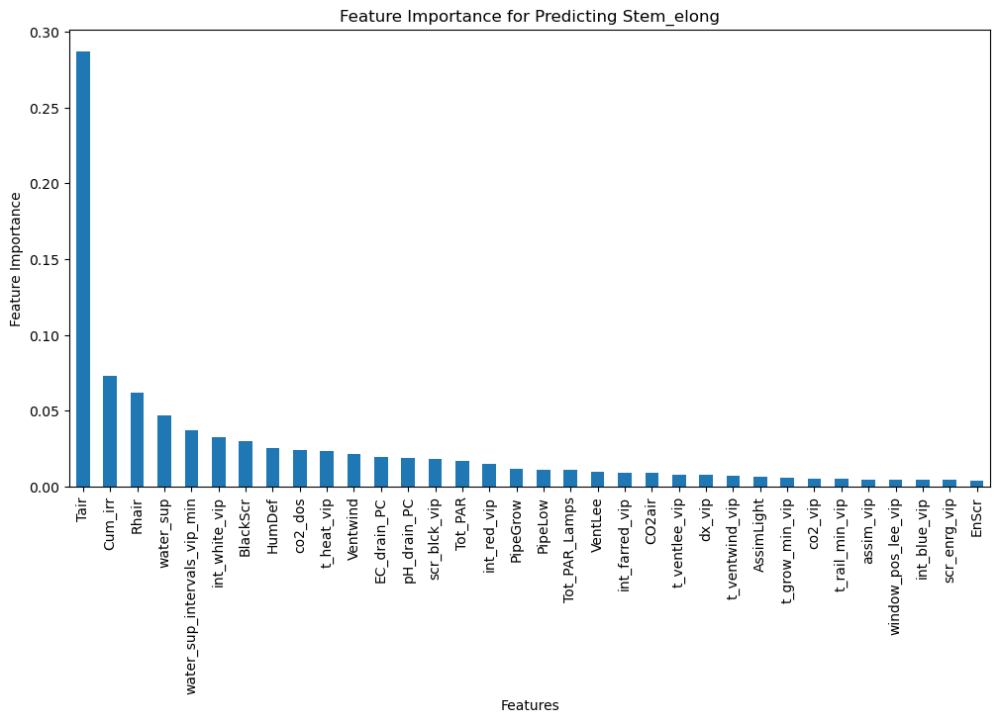

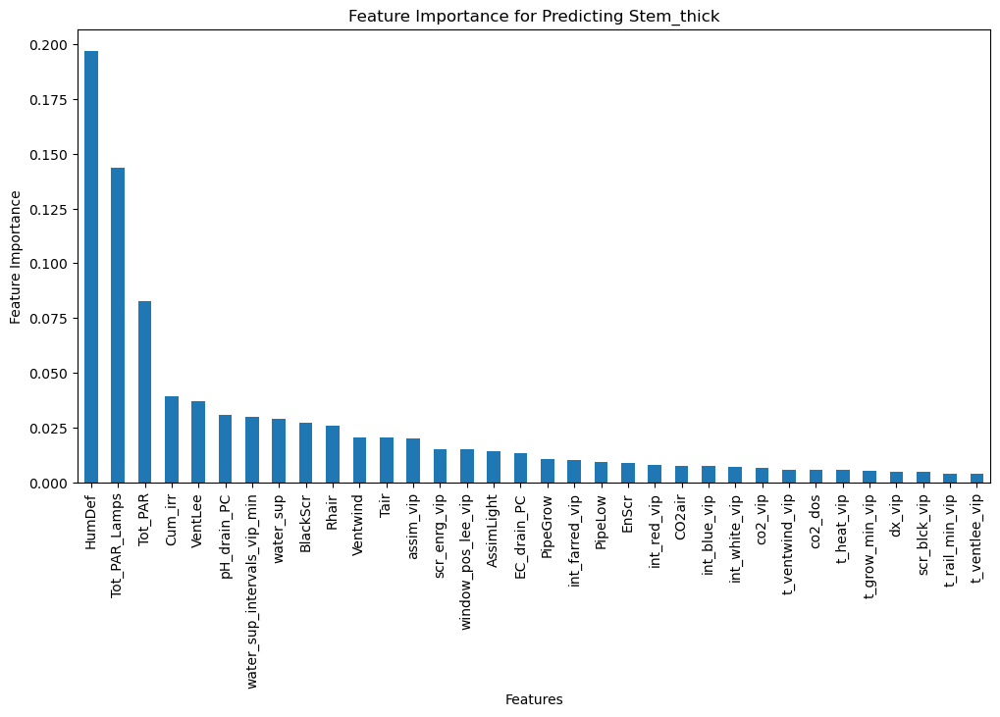

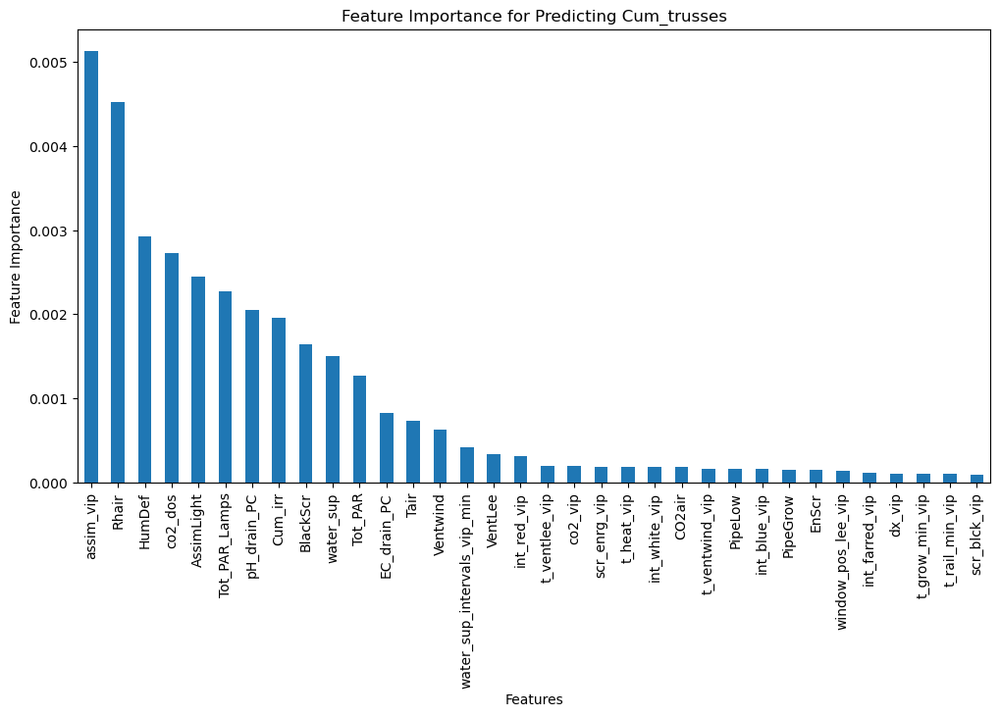

In [ ]:
important_feature=[]
from sklearn.ensemble import RandomForestRegressor
all_teams_data=pd.concat([teams_data[filenames[0]],teams_data[filenames[1]],
                     teams_data[filenames[2]],teams_data[filenames[3]],
                     teams_data[filenames[4]],teams_data[filenames[5]]], axis=0)
# Step 9: Feature Importance Analysis Using RandomForest Regressor
all_teams_data.dropna(axis=0,inplace=True)
X = all_teams_data.drop(['Stem_elong', 'Stem_thick', 'Cum_trusses','stem_dens ', 'plant_dens'], axis=1)
for crop_par in ['Stem_elong', 'Stem_thick', 'Cum_trusses']:
    y = all_teams_data[crop_par]

    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X, y)
    feature_importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
    for fi in feature_importances.index[:5]:
        if fi not in important_feature:
            important_feature.append(fi)
    # Plot Feature Importance
    plt.figure(figsize=(12, 6))
    feature_importances.drop('days').plot(kind='bar')
    plt.xlabel('Features')
    plt.ylabel('Feature Importance')
    plt.title(f'Feature Importance for Predicting {crop_par}')
    plt.show()
    


In [145]:

for x in ['Stem_elong', 'Stem_thick', 'Cum_trusses']:
    important_feature.append(x)
important_feature

['Tair',
 'days',
 'Cum_irr',
 'Rhair',
 'water_sup',
 'HumDef',
 'Tot_PAR_Lamps',
 'days',
 'Tot_PAR',
 'Cum_irr',
 'days',
 'assim_vip',
 'Rhair',
 'HumDef',
 'co2_dos',
 'Stem_elong',
 'Stem_thick',
 'Cum_trusses']

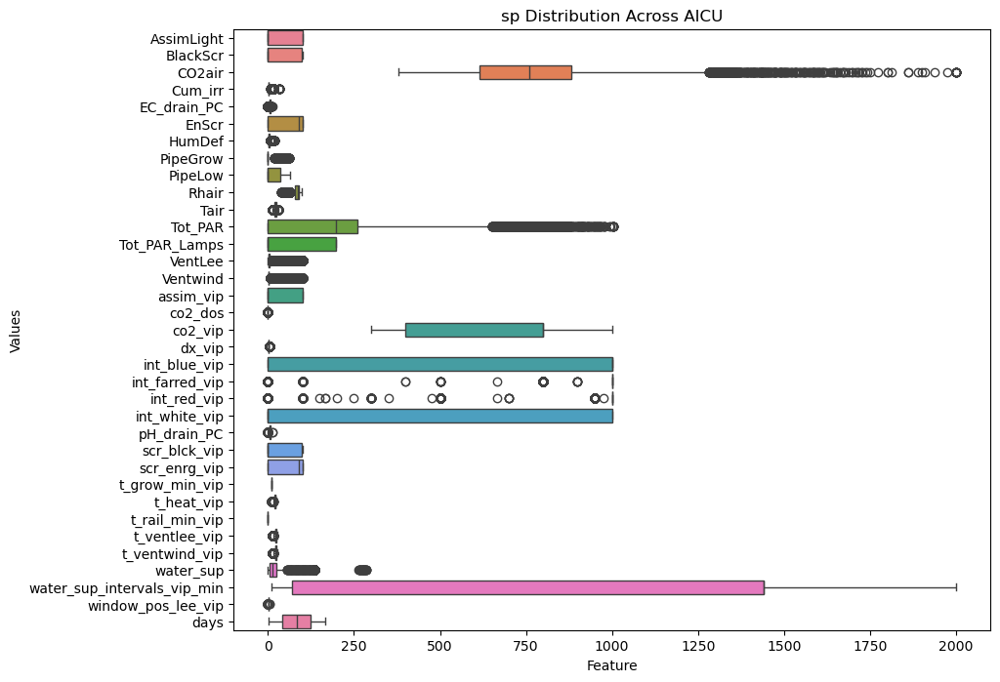

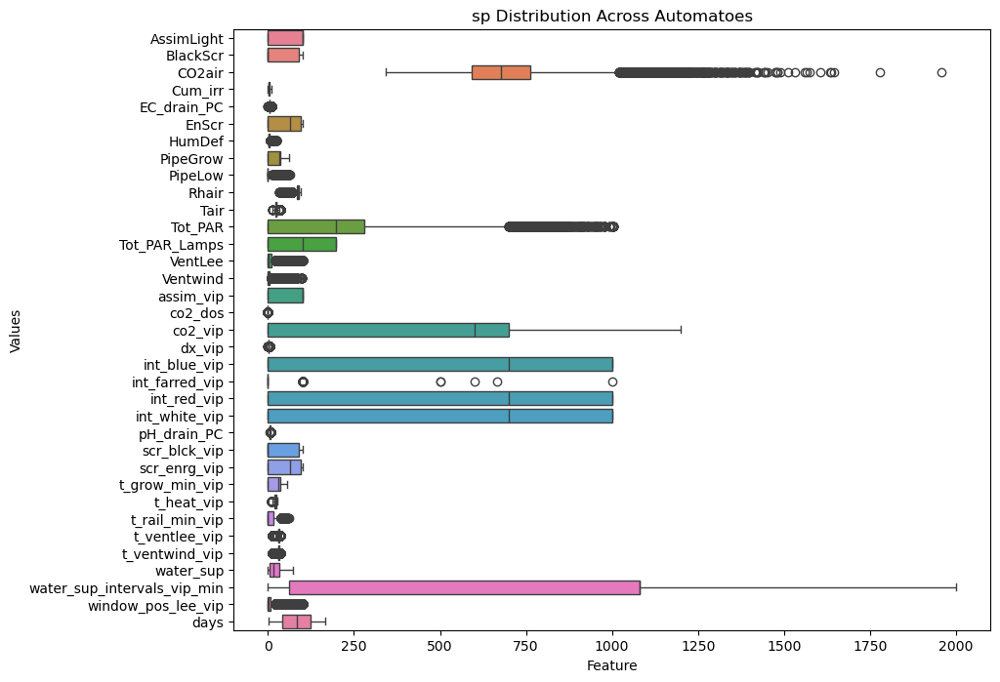

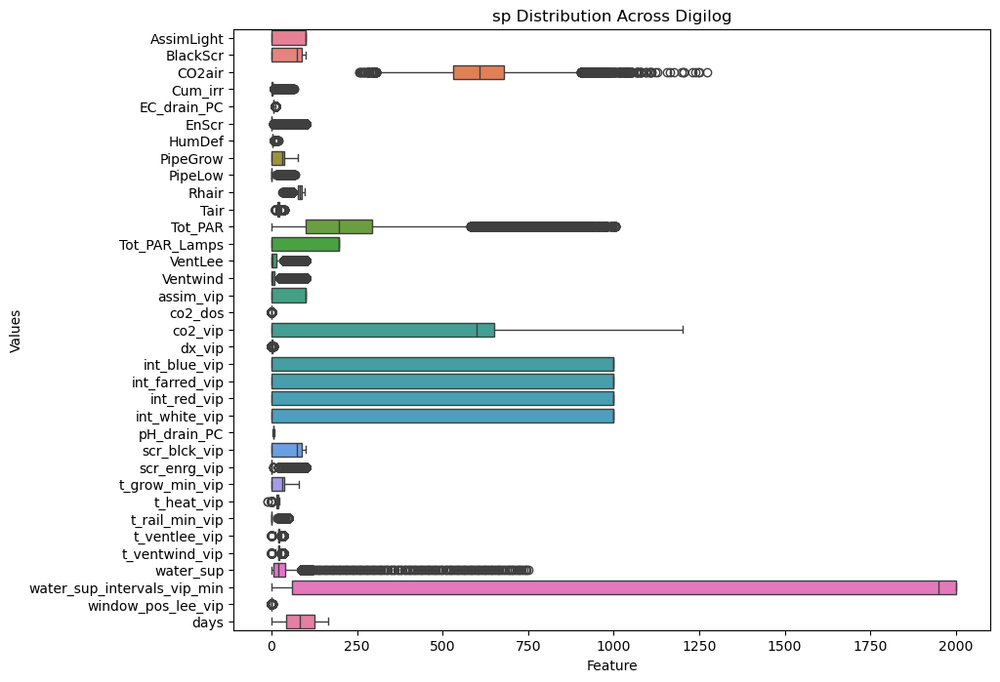

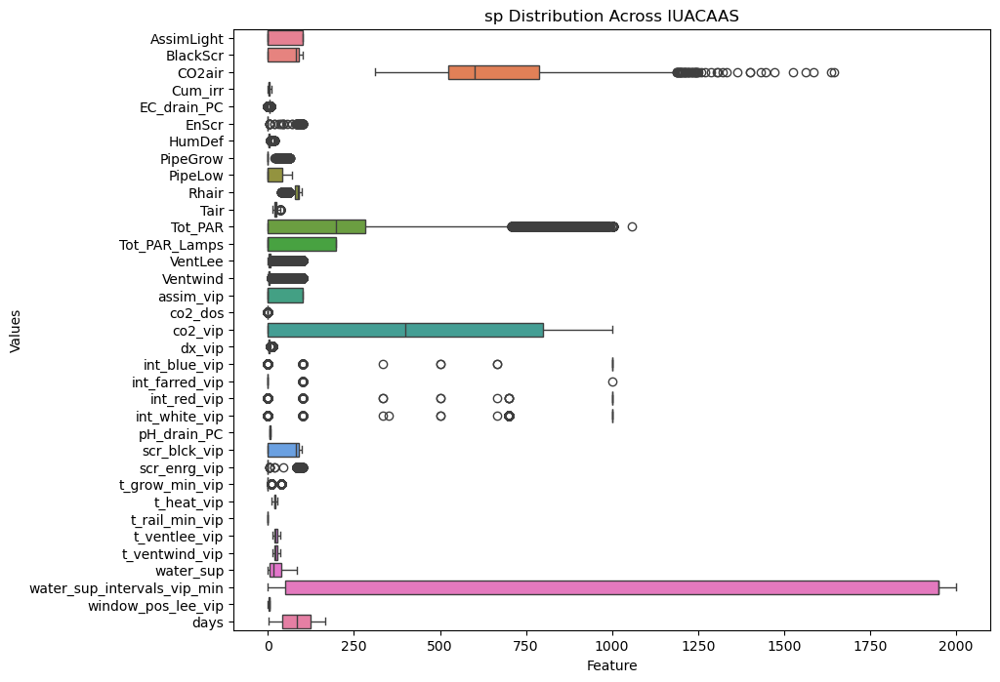

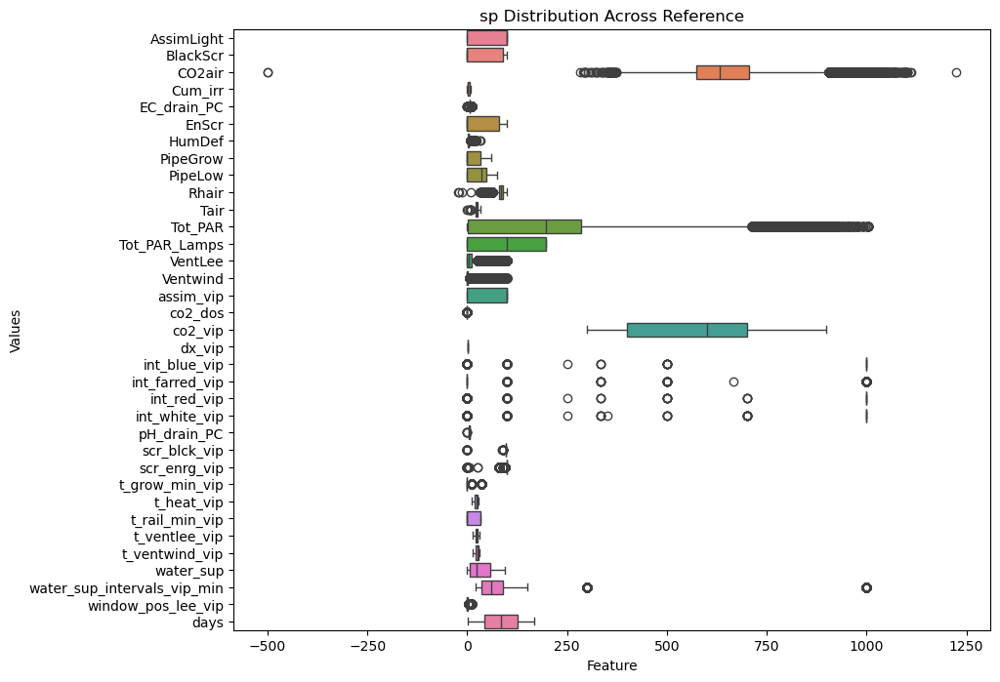

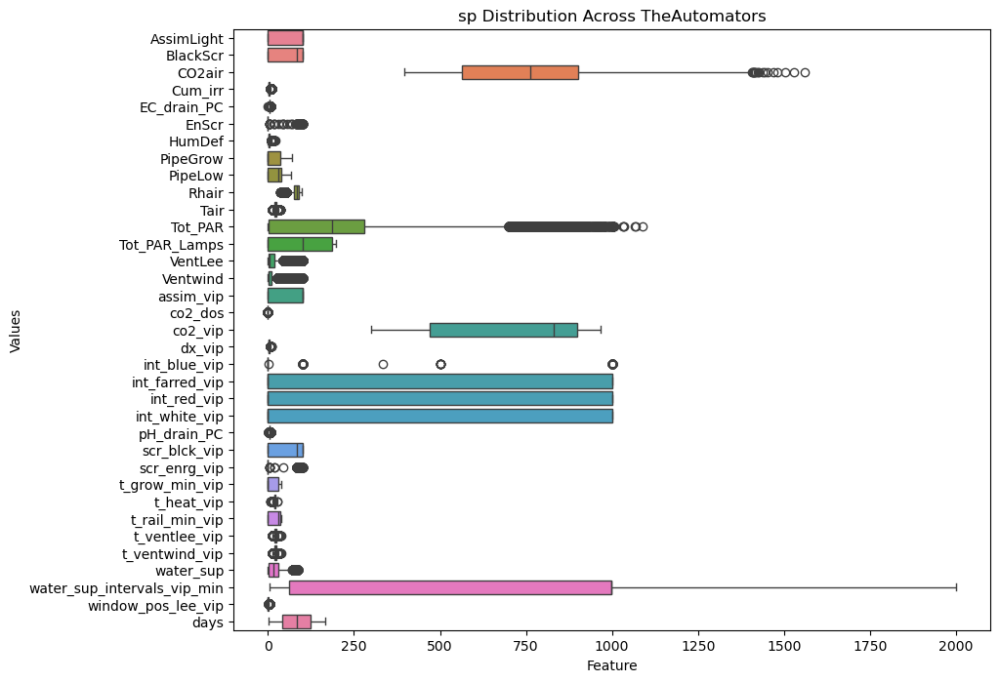

Index(['Stem_elong', 'Stem_thick', 'Cum_trusses'], dtype='object')


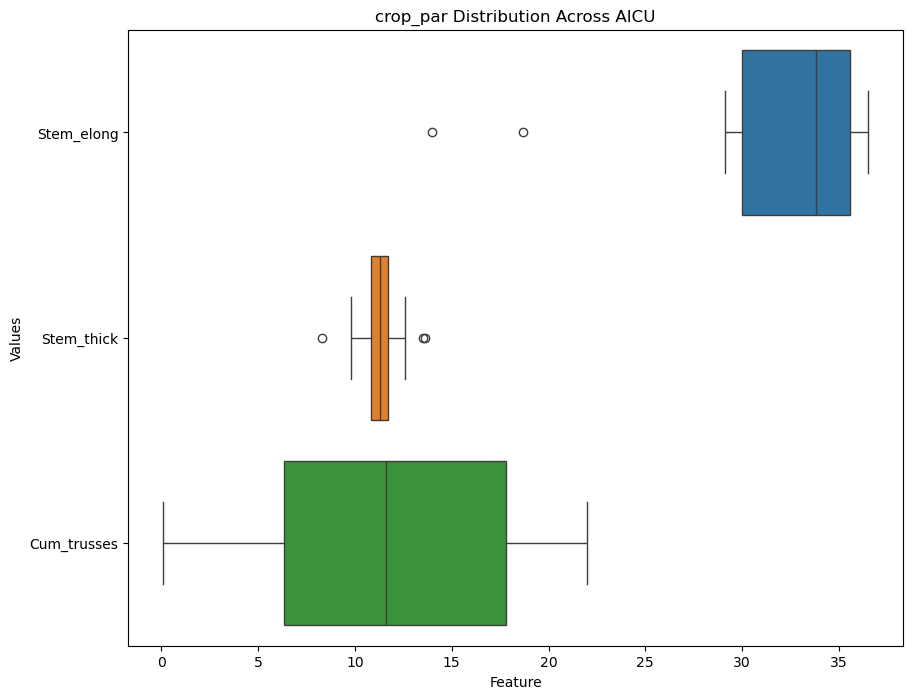

Index(['Stem_elong', 'Stem_thick', 'Cum_trusses'], dtype='object')


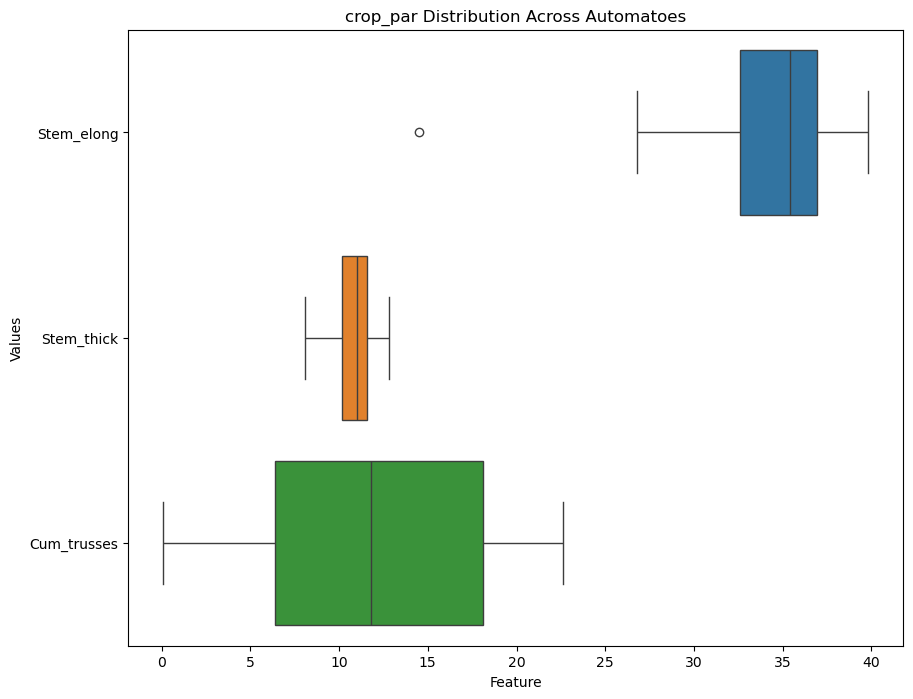

Index(['Stem_elong', 'Stem_thick', 'Cum_trusses'], dtype='object')


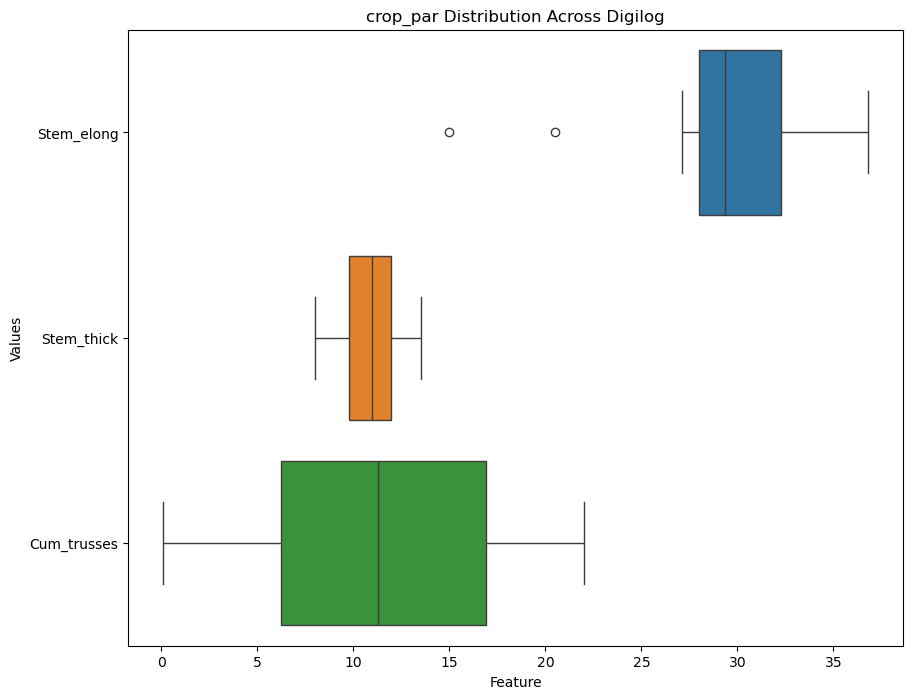

Index(['Stem_elong', 'Stem_thick', 'Cum_trusses'], dtype='object')


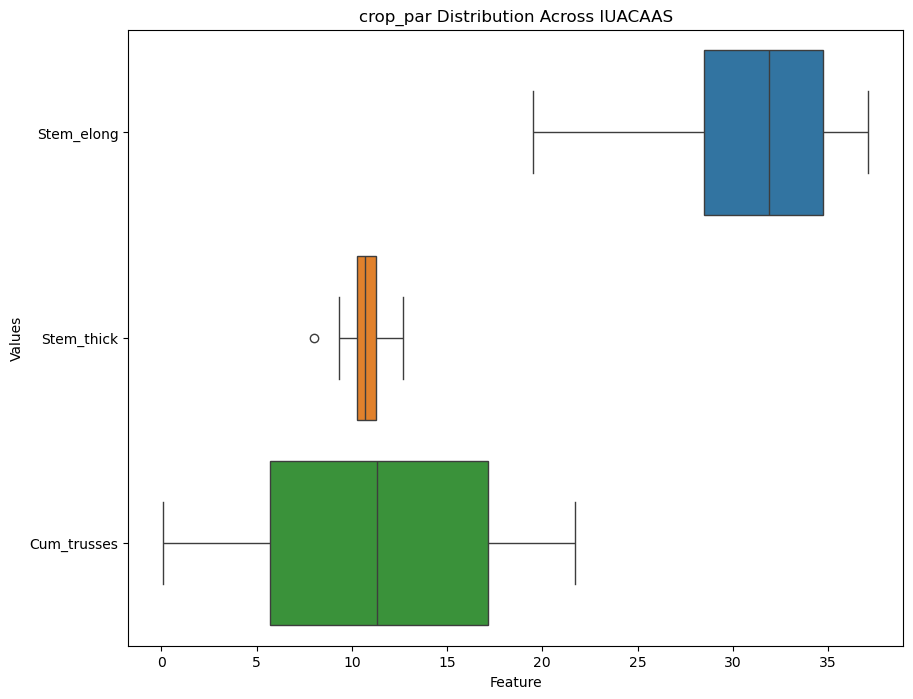

Index(['Stem_elong', 'Stem_thick', 'Cum_trusses'], dtype='object')


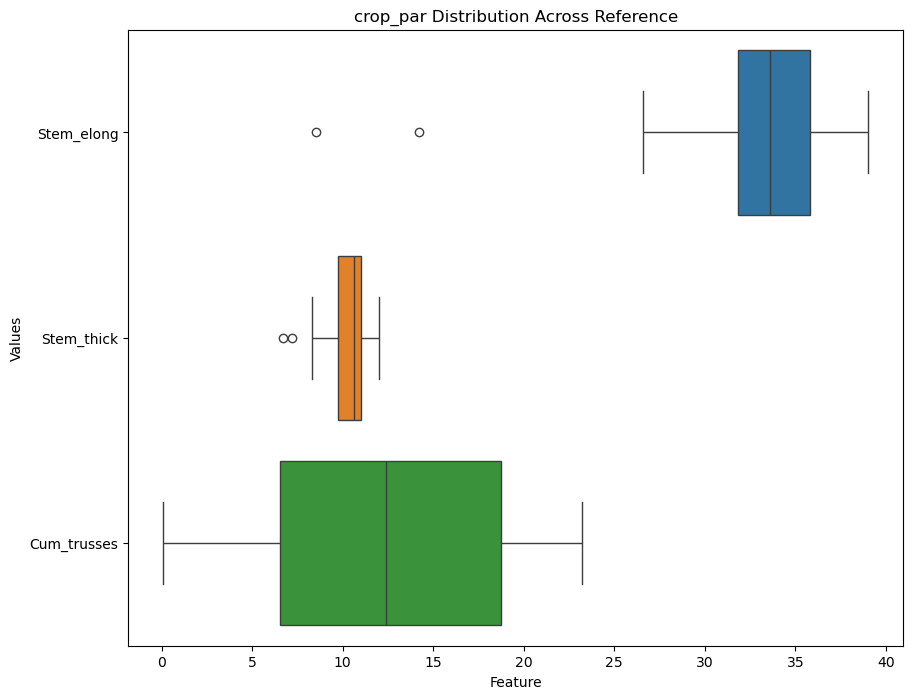

Index(['Stem_elong', 'Stem_thick', 'Cum_trusses'], dtype='object')


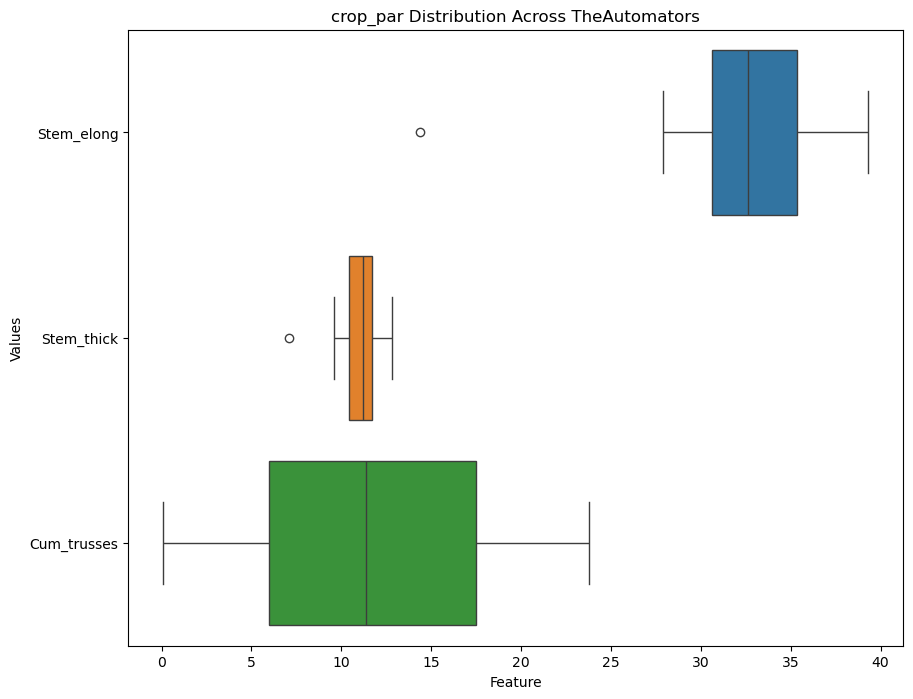

In [146]:

#for i in range(len(filenames)):
    #plt.figure(figsize=(10, 8))
    #sns.boxplot(teams_data[filenames[i]],orient = 'h')
    #plt.title(f'da_sp Distribution Across {filenames[i]} Team')
    #plt.xlabel('Feature')
    #plt.ylabel('Values')
    #plt.show()
    
    # Step 8: Feature Distribution Comparison Between Teams
#for i in range(len(filenames)):
#    plt.figure(figsize=(10, 8))
#    sns.boxplot(daily_Avg[filenames[i]],orient = 'h')
#    plt.title(f'da_sp Distribution Across {filenames[i]}')
#    plt.xlabel('Feature')
#    plt.ylabel('Values')
#    plt.show()

for i in range(len(filenames)):
    plt.figure(figsize=(10, 8))
    sns.boxplot(greenhouse_climate[filenames[i]],orient = 'h')
    plt.title(f'sp Distribution Across {filenames[i]}')
    plt.xlabel('Feature')
    plt.ylabel('Values')
    plt.show()

for i in range(len(filenames)):  
    plt.figure(figsize=(10, 8)) 
    print(Weekly_Crop_Parameters[filenames[i]].columns[:-2]) 
    bb=Weekly_Crop_Parameters[filenames[i]][Weekly_Crop_Parameters[filenames[i]].columns[:-2]]
    sns.boxplot(bb,orient = 'h')
    plt.title(f'crop_par Distribution Across {filenames[i]}')
    plt.xlabel('Feature')
    plt.ylabel('Values')
    plt.show()

In [147]:
import plotly.express as px

features=['AssimLight', 'CO2air', 'Cum_irr',
       'HumDef', 'Rhair', 'Tair', 'Tot_PAR',
       'Tot_PAR_Lamps', 'co2_dos',
       'co2_vip', 'dx_vip', 'int_blue_vip', 'int_farred_vip', 'int_red_vip',
       'int_white_vip', 'pH_drain_PC', 'scr_blck_vip','t_heat_vip',
       'water_sup','water_sup_intervals_vip_min']
# Step 10: Advanced Visualizations
for feature in features:
    for output in outputs:
        # Interactive Scatter Plot with Plotly
        fig = px.scatter(all_teams_data, x=feature, y=output, color=[filenames[i] for x in range(18) for i in range(len(filenames))])       
        fig.update_layout(title=f'Interactive Scatter Plot: {feature} vs. {output}')
        fig.show()

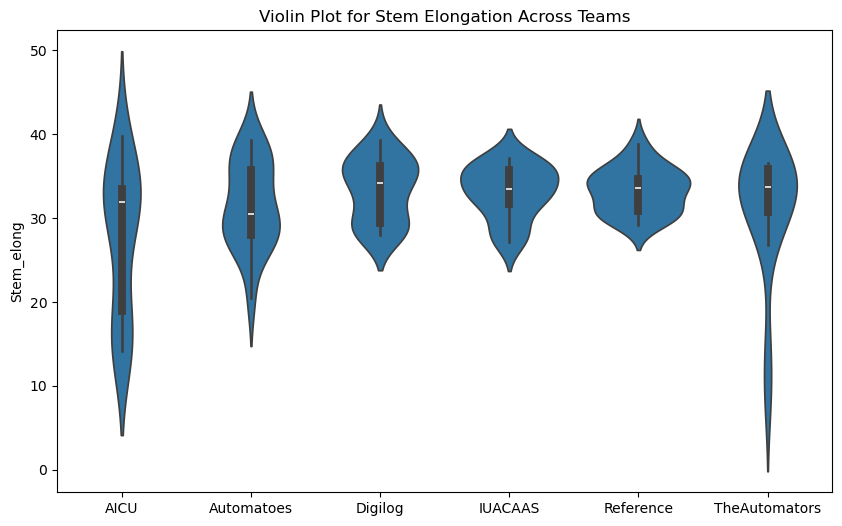

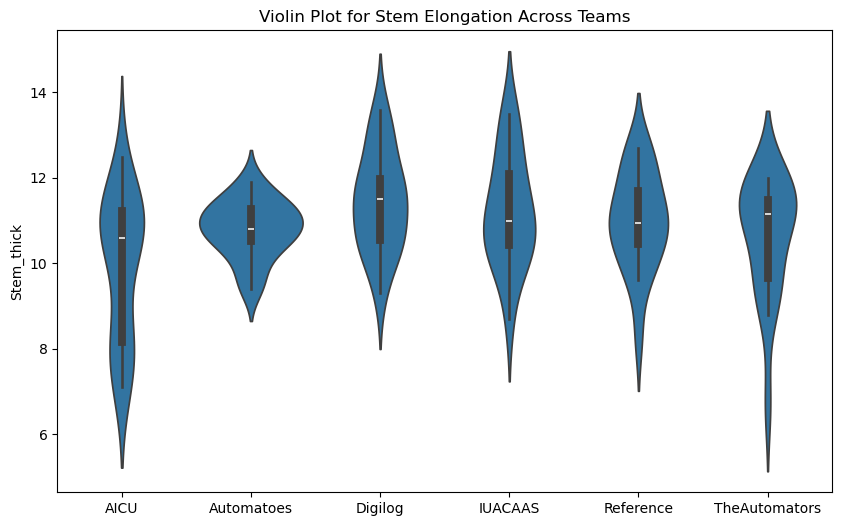

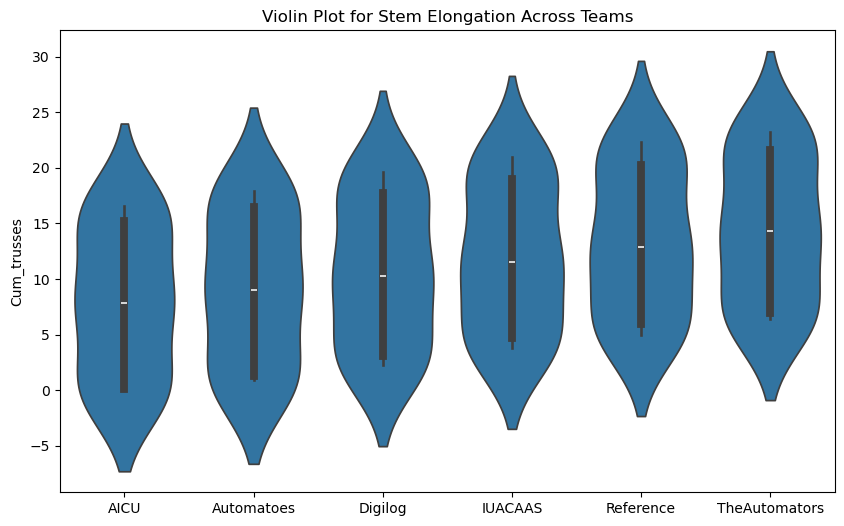

In [148]:
import plotly.express as px

# Violin Plot to Compare Distributions
for output in outputs:
    plt.figure(figsize=(10, 6))
    sns.violinplot(data=all_teams_data, x=[filenames[i] for x in range(18)  for i in range(len(filenames))], y=output)
    plt.title('Violin Plot for Stem Elongation Across Teams')
    plt.show()



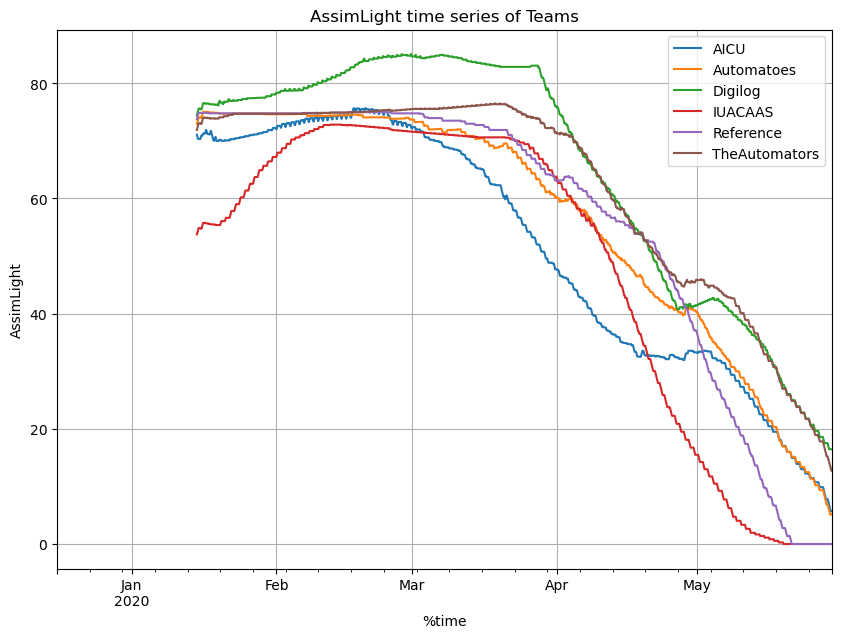

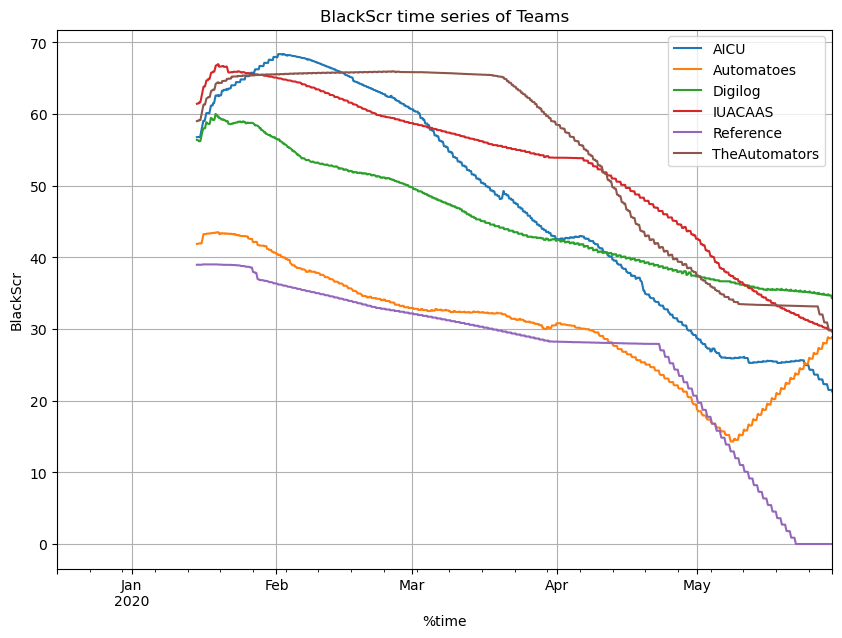

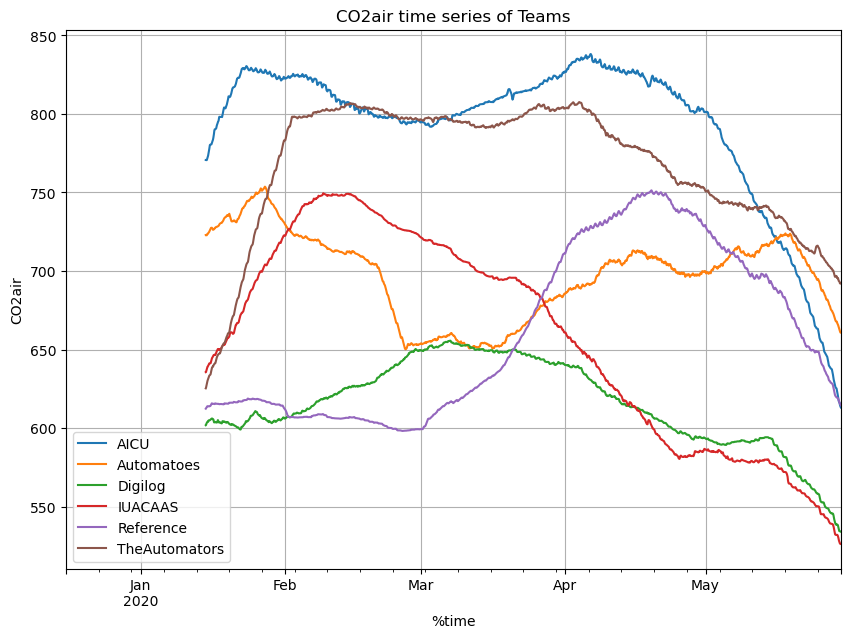

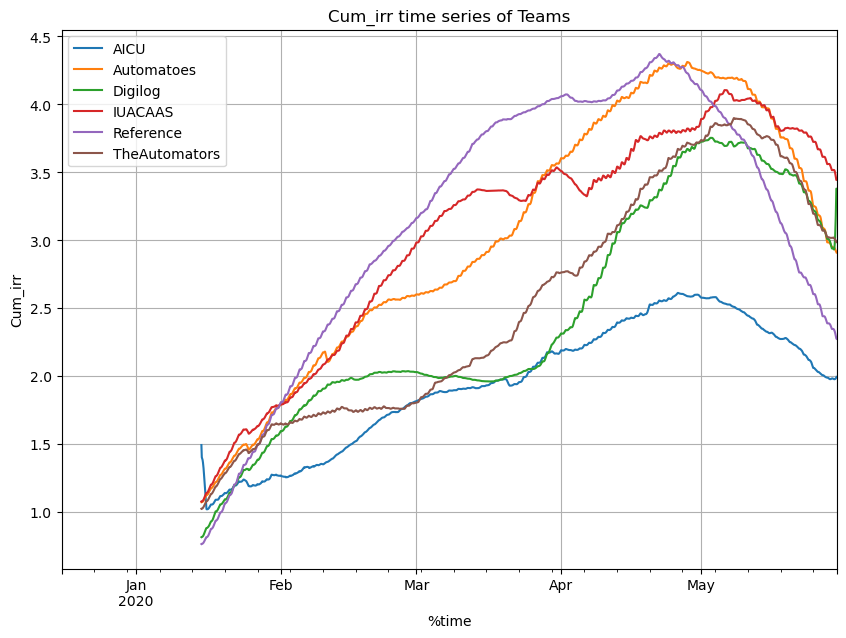

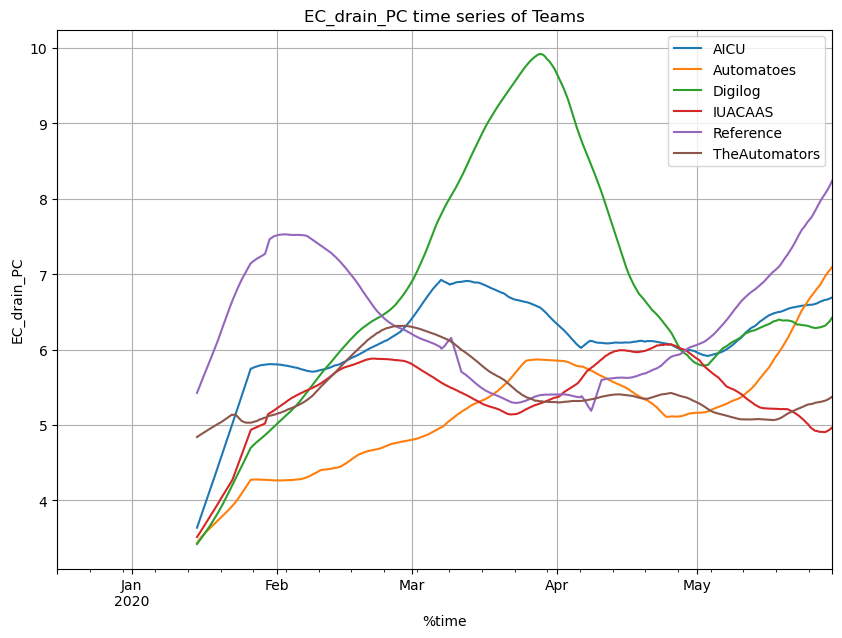

...

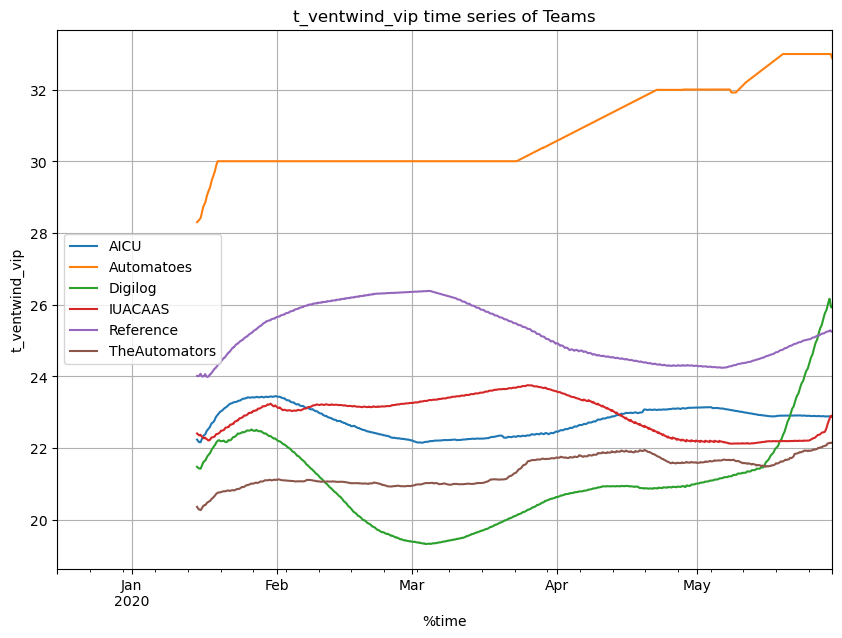

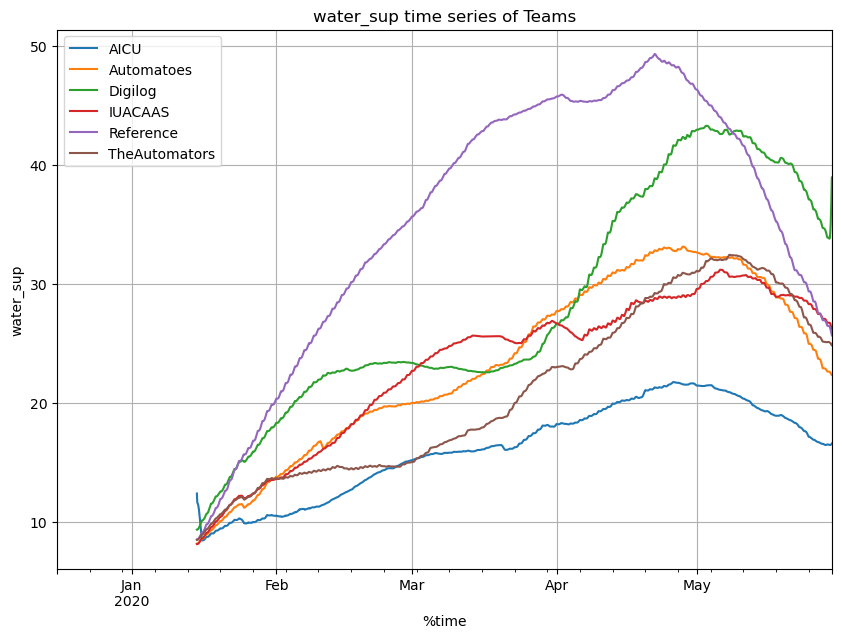

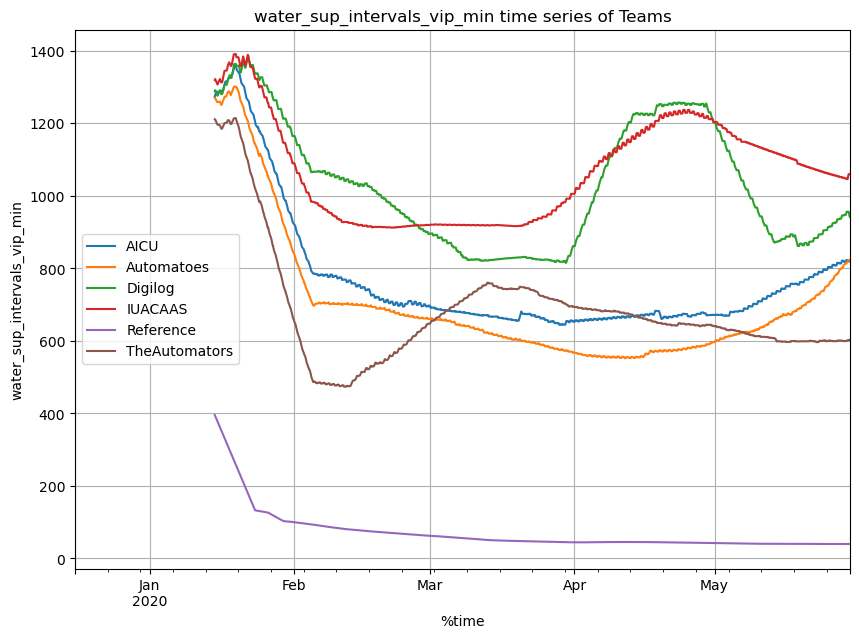

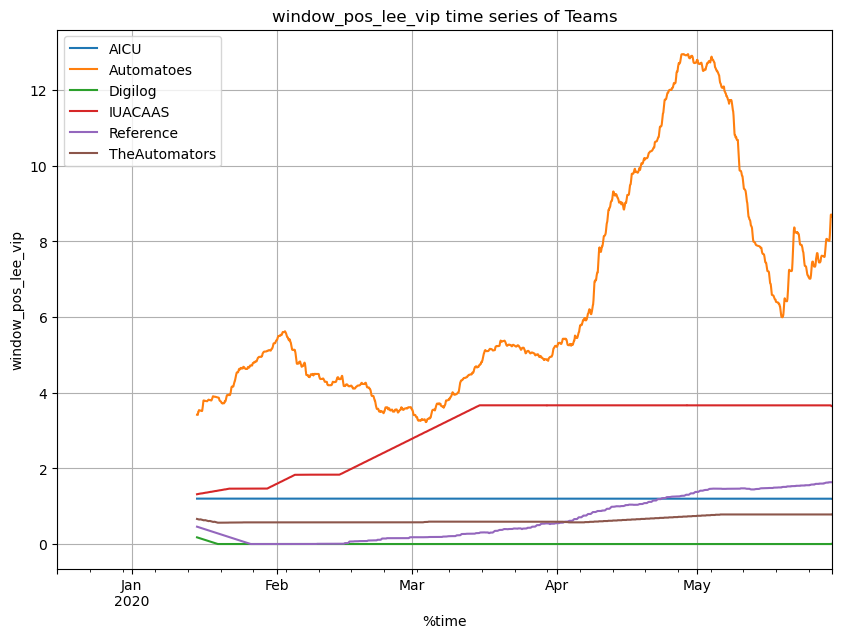

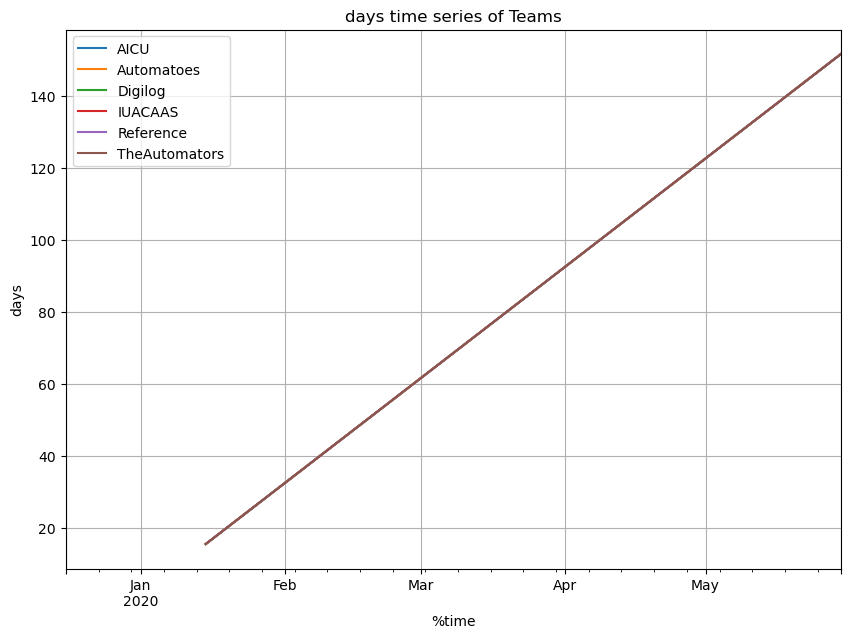

In [149]:


for feature in greenhouse_climate[filename].columns:
    fig = plt.figure(figsize=(10, 7))
    ax = fig.gca()
    for i in range(len(filenames)):

        daily_avg = greenhouse_climate[filenames[i]][feature].resample('h').mean()  # compute the mean for each hour
        #weekly_avg = Weekly_Crop_Parameters[filenames[i]][output].resample('W').mean()
        #print(dayly_avg)
        period=slice("2019-12-16 00:00:00", "2020-05-30 00:00:00")
        rolling_average_daily = daily_avg[period].rolling(window=24*30).mean()
        #rolling_average_weekly = weekly_avg[period].rolling(window=4).mean()

        rolling_average_daily.plot(grid=True,legend=True,label=f'{filenames[i]}')
    ax.set_xlabel(xlabel='%time')
    ax.set_ylabel(ylabel=f'{feature}')
    ax.set_title(f'{feature} time series of Teams')

    plt.show()

#add the legend for each line of plot which represent the file_name

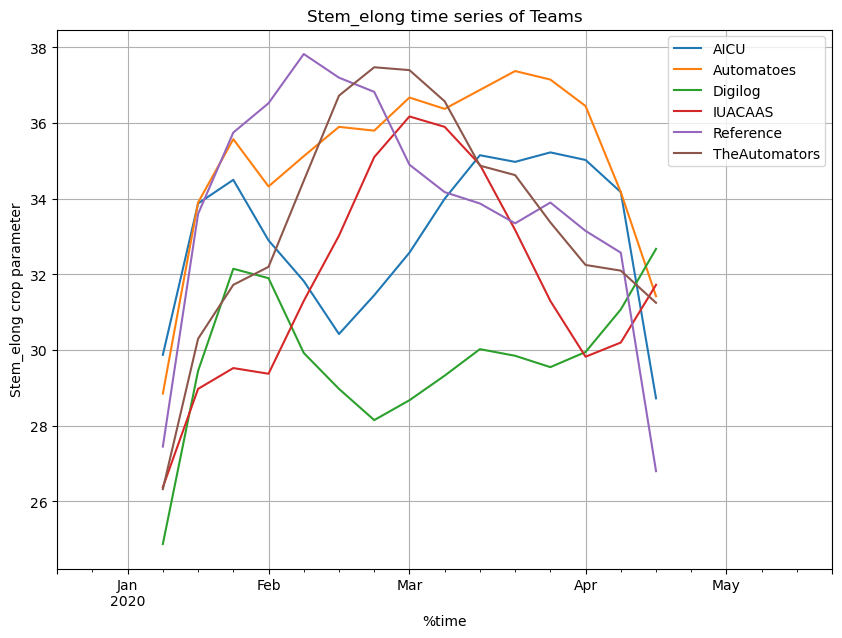

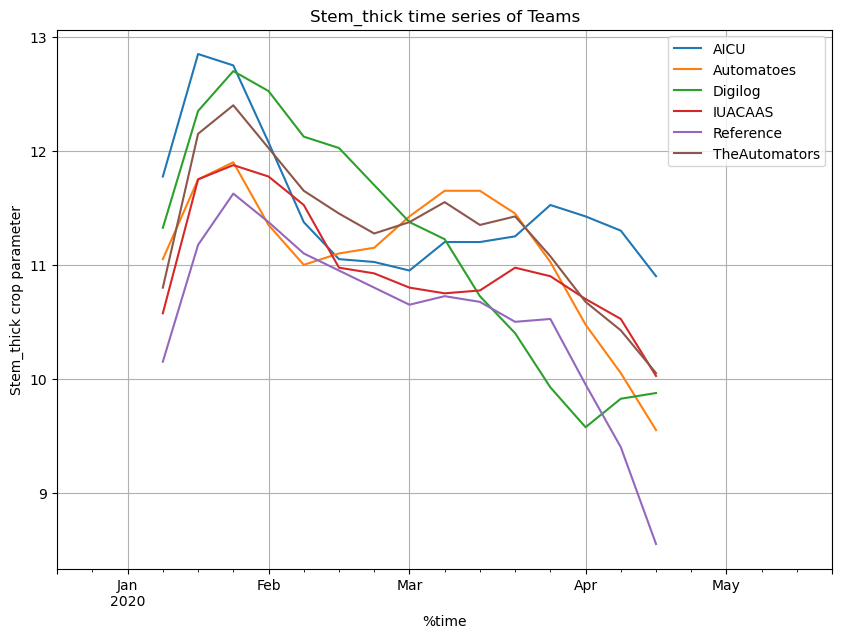

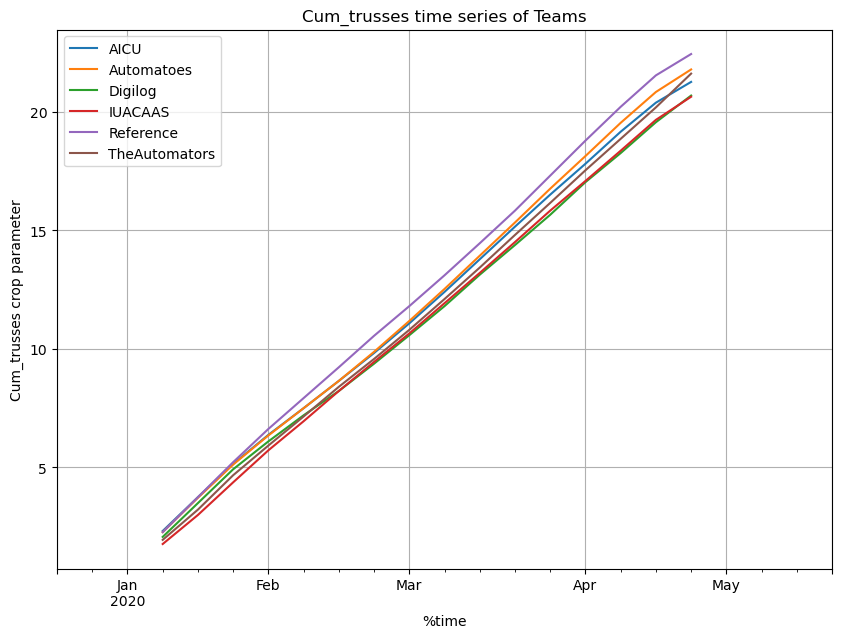

In [150]:

for output in outputs:
    fig = plt.figure(figsize=(10, 7))
    ax = fig.gca()
    for i in range(len(filenames)):
        #daily_avg = greenhouse_climate[filenames[i]][feature].resample('h').mean()  # compute the mean for each hour
        weekly_avg = Weekly_Crop_Parameters[filenames[i]][output].resample('W').mean()
        #print(dayly_avg)
        period=slice("2019-12-16 00:00:00", "2020-05-30 00:00:00")
        #rolling_average_daily = daily_avg[period].rolling(window=24*30).mean()
        rolling_average_weekly = weekly_avg[period].rolling(window=4).mean()
        #dayly_avg=weather.groupby(by=['time'])[weather_attribute].mean()
        #print(weather_attribute,weather.groupby(by=['time'])[weather_attribute].mean())
        #greenhouse_climate[filenames[i]][feature].plot(ax=ax,ylabel=feature,xlabel='Day Index',grid='True', marker=".", figsize=(18, 6))
        #rolling_average_dayly = dayly_avg.rolling(window=10).mean()
        #print(weather_attribute,rolling_average_dayly)
        #rolling_average_daily.plot(grid=True,legend=True,label=f'{filenames[i]}')
        rolling_average_weekly.plot(grid=True,legend=True,label=f'{filenames[i]}')
    ax.set_xlabel(xlabel='%time')
    ax.set_ylabel(ylabel=f'{output} crop parameter')
    ax.set_title(f'{output} time series of Teams')
    plt.show()
#add the legend for each line of plot which represent the file_name

In [151]:
np.save('teams_wcp.npy',teams_wcp)
np.save('teams_ghc.npy',teams_ghc)
np.save('teams_da.npy',teams_da)

In [152]:
#teams_ghc.astype(float).isnull().sum().sum()

In [153]:
teams_da.columns

Index(['AssimLight', 'BlackScr', 'CO2air', 'Cum_irr', 'EC_drain_PC', 'EnScr',
       'HumDef', 'PipeGrow', 'PipeLow', 'Rhair', 'Tair', 'Tot_PAR',
       'Tot_PAR_Lamps', 'VentLee', 'Ventwind', 'assim_vip', 'co2_dos',
       'co2_vip', 'dx_vip', 'int_blue_vip', 'int_farred_vip', 'int_red_vip',
       'int_white_vip', 'pH_drain_PC', 'scr_blck_vip', 'scr_enrg_vip',
       't_grow_min_vip', 't_heat_vip', 't_rail_min_vip', 't_ventlee_vip',
       't_ventwind_vip', 'water_sup', 'water_sup_intervals_vip_min',
       'window_pos_lee_vip'],
      dtype='object')

array([[<AxesSubplot:title={'center':'AssimLight'}>,
        <AxesSubplot:title={'center':'BlackScr'}>,
        <AxesSubplot:title={'center':'CO2air'}>,
        <AxesSubplot:title={'center':'Cum_irr'}>,
        <AxesSubplot:title={'center':'EC_drain_PC'}>,
        <AxesSubplot:title={'center':'EnScr'}>],
       [<AxesSubplot:title={'center':'HumDef'}>,
        <AxesSubplot:title={'center':'PipeGrow'}>,
        <AxesSubplot:title={'center':'PipeLow'}>,
        <AxesSubplot:title={'center':'Rhair'}>,
        <AxesSubplot:title={'center':'Tair'}>,
        <AxesSubplot:title={'center':'Tot_PAR'}>],
       [<AxesSubplot:title={'center':'Tot_PAR_Lamps'}>,
        <AxesSubplot:title={'center':'VentLee'}>,
        <AxesSubplot:title={'center':'Ventwind'}>,
        <AxesSubplot:title={'center':'assim_vip'}>,
        <AxesSubplot:title={'center':'co2_dos'}>,
        <AxesSubplot:title={'center':'co2_vip'}>],
       [<AxesSubplot:title={'center':'dx_vip'}>,
        <AxesSubplot:title={'center':'i

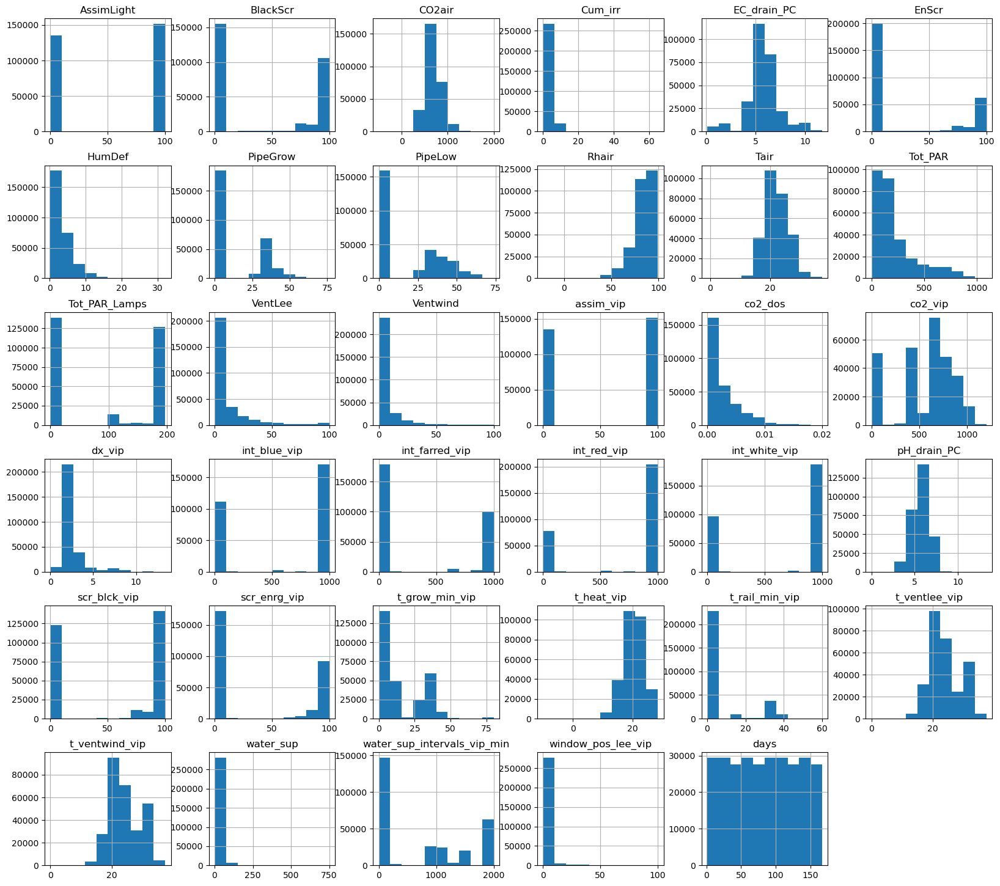

In [154]:
teams_ghc.hist(figsize=(20,18))

In [155]:
print(teams_da.shape)
print(teams_wcp.shape)
print(teams_ghc.shape)

(996, 34)
(138, 5)
(286854, 35)


In [156]:
teams_da.shape

(996, 34)

In [157]:
teams_da.head()

,AssimLight,BlackScr,CO2air,Cum_irr,EC_drain_PC,EnScr,HumDef,PipeGrow,PipeLow,Rhair,...,scr_blck_vip,scr_enrg_vip,t_grow_min_vip,t_heat_vip,t_rail_min_vip,t_ventlee_vip,t_ventwind_vip,water_sup,water_sup_intervals_vip_min,window_pos_lee_vip
%time,,,,,,,,,,,,,,,,,,,,,
2019-12-16,77.777778,36.645833,531.413194,13.866667,0.300000,67.250000,6.905556,0.435069,29.444097,61.634722,...,71.333333,71.333333,10.0,18.989583,0.0,22.013542,22.819097,115.555556,450.000000,1.2
2019-12-17,45.138889,0.000000,552.031250,1.406250,0.300000,39.930556,3.218750,0.000000,12.373958,78.956597,...,5.604167,10.364583,10.0,15.832639,0.0,16.831944,17.075000,11.718750,401.111111,1.2
2019-12-18,75.694444,36.434028,615.986111,0.000000,0.300000,40.052083,4.207639,0.000000,13.835069,72.300000,...,37.180556,39.565972,10.0,16.494444,0.0,17.506944,17.525347,0.000000,207.152778,1.2
2019-12-19,75.694444,36.434028,572.822917,0.000000,0.300000,37.621528,3.653125,0.000000,2.981944,75.178819,...,36.947917,66.996528,10.0,15.966319,0.0,16.980208,16.980208,0.000000,421.527778,1.2
2019-12-20,88.541667,66.517361,640.520833,0.320139,0.300347,11.319444,4.412500,0.000000,6.854514,72.793750,...,65.607639,7.100694,10.0,17.585764,0.0,18.790278,18.790278,2.659722,995.069444,1.2


In [158]:
teams_da.index

DatetimeIndex(['2019-12-16', '2019-12-17', '2019-12-18', '2019-12-19',
               '2019-12-20', '2019-12-21', '2019-12-22', '2019-12-23',
               '2019-12-24', '2019-12-25',
               ...
               '2020-05-20', '2020-05-21', '2020-05-22', '2020-05-23',
               '2020-05-24', '2020-05-25', '2020-05-26', '2020-05-27',
               '2020-05-28', '2020-05-29'],
              dtype='datetime64[ns]', name='%time', length=996, freq=None)

In [159]:
teams_wcp.index

DatetimeIndex(['2019-12-22', '2019-12-29', '2020-01-05', '2020-01-12',
               '2020-01-19', '2020-01-26', '2020-02-02', '2020-02-09',
               '2020-02-16', '2020-02-23',
               ...
               '2020-03-22', '2020-03-29', '2020-04-05', '2020-04-12',
               '2020-04-19', '2020-04-26', '2020-05-03', '2020-05-10',
               '2020-05-17', '2020-05-24'],
              dtype='datetime64[ns]', name='%time', length=138, freq=None)

In [160]:
teams_wcp.head(138)
teams_wcp.columns

Index(['Stem_elong', 'Stem_thick', 'Cum_trusses', 'stem_dens ', 'plant_dens'], dtype='object')

In [161]:
teams_wcp.head()

,Stem_elong,Stem_thick,Cum_trusses,stem_dens,plant_dens
%time,,,,,
2019-12-22,18.7,8.3,0.1,3.6,1.8
2019-12-29,29.9,11.7,1.3,3.6,1.8
2020-01-05,35.8,13.6,3.2,3.6,1.8
2020-01-12,35.1,13.5,4.7,3.6,1.8
2020-01-19,34.7,12.6,5.8,3.6,1.8


In [162]:
teams_wcp.drop(["stem_dens ", "plant_dens"],inplace=True,axis=1)
teams_wcp.columns

Index(['Stem_elong', 'Stem_thick', 'Cum_trusses'], dtype='object')

In [163]:
teams_wcp.head()


,Stem_elong,Stem_thick,Cum_trusses
%time,,,
2019-12-22,18.7,8.3,0.1
2019-12-29,29.9,11.7,1.3
2020-01-05,35.8,13.6,3.2
2020-01-12,35.1,13.5,4.7
2020-01-19,34.7,12.6,5.8


In [164]:
teams_ghc.shape

(286854, 35)

In [165]:
teams_ghc.isnull().sum()

AssimLight                     0
BlackScr                       0
CO2air                         0
Cum_irr                        0
EC_drain_PC                    0
EnScr                          0
HumDef                         0
PipeGrow                       0
PipeLow                        0
Rhair                          0
Tair                           0
Tot_PAR                        0
Tot_PAR_Lamps                  0
VentLee                        0
Ventwind                       0
assim_vip                      0
co2_dos                        0
co2_vip                        0
dx_vip                         0
int_blue_vip                   0
int_farred_vip                 0
int_red_vip                    0
int_white_vip                  0
pH_drain_PC                    0
scr_blck_vip                   0
scr_enrg_vip                   0
t_grow_min_vip                 0
t_heat_vip                     0
t_rail_min_vip                 0
t_ventlee_vip                  0
t_ventwind

In [166]:
features = ['assim_sp', 'assim_vip', 'co2_dos', 'co2_sp',
       'co2_vip', 'dx_sp', 'dx_vip', 'int_blue_sp', 'int_blue_vip',
       'int_farred_sp', 'int_farred_vip', 'int_red_sp', 'int_red_vip',
       'int_white_sp', 'int_white_vip', 'scr_blck_sp',
       'scr_blck_vip', 'scr_enrg_sp', 'scr_enrg_vip', 't_grow_min_sp',
       't_grow_min_vip', 't_heat_sp', 't_heat_vip', 't_rail_min_sp',
       't_rail_min_vip', 't_vent_sp', 't_ventlee_vip', 't_ventwind_vip',
       'water_sup_intervals_sp_min', 'window_pos_lee_sp', 'window_pos_lee_vip',
       'water_sup_intervals_vip_min']

In [167]:
teams_ghc.columns

Index(['AssimLight', 'BlackScr', 'CO2air', 'Cum_irr', 'EC_drain_PC', 'EnScr',
       'HumDef', 'PipeGrow', 'PipeLow', 'Rhair', 'Tair', 'Tot_PAR',
       'Tot_PAR_Lamps', 'VentLee', 'Ventwind', 'assim_vip', 'co2_dos',
       'co2_vip', 'dx_vip', 'int_blue_vip', 'int_farred_vip', 'int_red_vip',
       'int_white_vip', 'pH_drain_PC', 'scr_blck_vip', 'scr_enrg_vip',
       't_grow_min_vip', 't_heat_vip', 't_rail_min_vip', 't_ventlee_vip',
       't_ventwind_vip', 'water_sup', 'water_sup_intervals_vip_min',
       'window_pos_lee_vip', 'days'],
      dtype='object')

In [168]:
teams_ghc.index

DatetimeIndex(['2019-12-16 00:00:00', '2019-12-16 00:05:00',
               '2019-12-16 00:10:00', '2019-12-16 00:15:00',
               '2019-12-16 00:20:00', '2019-12-16 00:25:00',
               '2019-12-16 00:30:00', '2019-12-16 00:35:00',
               '2019-12-16 00:40:00', '2019-12-16 00:45:00',
               ...
               '2020-05-29 23:15:00', '2020-05-29 23:20:00',
               '2020-05-29 23:25:00', '2020-05-29 23:30:00',
               '2020-05-29 23:35:00', '2020-05-29 23:40:00',
               '2020-05-29 23:45:00', '2020-05-29 23:50:00',
               '2020-05-29 23:55:00', '2020-05-30 00:00:00'],
              dtype='datetime64[ns]', name='%time', length=286854, freq=None)

In [169]:
teams_ghc.columns

Index(['AssimLight', 'BlackScr', 'CO2air', 'Cum_irr', 'EC_drain_PC', 'EnScr',
       'HumDef', 'PipeGrow', 'PipeLow', 'Rhair', 'Tair', 'Tot_PAR',
       'Tot_PAR_Lamps', 'VentLee', 'Ventwind', 'assim_vip', 'co2_dos',
       'co2_vip', 'dx_vip', 'int_blue_vip', 'int_farred_vip', 'int_red_vip',
       'int_white_vip', 'pH_drain_PC', 'scr_blck_vip', 'scr_enrg_vip',
       't_grow_min_vip', 't_heat_vip', 't_rail_min_vip', 't_ventlee_vip',
       't_ventwind_vip', 'water_sup', 'water_sup_intervals_vip_min',
       'window_pos_lee_vip', 'days'],
      dtype='object')

In [170]:
#teams_ghc.drop('%time',inplace=True,axis=1)

In [171]:
type(teams_ghc)

pandas.core.frame.DataFrame

In [172]:
teams_wcp.shape

(138, 3)

In [173]:
teams_wcp.to_csv('teams_wcp.csv')
teams_ghc.to_csv('teams_ghc.csv')
teams_da.to_csv('teams_da.csv' )

In [174]:
np.save('teams_wcp.npy',teams_wcp)
np.save('teams_ghc.npy',teams_ghc)
np.save('teams_da.npy',teams_da)

In [175]:
from sklearn.preprocessing import StandardScaler,MinMaxScaler
teams_wcp_scaler =      MinMaxScaler()
teams_ghc_scaler =      MinMaxScaler()
teams_da_scaler  =      MinMaxScaler()



In [176]:
teams_wcp_scaled = pd.DataFrame(teams_wcp_scaler.fit_transform(teams_wcp),columns=teams_wcp.columns)
teams_ghc_scaled = pd.DataFrame(teams_ghc_scaler.fit_transform(teams_ghc),columns=teams_ghc.columns)
teams_da_scaled = pd.DataFrame(teams_da_scaler.fit_transform(teams_da),columns=teams_da.columns)
teams_da_scaled.isnull().sum(axis=1)
teams_wcp_scaled.isnull().sum(axis=0)

print(teams_wcp_scaled.min(axis=0),teams_wcp_scaled.max(axis=0))
print(teams_ghc_scaled.min(axis=0),teams_ghc_scaled.max(axis=0))
print(teams_da_scaled.min(axis=0),teams_da_scaled.max(axis=0))

Stem_elong     0.0
Stem_thick     0.0
Cum_trusses    0.0
dtype: float64 Stem_elong     1.0
Stem_thick     1.0
Cum_trusses    1.0
dtype: float64
AssimLight                     0.0
BlackScr                       0.0
CO2air                         0.0
Cum_irr                        0.0
EC_drain_PC                    0.0
EnScr                          0.0
HumDef                         0.0
PipeGrow                       0.0
PipeLow                        0.0
Rhair                          0.0
Tair                           0.0
Tot_PAR                        0.0
Tot_PAR_Lamps                  0.0
VentLee                        0.0
Ventwind                       0.0
assim_vip                      0.0
co2_dos                        0.0
co2_vip                        0.0
dx_vip                         0.0
int_blue_vip                   0.0
int_farred_vip                 0.0
int_red_vip                    0.0
int_white_vip                  0.0
pH_drain_PC                    0.0
scr_blck_vip    

In [177]:
data=[]
wcp_data=[]
da_data=[]

test_data=[]
test_wcp_data=[]
test_da_data=[]
for i, wcp in enumerate(teams_wcp_scaled.index):
    #print(str(teams_wcp_scaled.iloc[i,:].values[0]),str(teams_wcp_scaled.iloc[i,:].values[0])!= 'nan')
    if str(teams_wcp_scaled.iloc[i,:].values[0]) != 'nan':
        
        #print(i*7,":",i*7+7)

        wcp_sample=np.array(teams_da_scaled[i*7:i*7+7]).T
        da_sample=np.array(teams_wcp_scaled.iloc[i,:])


        #print(wcp_sample.shape, "...")
        #print(da_sample.shape)

        da_data.append(wcp_sample)
        wcp_data.append(da_sample)
        data.append((wcp_sample,da_sample))
        #print("Label:", teams_wcp_scaled.iloc[i,:])
    else:
        #print("test",i*7,":",i*7+7)

        wcp_test_sample=np.array(teams_da_scaled[i*7:i*7+7])
        da_test_sample=np.array(teams_wcp_scaled.iloc[i,:])


        #print(wcp_test_sample.shape, "...")
        #print(da_test_sample.shape)

        test_da_data.append(wcp_test_sample)
        test_wcp_data.append(da_test_sample)
        test_data.append((wcp_test_sample,da_test_sample))
#print(data)
#data=np.array(data)
#test_data=np.array(test_data)

#print("data shape", data.shape)
#print("data sample shape",data[1,0].shape )

#print("test data shape", test_data.shape)
#print("test data sample shape",test_data[1,0].shape )

wcp_data=np.array(wcp_data)
test_wcp_data=np.array(test_wcp_data)

print("wcp data shape", wcp_data.shape)
print("wcp data sample shape",wcp_data[1,:].shape )

print("test wcp data shape", test_wcp_data.shape)
print("test wcp data sample shape",test_wcp_data[1,:].shape )

da_data=np.array(da_data)
test_da_data=np.array(test_da_data)


print("da data shape", da_data.shape)
print("da data sample shape",da_data[1,:].shape )

print("test da data shape", test_da_data.shape)
print("test da data sample shape",test_da_data[:].shape )

wcp data shape (108, 3)
wcp data sample shape (3,)
test wcp data shape (30, 3)
test wcp data sample shape (3,)
da data shape (108, 34, 7)
da data sample shape (34, 7)
test da data shape (30, 7, 34)
test da data sample shape (30, 7, 34)


In [178]:
full_data=[]
wcp_data=[]
ghc_data=[]

full_test_data=[]
test_wcp_data=[]
test_ghc_data=[]
for i, wcp in enumerate(teams_wcp_scaled.index):
    print(str(teams_wcp_scaled.iloc[i,:].values[0]),str(teams_wcp_scaled.iloc[i,:].values[0])!= 'nan')
    if str(teams_wcp_scaled.iloc[i,:].values[0]) != 'nan':
        
        print(i*2016,":",i*2016+2016)

        wcp_sample=np.array(teams_ghc_scaled[i*2016:i*2016+2016])
        ghc_sample=np.array(teams_wcp_scaled.iloc[i,:])


        print(wcp_sample.shape, "...")
        print(ghc_sample.shape)

        ghc_data.append(wcp_sample)
        wcp_data.append(ghc_sample)
        full_data.append((wcp_sample,ghc_sample))
        #print("Label:", teams_wcp_scaled.iloc[i,:])
    else:
        print("test",i*2016,":",i*2016+2016)

        wcp_test_sample=np.array(teams_ghc_scaled[i*2016:i*2016+2016])
        ghc_test_sample=np.array(teams_wcp_scaled.iloc[i,:])


        print(wcp_test_sample.shape, "...")
        print(ghc_test_sample.shape)

        test_ghc_data.append(wcp_test_sample)
        test_wcp_data.append(ghc_test_sample)
        full_test_data.append((wcp_test_sample,ghc_test_sample))
#print(data)
#full_data=np.array(full_data)
#full_test_data=np.array(full_test_data)

#print("data shape", full_data.shape)
#print("data sample shape",full_data[1,0].shape )

#print("test data shape", full_test_data.shape)
#print("test data sample shape",full_test_data[1,0].shape )

wcp_data=np.array(wcp_data)
test_wcp_data=np.array(test_wcp_data)

print("wcp data shape", wcp_data.shape)
print("wcp data sample shape",wcp_data[1,:].shape )

print("test wcp data shape", test_wcp_data.shape)
print("test wcp data sample shape",test_wcp_data[1,:].shape )

ghc_data=np.array(ghc_data)
test_ghc_data=np.array(test_ghc_data)


print("da data shape", ghc_data.shape)
print("da data sample shape",ghc_data[1,:].shape )

print("test da data shape", test_ghc_data.shape)
print("test da data sample shape",test_ghc_data[:].shape )

0.32587859424920135 True
0 : 2016
(2016, 35) ...
(3,)
0.6837060702875399 True
2016 : 4032
(2016, 35) ...
(3,)
0.8722044728434506 True
4032 : 6048
(2016, 35) ...
(3,)
0.8498402555910545 True
6048 : 8064
(2016, 35) ...
(3,)
0.8370607028753996 True
8064 : 10080
(2016, 35) ...
(3,)
0.7635782747603834 True
10080 : 12096
(2016, 35) ...
(3,)
0.6677316293929714 True
12096 : 14112
(2016, 35) ...
(3,)
0.7124600638977638 True
14112 : 16128
(2016, 35) ...
(3,)
0.6581469648562301 True
16128 : 18144
(2016, 35) ...
(3,)
0.8945686900958467 True
18144 : 20160
(2016, 35) ...
(3,)
0.8115015974440896 True
20160 : 22176
(2016, 35) ...
(3,)
0.8945686900958467 True
22176 : 24192
(2016, 35) ...
(3,)
0.8051118210862622 True
24192 : 26208
(2016, 35) ...
(3,)
0.8722044728434506 True
26208 : 28224
(2016, 35) ...
(3,)
0.8434504792332269 True
28224 : 30240
(2016, 35) ...
(3,)
0.8690095846645369 True
30240 : 32256
(2016, 35) ...
(3,)
0.696485623003195 True
32256 : 34272
(2016, 35) ...
(3,)
0.17571884984025565 True
3

In [179]:
#print("data shape", data.shape)
#print("data sample shape",data[1,0].shape )

In [180]:
#print("data shape", full_data.shape)
#print("data sample shape",full_data[1,0].shape )

(86, 2016, 35)
(86, 2016, 35)
(86, 1, 3)
(22, 2016, 35)
(22, 1, 3)
[INFO]  Training Model...
Model: "model_11"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_35 (InputLayer)          [(None, 2016, 35)]   0           []                               
                                                                                                  
 conv1d_18 (Conv1D)             (None, 2016, 64)     6784        ['input_35[0][0]']               
                                                                                                  
 bidirectional_17 (Bidirectiona  [(None, 2016, 256),  197632     ['conv1d_18[0][0]']              
 l)                              (None, 128),                                                     
                                 (None, 128),                                                    

INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


9/9 [==============================] - 153s 16s/step - loss: 0.1459 - mae: 0.2984 - mse: 0.1459 - val_loss: 0.0671 - val_mae: 0.2123 - val_mse: 0.0671
Epoch 2/10
9/9 [==============================] - ETA: 0s - loss: 0.0577 - mae: 0.1963 - mse: 0.0577 

INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


9/9 [==============================] - 185s 21s/step - loss: 0.0577 - mae: 0.1963 - mse: 0.0577 - val_loss: 0.0428 - val_mae: 0.1655 - val_mse: 0.0428
Epoch 3/10
9/9 [==============================] - ETA: 0s - loss: 0.0375 - mae: 0.1508 - mse: 0.0375 

INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


9/9 [==============================] - 188s 21s/step - loss: 0.0375 - mae: 0.1508 - mse: 0.0375 - val_loss: 0.0324 - val_mae: 0.1365 - val_mse: 0.0324
Epoch 4/10
9/9 [==============================] - ETA: 0s - loss: 0.0264 - mae: 0.1269 - mse: 0.0264 

INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


9/9 [==============================] - 207s 23s/step - loss: 0.0264 - mae: 0.1269 - mse: 0.0264 - val_loss: 0.0289 - val_mae: 0.1359 - val_mse: 0.0289
Epoch 5/10
9/9 [==============================] - ETA: 0s - loss: 0.0231 - mae: 0.1168 - mse: 0.0231 

INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


9/9 [==============================] - 214s 24s/step - loss: 0.0231 - mae: 0.1168 - mse: 0.0231 - val_loss: 0.0215 - val_mae: 0.1113 - val_mse: 0.0215
Epoch 6/10
9/9 [==============================] - ETA: 0s - loss: 0.0181 - mae: 0.1076 - mse: 0.0181 

INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


9/9 [==============================] - 203s 23s/step - loss: 0.0181 - mae: 0.1076 - mse: 0.0181 - val_loss: 0.0218 - val_mae: 0.1098 - val_mse: 0.0218
Epoch 7/10
9/9 [==============================] - 176s 20s/step - loss: 0.0166 - mae: 0.1014 - mse: 0.0166 - val_loss: 0.0212 - val_mae: 0.1130 - val_mse: 0.0212
Epoch 8/10
9/9 [==============================] - ETA: 0s - loss: 0.0146 - mae: 0.0935 - mse: 0.0146 

INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


9/9 [==============================] - 192s 22s/step - loss: 0.0146 - mae: 0.0935 - mse: 0.0146 - val_loss: 0.0196 - val_mae: 0.1089 - val_mse: 0.0196
Epoch 9/10
9/9 [==============================] - ETA: 0s - loss: 0.0118 - mae: 0.0842 - mse: 0.0118 

INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


INFO:tensorflow:Assets written to: CherryTomato_wcp_model\assets


9/9 [==============================] - 205s 23s/step - loss: 0.0118 - mae: 0.0842 - mse: 0.0118 - val_loss: 0.0194 - val_mae: 0.1085 - val_mse: 0.0194
Epoch 10/10
9/9 [==============================] - 166s 18s/step - loss: 0.0107 - mae: 0.0802 - mse: 0.0107 - val_loss: 0.0205 - val_mae: 0.1134 - val_mse: 0.0205


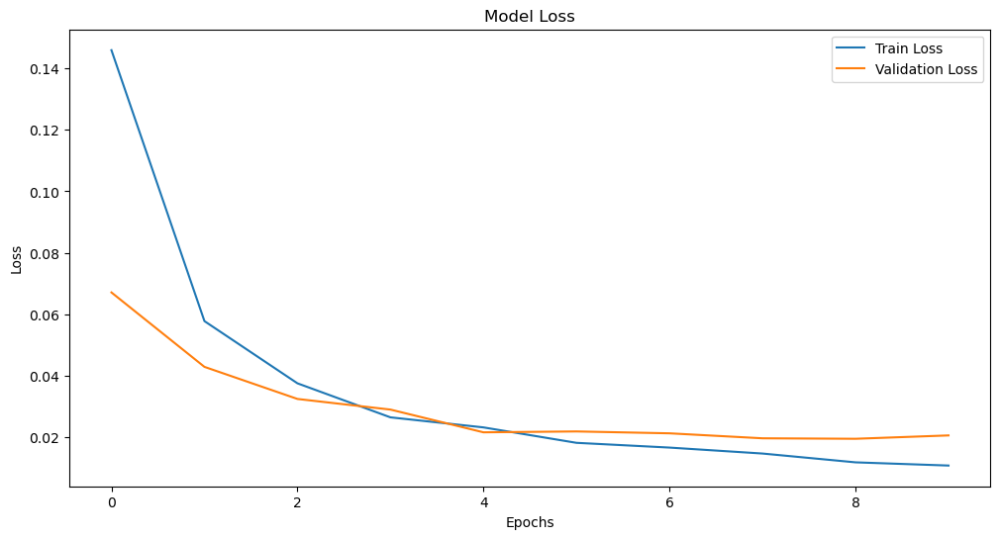

[INFO]  Evaluating Model...
1/1 [==============================] - 7s 7s/step - loss: 0.0285 - mae: 0.1254 - mse: 0.0285
Test Loss: 0.028516801074147224, Test MAE: 0.12544097006320953, Test MSE: 0.028516801074147224


In [181]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, LSTM, Dense, Conv1D, Bidirectional, Layer, Add, Attention
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import Adam

# Constants
TIME_STEPS = 2016  # 24 hours * 12 samples per hour (5 min intervals)
CROP_PARAM_COUNT = 3  # fresh weight, dry weight, height, diameter
CROP_TIME_STEPS = 1  # for hourly crop parameter predictions
BATCH_SIZE = 8 #16
EPOCHS = 10
LEARNING_RATE=0.001
ckpt="CherryTomato_wcp_model"
wcp_data_reshaped = wcp_data.reshape(108, 1, 3)

# Split data into train and test sets
train_data = train_test_split(ghc_data, wcp_data_reshaped, test_size=0.2, random_state=42)
print(train_data[0].shape)
(X_train, X_test, y_train, y_test) = train_data[0],train_data[1],train_data[2],train_data[3]

# Combine train and test datasets from all teams
X_train_combined = X_train
y_train_combined = y_train
X_test_combined = X_test
y_test_combined = y_test

print(X_train_combined.shape)
print(y_train_combined.shape)
print(X_test_combined.shape)
print(y_test_combined.shape)

# Build the Encoder-Decoder Model
def build_model(learning_rate,epochs):
        # Encoder
    encoder_inputs = Input(shape=(TIME_STEPS, X_train_combined.shape[-1]))
    conv = Conv1D(filters=64, kernel_size=3, padding='same', activation='relu')(encoder_inputs)
    encoder_lstm = Bidirectional(LSTM(128, return_sequences=True, return_state=True))
    encoder_outputs, forward_h, forward_c, backward_h, backward_c = encoder_lstm(conv)
    state_h = Add()([forward_h, backward_h])
    state_c = Add()([forward_c, backward_c])

    # Attention mechanism
    attention = Attention()([encoder_outputs, encoder_outputs])

    # Decoder
    decoder_inputs = Input(shape=(CROP_TIME_STEPS,CROP_PARAM_COUNT))
    decoder_lstm = LSTM(128, return_sequences=True, return_state=True)
    decoder_outputs, _, _ = decoder_lstm(decoder_inputs, initial_state=[state_h, state_c])
    decoder_dense = Dense(CROP_PARAM_COUNT)
    decoder_outputs = decoder_dense(decoder_outputs)

    # Model
    #model = Model([encoder_inputs, decoder_inputs], decoder_outputs)
    #model.compile(optimizer='adam', loss='mse', metrics=['mae', 'mse'])
    ## Encoder
    #print('[INFO]  Building Model...')
    #encoder_inputs = Input(shape=(TIME_STEPS, X_train_combined.shape[-1]))
    #conv = Conv1D(filters=64, kernel_size=3, padding='same', activation='relu')(encoder_inputs)
    #encoder_lstm = Bidirectional(LSTM(128, return_sequences=True))(conv)
    ## Attention mechanism
    ##attention = Attention()([encoder_outputs, encoder_outputs])
    ##attention = Attention()([encoder_lstm,encoder_lstm])
    #encoder_outputs, forward_h, forward_c, backward_h, backward_c = Bidirectional(
    #    LSTM(128, return_sequences=False, return_state=True))(encoder_lstm)
    #
    ##encoder_outputs, forward_h, forward_c, backward_h, backward_c = encoder_lstm(conv)
    #state_h = Add()([forward_h, backward_h])
    #state_c = Add()([forward_c, backward_c])
    ## Decoder
    #decoder_inputs = Input(shape=[(CROP_TIME_STEPS, CROP_PARAM_COUNT)])
    #decoder_lstm = LSTM(128, return_sequences=True, return_state=True) #128
    #decoder_outputs, _, _ = decoder_lstm(decoder_inputs, initial_state=[state_h, state_c])
    #decoder_dense = Dense((CROP_TIME_STEPS, CROP_PARAM_COUNT))
    #decoder_outputs = decoder_dense(decoder_outputs)
    opt = Adam(learning_rate=learning_rate, decay=learning_rate / epochs)
    ## Model
    model = Model([encoder_inputs, decoder_inputs], decoder_outputs)
    model.compile(optimizer=opt, loss='mse', metrics=['mae', 'mse'])
    return model

# Instantiate and train the model
model = build_model(LEARNING_RATE,EPOCHS)
print('[INFO]  Training Model...')
model.summary()
early_stopping_cb = tf.keras.callbacks.EarlyStopping(monitor="val_mae", patience=3, restore_best_weights=True)
model_ckpt = tf.keras.callbacks.ModelCheckpoint(ckpt, monitor="val_mae", save_best_only=True)

history = model.fit([X_train_combined, y_train_combined],
                    y_train_combined,
                    batch_size=BATCH_SIZE,
                    epochs=EPOCHS,
                    validation_split=0.2,
                    callbacks=[early_stopping_cb,model_ckpt])

# Plot training history
def plot_history(history):
    plt.figure(figsize=(12, 6))
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

plot_history(history)

# Evaluate the model
print('[INFO]  Evaluating Model...')
test_loss, test_mae, test_mse = model.evaluate([X_test_combined, y_test_combined], y_test_combined)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test MSE: {test_mse}")


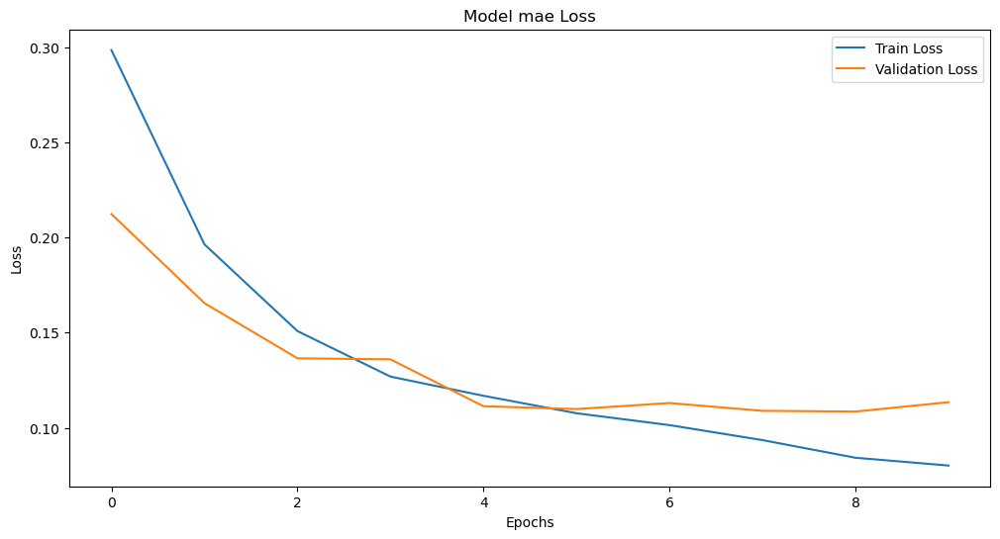

In [182]:
# Plot training history
def plot_history(history):
    plt.figure(figsize=(12, 6))
    plt.plot(history.history['mae'], label='Train Loss')
    plt.plot(history.history['val_mae'], label='Validation Loss')
    plt.title('Model mae Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()
plot_history(history)
   


In [183]:
# Save the model using TensorFlow's save method
model.save('CherryTomato_wcp_model.h5')

In [184]:
from tensorflow.keras.models import load_model
model = load_model('CherryTomato_wcp_model.h5')

In [185]:
#train_set=data[:100]
#valid_set=data[100:]
#test_set=teams_da_scaled
#print(train_set[:,0][1].shape)
#print(valid_set.shape)

In [186]:
train_input = tf.convert_to_tensor(da_data[:70])
train_output = tf.convert_to_tensor(wcp_data[:70])
valid_input = tf.convert_to_tensor(da_data[70:])
valid_output = tf.convert_to_tensor(wcp_data[70:])

ghc_train_input = tf.convert_to_tensor(ghc_data[:70])
ghc_valid_input = tf.convert_to_tensor(ghc_data[70:])

In [187]:
print(ghc_train_input[1,2000,:35])

tf.Tensor(
[0.         1.         0.53901561 0.01075269 0.46551724 0.95
 0.15360502 0.         0.         0.79242175 0.60471204 0.
 0.         0.06       0.05       0.         0.135      0.33333333
 0.1641791  1.         1.         1.         1.         0.45864662
 1.         0.95       0.125      0.80519481 0.         0.58666667
 0.58666667 0.00798935 0.975      0.012      0.07831325], shape=(35,), dtype=float64)


In [188]:
print(ghc_train_input[1,100,:35])

tf.Tensor(
[1.         0.         0.46098439 0.         0.01724138 0.75
 0.21316614 0.38089005 0.69021739 0.70510708 0.59685864 0.11926606
 0.65989848 0.01       0.01       1.         0.07       0.5
 0.1641791  0.5        0.         0.5        0.         0.4962406
 0.         0.75       0.125      0.83116883 0.         0.61333333
 0.61333333 0.         0.975      0.012      0.04216867], shape=(35,), dtype=float64)


In [1]:
print(ghc_train_input.max())

NameError: name 'ghc_train_input' is not defined

In [189]:
print(train_input.shape)
print(valid_output.shape)

(70, 34, 7)
(38, 3)


In [190]:
tf.random.set_seed(42)

MLP_model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=[ghc_train_input.shape[1],ghc_train_input.shape[-1]]),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128,activation="relu"),
    tf.keras.layers.Dense(128,activation="relu"),

    tf.keras.layers.Dense(3, activation="linear")
])

MLP_model.input

<KerasTensor: shape=(None, 2016, 35) dtype=float32 (created by layer 'input_37')>

In [191]:
tf.random.set_seed(42)

avg_LSTM_model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=[train_input.shape[1],train_input.shape[-1]]),
    tf.keras.layers.Conv1D(filters=32, kernel_size=4, strides=1, padding="same",
                           activation="relu"),
    tf.keras.layers.LSTM(64,return_sequences=True),
    tf.keras.layers.LSTM(64,return_sequences=False),
    tf.keras.layers.Dense(3, activation="linear")
])
avg_LSTM_model.input_shape


(None, 34, 7)

In [192]:
from tensorflow.keras.optimizers import Adam

def fit_and_evaluate(model, train_input,train_output, valid_input,valid_output, learning_rate,ckpt, epochs=10,batch_size=32,patience=10):
    early_stopping_cb = tf.keras.callbacks.EarlyStopping(
        monitor="val_mae", patience=patience, restore_best_weights=True)
    model_ckpt = tf.keras.callbacks.ModelCheckpoint(
    ckpt, monitor="val_mae", save_best_only=True)
    opt = Adam(learning_rate=learning_rate, decay=learning_rate / epochs)
    model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])
    history = model.fit(train_input,train_output, validation_split=0.2, epochs=epochs,batch_size=batch_size,
                        callbacks=[early_stopping_cb,model_ckpt])
    valid_loss, valid_mae = model.evaluate(valid_input,valid_output)
    
    #import joblib
    #joblib.dump(model,f'{ckpt}_model.pkl')

    # Save the model using TensorFlow's save method
    model.save(f'{ckpt}_model.h5')
    #loaded_model=joblib.load(f'{ckpt}_model.pkl')

    #new_data=testX
    #predictions=loaded_model.predict(new_data)
    #print(predictions,testY)
    # Plot training history
    plt.plot(history.history['mae'], label='train_mae')
    plt.plot(history.history['val_mae'], label='val_mae')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()
    return valid_mae 

Epoch 1/100
2/2 [==============================] - ETA: 0s - loss: 17.1958 - mae: 17.6195INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 4s 2s/step - loss: 17.1958 - mae: 17.6195 - val_loss: 7.6418 - val_mae: 8.1216
Epoch 2/100
2/2 [==============================] - 0s 246ms/step - loss: 11.7455 - mae: 12.2276 - val_loss: 14.3047 - val_mae: 14.8047
Epoch 3/100
2/2 [==============================] - ETA: 0s - loss: 13.0286 - mae: 13.5286INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 2s 2s/step - loss: 13.0286 - mae: 13.5286 - val_loss: 3.4156 - val_mae: 3.9141
Epoch 4/100
2/2 [==============================] - 0s 178ms/step - loss: 4.5941 - mae: 5.0938 - val_loss: 6.6749 - val_mae: 7.1407
Epoch 5/100
2/2 [==============================] - 0s 245ms/step - loss: 6.4130 - mae: 6.8857 - val_loss: 5.7989 - val_mae: 6.2122
Epoch 6/100
2/2 [==============================] - ETA: 0s - loss: 5.6969 - mae: 6.1717INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 3s 2s/step - loss: 5.6969 - mae: 6.1717 - val_loss: 3.3396 - val_mae: 3.8396
Epoch 7/100
2/2 [==============================] - ETA: 0s - loss: 3.7186 - mae: 4.2146INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 3s 2s/step - loss: 3.7186 - mae: 4.2146 - val_loss: 2.8911 - val_mae: 3.3376
Epoch 8/100
2/2 [==============================] - ETA: 0s - loss: 3.5478 - mae: 4.0145INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 5s 5s/step - loss: 3.5478 - mae: 4.0145 - val_loss: 2.7238 - val_mae: 3.2238
Epoch 9/100
2/2 [==============================] - ETA: 0s - loss: 2.6436 - mae: 3.1436INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 4s 4s/step - loss: 2.6436 - mae: 3.1436 - val_loss: 1.3394 - val_mae: 1.7663
Epoch 10/100
2/2 [==============================] - 0s 209ms/step - loss: 1.8695 - mae: 2.3296 - val_loss: 2.2949 - val_mae: 2.6704
Epoch 11/100
2/2 [==============================] - ETA: 0s - loss: 2.1174 - mae: 2.5679INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 4s 4s/step - loss: 2.1174 - mae: 2.5679 - val_loss: 0.9378 - val_mae: 1.4137
Epoch 12/100
2/2 [==============================] - ETA: 0s - loss: 1.0493 - mae: 1.5066INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 5s 4s/step - loss: 1.0493 - mae: 1.5066 - val_loss: 0.8846 - val_mae: 1.3361
Epoch 13/100
2/2 [==============================] - ETA: 0s - loss: 1.0156 - mae: 1.4707INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 4s 4s/step - loss: 1.0156 - mae: 1.4707 - val_loss: 0.5807 - val_mae: 0.9041
Epoch 14/100
2/2 [==============================] - 0s 123ms/step - loss: 0.7774 - mae: 1.1818 - val_loss: 1.2647 - val_mae: 1.7293
Epoch 15/100
2/2 [==============================] - 0s 148ms/step - loss: 1.4520 - mae: 1.8919 - val_loss: 0.7309 - val_mae: 1.2235
Epoch 16/100
2/2 [==============================] - 0s 156ms/step - loss: 0.8758 - mae: 1.3302 - val_loss: 0.7322 - val_mae: 1.1611
Epoch 17/100
2/2 [==============================] - ETA: 0s - loss: 0.8225 - mae: 1.2404INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 2s 2s/step - loss: 0.8225 - mae: 1.2404 - val_loss: 0.1546 - val_mae: 0.4371
Epoch 18/100
2/2 [==============================] - 0s 233ms/step - loss: 0.2943 - mae: 0.6637 - val_loss: 0.3267 - val_mae: 0.7209
Epoch 19/100
2/2 [==============================] - 0s 301ms/step - loss: 0.3636 - mae: 0.7449 - val_loss: 0.3557 - val_mae: 0.7881
Epoch 20/100
2/2 [==============================] - 0s 292ms/step - loss: 0.3722 - mae: 0.7794 - val_loss: 0.1701 - val_mae: 0.4981
Epoch 21/100
2/2 [==============================] - 0s 231ms/step - loss: 0.1778 - mae: 0.4985 - val_loss: 0.2813 - val_mae: 0.5884
Epoch 22/100
2/2 [==============================] - 0s 173ms/step - loss: 0.2589 - mae: 0.5591 - val_loss: 0.2590 - val_mae: 0.5107
Epoch 23/100
2/2 [==============================] - ETA: 0s - loss: 0.2992 - mae: 0.6431INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 1s 1s/step - loss: 0.2992 - mae: 0.6431 - val_loss: 0.0549 - val_mae: 0.3031
Epoch 24/100
2/2 [==============================] - 0s 214ms/step - loss: 0.1116 - mae: 0.3806 - val_loss: 0.3169 - val_mae: 0.6183
Epoch 25/100
2/2 [==============================] - 0s 197ms/step - loss: 0.2210 - mae: 0.4814 - val_loss: 0.4131 - val_mae: 0.8251
Epoch 26/100
2/2 [==============================] - 0s 316ms/step - loss: 0.4315 - mae: 0.8341 - val_loss: 0.1621 - val_mae: 0.4098
Epoch 27/100
2/2 [==============================] - 1s 346ms/step - loss: 0.3287 - mae: 0.6883 - val_loss: 0.3630 - val_mae: 0.6735
Epoch 28/100
2/2 [==============================] - 0s 206ms/step - loss: 0.3420 - mae: 0.6622 - val_loss: 0.7428 - val_mae: 1.2390
Epoch 29/100
2/2 [==============================] - 0s 183ms/step - loss: 0.5357 - mae: 0.9527 - val_loss: 0.8766 - val_mae: 1.3720
Epoch 30/100
2/2 [==============================] - 0s 160ms/step - loss: 0.5792 - mae: 0.98

INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 1s 1s/step - loss: 0.5715 - mae: 0.9735 - val_loss: 0.0499 - val_mae: 0.2615
Epoch 34/100
2/2 [==============================] - 0s 195ms/step - loss: 0.3537 - mae: 0.7134 - val_loss: 0.0954 - val_mae: 0.3867
Epoch 35/100
2/2 [==============================] - 0s 175ms/step - loss: 0.2450 - mae: 0.5913 - val_loss: 0.3333 - val_mae: 0.7704
Epoch 36/100
2/2 [==============================] - 0s 268ms/step - loss: 0.1730 - mae: 0.4957 - val_loss: 0.3234 - val_mae: 0.7461
Epoch 37/100
2/2 [==============================] - 0s 314ms/step - loss: 0.3239 - mae: 0.6798 - val_loss: 0.3360 - val_mae: 0.8029
Epoch 38/100
2/2 [==============================] - ETA: 0s - loss: 0.3148 - mae: 0.7374INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 2s 1s/step - loss: 0.3148 - mae: 0.7374 - val_loss: 0.0356 - val_mae: 0.2284
Epoch 39/100
2/2 [==============================] - 0s 233ms/step - loss: 0.2114 - mae: 0.5356 - val_loss: 0.0598 - val_mae: 0.2652
Epoch 40/100
2/2 [==============================] - 0s 267ms/step - loss: 0.2004 - mae: 0.5303 - val_loss: 0.4298 - val_mae: 0.9020
Epoch 41/100
2/2 [==============================] - 0s 315ms/step - loss: 0.2911 - mae: 0.6637 - val_loss: 0.3394 - val_mae: 0.7845
Epoch 42/100
2/2 [==============================] - 0s 227ms/step - loss: 0.2596 - mae: 0.6117 - val_loss: 0.4552 - val_mae: 0.9044
Epoch 43/100
2/2 [==============================] - 0s 170ms/step - loss: 0.2973 - mae: 0.6872 - val_loss: 0.1607 - val_mae: 0.5142
Epoch 44/100
2/2 [==============================] - ETA: 0s - loss: 0.2632 - mae: 0.6680INFO:tensorflow:Assets written to: wcp_mlp_model\assets


INFO:tensorflow:Assets written to: wcp_mlp_model\assets


2/2 [==============================] - 1s 1s/step - loss: 0.2632 - mae: 0.6680 - val_loss: 0.0306 - val_mae: 0.1845
Epoch 45/100
2/2 [==============================] - 0s 247ms/step - loss: 0.1750 - mae: 0.4772 - val_loss: 0.1187 - val_mae: 0.4359
Epoch 46/100
2/2 [==============================] - 0s 225ms/step - loss: 0.1217 - mae: 0.4400 - val_loss: 0.3084 - val_mae: 0.7182
Epoch 47/100
2/2 [==============================] - 0s 285ms/step - loss: 0.1747 - mae: 0.4809 - val_loss: 0.2649 - val_mae: 0.7060
Epoch 48/100
2/2 [==============================] - 0s 289ms/step - loss: 0.3136 - mae: 0.7403 - val_loss: 0.0364 - val_mae: 0.2316
Epoch 49/100
2/2 [==============================] - 0s 180ms/step - loss: 0.1569 - mae: 0.4608 - val_loss: 0.0616 - val_mae: 0.3090
Epoch 50/100
2/2 [==============================] - 0s 150ms/step - loss: 0.0815 - mae: 0.3487 - val_loss: 0.1225 - val_mae: 0.4657
Epoch 51/100
2/2 [==============================] - 0s 166ms/step - loss: 0.1019 - mae: 0.36

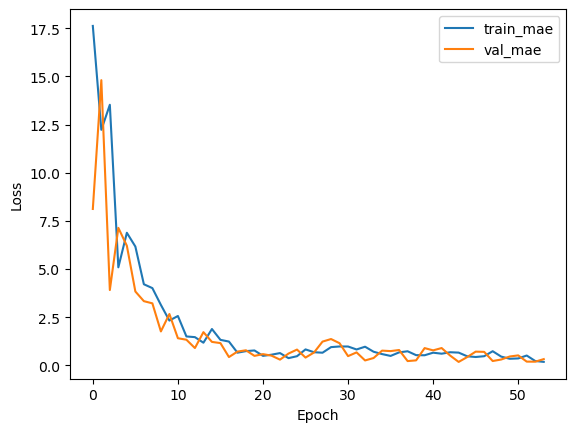

0.2563394606113434

In [193]:
#tf.keras.backend.clear_session()

fit_and_evaluate(MLP_model, ghc_train_input,train_output, ghc_valid_input,valid_output, 
                learning_rate=0.001,ckpt="wcp_mlp_model",epochs=100,patience=10)


Epoch 1/100
2/2 [==============================] - ETA: 0s - loss: 0.1974 - mae: 0.5763

INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


2/2 [==============================] - 19s 14s/step - loss: 0.1974 - mae: 0.5763 - val_loss: 0.1357 - val_mae: 0.4906
Epoch 2/100
2/2 [==============================] - ETA: 0s - loss: 0.1223 - mae: 0.4392

INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


2/2 [==============================] - 9s 9s/step - loss: 0.1223 - mae: 0.4392 - val_loss: 0.0580 - val_mae: 0.2990
Epoch 3/100
2/2 [==============================] - ETA: 0s - loss: 0.0521 - mae: 0.2637

INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


2/2 [==============================] - 9s 9s/step - loss: 0.0521 - mae: 0.2637 - val_loss: 0.0174 - val_mae: 0.1628
Epoch 4/100
2/2 [==============================] - 1s 596ms/step - loss: 0.0392 - mae: 0.2357 - val_loss: 0.0270 - val_mae: 0.2027
Epoch 5/100
2/2 [==============================] - ETA: 0s - loss: 0.0415 - mae: 0.2432

INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


2/2 [==============================] - 11s 11s/step - loss: 0.0415 - mae: 0.2432 - val_loss: 0.0123 - val_mae: 0.1258
Epoch 6/100
2/2 [==============================] - 1s 404ms/step - loss: 0.0255 - mae: 0.1771 - val_loss: 0.0196 - val_mae: 0.1658
Epoch 7/100
2/2 [==============================] - 1s 300ms/step - loss: 0.0288 - mae: 0.2031 - val_loss: 0.0277 - val_mae: 0.2079
Epoch 8/100
2/2 [==============================] - 0s 225ms/step - loss: 0.0335 - mae: 0.2242 - val_loss: 0.0262 - val_mae: 0.2004
Epoch 9/100
2/2 [==============================] - 0s 216ms/step - loss: 0.0310 - mae: 0.2118 - val_loss: 0.0190 - val_mae: 0.1608
Epoch 10/100
2/2 [==============================] - ETA: 0s - loss: 0.0256 - mae: 0.1862

INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


2/2 [==============================] - 11s 10s/step - loss: 0.0256 - mae: 0.1862 - val_loss: 0.0126 - val_mae: 0.1248
Epoch 11/100
2/2 [==============================] - 1s 281ms/step - loss: 0.0233 - mae: 0.1700 - val_loss: 0.0114 - val_mae: 0.1268
Epoch 12/100
2/2 [==============================] - 1s 389ms/step - loss: 0.0252 - mae: 0.1749 - val_loss: 0.0123 - val_mae: 0.1363
Epoch 13/100
2/2 [==============================] - 1s 300ms/step - loss: 0.0264 - mae: 0.1809 - val_loss: 0.0118 - val_mae: 0.1333
Epoch 14/100
2/2 [==============================] - 0s 214ms/step - loss: 0.0246 - mae: 0.1736 - val_loss: 0.0119 - val_mae: 0.1269
Epoch 15/100
2/2 [==============================] - 0s 242ms/step - loss: 0.0236 - mae: 0.1694 - val_loss: 0.0138 - val_mae: 0.1295
Epoch 16/100
2/2 [==============================] - 0s 200ms/step - loss: 0.0237 - mae: 0.1718 - val_loss: 0.0152 - val_mae: 0.1344
Epoch 17/100
2/2 [==============================] - 0s 183ms/step - loss: 0.0241 - mae: 0.

INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


2/2 [==============================] - 8s 8s/step - loss: 0.0228 - mae: 0.1689 - val_loss: 0.0120 - val_mae: 0.1231
Epoch 20/100
2/2 [==============================] - ETA: 0s - loss: 0.0228 - mae: 0.1667

INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_avg_LSTM_model\assets


2/2 [==============================] - 10s 9s/step - loss: 0.0228 - mae: 0.1667 - val_loss: 0.0116 - val_mae: 0.1213
Epoch 21/100
2/2 [==============================] - 1s 377ms/step - loss: 0.0230 - mae: 0.1659 - val_loss: 0.0115 - val_mae: 0.1219
Epoch 22/100
2/2 [==============================] - 1s 333ms/step - loss: 0.0228 - mae: 0.1655 - val_loss: 0.0116 - val_mae: 0.1232
Epoch 23/100
2/2 [==============================] - 1s 250ms/step - loss: 0.0222 - mae: 0.1644 - val_loss: 0.0123 - val_mae: 0.1242
Epoch 24/100
2/2 [==============================] - 0s 243ms/step - loss: 0.0222 - mae: 0.1655 - val_loss: 0.0133 - val_mae: 0.1275
Epoch 25/100
2/2 [==============================] - 0s 231ms/step - loss: 0.0222 - mae: 0.1654 - val_loss: 0.0134 - val_mae: 0.1275
Epoch 26/100
2/2 [==============================] - 0s 275ms/step - loss: 0.0221 - mae: 0.1638 - val_loss: 0.0127 - val_mae: 0.1247
Epoch 27/100
2/2 [==============================] - 0s 250ms/step - loss: 0.0217 - mae: 0.1

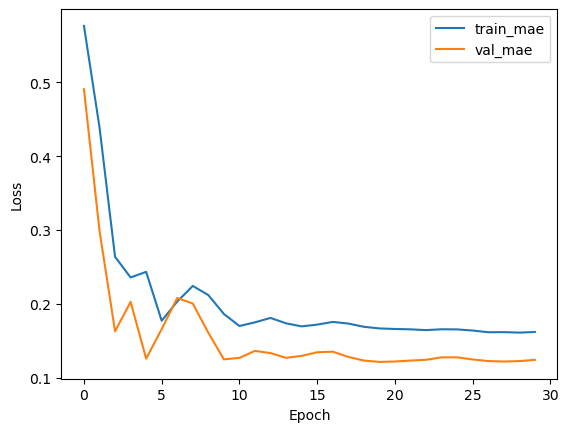

0.18816228210926056

In [194]:
#tf.keras.backend.clear_session()
fit_and_evaluate(avg_LSTM_model, train_input,train_output, valid_input,valid_output, 
                learning_rate=0.001,ckpt="wcp_avg_LSTM_model",epochs=100)

In [195]:
tf.random.set_seed(42)

LSTM_model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=[ghc_train_input.shape[1],ghc_train_input.shape[-1]]),
    tf.keras.layers.Conv1D(filters=16, kernel_size=4, strides=1, padding="same",
                           activation="relu"),
    tf.keras.layers.LSTM(32,return_sequences=True),
    tf.keras.layers.LSTM(32,return_sequences=False),
    tf.keras.layers.Dense(3, activation="linear")
])
LSTM_model.input_shape

(None, 2016, 35)

Epoch 1/100
2/2 [==============================] - ETA: 0s - loss: 0.1789 - mae: 0.5265 

INFO:tensorflow:Assets written to: wcp_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_LSTM_model\assets


2/2 [==============================] - 28s 17s/step - loss: 0.1789 - mae: 0.5265 - val_loss: 0.1116 - val_mae: 0.4259
Epoch 2/100
2/2 [==============================] - ETA: 0s - loss: 0.1100 - mae: 0.4081

INFO:tensorflow:Assets written to: wcp_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_LSTM_model\assets


2/2 [==============================] - 20s 14s/step - loss: 0.1100 - mae: 0.4081 - val_loss: 0.0601 - val_mae: 0.3145
Epoch 3/100
2/2 [==============================] - ETA: 0s - loss: 0.0630 - mae: 0.3065

INFO:tensorflow:Assets written to: wcp_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_LSTM_model\assets


2/2 [==============================] - 20s 14s/step - loss: 0.0630 - mae: 0.3065 - val_loss: 0.0259 - val_mae: 0.1994
Epoch 4/100
2/2 [==============================] - ETA: 0s - loss: 0.0319 - mae: 0.2113

INFO:tensorflow:Assets written to: wcp_LSTM_model\assets


INFO:tensorflow:Assets written to: wcp_LSTM_model\assets


2/2 [==============================] - 22s 16s/step - loss: 0.0319 - mae: 0.2113 - val_loss: 0.0126 - val_mae: 0.1253
Epoch 5/100
2/2 [==============================] - 11s 5s/step - loss: 0.0245 - mae: 0.1716 - val_loss: 0.0164 - val_mae: 0.1435
Epoch 6/100
2/2 [==============================] - 10s 4s/step - loss: 0.0304 - mae: 0.1906 - val_loss: 0.0184 - val_mae: 0.1541
Epoch 7/100
2/2 [==============================] - 10s 5s/step - loss: 0.0321 - mae: 0.1966 - val_loss: 0.0154 - val_mae: 0.1407
Epoch 8/100
2/2 [==============================] - 10s 5s/step - loss: 0.0278 - mae: 0.1791 - val_loss: 0.0126 - val_mae: 0.1300
Epoch 9/100
2/2 [==============================] - 11s 5s/step - loss: 0.0240 - mae: 0.1621 - val_loss: 0.0121 - val_mae: 0.1354
Epoch 10/100
2/2 [==============================] - 10s 5s/step - loss: 0.0213 - mae: 0.1562 - val_loss: 0.0131 - val_mae: 0.1413
Epoch 11/100
2/2 [==============================] - 10s 5s/step - loss: 0.0204 - mae: 0.1575 - val_loss: 0.

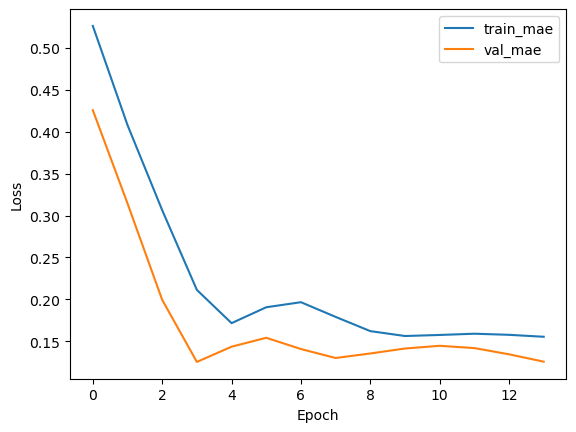

0.19061090052127838

In [196]:
#tf.keras.backend.clear_session()

fit_and_evaluate(LSTM_model, ghc_train_input,train_output, ghc_valid_input,valid_output, 
                learning_rate=0.001,ckpt="wcp_LSTM_model",epochs=100,patience=10)

In [197]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, LSTM, Dense, Conv1D, Bidirectional, Layer
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_40 (InputLayer)       [(None, 2016, 35)]        0         
                                                                 
 conv1d_21 (Conv1D)          (None, 2016, 64)          6784      
                                                                 
 bidirectional_18 (Bidirecti  (None, 2016, 256)        197632    
 onal)                                                           
                                                                 
 attention_layer_1 (Attentio  (None, 2016, 256)        65792     
 nLayer)                                                         
                                                                 
 bidirectional_19 (Bidirecti  [(None, 256),            394240    
 onal)                        (None, 128),                       
                              (None, 128),                

INFO:tensorflow:Assets written to: wcp_EncDec_model_\assets


INFO:tensorflow:Assets written to: wcp_EncDec_model_\assets


2/2 [==============================] - 168s 118s/step - loss: 0.2088 - mae: 0.5942 - val_loss: 0.1926 - val_mae: 0.5904
Epoch 2/50
2/2 [==============================] - ETA: 0s - loss: 0.1924 - mae: 0.5678 

INFO:tensorflow:Assets written to: wcp_EncDec_model_\assets


INFO:tensorflow:Assets written to: wcp_EncDec_model_\assets


2/2 [==============================] - 154s 114s/step - loss: 0.1924 - mae: 0.5678 - val_loss: 0.1657 - val_mae: 0.5452
Epoch 3/50
2/2 [==============================] - ETA: 0s - loss: 0.1631 - mae: 0.5173 

INFO:tensorflow:Assets written to: wcp_EncDec_model_\assets


INFO:tensorflow:Assets written to: wcp_EncDec_model_\assets


2/2 [==============================] - 153s 107s/step - loss: 0.1631 - mae: 0.5173 - val_loss: 0.1148 - val_mae: 0.4482
Epoch 4/50
2/2 [==============================] - ETA: 0s - loss: 0.1046 - mae: 0.4055 

INFO:tensorflow:Assets written to: wcp_EncDec_model_\assets


INFO:tensorflow:Assets written to: wcp_EncDec_model_\assets


2/2 [==============================] - 166s 120s/step - loss: 0.1046 - mae: 0.4055 - val_loss: 0.0203 - val_mae: 0.1642
Epoch 5/50
2/2 [==============================] - 136s 91s/step - loss: 0.1370 - mae: 0.4169 - val_loss: 0.0190 - val_mae: 0.1661
Epoch 6/50
2/2 [==============================] - 133s 90s/step - loss: 0.0368 - mae: 0.2159 - val_loss: 0.0334 - val_mae: 0.2290
Epoch 7/50
2/2 [==============================] - 140s 93s/step - loss: 0.0503 - mae: 0.2765 - val_loss: 0.0574 - val_mae: 0.3091
Epoch 8/50
2/2 [==============================] - 143s 99s/step - loss: 0.0692 - mae: 0.3271 - val_loss: 0.0671 - val_mae: 0.3356
Epoch 9/50
2/2 [==============================] - 38s 15s/step - loss: 0.0380 - mae: 0.2275
Test Loss: [0.038012050092220306, 0.22750572860240936]


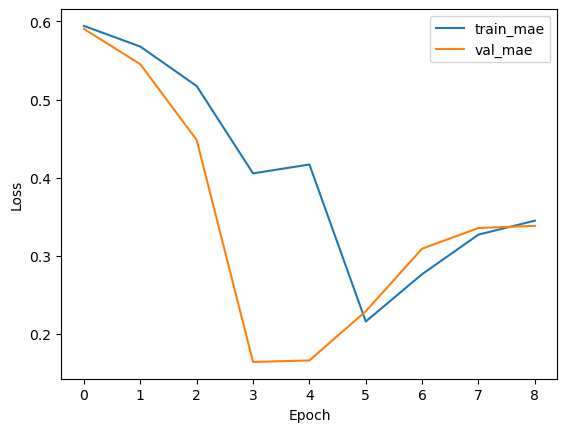

In [198]:
#tf.keras.backend.clear_session()

# Constants
TIME_STEPS = 2016  # 7 days * 24 hours * 12 samples per hour (5 min intervals)
CROP_PARAM_COUNT = 3  # fresh weight, dry weight, height, diameter
BATCH_SIZE = 32
EPOCHS = 50

# Custom Attention Layer
class AttentionLayer(Layer):
    def __init__(self, **kwargs):
        super(AttentionLayer, self).__init__(**kwargs)

    def build(self, input_shape):
        self.W = self.add_weight(name='att_weight', shape=(input_shape[-1], input_shape[-1]), initializer='random_normal', trainable=True)
        self.b = self.add_weight(name='att_bias', shape=(input_shape[-1]), initializer='zeros', trainable=True)
        super(AttentionLayer, self).build(input_shape)

    def call(self, inputs):
        q = tf.nn.tanh(tf.tensordot(inputs, self.W, axes=1) + self.b)
        score = tf.nn.softmax(q, axis=1)
        return score * inputs

# Custom layer to handle the TensorFlow operations
class RepeatAndExpandLayer(Layer):
    def __init__(self, crop_param_count, **kwargs):
        super(RepeatAndExpandLayer, self).__init__(**kwargs)
        self.crop_param_count = crop_param_count

    def call(self, inputs):
        x = tf.expand_dims(inputs, axis=1)
        return tf.repeat(x, repeats=self.crop_param_count, axis=1)

def build_model():
    # Encoder
    encoder_inputs = Input(shape=(TIME_STEPS, ghc_train_input.shape[2]))
    x = Conv1D(64, kernel_size=3, padding='same', activation='relu')(encoder_inputs)
    x = Bidirectional(LSTM(128, return_sequences=True))(x)
    x = AttentionLayer()(x)
    
    # Use 'return_state=True' to capture LSTM states
    encoder_outputs, forward_h, forward_c, backward_h, backward_c = Bidirectional(
        LSTM(128, return_sequences=False, return_state=True))(x)

    # Combine forward and backward states
    state_h = tf.keras.layers.Concatenate()([forward_h, backward_h])
    state_c = tf.keras.layers.Concatenate()([forward_c, backward_c])

    # Decoder (Single output instead of sequence)
    decoder_inputs = encoder_outputs  # No need to expand/repeat for single output
    x = Dense(256, activation='relu')(decoder_inputs)
    decoder_outputs = Dense(CROP_PARAM_COUNT, activation='linear')(x)

    # Define model
    model = Model(encoder_inputs, decoder_outputs)
    #model.compile(optimizer='adam', loss='mse')
    return model

# Build and train model
EncDec_model = build_model()
learning_rate=0.001
ckpt="wcp_EncDec_model_"
epochs=50
batch_size=32,
early_stopping_cb = tf.keras.callbacks.EarlyStopping(
        monitor="val_mae", patience=5, restore_best_weights=True)
model_ckpt = tf.keras.callbacks.ModelCheckpoint(
ckpt, monitor="val_mae", save_best_only=True)
opt = Adam(learning_rate=learning_rate, decay=learning_rate / epochs)
EncDec_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

EncDec_model.summary()
#history = EncDec_model.fit(ghc_train_input, train_output, validation_split=0.2, epochs=EPOCHS, batch_size=BATCH_SIZE)
history = EncDec_model.fit(ghc_train_input,train_output,  validation_split=0.2, epochs=EPOCHS,batch_size=BATCH_SIZE,
                        callbacks=[early_stopping_cb,model_ckpt])


# Evaluate model
loss = EncDec_model.evaluate(ghc_valid_input, valid_output)
print(f"Test Loss: {loss}")

# Plot training history
plt.plot(history.history['mae'], label='train_mae')
plt.plot(history.history['val_mae'], label='val_mae')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Example of making predictions
def predict(model, time_series_data):
    predictions = model.predict(time_series_data)
    return predictions

# Sample prediction
#sample_predictions = predict(EncDec_model, ghc_valid_input[:5])
#print("Sample Predictions:\n", sample_predictions)
#print("Target:\n", valid_output[:5])

In [199]:
# Debugging Step: Print shapes before training
print("Input shape:", ghc_train_input.shape)
print("Output shape:", train_output.shape)

# Example of making predictions
sample_predictions = EncDec_model.predict(ghc_valid_input[:5])
print("Prediction shape:", sample_predictions.shape)
print("Target shape:", valid_output[:5].shape)

# Ensure that shapes of predictions and target outputs match
assert sample_predictions.shape == valid_output[:5].shape, "Shape mismatch between predictions and target outputs"


Input shape: (70, 2016, 35)
Output shape: (70, 3)
Prediction shape: (5, 3)
Target shape: (5, 3)


Epoch 1/50
2/2 [==============================] - ETA: 0s - loss: 0.2695 - mae: 0.5824 

INFO:tensorflow:Assets written to: wcp_EncDec_model\assets


INFO:tensorflow:Assets written to: wcp_EncDec_model\assets


2/2 [==============================] - 180s 122s/step - loss: 0.2695 - mae: 0.5824 - val_loss: 0.0115 - val_mae: 0.1195
Epoch 2/50
2/2 [==============================] - 146s 97s/step - loss: 0.0337 - mae: 0.2165 - val_loss: 0.0667 - val_mae: 0.3350
Epoch 3/50
2/2 [==============================] - 147s 96s/step - loss: 0.0814 - mae: 0.3566 - val_loss: 0.0955 - val_mae: 0.4050
Epoch 4/50
2/2 [==============================] - 163s 108s/step - loss: 0.1059 - mae: 0.4090 - val_loss: 0.1067 - val_mae: 0.4301
Epoch 5/50
2/2 [==============================] - 159s 104s/step - loss: 0.1147 - mae: 0.4267 - val_loss: 0.1093 - val_mae: 0.4359
Epoch 6/50
2/2 [==============================] - 158s 105s/step - loss: 0.1161 - mae: 0.4294 - val_loss: 0.1071 - val_mae: 0.4314
Epoch 7/50
2/2 [==============================] - 158s 105s/step - loss: 0.1133 - mae: 0.4239 - val_loss: 0.1019 - val_mae: 0.4201
Epoch 8/50
2/2 [==============================] - 156s 104s/step - loss: 0.1079 - mae: 0.4132 - 

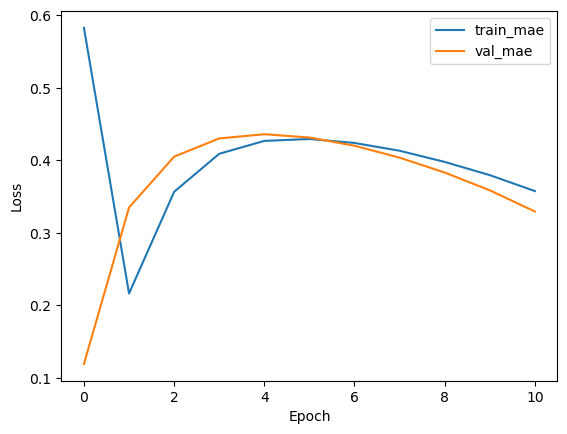

0.18359343707561493

In [200]:
#tf.keras.backend.clear_session()

fit_and_evaluate(EncDec_model, ghc_train_input,train_output, ghc_valid_input,valid_output, 
                learning_rate=0.001,ckpt="wcp_EncDec_model",epochs=50,patience=10)